# *Forecasting of time series*

__Introduction__

In this notebook, we aim to forecast the time series we have using different methods.
We will first forecast each time serie based on its own data. Then using the clustering we obtained with the clustering algorithms, we will forecast the time series by groups defined by their type.
Finally, we will use the very big set of time series from darts (approximately 48'000 time series), to fit our forecasting algorithms and to predict the behavior of the time series. Naturally, we will also do a grid search to choose for the best hyperparameters of each model.
Ultimately, the goal will be to predict the compare the different forecasting methods and to choose the best one.

IMPORTING LIBRARIES

Before we get started, let's import all necessary libraries for performing our time series classification:

In [10]:
%matplotlib inline

import warnings

warnings.filterwarnings("ignore")


import optuna
from optuna.integration import PyTorchLightningPruningCallback
from pytorch_lightning.callbacks import EarlyStopping
import os
import time
import random
import pandas as pd
import pickle
import numpy as np
from tqdm.auto import tqdm
from datetime import datetime
from itertools import product
import torch
from torch import nn
from typing import List, Tuple, Dict
from sklearn.preprocessing import MaxAbsScaler
from sklearn.linear_model import Ridge
import matplotlib.pyplot as plt
from itertools import chain


from darts import TimeSeries
from darts.utils import statistics
from darts.utils.losses import SmapeLoss
from darts.dataprocessing.transformers import Scaler
from darts.metrics import smape
from darts.utils.utils import SeasonalityMode, TrendMode, ModelMode
from darts.models import *
from darts.datasets import AirPassengersDataset
from darts.models import TCNModel
from darts.utils.likelihood_models import GaussianLikelihood

Let us now import the files we will need to forecast our time series.

In [11]:
infile_dfindices = open('data_indices/dfindices_timeseries','rb')
dfindices = pickle.load(infile_dfindices)
infile_dfindices.close()

In [12]:
infile_dfcluster = open('data_indices/df_tm_tocluster','rb')
dfcluster = pickle.load(infile_dfcluster)
infile_dfcluster.close()

In [13]:
infile_df_interpolation = open('data_indices/df_interpolation_ratio','rb')
df_interpolation = pickle.load(infile_df_interpolation)
infile_df_interpolation.close()

In [14]:
def simple_exp_smooth(d,alpha=0.4):  
    mylist= d  # Transform the input into a numpy array 
    cols = len(mylist)  # Historical period length  

    f = list(np.full(cols,np.nan))  # Forecast array  
    f[0] = mylist[0]  # initialization of first forecast  
      # Create all the t+1 forecasts until end of historical period  
    for t in range(1,cols):  
        f[t] = alpha*mylist[t-1]+(1-alpha)*f[t-1]  
    return f

<div class="alert-info">
1. Filtering the dataframe by interpolation ratio
</div>

As done before, we aim to forecast and consider only the time series that are meaningful, which means the time series that have a low interpolation ratio. This is done to avoid useless noise in our analyses and forecasting. For this reason, we keep only the time series with less than 50% of interpolation ratio.

In [15]:
dfcluster

,concept1,concept2,index,cluster
0,Authentication protocole,Authentication protocole,index_cit_t1_t2,0.0
1,Authentication protocole,Biometrics,index_cit_t1_t2,5.0
2,Authentication protocole,Blockchain,index_cit_t1_t2,5.0
3,Authentication protocole,Digital rights management,index_cit_t1_t2,5.0
4,Authentication protocole,Digital signature,index_cit_t1_t2,5.0
...,...,...,...,...
3120,Zero-knowlegde proof,Symmetric-key algorithm,index_keyword,2.0
3121,Zero-knowlegde proof,Threshold cryptosystem,index_keyword,NaN
3122,Zero-knowlegde proof,Trusted Computing,index_keyword,4.0
3123,Zero-knowlegde proof,Tunneling protocol,index_keyword,NaN


In [16]:
dfindices

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword
0,Authentication protocole,Authentication protocole,1-01-2,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,2-01-2,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,3-01-2,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,4-01-2,0.836174,0.836174,13.808524,13.77767,7.22864
0,Authentication protocole,Authentication protocole,5-01-2,0.0,0.0,6.284266,6.284266,3.355919
...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,8-01-22,0.0,0.0,54.317264,28.72956,8.031585
624,Zero-knowlegde proof,Zero-knowlegde proof,9-01-22,0.0,0.0,19.811067,19.811067,8.877465
624,Zero-knowlegde proof,Zero-knowlegde proof,10-01-22,6.706388,6.706388,48.748713,44.762499,14.777641
624,Zero-knowlegde proof,Zero-knowlegde proof,11-01-22,0.0,0.0,24.238745,16.901309,6.616964


In [17]:
df_interpolation

,concept1,concept2,interpolation_ratio
548,Threshold cryptosystem,Tunneling protocol,0.944444
596,Tunneling protocol,Threshold cryptosystem,0.944444
577,Tunneling protocol,Blockchain,0.928571
73,Blockchain,Tunneling protocol,0.928571
589,Tunneling protocol,Link encryption,0.924603
...,...,...,...
110,Digital signature,Hash function,0.007937
410,Public-key cryptography,Hash function,0.000000
416,Public-key cryptography,Public-key cryptography,0.000000
266,Hash function,Public-key cryptography,0.000000


In [18]:
df_interpolation.loc[df_interpolation['interpolation_ratio']>=0.5]

,concept1,concept2,interpolation_ratio
548,Threshold cryptosystem,Tunneling protocol,0.944444
596,Tunneling protocol,Threshold cryptosystem,0.944444
577,Tunneling protocol,Blockchain,0.928571
73,Blockchain,Tunneling protocol,0.928571
589,Tunneling protocol,Link encryption,0.924603
...,...,...,...
227,Hardware security module,Blockchain,0.531746
69,Blockchain,Random number generation,0.503968
477,Random number generation,Blockchain,0.503968
602,Zero-knowlegde proof,Blockchain,0.500000


In [19]:
list_concepts= ['Authentication protocole','Biometrics','Blockchain','Digital rights management'
,'Digital signature','Distributed algorithm','Electronic voting','Functional encryption',
'Hardware acceleration','Hardware security module','Hash function','Homomorphic encryption','Identity management',
'Key management','Link encryption','Post-quantum cryptography','Public-key cryptography','Quantum key distribution',
'Quantum cryptography','Random number generation','Symmetric-key algorithm','Threshold cryptosystem',
'Trusted Computing','Tunneling protocol','Zero-knowlegde proof']

In [20]:
list_indices=['index_cit_t1_t2','index_cit_t2_t1','index_colab_increm','index_colab_notincrem','index_keyword']

In [21]:
list_interpolationratio=[]

numbertm_highextrapolation = 0

for concept1 in list_concepts:
    dfinter1=df_interpolation.loc[df_interpolation['concept1']==concept1]
    for concept2 in list_concepts:
        dfinter2=dfinter1.loc[dfinter1['concept2']==concept2]
        interpolation_score = dfinter2.interpolation_ratio.tolist()[0]
        list_interpolationratio=list_interpolationratio+252*[interpolation_score]
        if interpolation_score>=0.5:
            numbertm_highextrapolation=numbertm_highextrapolation+1

In [22]:
print('There are '+str(numbertm_highextrapolation)+' pairs of technologies with a high interpolation rate')

There are 155 pairs of technologies with a high interpolation rate


In [23]:
dfindices['interpolation_score']=list_interpolationratio

In [24]:
dfindices=dfindices.drop(dfindices[dfindices['interpolation_score'] >=0.5].index)

In [25]:
dfindices

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword,interpolation_score
0,Authentication protocole,Authentication protocole,1-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,2-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,3-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,4-01-2,0.836174,0.836174,13.808524,13.77767,7.22864,0.019841
0,Authentication protocole,Authentication protocole,5-01-2,0.0,0.0,6.284266,6.284266,3.355919,0.019841
...,...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,8-01-22,0.0,0.0,54.317264,28.72956,8.031585,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,9-01-22,0.0,0.0,19.811067,19.811067,8.877465,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,10-01-22,6.706388,6.706388,48.748713,44.762499,14.777641,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,11-01-22,0.0,0.0,24.238745,16.901309,6.616964,0.095238


<div class="alert-info">
2. Transforming the datatype of date to obtain darts time series
</div>

We now must transform the datatype of the column 'date' to get it acceptable for darts time series.

In [26]:
dfindices['time'] = pd.Series(['12:00' for x in range(len(dfindices))])

In [27]:
combined = dfindices.date.str.cat(dfindices.time,sep=' ')

In [28]:
dfindices['date_and_time']=pd.to_datetime(combined)

In [29]:
dfindices

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword,interpolation_score,time,date_and_time
0,Authentication protocole,Authentication protocole,1-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841,12:00,2002-01-01 12:00:00
0,Authentication protocole,Authentication protocole,2-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841,12:00,2002-02-01 12:00:00
0,Authentication protocole,Authentication protocole,3-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841,12:00,2002-03-01 12:00:00
0,Authentication protocole,Authentication protocole,4-01-2,0.836174,0.836174,13.808524,13.77767,7.22864,0.019841,12:00,2002-04-01 12:00:00
0,Authentication protocole,Authentication protocole,5-01-2,0.0,0.0,6.284266,6.284266,3.355919,0.019841,12:00,2002-05-01 12:00:00
...,...,...,...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,8-01-22,0.0,0.0,54.317264,28.72956,8.031585,0.095238,12:00,2022-08-01 12:00:00
624,Zero-knowlegde proof,Zero-knowlegde proof,9-01-22,0.0,0.0,19.811067,19.811067,8.877465,0.095238,12:00,2022-09-01 12:00:00
624,Zero-knowlegde proof,Zero-knowlegde proof,10-01-22,6.706388,6.706388,48.748713,44.762499,14.777641,0.095238,12:00,2022-10-01 12:00:00
624,Zero-knowlegde proof,Zero-knowlegde proof,11-01-22,0.0,0.0,24.238745,16.901309,6.616964,0.095238,12:00,2022-11-01 12:00:00


In [30]:
dfindices = dfindices.drop(['date','time'], axis=1).sort_index(axis=1)

In [31]:
dfindices

,concept1,concept2,date_and_time,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword,interpolation_score
0,Authentication protocole,Authentication protocole,2002-01-01 12:00:00,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,2002-02-01 12:00:00,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,2002-03-01 12:00:00,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,2002-04-01 12:00:00,0.836174,0.836174,13.808524,13.77767,7.22864,0.019841
0,Authentication protocole,Authentication protocole,2002-05-01 12:00:00,0.0,0.0,6.284266,6.284266,3.355919,0.019841
...,...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-08-01 12:00:00,0.0,0.0,54.317264,28.72956,8.031585,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-09-01 12:00:00,0.0,0.0,19.811067,19.811067,8.877465,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-10-01 12:00:00,6.706388,6.706388,48.748713,44.762499,14.777641,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-11-01 12:00:00,0.0,0.0,24.238745,16.901309,6.616964,0.095238


In [32]:
dfindices.dtypes

concept1                         object
concept2                         object
date_and_time            datetime64[ns]
index_cit_t1_t2                  object
index_cit_t2_t1                  object
index_colab_increm               object
index_colab_notincrem            object
index_keyword                    object
interpolation_score             float64
dtype: object

<div class="alert-info">
3. Creation of a dataframe of darts time series
</div>

In [52]:
listconcept1=[]
listconcept2=[]
listindextype=[]
listdartstm=[]

for concept1 in tqdm(list_concepts):
    dfconcept1 = dfindices.loc[dfindices['concept1']==concept1]
    for concept2 in list_concepts:
        dfconcept2 = dfconcept1.loc[dfconcept1['concept2']==concept2].copy()
        subdf=dfconcept2.set_index('date_and_time')
        if len(subdf)!=0:
            for index in list_indices:
                dftotimeseries=subdf[index]
                firstimeseries = TimeSeries.from_series(dftotimeseries,freq='MS')
                #mytimeseries=statistics.remove_seasonality(firstimeseries,freq=12,model=ModelMode.ADDITIVE,method='STL')
                #print(mytimeseries)
                myvalues = list(TimeSeries.pd_series(firstimeseries))                
                
                smoothed_tm = simple_exp_smooth(myvalues,alpha=0.1)
                mytm = pd.Series(smoothed_tm)
                mytm.index = TimeSeries.pd_series(firstimeseries).index
                
                darts_tm = TimeSeries.from_series(mytm)
                
                #print(darts_tm)
                listconcept1.append(concept1)
                listconcept2.append(concept2)
                listindextype.append(index)
                listdartstm.append(darts_tm)

  0%|          | 0/25 [00:00<?, ?it/s]

In [53]:
dftm = pd.DataFrame({'concept1':listconcept1,'concept2':listconcept2,'indextype':listindextype,'Time serie':listdartstm})

In [54]:
dftm

,concept1,concept2,indextype,Time serie
0,Authentication protocole,Authentication protocole,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
1,Authentication protocole,Authentication protocole,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
2,Authentication protocole,Authentication protocole,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
3,Authentication protocole,Authentication protocole,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
4,Authentication protocole,Authentication protocole,index_keyword,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
...,...,...,...,...
2345,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
2346,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
2347,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
2348,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."


In [55]:
mylistcluster = dfcluster.cluster.tolist()
len(mylistcluster)

3125

In [56]:
myclusters = [1+int(x) for x in mylistcluster if str(x)!='nan']
len(myclusters)

2350

In [57]:
dftm['cluster']=myclusters

In [58]:
dftm

,concept1,concept2,indextype,Time serie,cluster
0,Authentication protocole,Authentication protocole,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",1
1,Authentication protocole,Authentication protocole,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
2,Authentication protocole,Authentication protocole,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
3,Authentication protocole,Authentication protocole,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
4,Authentication protocole,Authentication protocole,index_keyword,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
...,...,...,...,...,...
2345,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",2
2346,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",2
2347,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",3
2348,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",5


In [59]:
# visualizing some time series

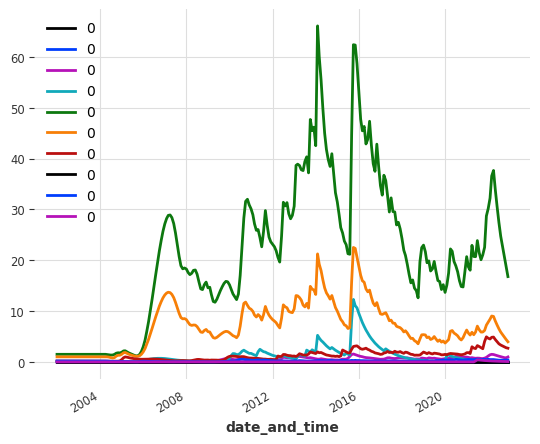

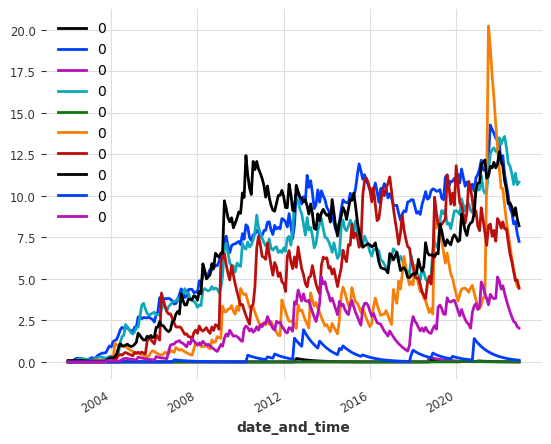

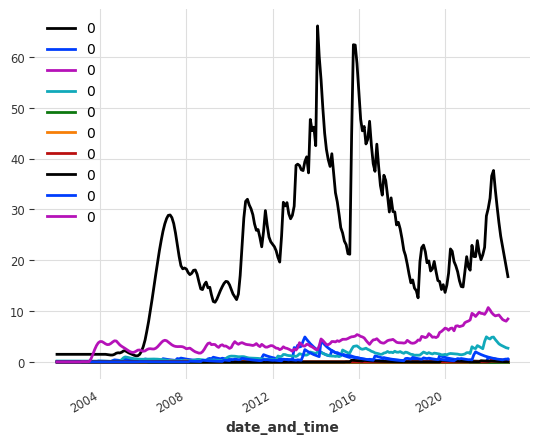

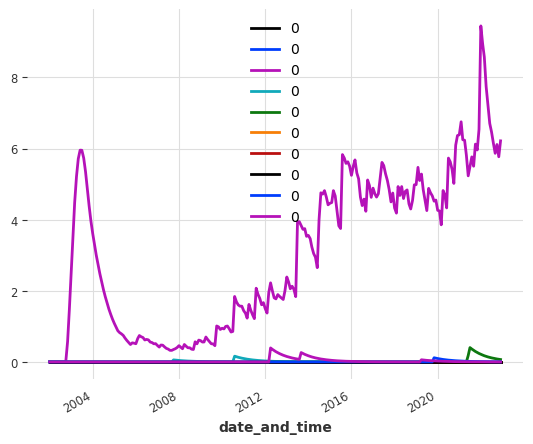

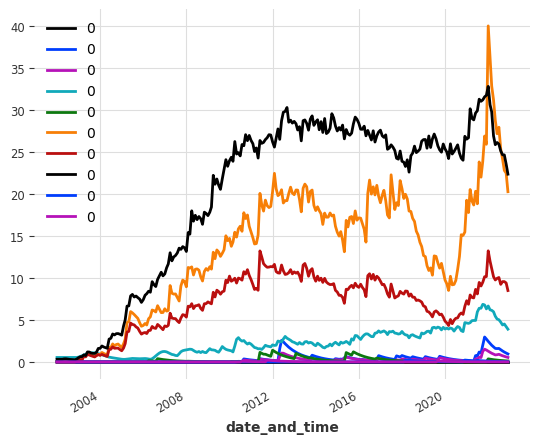

In [60]:
for i in range(1,7):
    mydfnow=dftm.loc[dftm['cluster']==i]

    nowlist =mydfnow['Time serie'].tolist()[40:50]
    for ele in nowlist:
        ele.plot()
    plt.show()

In [61]:
dftm.dtypes

concept1      object
concept2      object
indextype     object
Time serie    object
cluster        int64
dtype: object

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


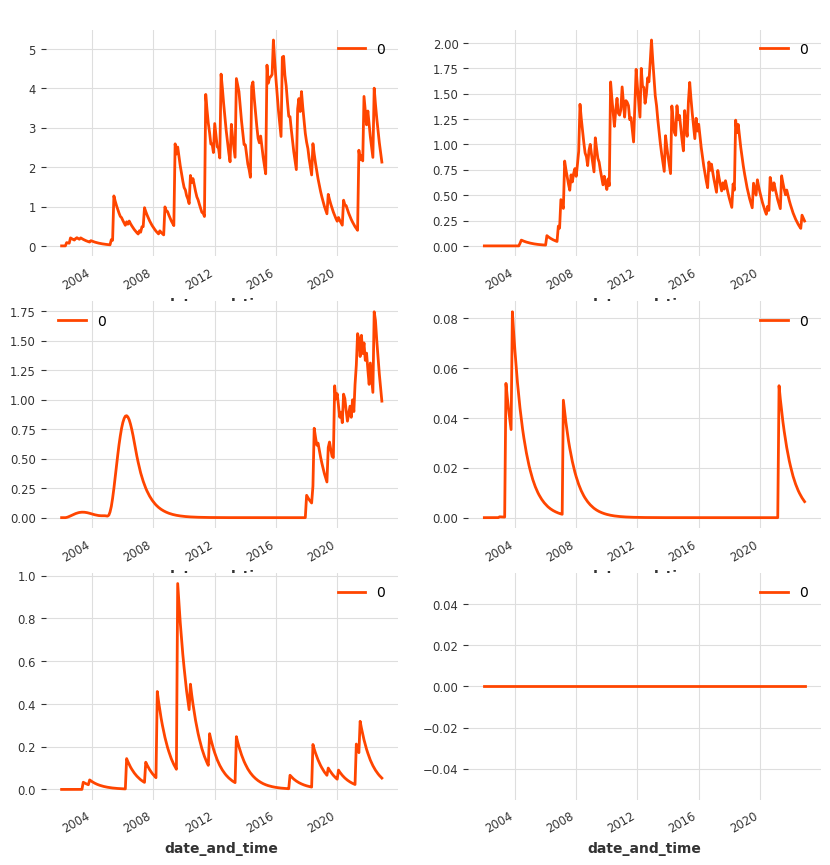

In [62]:
figure, ax = plt.subplots(3, 2, figsize=(10, 10), dpi=100)

for i, idx in enumerate([1, 20, 50, 103, 250, 300]):
    axis = ax[i % 3, i % 2]
    dftm.loc[idx]['Time serie'].plot(ax=axis,c="orangered",lw=2,)
    axis.legend(dftm.loc[idx]['Time serie'].components)
    axis.set_title(" ");

<div class="alert-info">
4. Auxiliary function for forecasting
</div>

Defining auxiliary functions, I will use in my forecasting analyses.

We define a handy function to tell us how good a bunch of forecasted series are:

In [63]:
def mysmape(preds, test_series): 
    listsmapes = []
    vector_local_variances = []
    vector_all_errors = []
    for j in range(len(preds)):
        actual = [x[0] for x in TimeSeries.values(preds[j])]
        forecast=[x[0] for x in TimeSeries.values(test_series[j])]
        actual_new = []
        forecast_new = []
        for i in range(len(actual)):
            if actual[i]!=0 and forecast[i]!=0:
                actual_new.append(actual[i])
                forecast_new.append(forecast[i])
        actual_new = np.array(actual_new)
        forecast_new = np.array(forecast_new)
        listsmapes.append(100*np.sum(2*np.abs(forecast_new - actual_new) / \
        (np.abs(actual_new) + np.abs(forecast_new)))/len(actual))
        
        vector_errors=[]
        for i in range(len(actual)):
            vector_errors.append(abs(actual[i]-forecast[i]))
            
        vector_local_variances.append(np.var(vector_errors))
        
        vector_all_errors = vector_all_errors+vector_errors
    
    var_allerrors = np.var(vector_all_errors)
    var_mean_var = np.mean(vector_local_variances)
    
    return listsmapes,var_allerrors,var_mean_var

In [64]:
def plot_error_var_local(forecaster,horizon,df,mean_allvar):
    model_loaded = forecaster.load("my_model.pkl")
    
    preds = list(TimeSeries.pd_series(model_loaded.predict(n=horizon)))

    actualtm = list(TimeSeries.pd_series(df['Time serie'].tolist()[-1])) 
    
    preds_minusvar =actualtm[:-horizon]
    preds_plusvar = actualtm[:-horizon]
    predictions = actualtm[:-horizon]+preds
    
    for j in range(horizon):
        preds_minusvar.append(preds[j]-np.mean(mean_allvar)) 
        preds_plusvar.append(preds[j]+np.mean(mean_allvar)) 
    
    x_cor =np.arange(0,len(actualtm))
    plt.plot(x_cor,predictions,x_cor,preds_plusvar,x_cor,preds_minusvar)
    
    plt.show()

In [65]:
def plot_error_var_global(forecaster,horizon,df,mean_allvar):
    model_loaded = forecaster.load("my_model.pkl")
    
    preds = list(TimeSeries.pd_series(model_loaded.predict(n=horizon,series=df['Train tm'].tolist()[-1])))

    actualtm = list(TimeSeries.pd_series(df['Time serie'].tolist()[-1])) 
    
    preds_minusvar =actualtm[:-horizon]
    preds_plusvar = actualtm[:-horizon]
    predictions = actualtm[:-horizon]+preds
    
    for j in range(horizon):
        preds_minusvar.append(preds[j]-np.mean(mean_allvar)) 
        preds_plusvar.append(preds[j]+np.mean(mean_allvar)) 
    
    x_cor =np.arange(0,len(actualtm))
    plt.plot(x_cor,predictions,x_cor,preds_plusvar,x_cor,preds_minusvar)
    
    plt.show()

In [66]:
def cross_validation_splitting_window_local(data,horizon,list_concepts,number_cv,modelname,forecaster,**kwargs):
    
    time1=time.time()
    
    maximal_train_len = 252-horizon
    score_forecaster = []
    allsmapes = []
    
    mean_allvar= []
    var_alltheerrors = []
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =maximal_train_len//number_cv
            startingtime = i*windowslength
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_local_model(df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,\
                              modelname,forecaster,**kwargs)
            
        else:
            windowslength = maximal_train_len-(number_cv-1)*(maximal_train_len//number_cv) # to get the remaining window
            startingtime = i*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_local_model(df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
            
        score_forecaster.append(np.median(smapes))
        allsmapes.append(smapes)
        # I save the mean of the all the smapes done over one window
        
        var_alltheerrors.append(var_allerrors)
        mean_allvar.append(var_mean_var)
        
        
    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    eval_kcross_forecasts(allsmapes,modelname)


    
    return elapsed_time,np.mean(myscores),np.median(myscores),np.mean(var_allerrors),np.mean(mean_allvar)

In [67]:
def cross_validation_expanding_window_local(data,horizon,list_concepts,number_cv,modelname,forecaster,**kwargs):
    
    time1=time.time()
    
    
    startingtime=0
    maximal_train_len = 252-horizon
    score_forecaster = []
    allsmapes = []
    
    mean_allvar= []
    var_alltheerrors = []
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =(i+1)*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var=eval_local_model(df['Train tm'].tolist(),\
            df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
            
        else:
            windowslength = maximal_train_len
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var=eval_local_model(df['Train tm'].tolist(),\
            df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
        
        allsmapes.append(smapes)
        
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window
        
        var_alltheerrors.append(var_allerrors)
        mean_allvar.append(var_mean_var)
        

    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
        
    eval_kcross_forecasts(allsmapes,modelname)


    return elapsed_time,np.mean(myscores),np.median(myscores),np.mean(var_allerrors),np.mean(mean_allvar)

In [68]:
def cross_validation_splitting_window_global(data,horizon,list_concepts,number_cv,modelname,forecaster,**kwargs):
    
    time1=time.time()
    
    maximal_train_len = 252-horizon
    score_forecaster = []
    allsmapes=[]
    
    mean_allvar= []
    var_alltheerrors = []
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =maximal_train_len//number_cv
            startingtime = i*windowslength
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_global_model(df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
            
        else:
            windowslength = maximal_train_len-(number_cv-1)*(maximal_train_len//number_cv) # to get the remaining window
            startingtime = i*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_global_model(df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
        
        allsmapes.append(smapes)
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window
        
        var_alltheerrors.append(var_allerrors)
        mean_allvar.append(var_mean_var)
        
    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    eval_kcross_forecasts(allsmapes,modelname)
    
    return elapsed_time,np.mean(myscores),np.median(myscores),np.mean(var_allerrors),np.mean(mean_allvar)

In [69]:
def cross_validation_expanding_window_global(data,horizon,list_concepts,number_cv,modelname,forecaster,**kwargs):
    
    time1=time.time()
    
    startingtime=0
    maximal_train_len = 252-horizon
    score_forecaster = []
    allsmapes=[]
    
    mean_allvar= []
    var_alltheerrors = []
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =(i+1)*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_global_model(df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
            
        else:
            windowslength = maximal_train_len
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_global_model(df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
            
        
        allsmapes.append(smapes)
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window
        
        var_alltheerrors.append(var_allerrors)
        mean_allvar.append(var_mean_var)

    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    eval_kcross_forecasts(allsmapes,modelname)

    return elapsed_time,np.mean(myscores),np.median(myscores),np.mean(var_allerrors),np.mean(mean_allvar)

In [70]:
def creating_train_test_tm(dftm,startingtime,windowslength,horizon,list_concepts):

    listconcept1=[]
    listconcept2=[]
    listindextype=[]
    
    listdartstm=[]
    listtraintm=[]
    listtesttm=[]
    listcluster=[]

    for concept1 in list_concepts:
        dfconcept1 = dftm.loc[dftm['concept1']==concept1]
        for concept2 in list_concepts:
            dfconcept2 = dfconcept1.loc[dfconcept1['concept2']==concept2]
            for index in list_indices:
                dfindex=dfconcept2.loc[dfconcept2['indextype']==index]
                if len(dfindex)!=0:
                    
                    mycluster = dfindex.cluster.tolist()[0]
                    mytimeseries=dfindex['Time serie'].tolist()[0]
                    if startingtime==0:
                        traintm=mytimeseries[:windowslength]
                    else:
                        traintm=mytimeseries[startingtime-1:startingtime+windowslength]
                        
                    testtm=mytimeseries[startingtime+windowslength:startingtime+windowslength+horizon]
                                    
                    listconcept1.append(concept1)
                    listconcept2.append(concept2)
                    listindextype.append(index)
                    listdartstm.append(mytimeseries)
                    listtraintm.append(traintm)
                    listtesttm.append(testtm)
                    listcluster.append(mycluster)
                    
    df = pd.DataFrame({'concept1':listconcept1,'concept2':listconcept2,'indextype':listindextype,
                         'Time serie':listdartstm,'Train tm':listtraintm,'Test tm':listtesttm,'cluster':listcluster})
    return df

In [71]:
def eval_kcross_forecasts(smapes,modelname):
    
    plt.figure(figsize=(10, 5))
    
    themedians = []
    labels = []
    
    for i in range(len(smapes)):
        themedians.append(np.median(smapes[i]))
        #plt.hist(smapes[i], bins=100,label='K-cross set'+str(i+1))
        labels = labels +['Trained on '+str((i+1)*(100//len(smapes)))+\
        ' % of the data, with a median smape of '+ str(round(np.median(smapes[i]),2))+' %.']
        
    plt.ylabel("Count")
    plt.xlabel("sMAPE")
    plt.title("The median sMAPE for "+str(modelname)+" : %.3f" % np.median(themedians))
    #plt.yscale('log')

    plt.hist(smapes,bins=100,histtype='barstacked',label=labels)
    
    plt.legend()
    plt.show()
    plt.close()

In [72]:
def plot_forecasting_models_local(modelnames,myforecasters,df,horizon,index):
    
    actual = df['Time serie'].tolist()[-1]
    actual.plot(label="Actual time series")
    for i in range(len(modelnames)):
        model = modelnames[i]
        forecaster = myforecasters[i]
        model_loaded = forecaster.load("forecasting_models/"+str(model)+"_model.pkl")
        preds = model_loaded.predict(n=horizon)
        preds.plot(label=model)
    
    plt.legend()
    plt.show()

In [73]:
def plot_forecasting_models_global(modelnames,models,df,horizon,index):
    
    actual = df['Time serie'].tolist()[-1]
    actual.plot(label="Actual time series")
    
    trainingdata = actual[:-horizon]

    
    for i in range(len(modelnames)):
        model = modelnames[i]
        forecaster = myforecasters[i]
        model_loaded = forecaster.load("forecasting_models/"+str(model)+"_model.pkl")
        preds = model_loaded.predict(n=horizon,series=trainingdata)
        preds.plot(label=model)
    
    plt.legend()
    plt.show()

In [74]:
def eval_local_model(train_series, test_series,horizon,modelname, model_cls, **kwargs):
    preds = []

    for series in tqdm(train_series):
        model = model_cls(**kwargs)
        model.fit(series)
        pred = model.predict(n=horizon)
        preds.append(pred)
    
    smapes,var_allerrors,var_mean_var = mysmape(preds, test_series)
    
    model.save("forecasting_models/"+str(modelname)+"_model.pkl")
    
    return smapes,var_allerrors,var_mean_var

In [75]:
def eval_global_model(train_series, test_series,horizon,modelname,model_cls, **kwargs):
    model = model_cls(**kwargs)

    if model_cls==NBEATSModel:
        model.fit(train_series, num_loader_workers=4, epochs=10)
    else:
        model.fit(train_series)
    preds = model.predict(n=horizon, series=train_series)

    smapes,var_allerrors,var_mean_var = mysmape(preds, test_series)
    
    model.save("forecasting_models/"+str(modelname)+"_model.pkl")
    
    return smapes,var_allerrors,var_mean_var

In [76]:
def plot_models(method_to_elapsed_times, method_to_smapes):
    shapes = ["o", "s", "*"]
    colors = ["tab:blue", "tab:orange", "tab:green", "tab:purple"]
    styles = list(product(shapes, colors))

    plt.figure(figsize=(6, 6), dpi=100)

    for i, method in enumerate(method_to_elapsed_times.keys()):

        t = method_to_elapsed_times[method]
        s = styles[i]
        plt.semilogx(
            [t],
            [np.mean(method_to_smapes[method])],
            s[0],
            color=s[1],
            label=method,
            markersize=13,
        )
    plt.xlabel("elapsed time [s]")
    plt.ylabel("Average sMAPE over all series")
    plt.legend(bbox_to_anchor=(1.4, 1.0), frameon=True)
    plt.show();

In [77]:
def plot_models_cluster(method_to_elapsed_times, method_to_smapes):
    shapes = ["o", "s", "*"]
    colors = ["tab:blue", "tab:orange", "tab:green", "tab:purple"]
    styles = list(product(shapes, colors))

    plt.figure(figsize=(6, 6), dpi=100)

    for i, method in enumerate(method_to_elapsed_times.keys()):

        t = method_to_elapsed_times[method]
        s = styles[i]
        plt.semilogx(
            [t],
            [np.mean(method_to_smapes[method])],
            s[0],
            color=s[1],
            label=method,
            markersize=13,
        )
    plt.xlabel("elapsed time [s]")
    plt.ylabel("Average sMAPE over all series")
    plt.legend(bbox_to_anchor=(1.4, 1.0), frameon=True)
    plt.show();

# **Part 1 -- Local forecasting**

Creating the dataframe I will use with an horizon of 3 months.

In [199]:
def local_forecasting(dftm,horizon,list_concepts,number_cv):
    
    # once I created my dataframe with this specific horizon I train and visualize the results of the forecasting algorithms
    
    naive1_time,naive1_smapes_mean,naive1_smapes_med,naive1_var_allerrors,naive1_mean_allvar =\
    cross_validation_expanding_window_local(dftm,\
    horizon,list_concepts,number_cv,'Naive_seasonal_k1',NaiveSeasonal, K=1)
    
    naive12_time,naive12_smapes_mean,naive12_smapes_med,naive12_var_allerrors,naive12_mean_allvar\
    =cross_validation_expanding_window_local(dftm,\
    horizon,list_concepts,number_cv,'Naive_seasonal_k12', NaiveSeasonal, K=12)
    
    ets_time,ets_smapes_mean,ets_smapes_med,ets_var_allerrors,ets_mean_allvar\
    =cross_validation_expanding_window_local(dftm,\
    horizon,list_concepts,number_cv,'ExponentialSmoothing',ExponentialSmoothing)
    
    theta_time,theta_smapes_mean,theta_smapes_med,theta_var_allerrors,theta_mean_allvar\
    =cross_validation_expanding_window_local(dftm,\
    horizon,list_concepts,number_cv,'Theta', Theta, theta=1.5,season_mode=SeasonalityMode.ADDITIVE)
    
    
    smapes_mean = {
    "naive-last": naive1_smapes_mean,
    "naive-seasonal": naive12_smapes_mean,
    "Exponential Smoothing": ets_smapes_mean,
    "Theta": theta_smapes_mean
    }
    
    smapes_med = {
    "naive-last": naive1_smapes_med,
    "naive-seasonal": naive12_smapes_med,
    "Exponential Smoothing": ets_smapes_med,
    "Theta": theta_smapes_med
    }

    elapsed_times = {
    "naive-last": naive1_time,
    "naive-seasonal": naive12_time,
    "Exponential Smoothing": ets_time,
    "Theta": theta_time
    }
    
    # We compare models with respect to precision and computational cost.
    print('Visualization of performances taking the mean of the smapes over cross-validation')
    plot_models(elapsed_times, smapes_mean)
    
    print('Visualization of performances taking the median of the smapes over cross-validation')
    plot_models(elapsed_times, smapes_med)
    
    return naive1_smapes_mean,naive12_smapes_mean,ets_smapes_mean,theta_smapes_mean,naive1_var_allerrors,naive1_mean_allvar,naive12_var_allerrors,naive12_mean_allvar,ets_var_allerrors,ets_mean_allvar,theta_var_allerrors,theta_mean_allvar

In [166]:
list_indices=['index_cit_t1_t2','index_cit_t2_t1','index_colab_increm','index_colab_notincrem','index_keyword']

In [78]:
dftm

,concept1,concept2,indextype,Time serie,cluster
0,Authentication protocole,Authentication protocole,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",1
1,Authentication protocole,Authentication protocole,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
2,Authentication protocole,Authentication protocole,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
3,Authentication protocole,Authentication protocole,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
4,Authentication protocole,Authentication protocole,index_keyword,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
...,...,...,...,...,...
2345,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",2
2346,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",2
2347,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",3
2348,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",5


In [168]:
myforecasters = [NaiveSeasonal,NaiveSeasonal,ExponentialSmoothing,Theta]

In [169]:
modelnames = ["Naive_seasonal_k1","Naive_seasonal_k12","ExponentialSmoothing","Theta"]

The results for index_cit_t1_t2 are:
The results for index_cit_t1_t2 with an horizon of 3 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

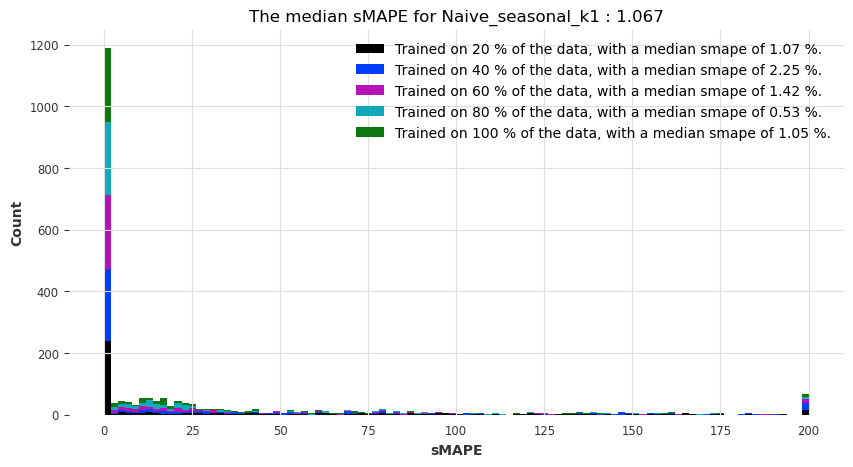

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

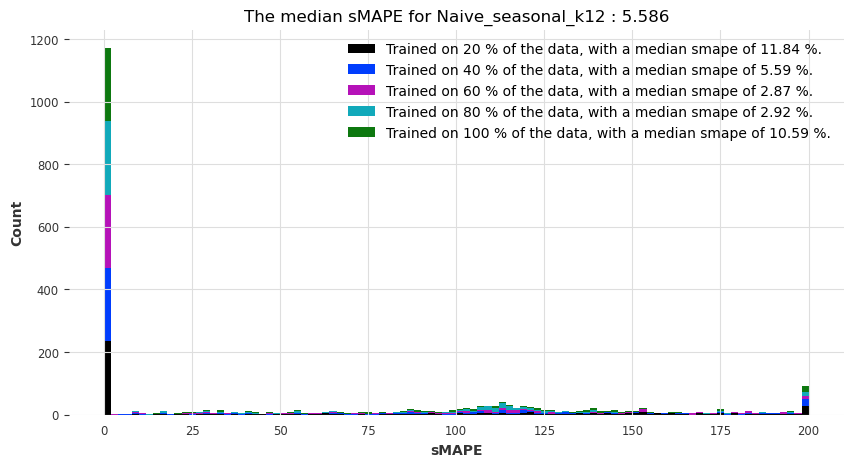

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

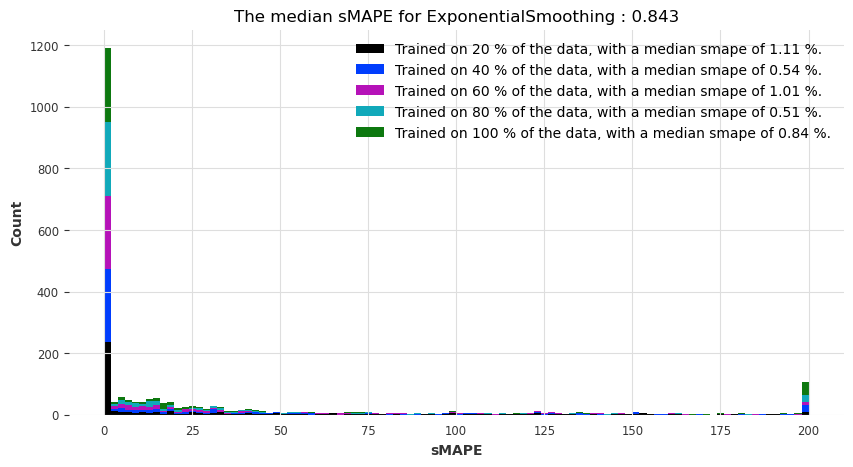

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

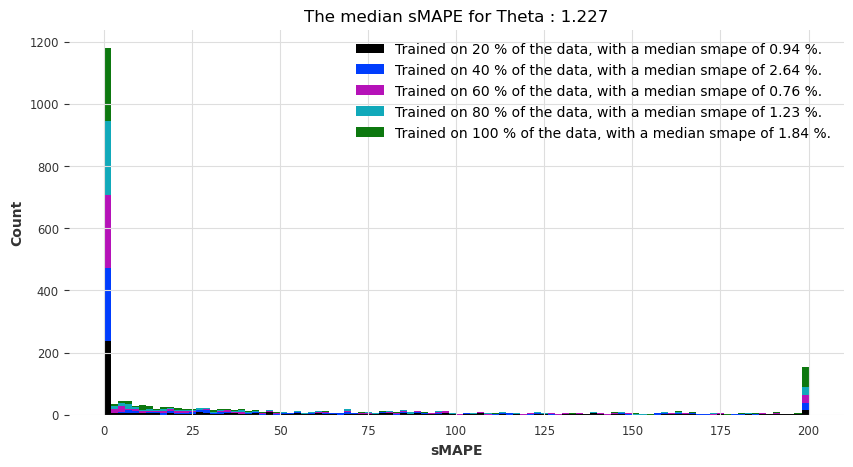

Visualization of performances taking the mean of the smapes over cross-validation


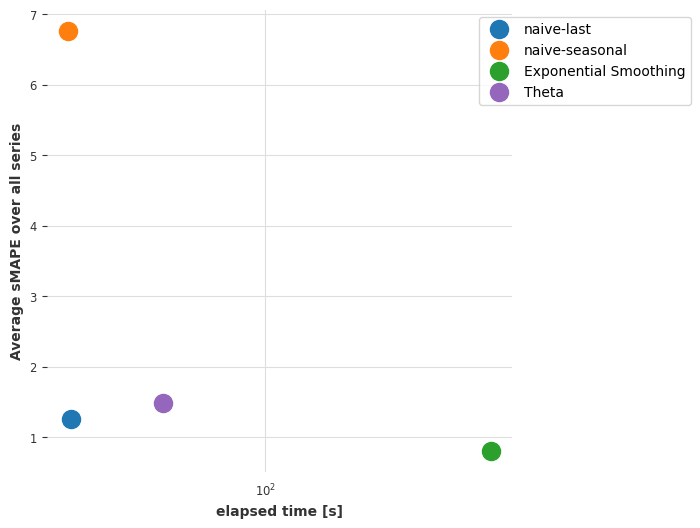

Visualization of performances taking the median of the smapes over cross-validation


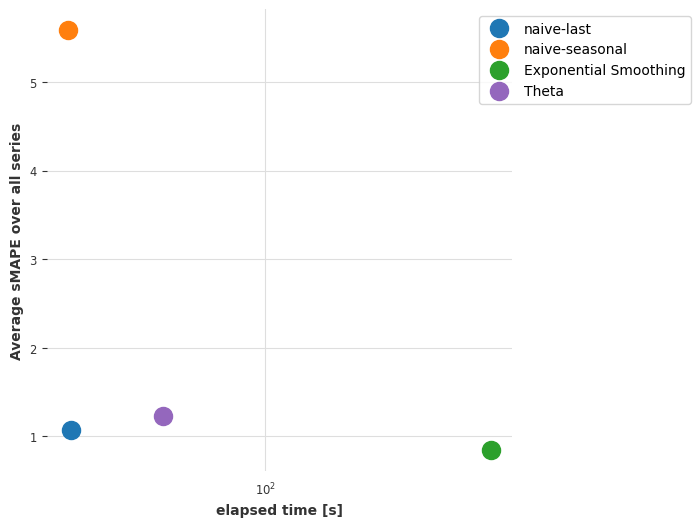

The results for index_cit_t1_t2 with an horizon of 6 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

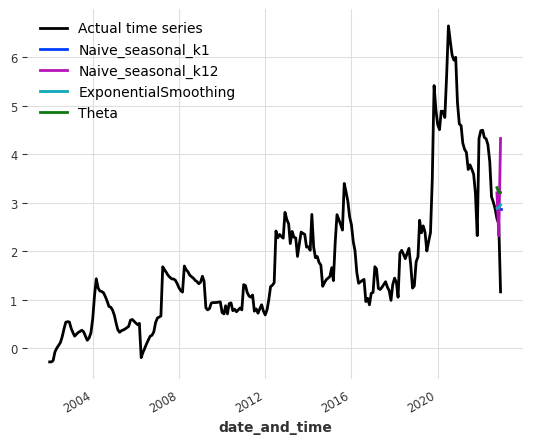

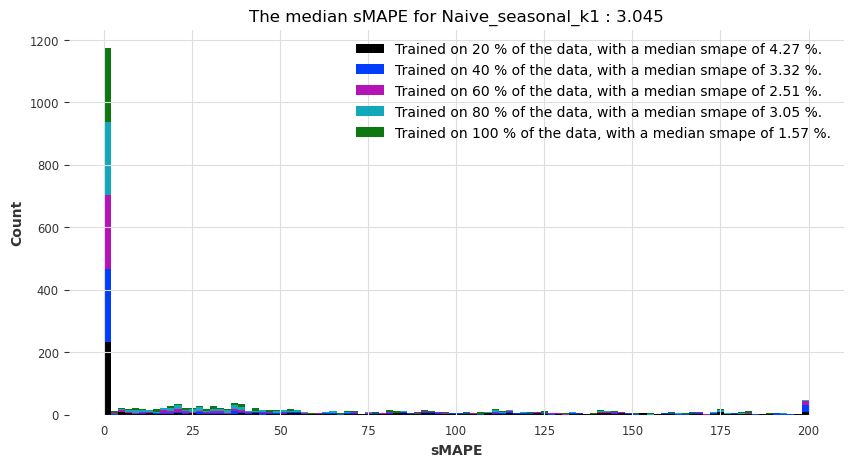

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

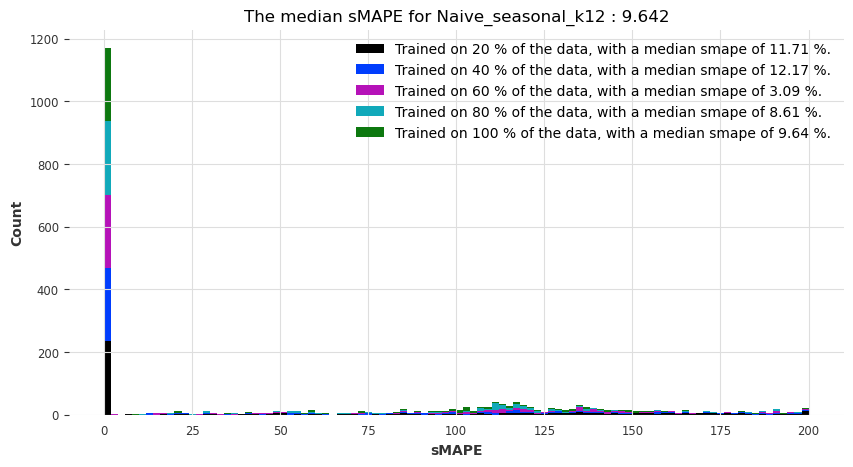

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

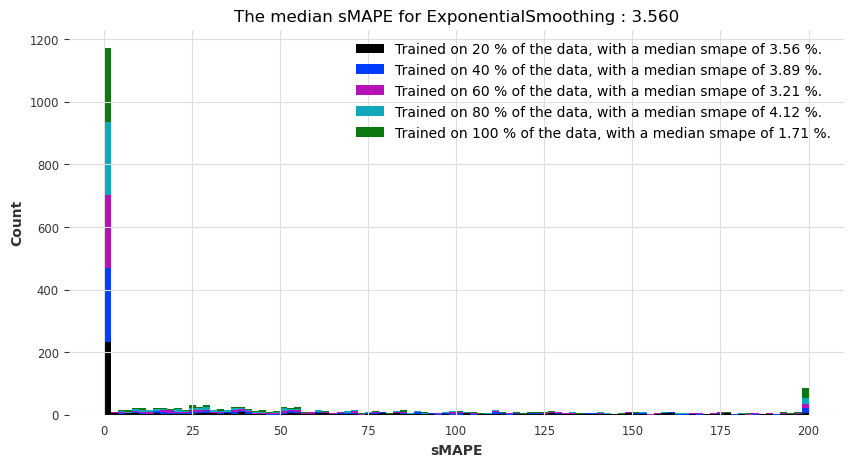

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

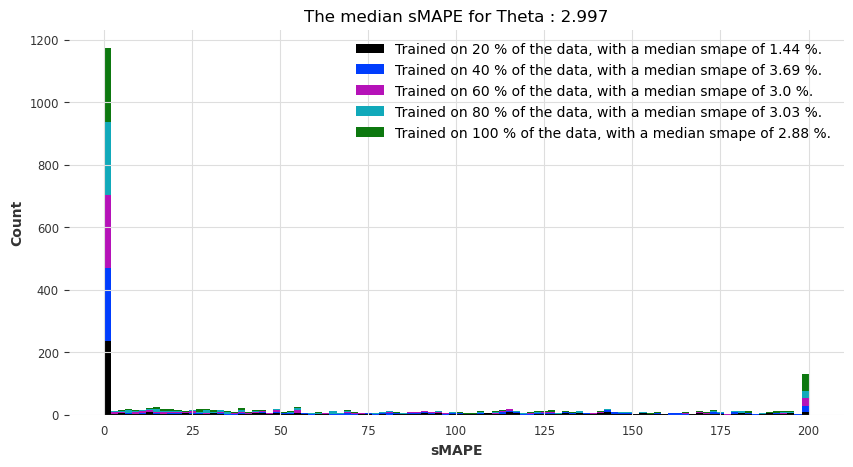

Visualization of performances taking the mean of the smapes over cross-validation


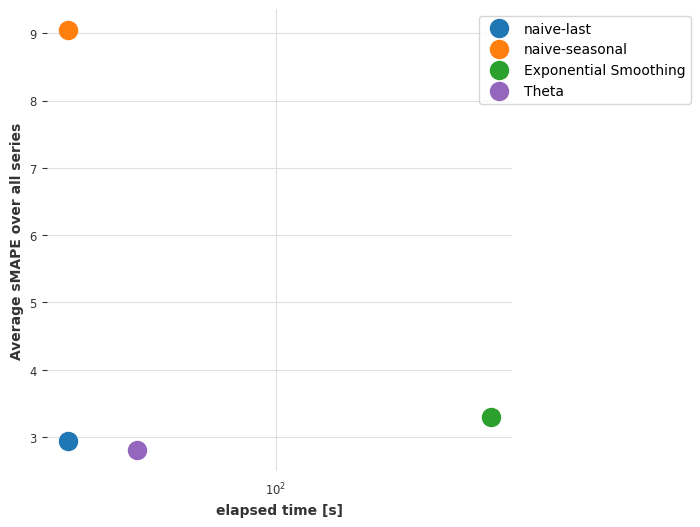

Visualization of performances taking the median of the smapes over cross-validation


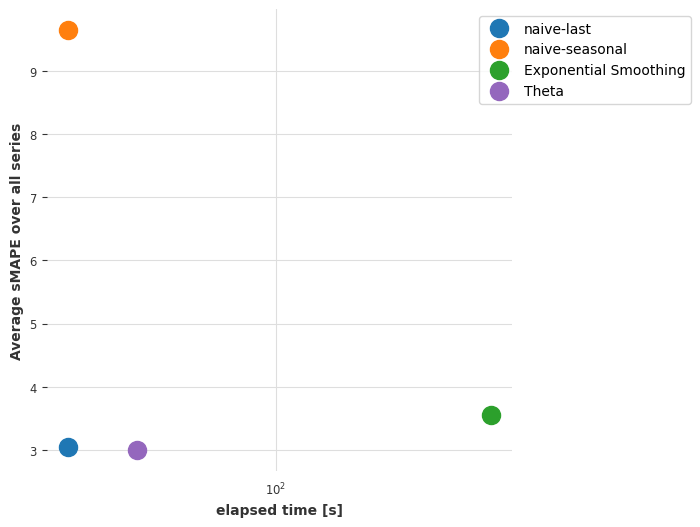

The results for index_cit_t1_t2 with an horizon of 12 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

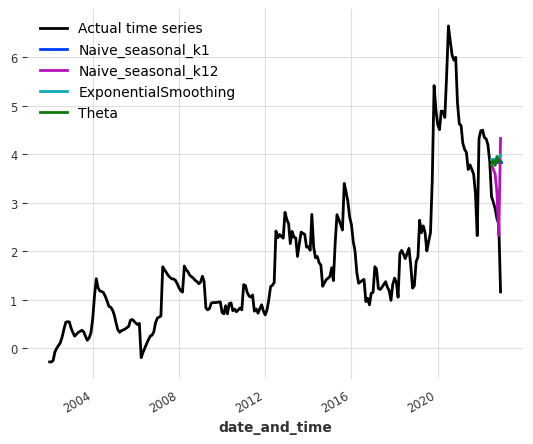

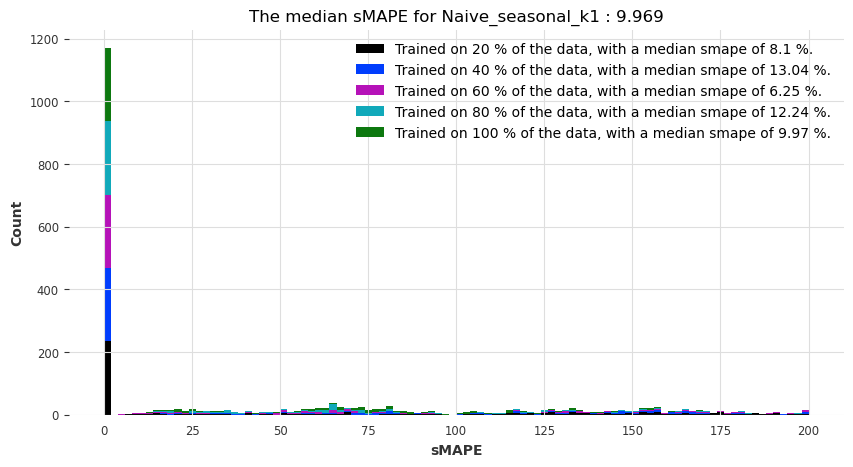

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

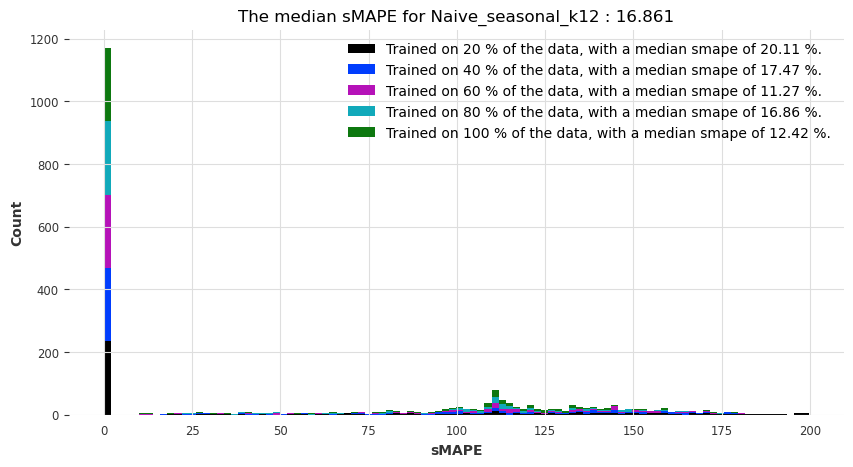

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

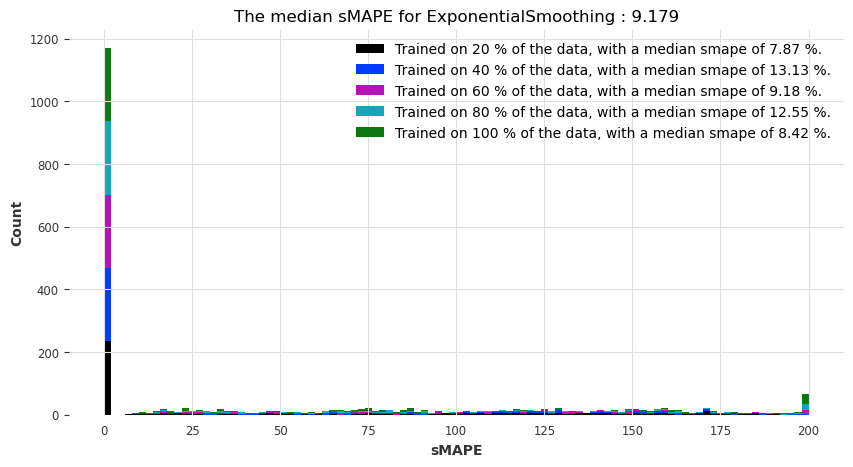

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

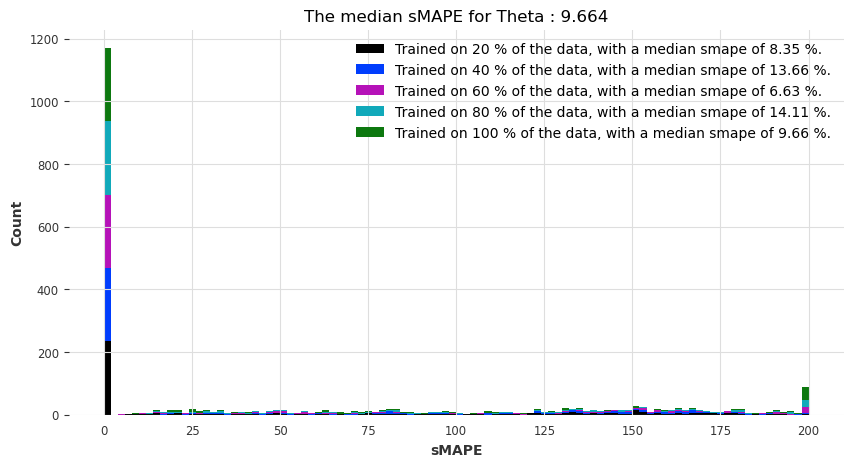

Visualization of performances taking the mean of the smapes over cross-validation


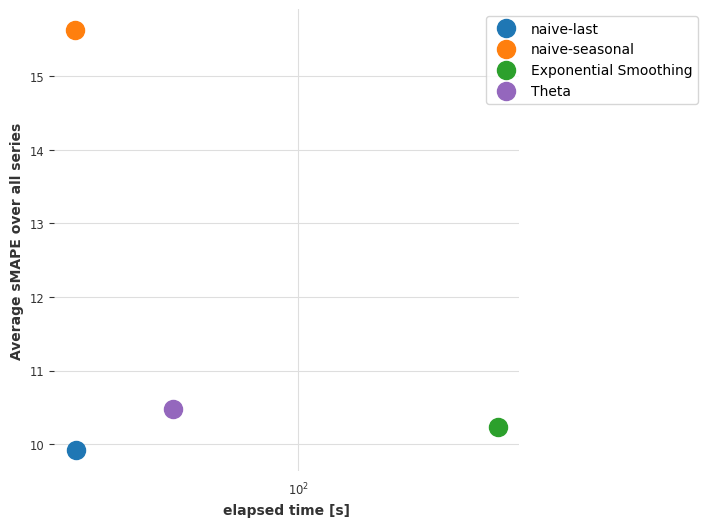

Visualization of performances taking the median of the smapes over cross-validation


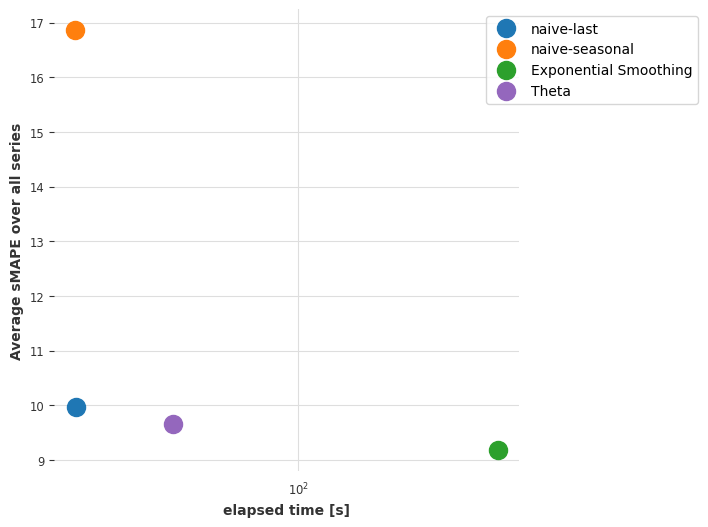

The results for index_cit_t2_t1 are:
The results for index_cit_t2_t1 with an horizon of 3 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

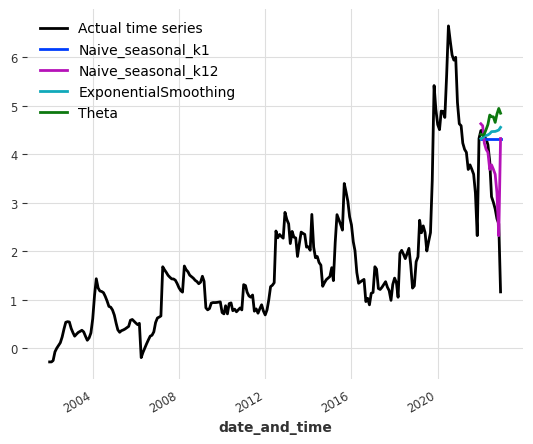

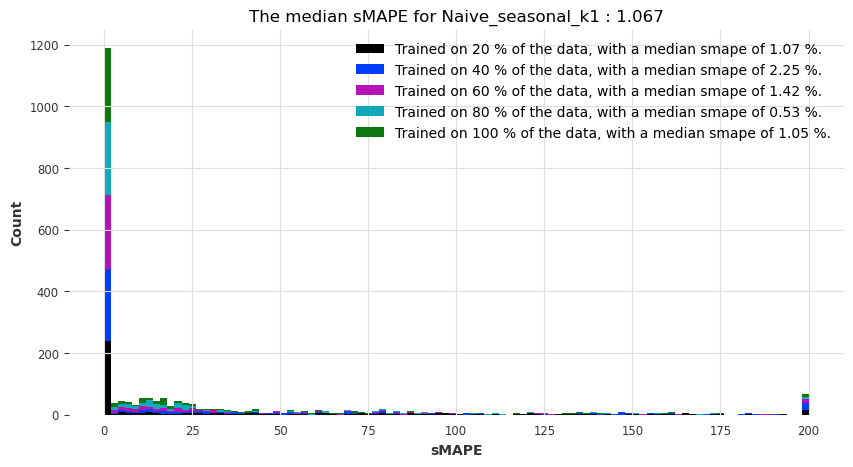

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

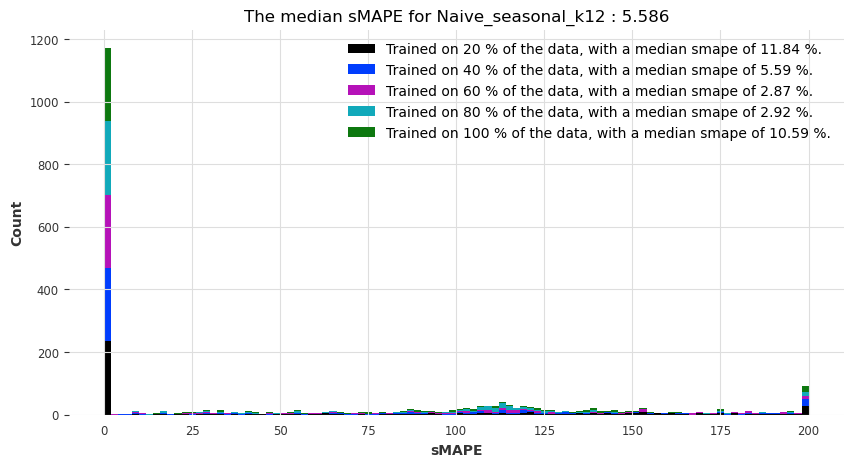

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

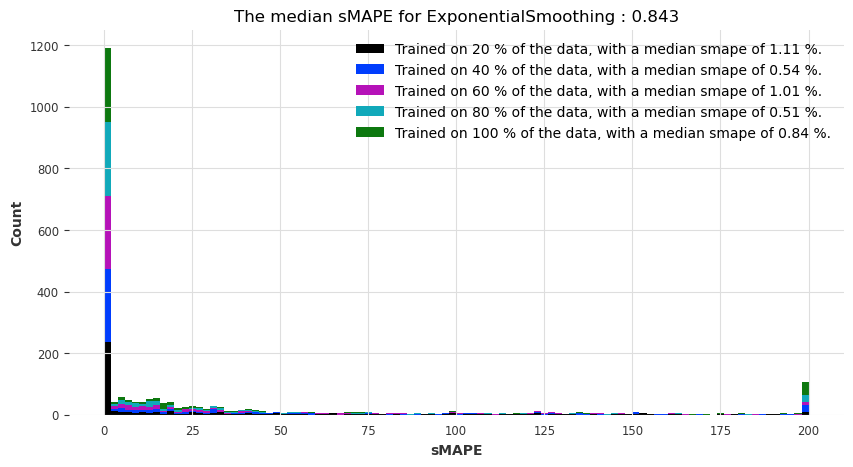

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

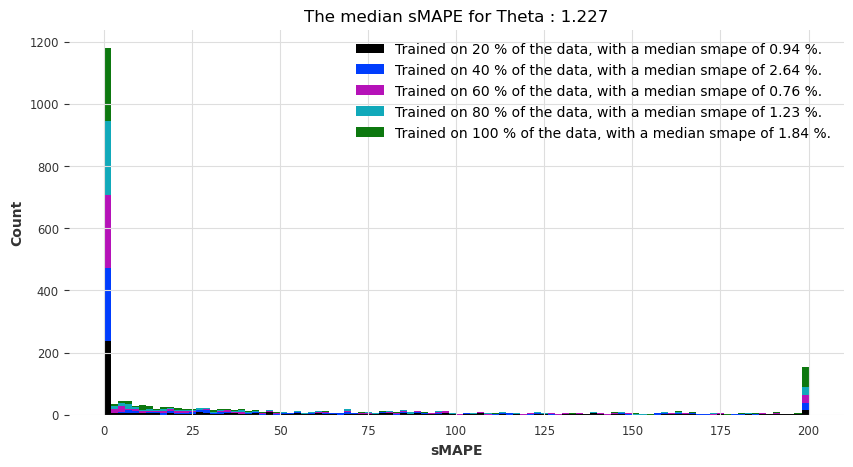

Visualization of performances taking the mean of the smapes over cross-validation


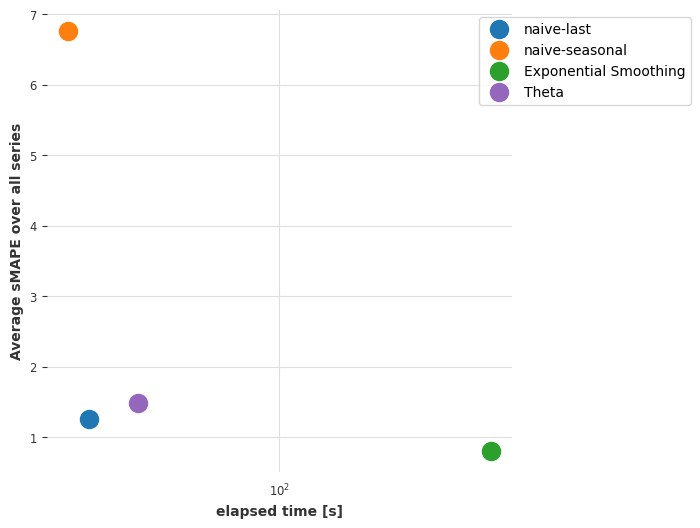

Visualization of performances taking the median of the smapes over cross-validation


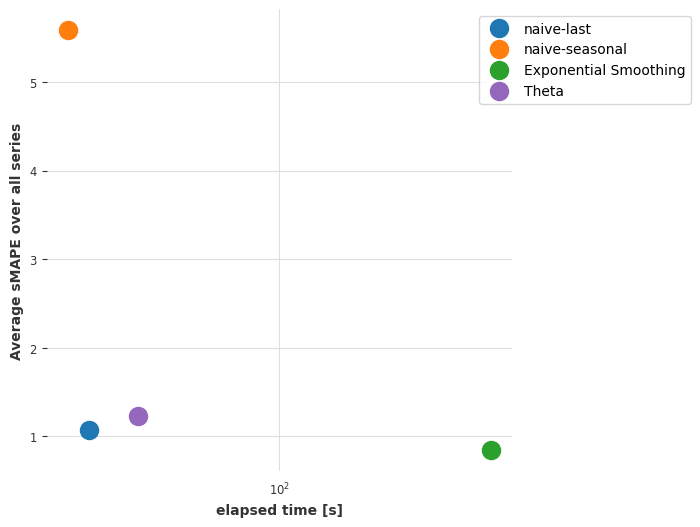

The results for index_cit_t2_t1 with an horizon of 6 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

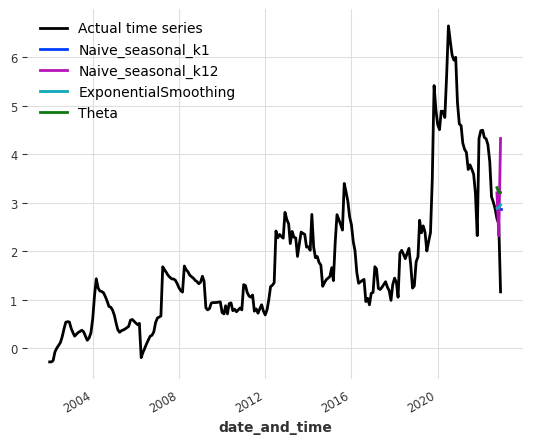

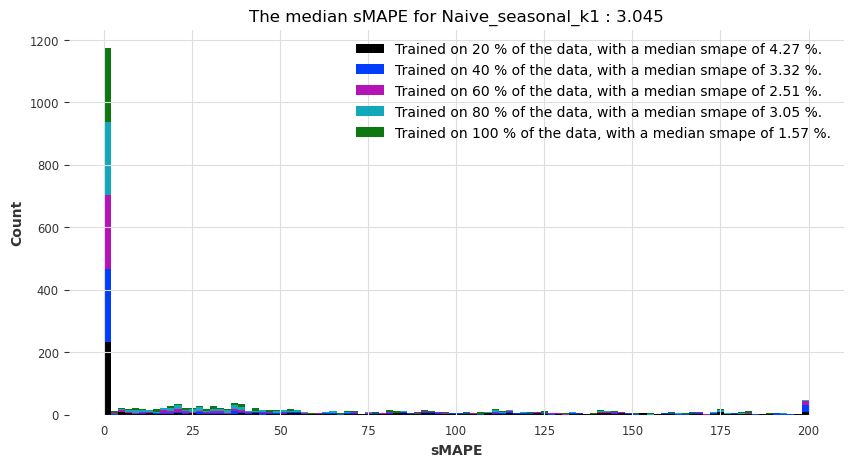

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

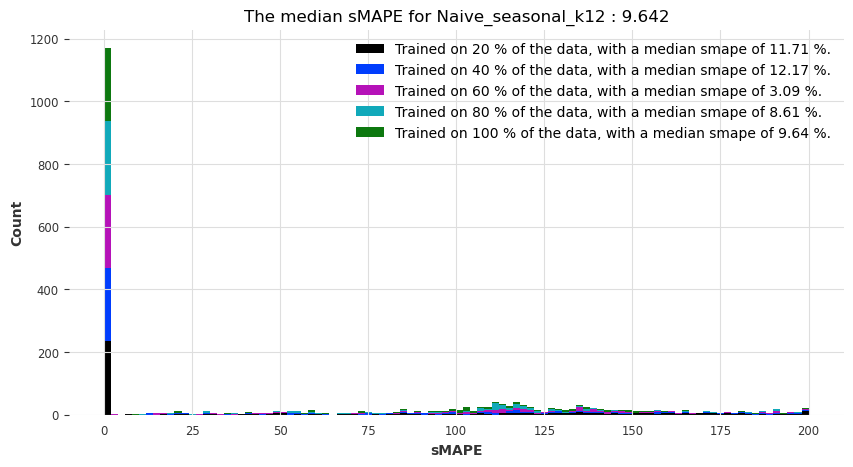

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

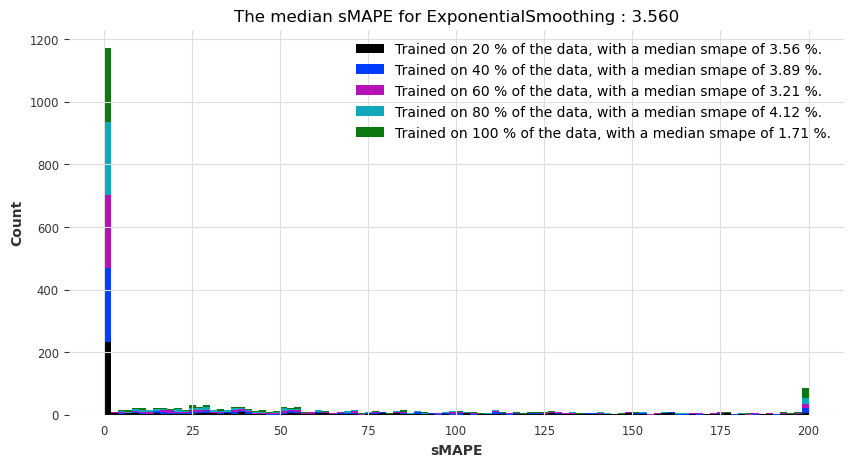

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

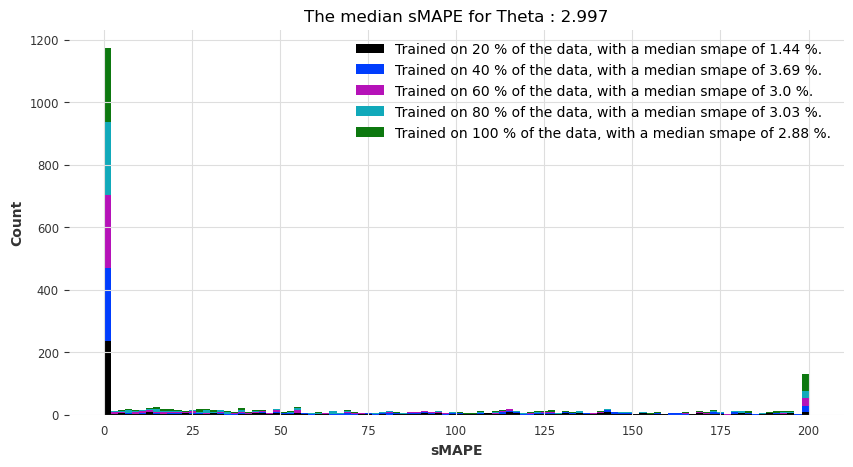

Visualization of performances taking the mean of the smapes over cross-validation


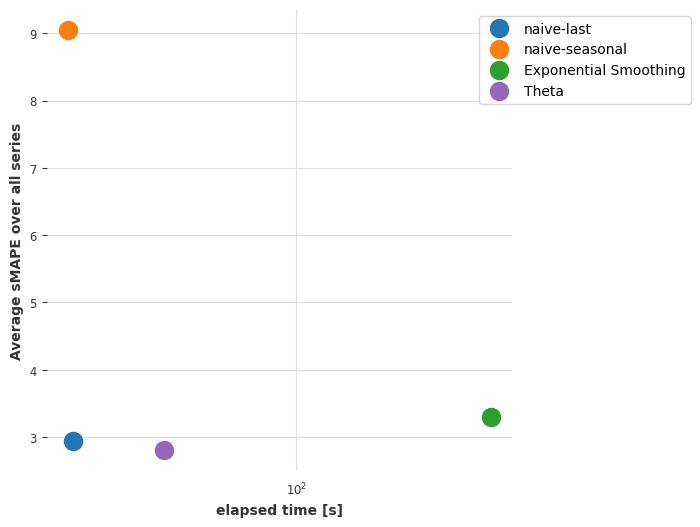

Visualization of performances taking the median of the smapes over cross-validation


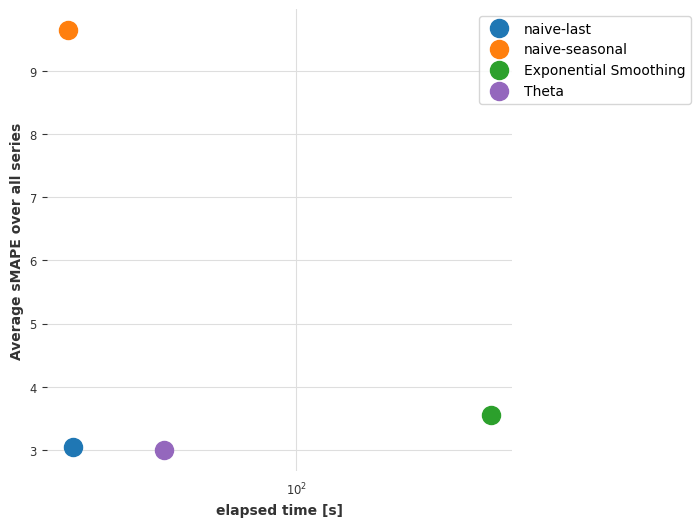

The results for index_cit_t2_t1 with an horizon of 12 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

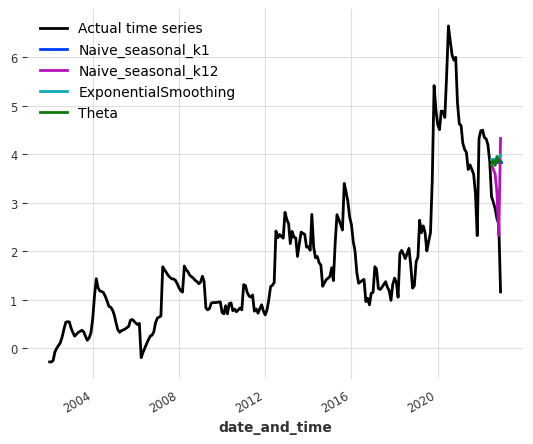

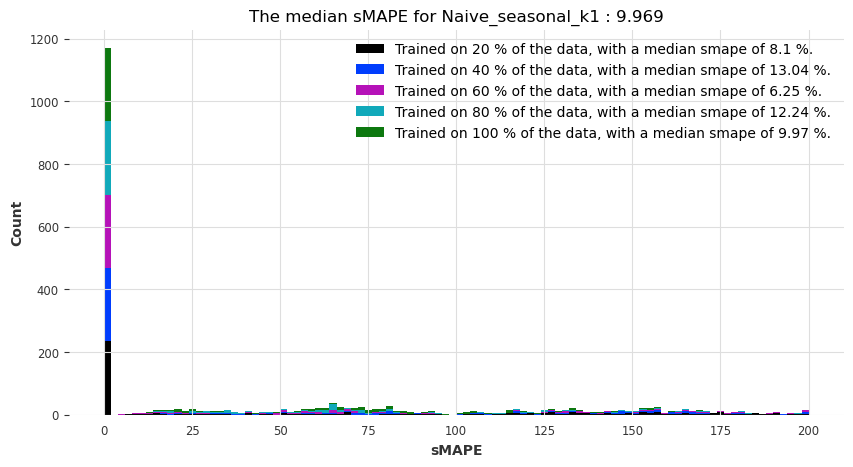

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

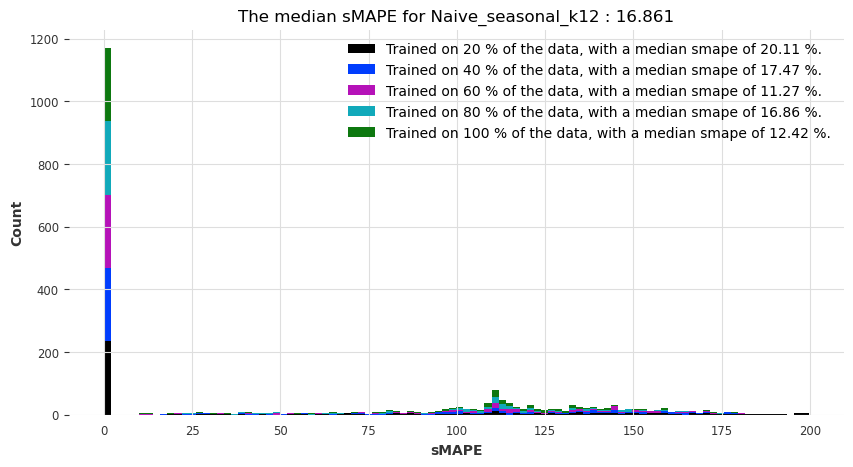

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

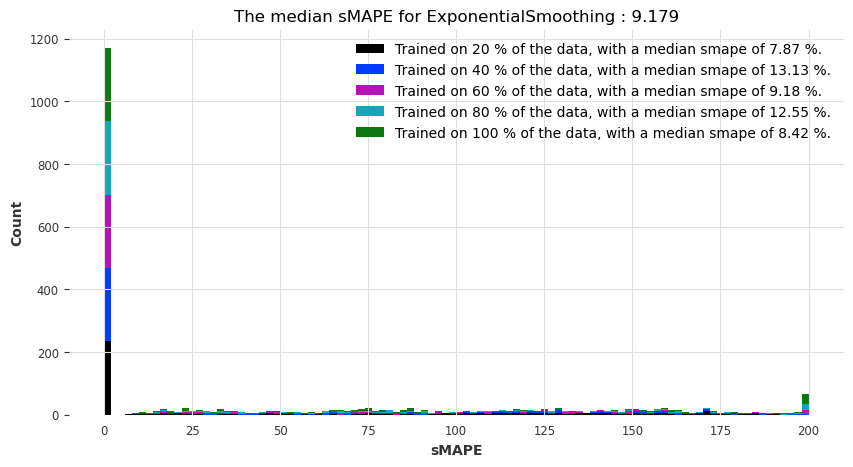

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

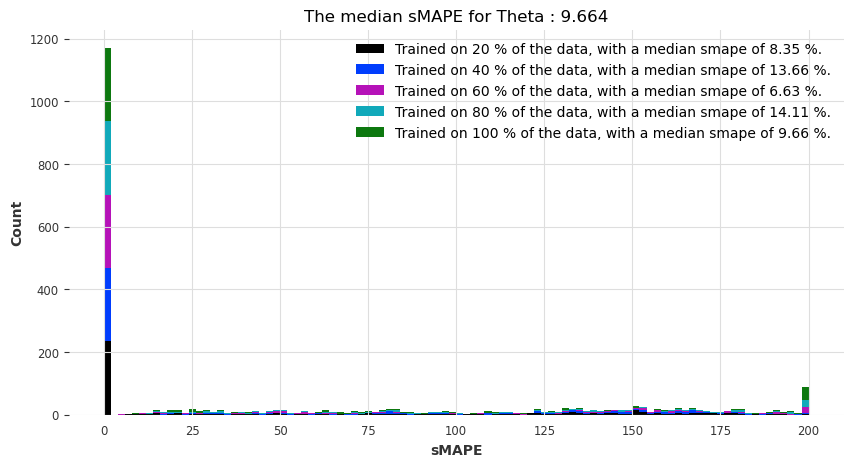

Visualization of performances taking the mean of the smapes over cross-validation


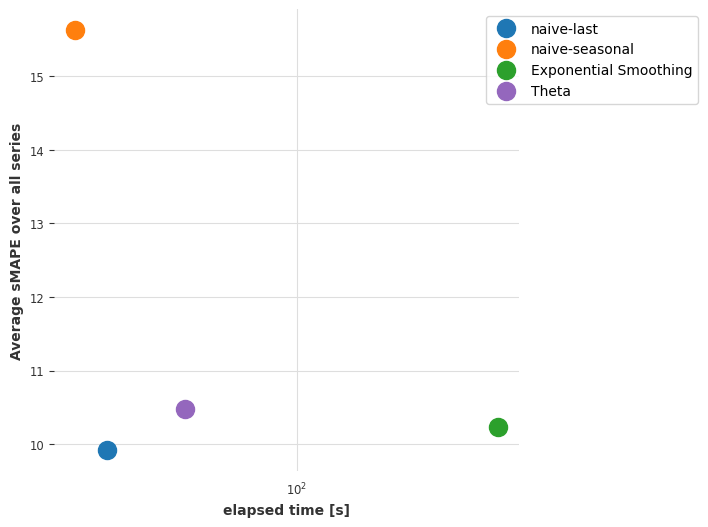

Visualization of performances taking the median of the smapes over cross-validation


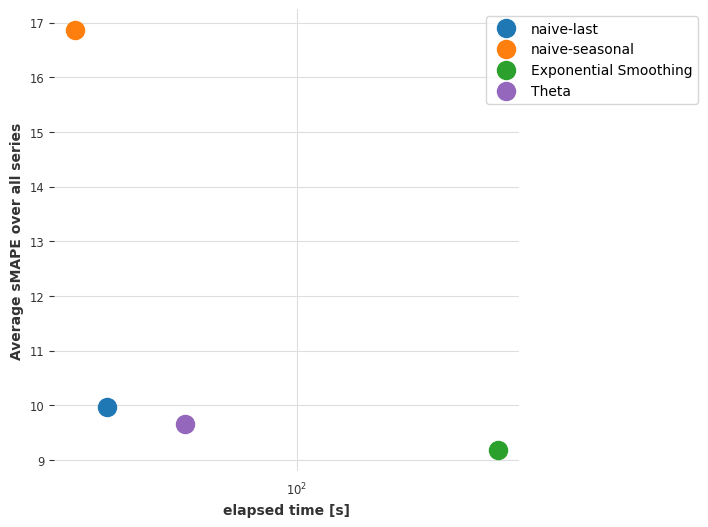

The results for index_colab_increm are:
The results for index_colab_increm with an horizon of 3 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

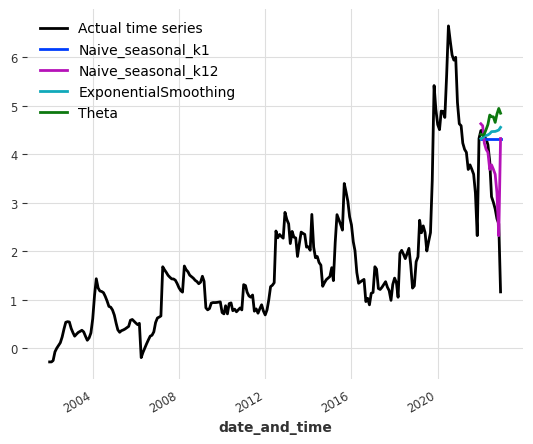

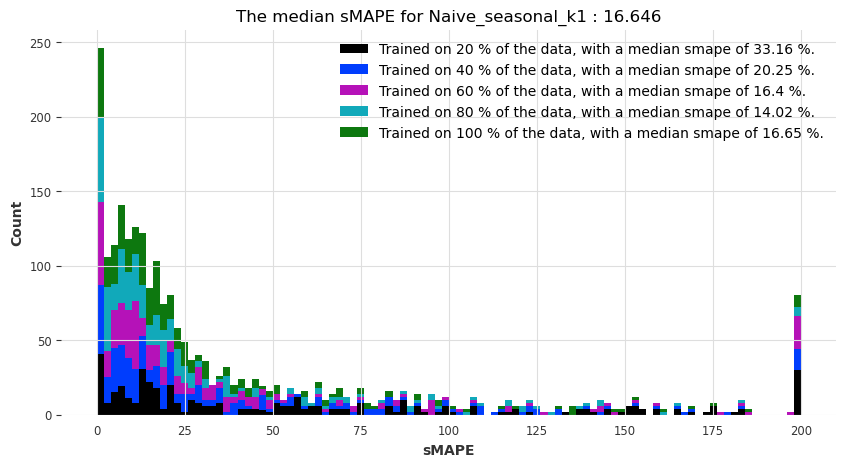

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

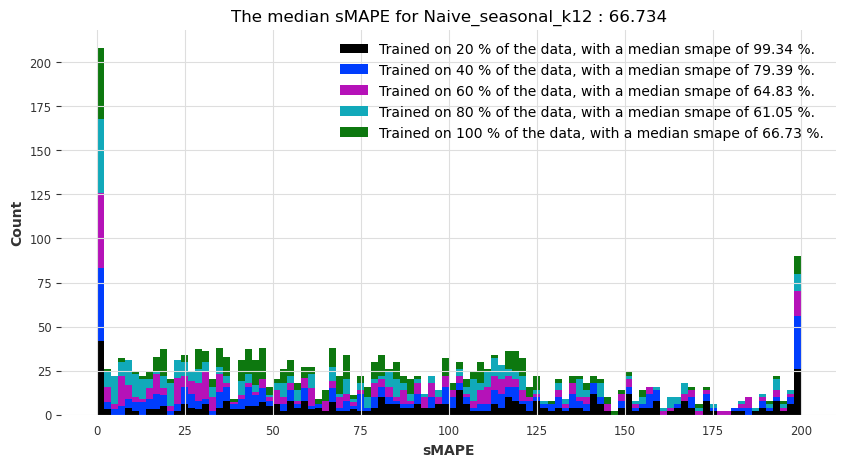

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

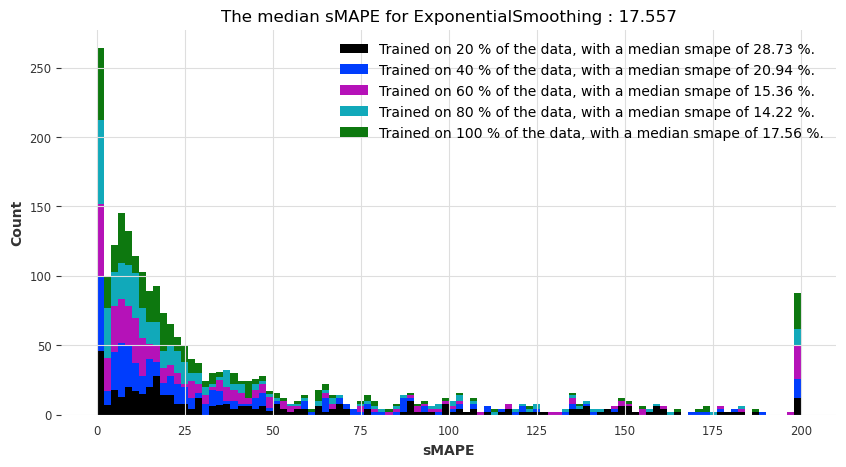

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

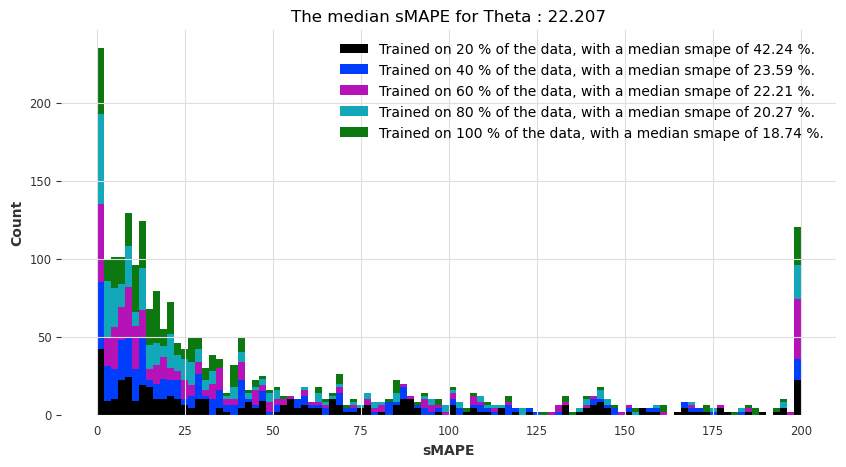

Visualization of performances taking the mean of the smapes over cross-validation


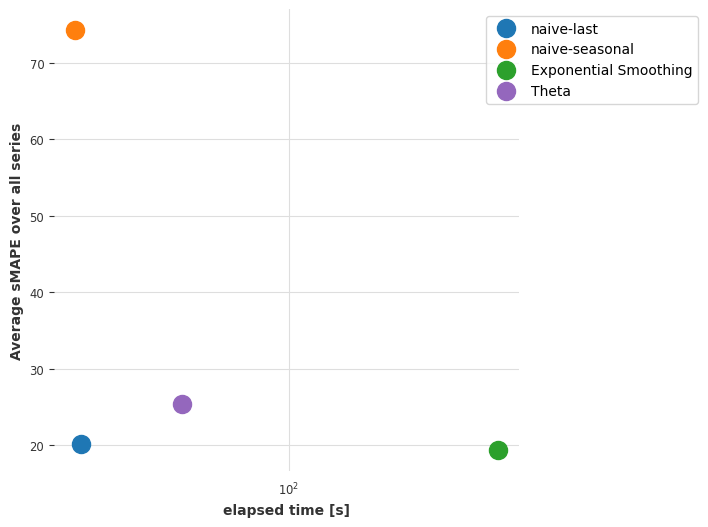

Visualization of performances taking the median of the smapes over cross-validation


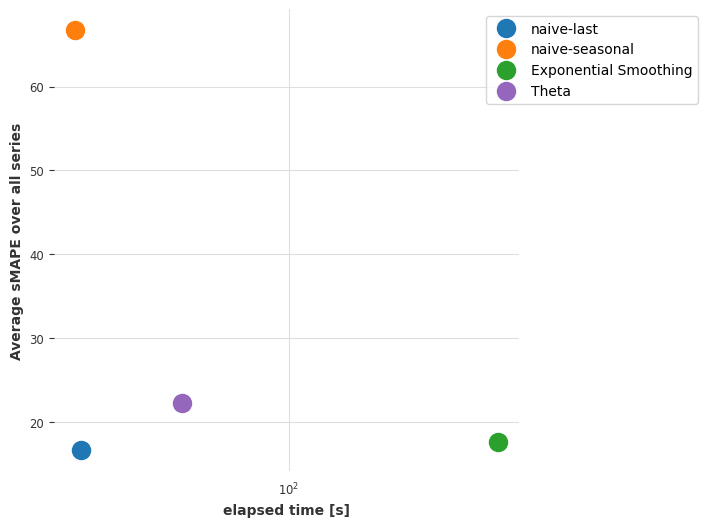

The results for index_colab_increm with an horizon of 6 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

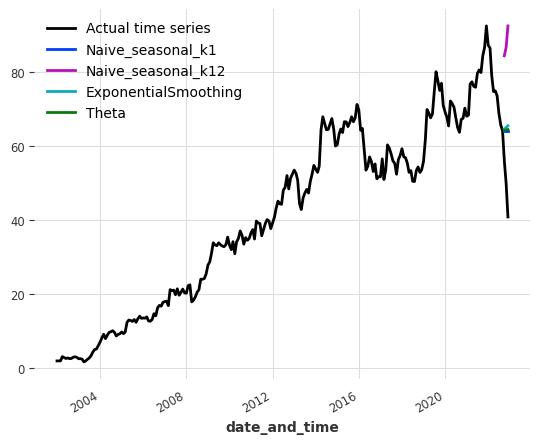

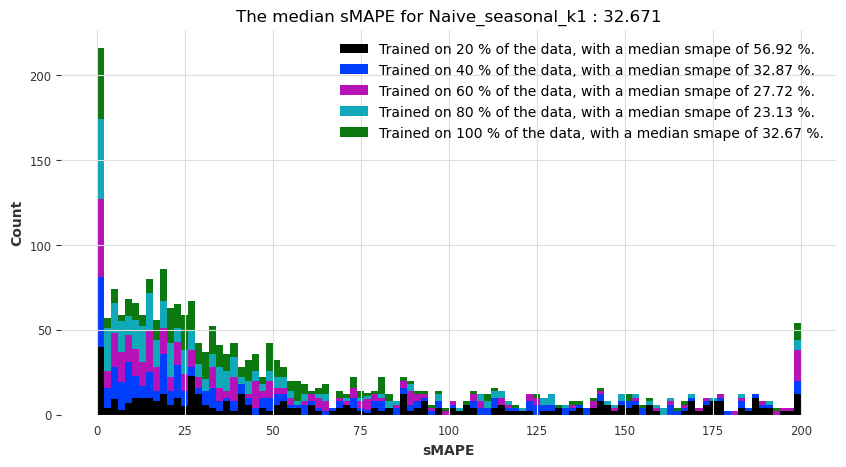

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

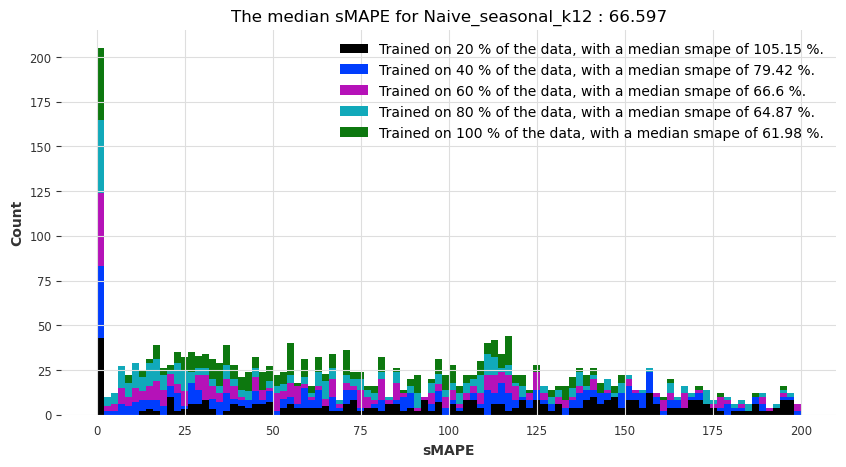

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

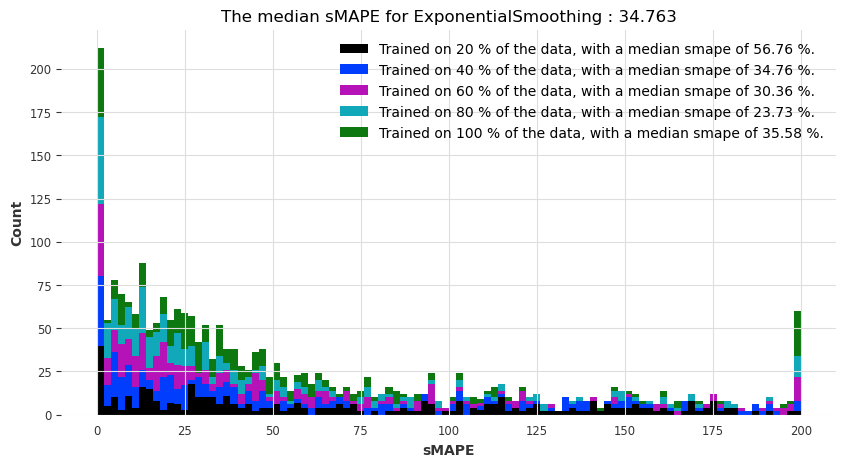

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

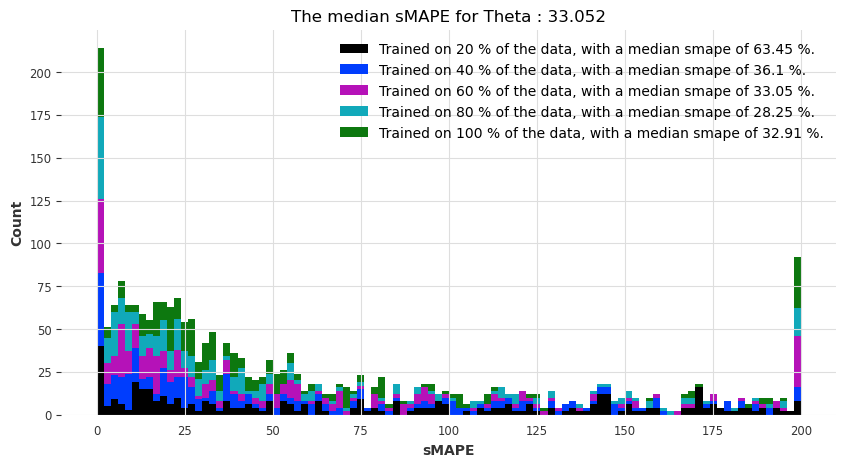

Visualization of performances taking the mean of the smapes over cross-validation


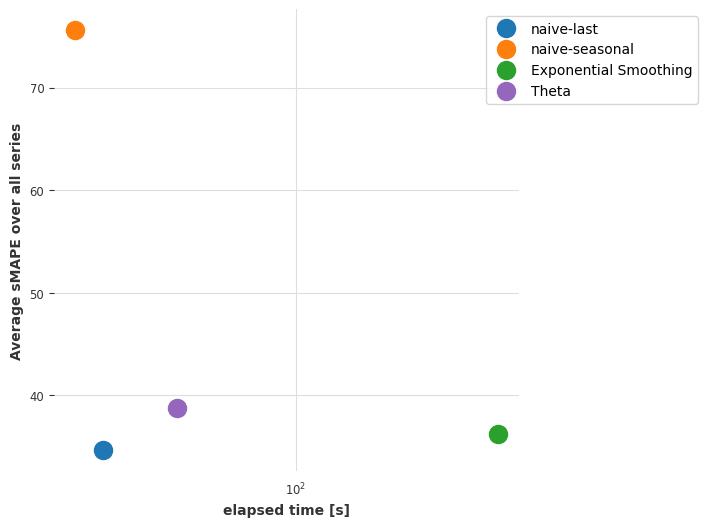

Visualization of performances taking the median of the smapes over cross-validation


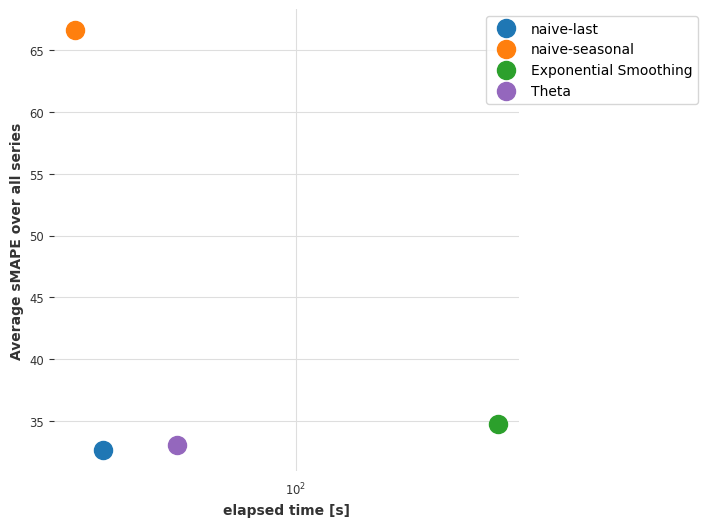

The results for index_colab_increm with an horizon of 12 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

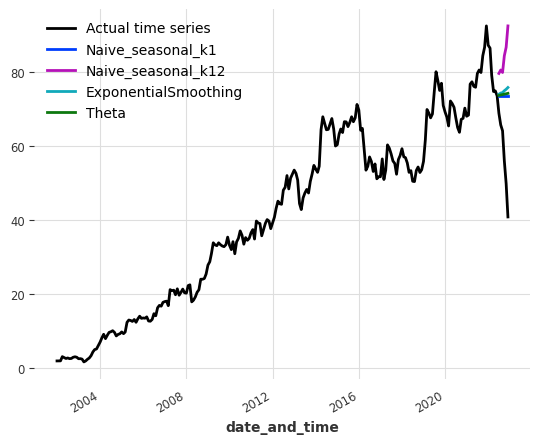

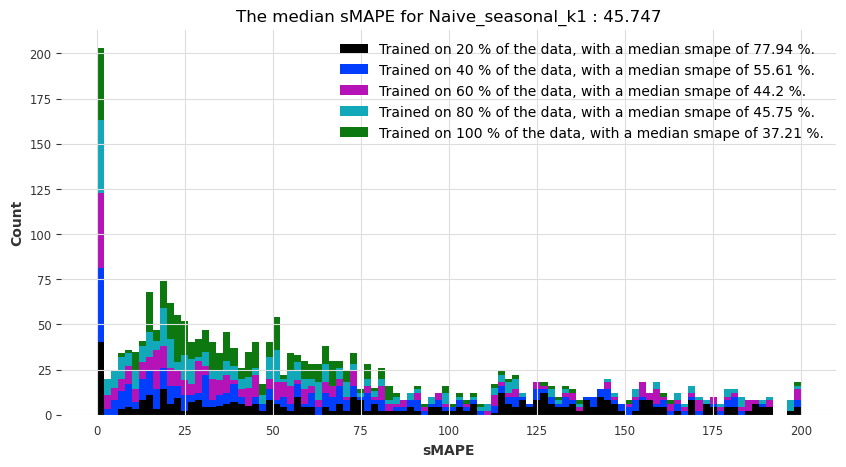

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

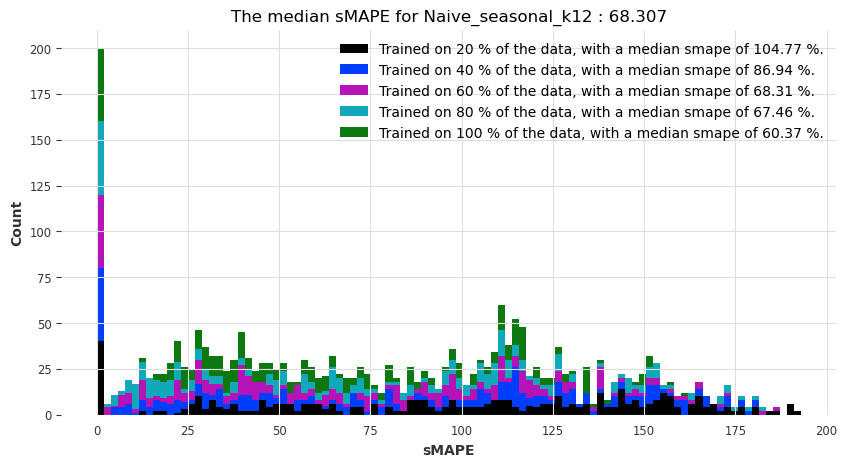

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

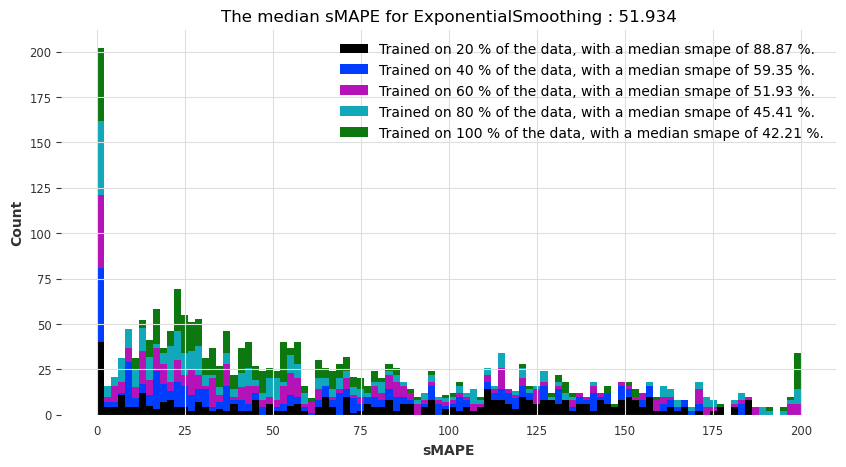

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

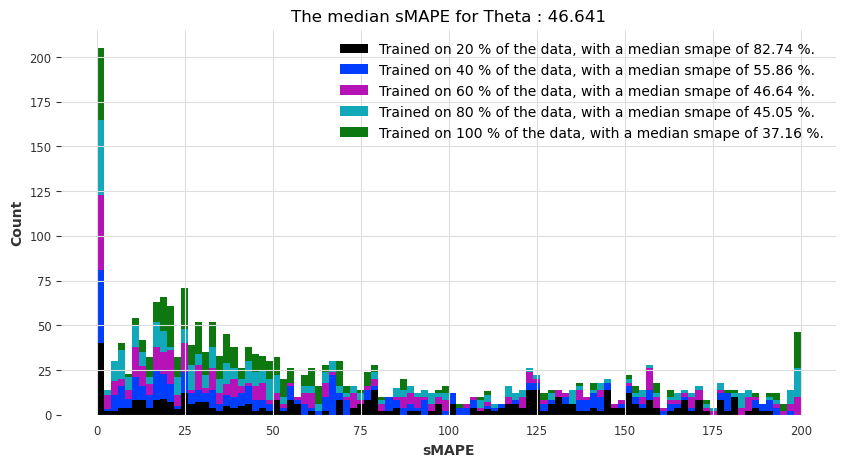

Visualization of performances taking the mean of the smapes over cross-validation


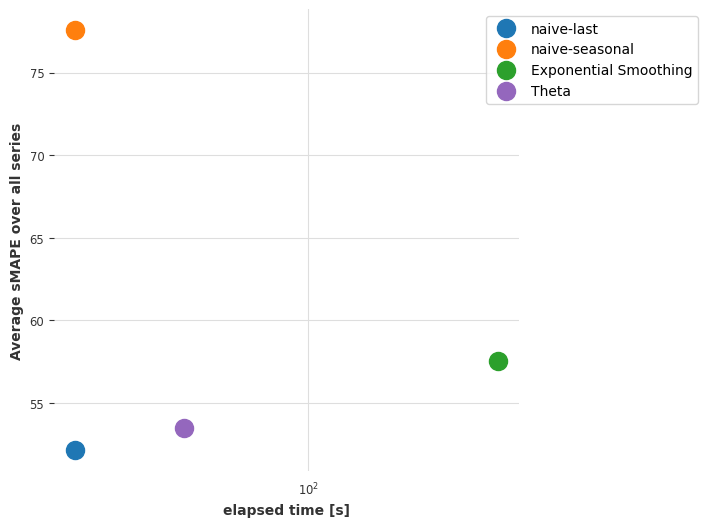

Visualization of performances taking the median of the smapes over cross-validation


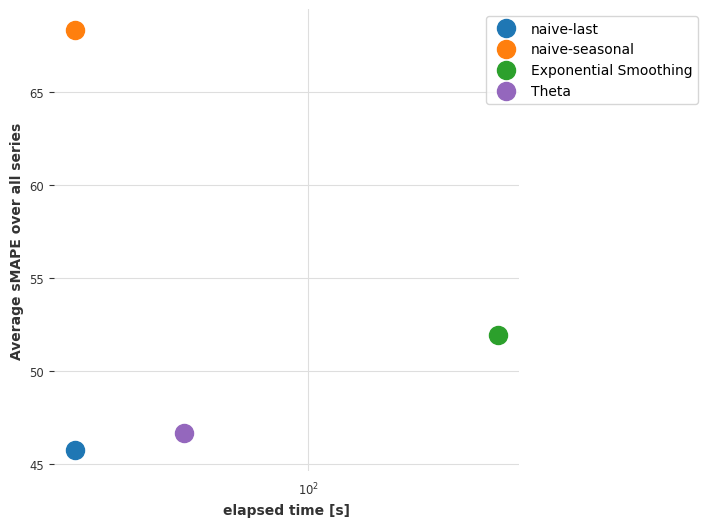

The results for index_colab_notincrem are:
The results for index_colab_notincrem with an horizon of 3 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

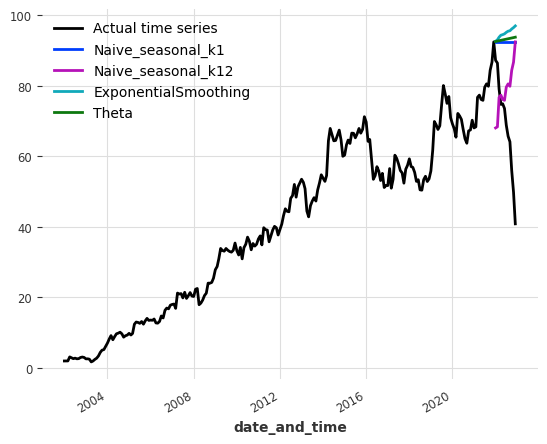

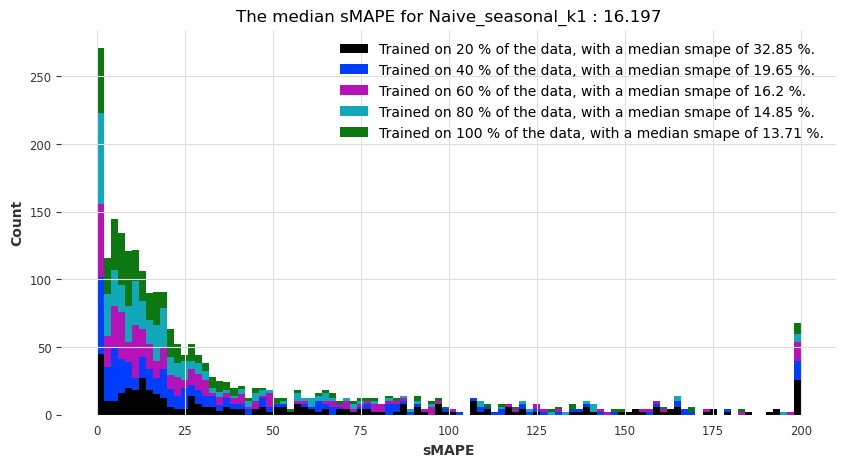

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

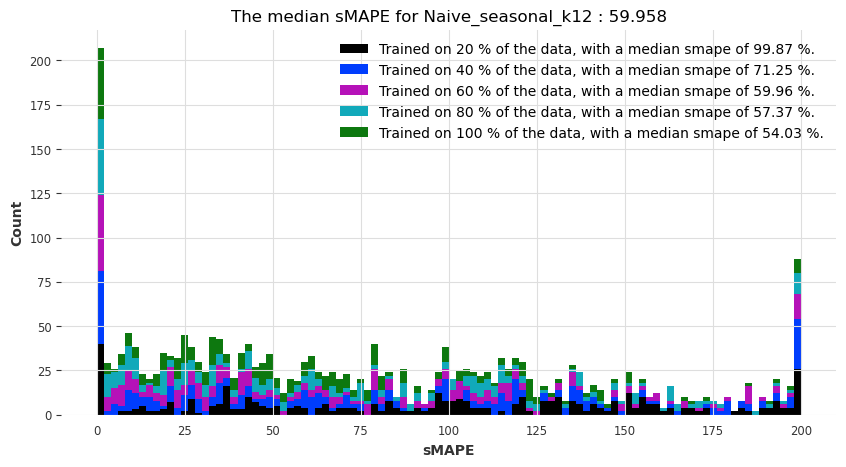

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

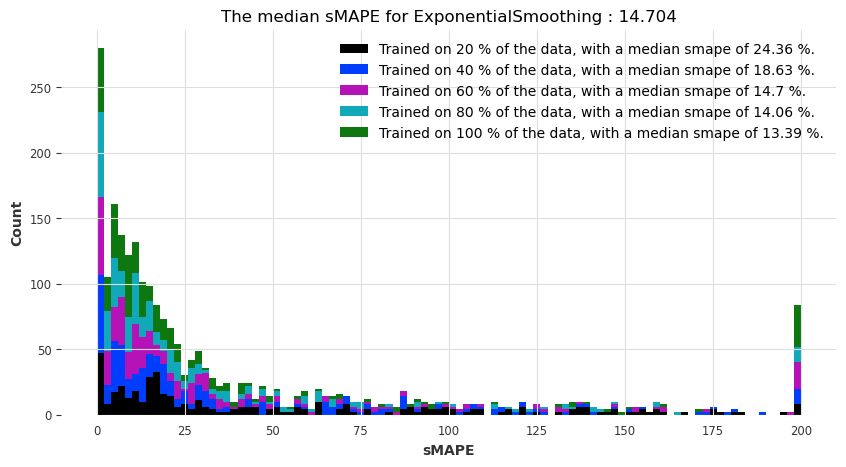

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

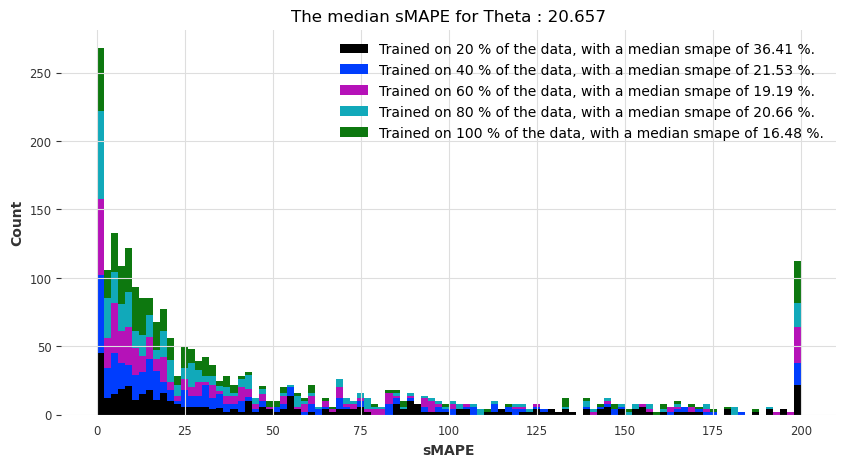

Visualization of performances taking the mean of the smapes over cross-validation


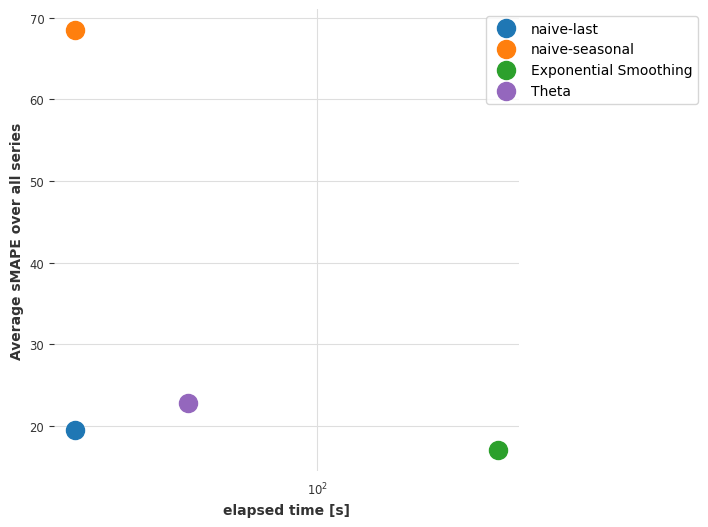

Visualization of performances taking the median of the smapes over cross-validation


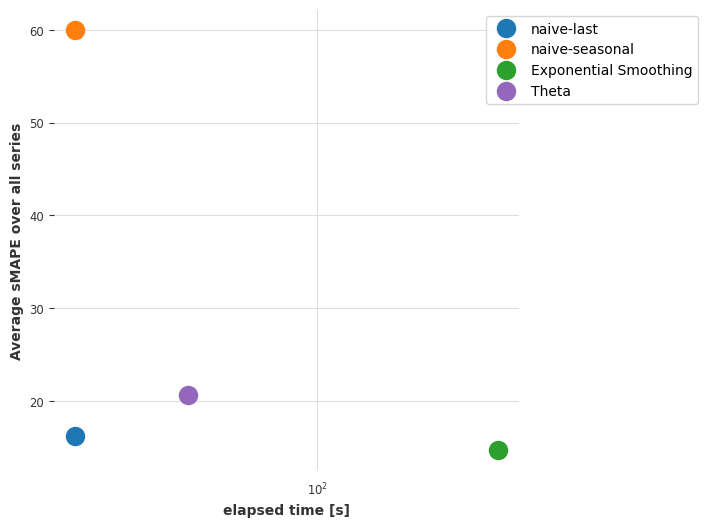

The results for index_colab_notincrem with an horizon of 6 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

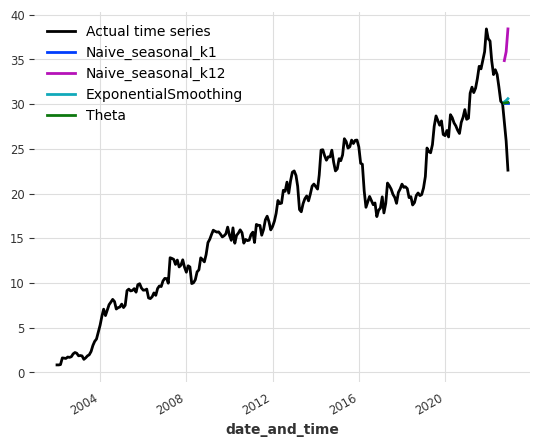

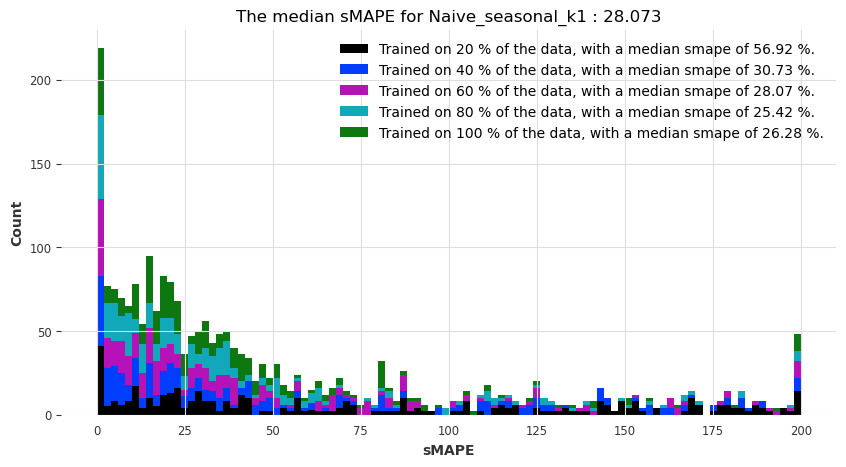

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

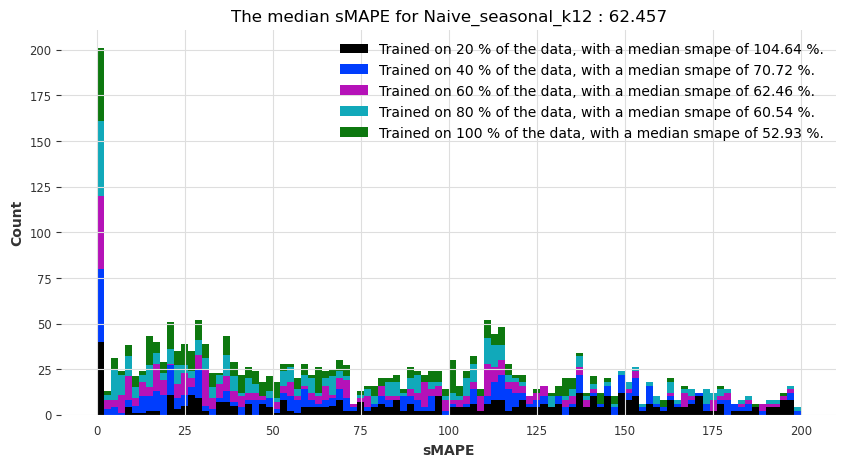

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

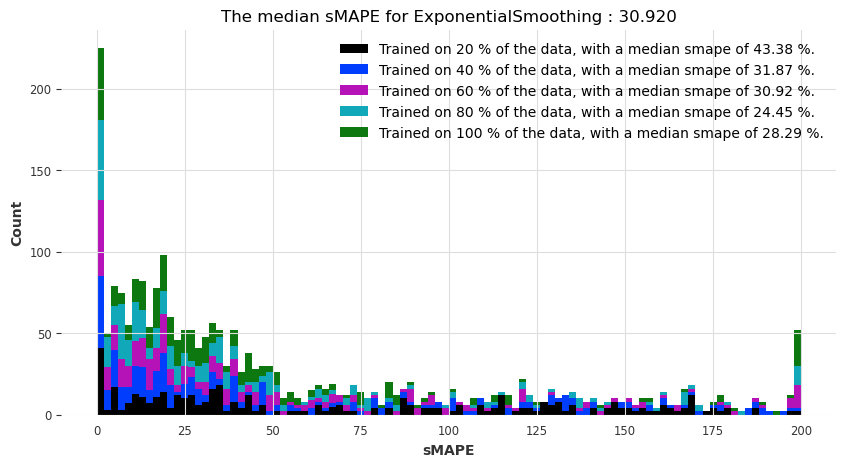

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

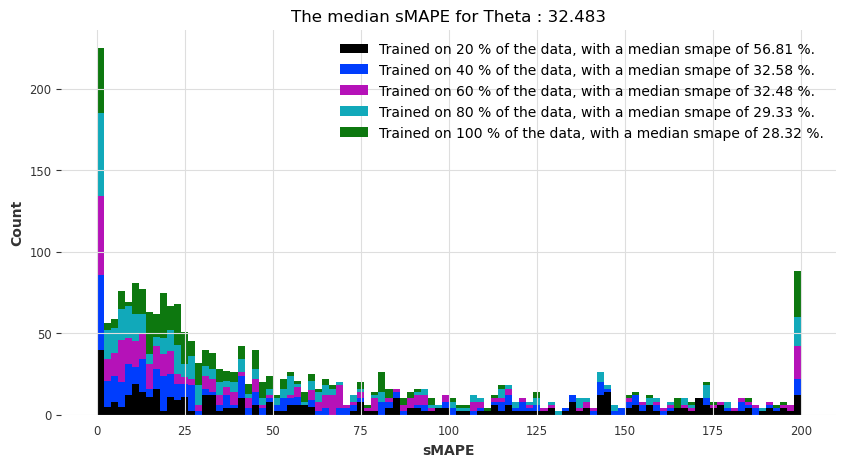

Visualization of performances taking the mean of the smapes over cross-validation


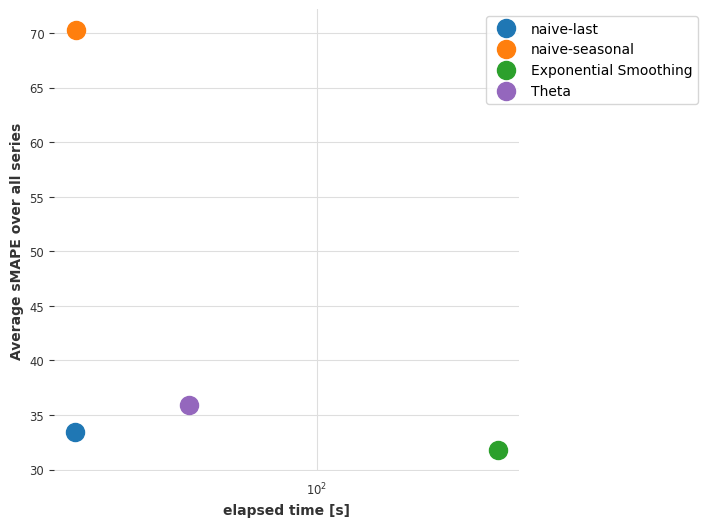

Visualization of performances taking the median of the smapes over cross-validation


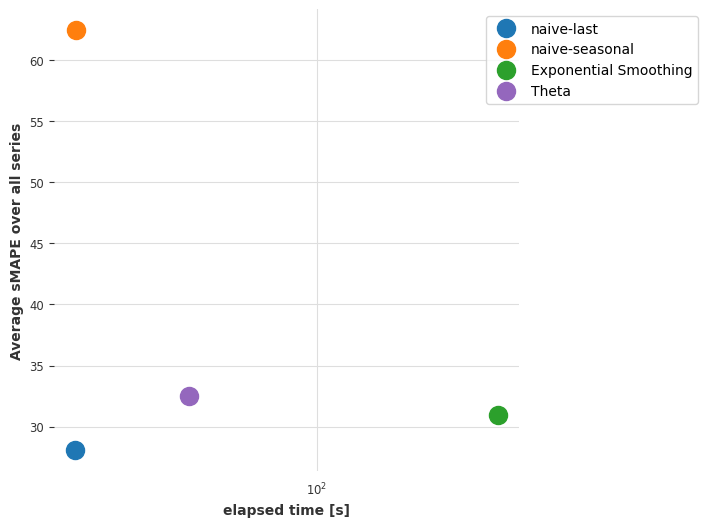

The results for index_colab_notincrem with an horizon of 12 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

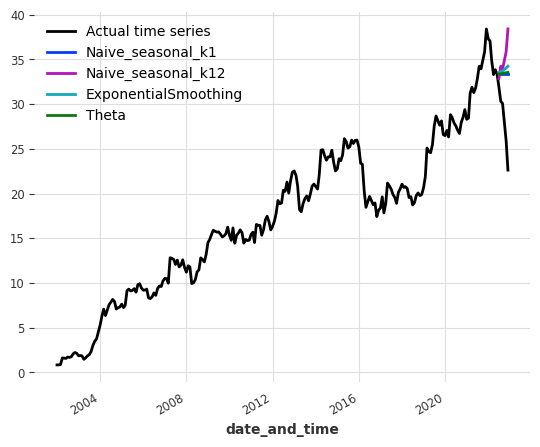

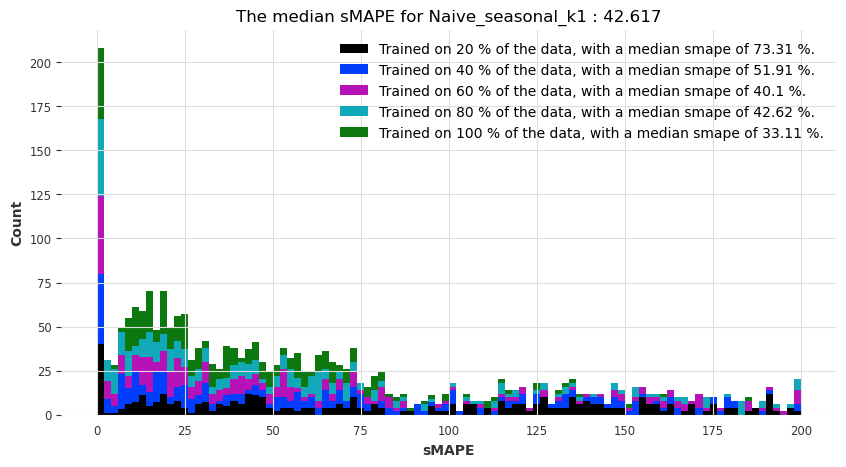

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

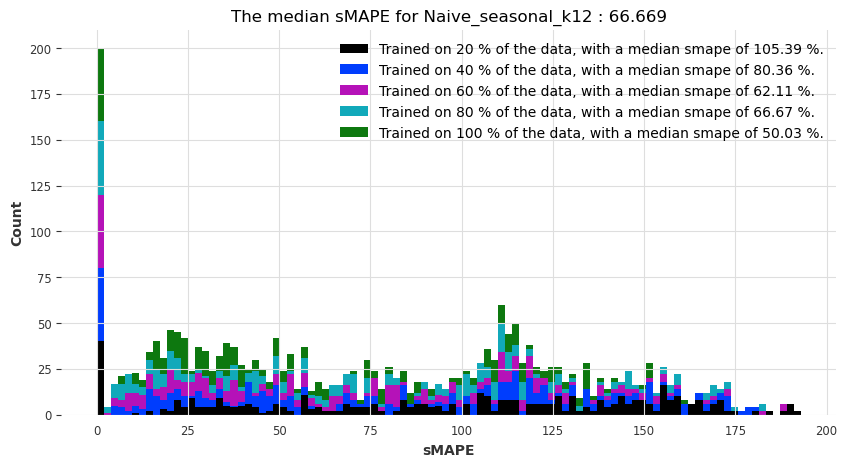

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

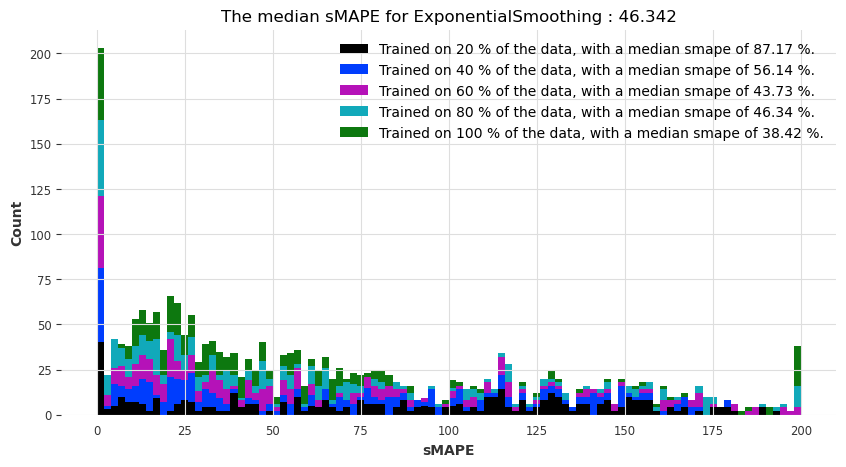

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

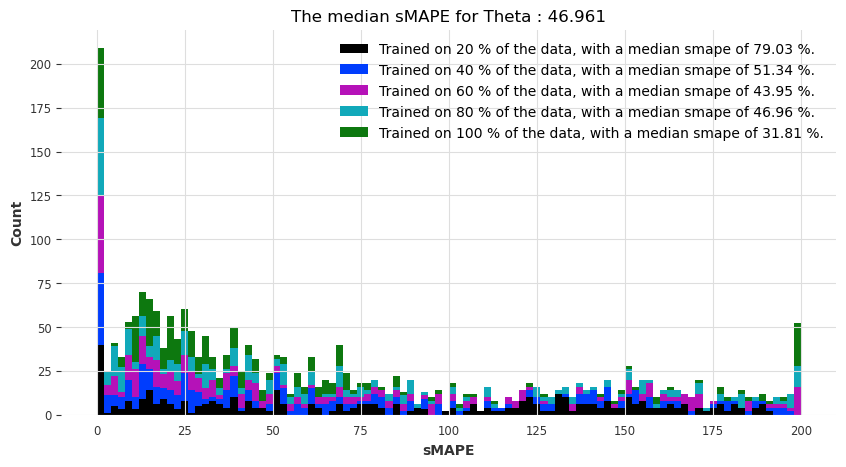

Visualization of performances taking the mean of the smapes over cross-validation


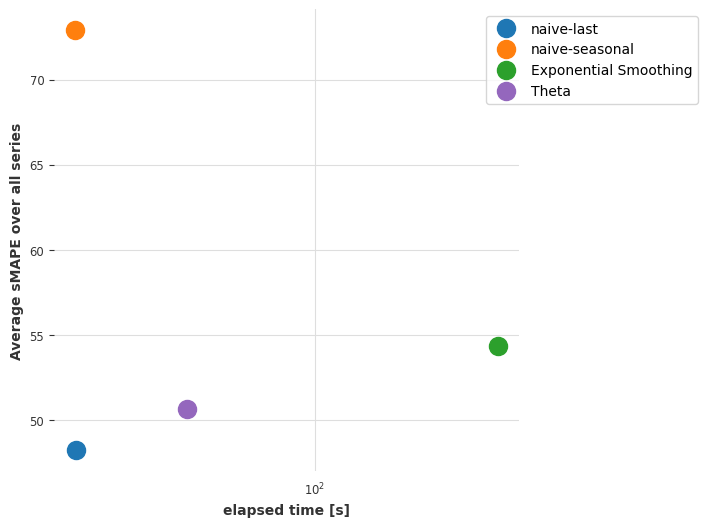

Visualization of performances taking the median of the smapes over cross-validation


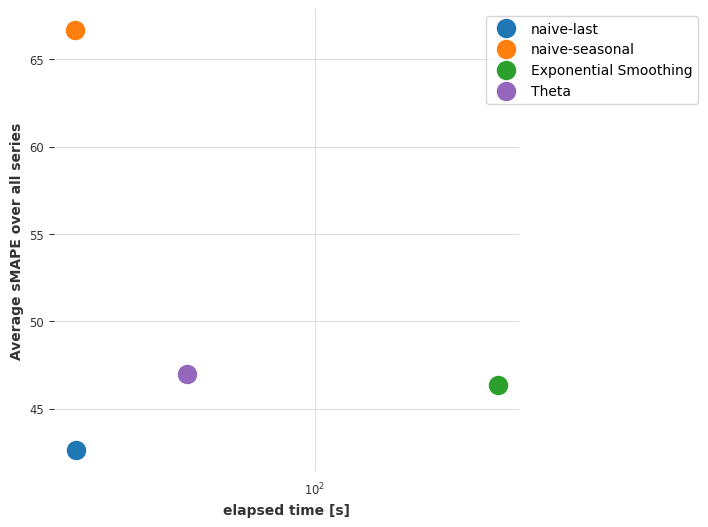

The results for index_keyword are:
The results for index_keyword with an horizon of 3 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

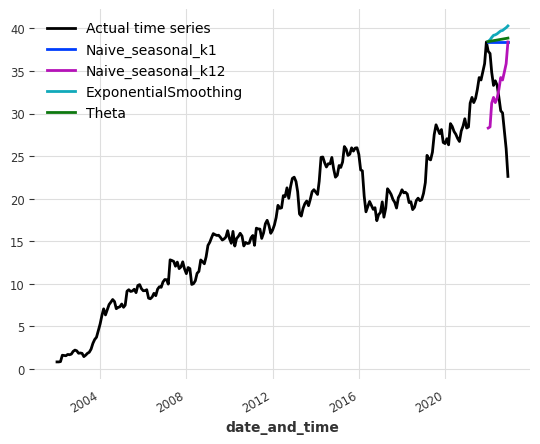

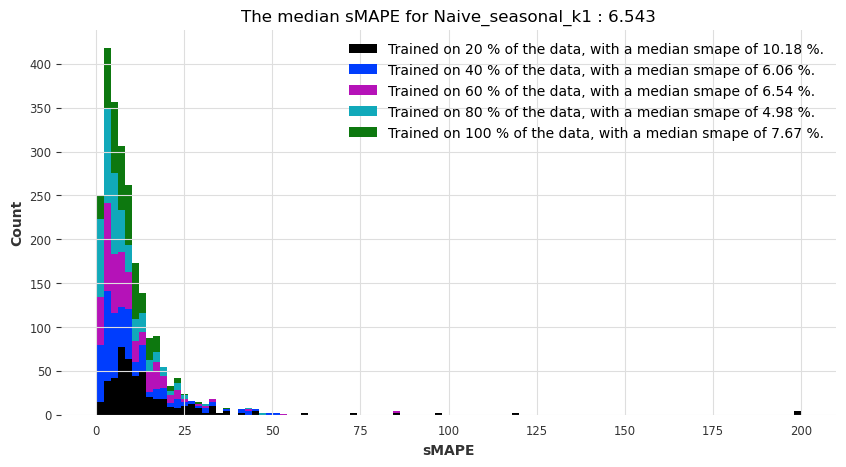

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

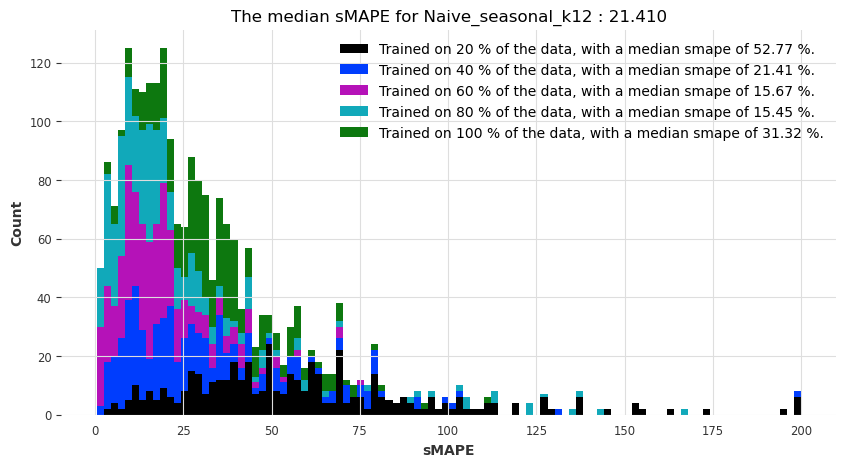

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

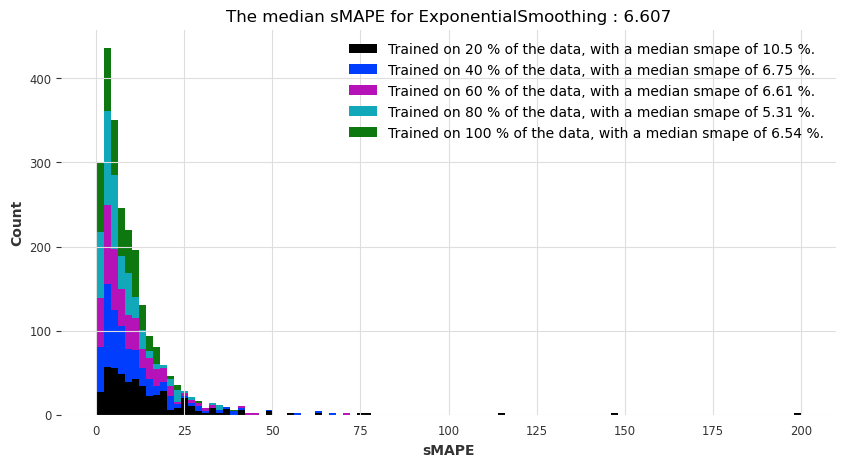

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

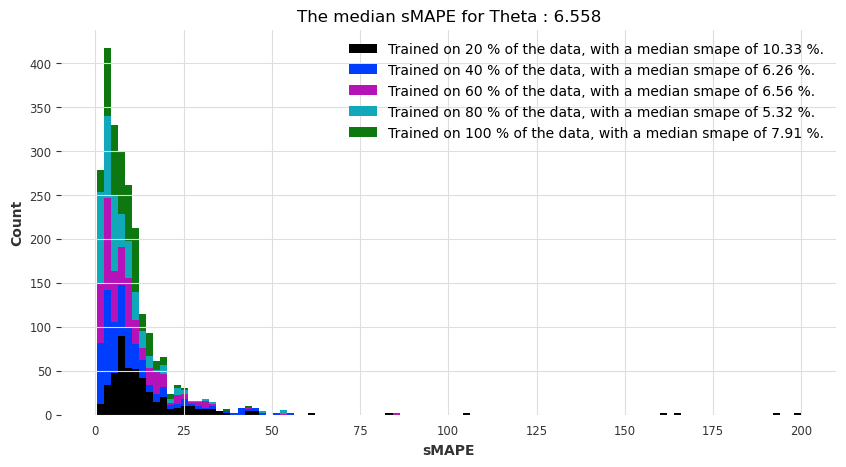

Visualization of performances taking the mean of the smapes over cross-validation


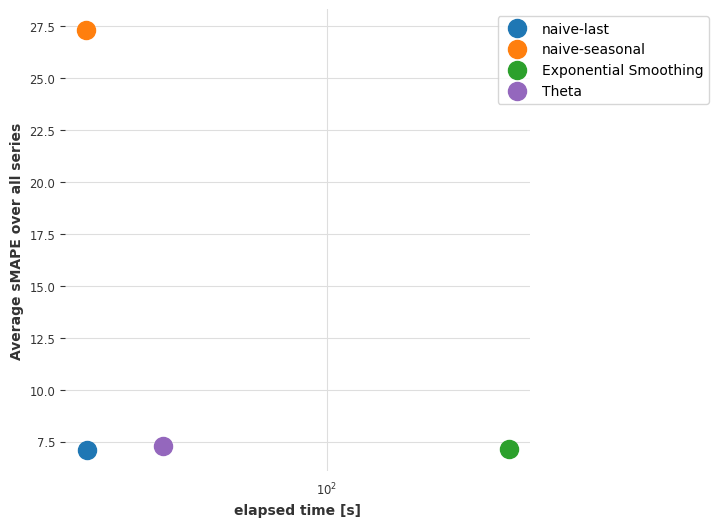

Visualization of performances taking the median of the smapes over cross-validation


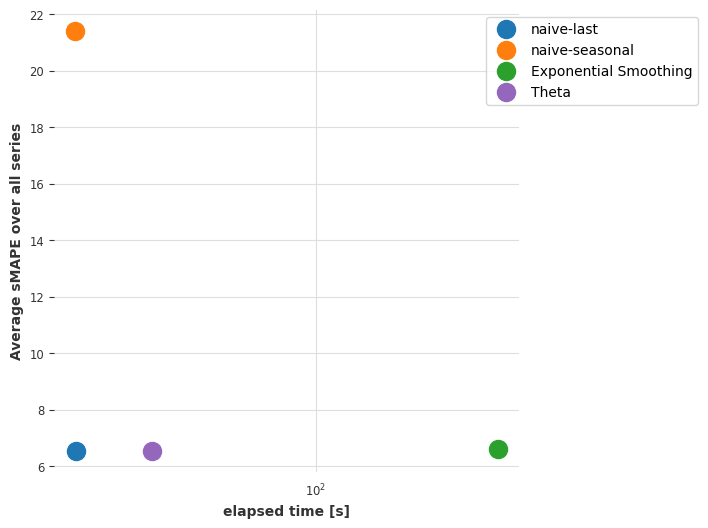

The results for index_keyword with an horizon of 6 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

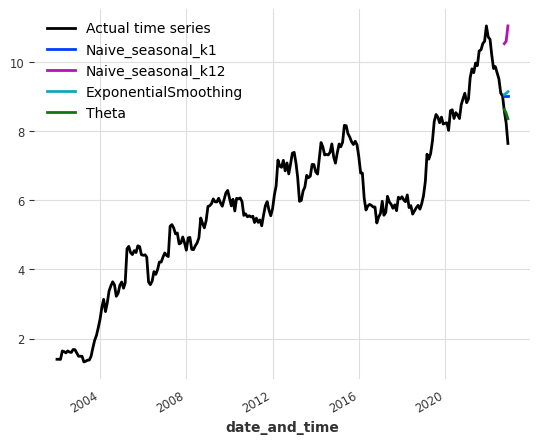

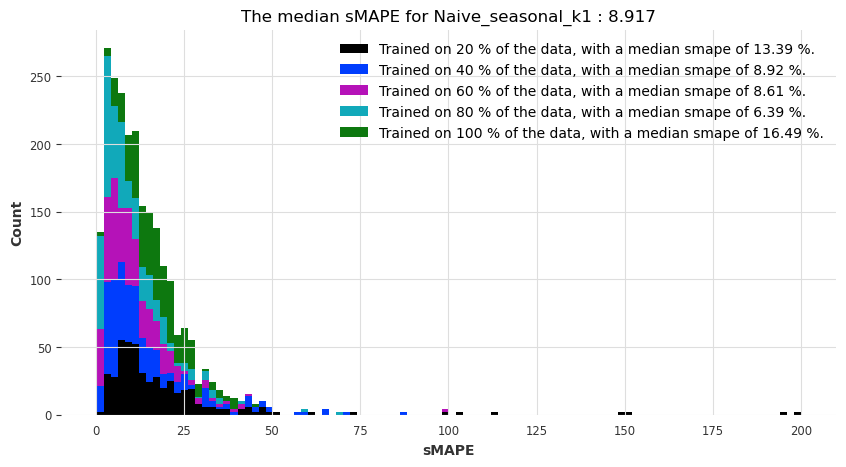

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

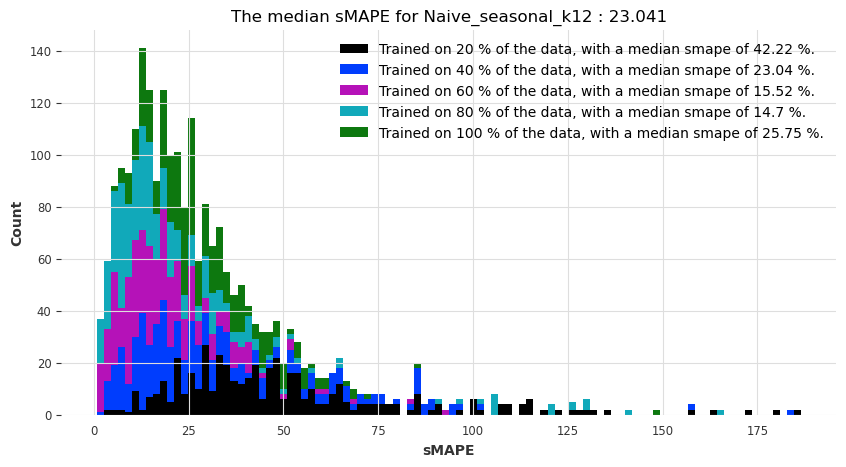

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

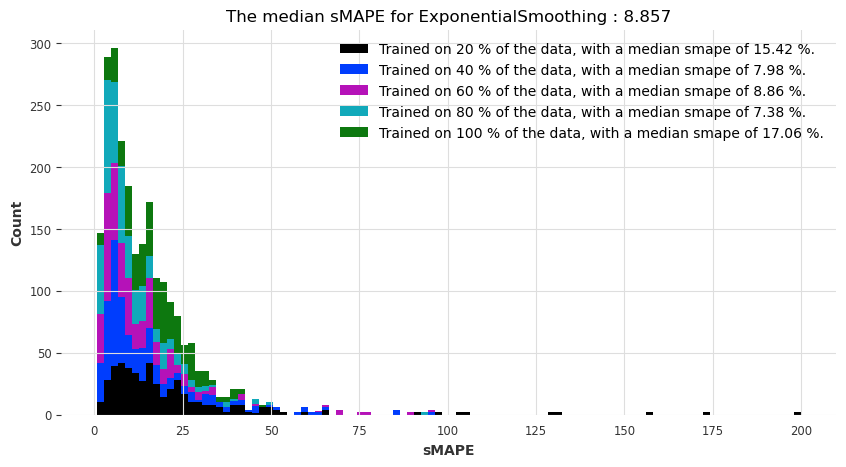

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

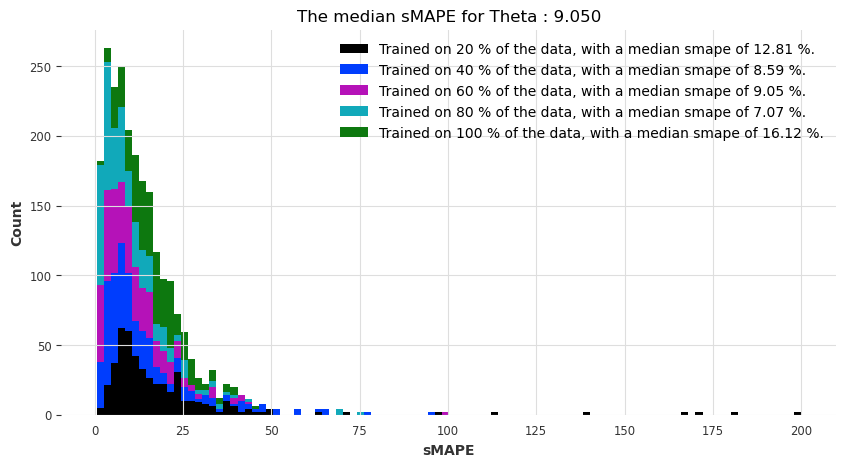

Visualization of performances taking the mean of the smapes over cross-validation


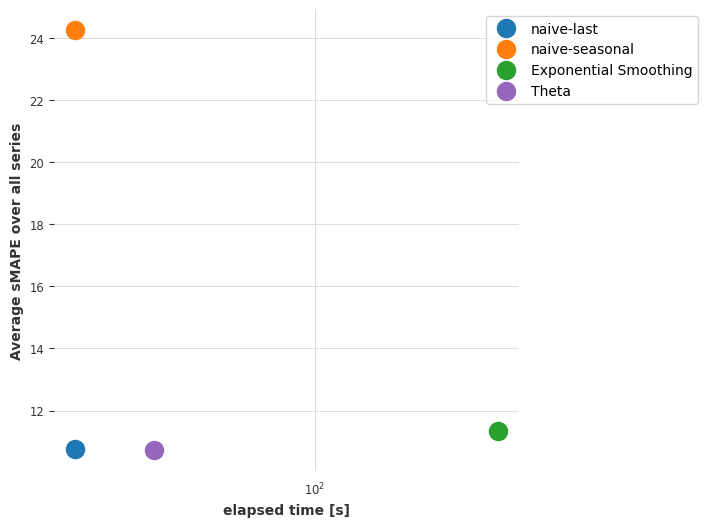

Visualization of performances taking the median of the smapes over cross-validation


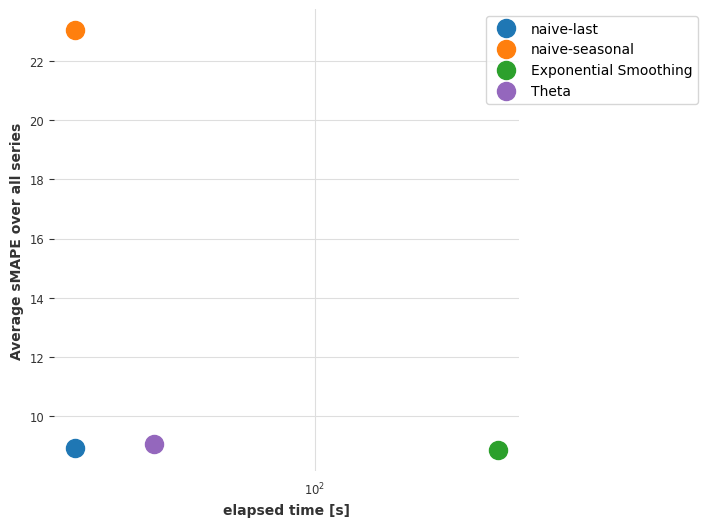

The results for index_keyword with an horizon of 12 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

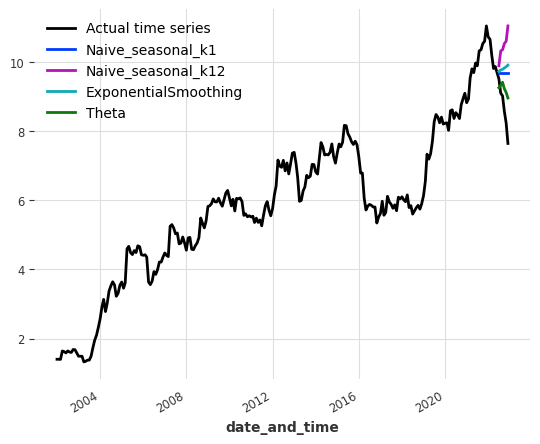

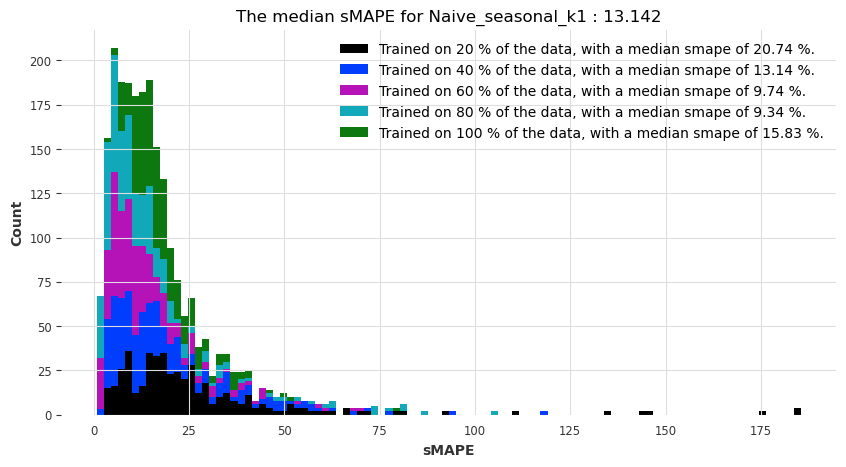

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

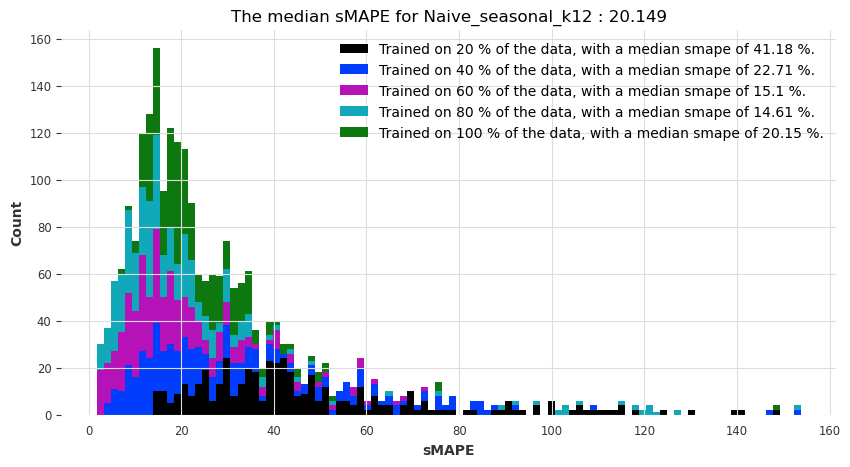

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

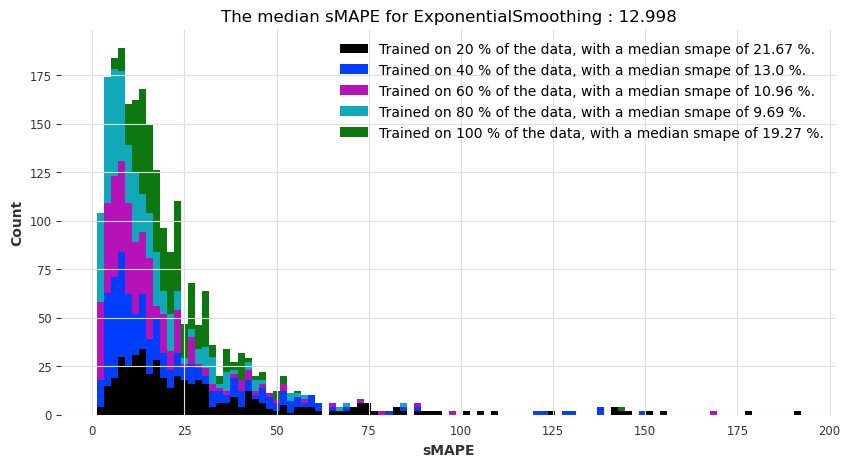

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

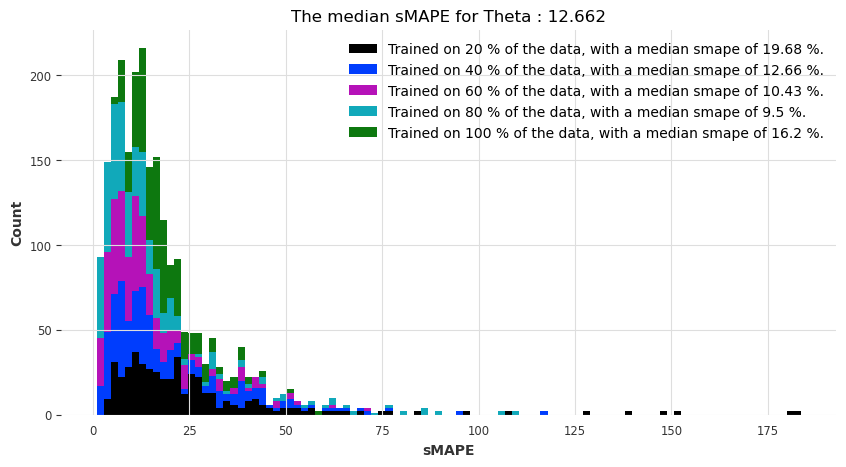

Visualization of performances taking the mean of the smapes over cross-validation


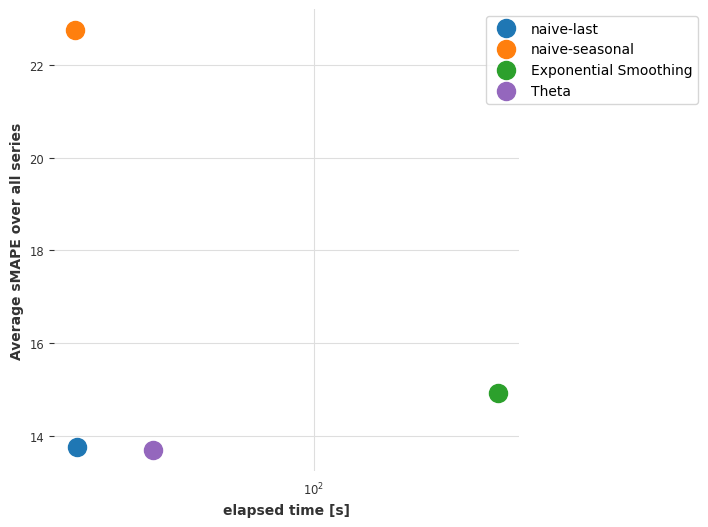

Visualization of performances taking the median of the smapes over cross-validation


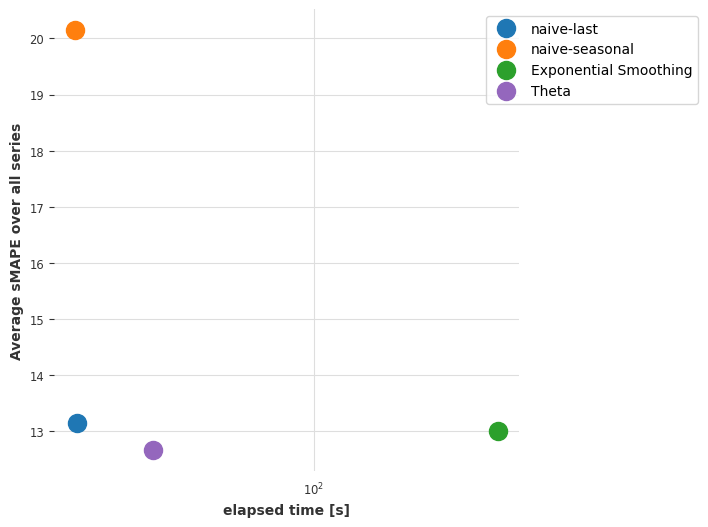

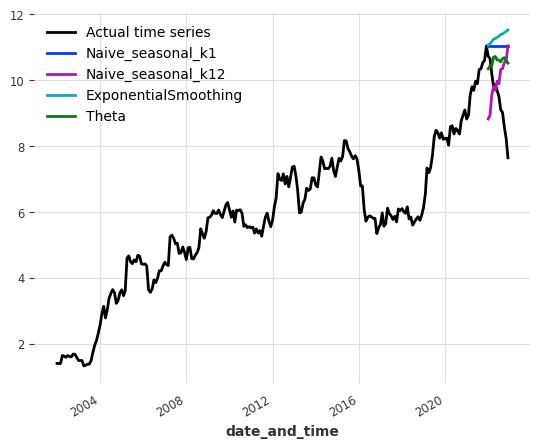

In [170]:
info_table = []
info_table_var=[]

for index in list_indices:
    dfofindex = dftm.loc[dftm['indextype']==index]
    print('The results for '+str(index)+' are:')
    listindex_byalgo=[]
    
    list_var_byalgo=[]
    
    for horizon in [3,6,12]:
        print('The results for '+str(index)+' with an horizon of '+str(horizon)+' are:')
        
        naive1_smapes_mean,naive12_smapes_mean,ets_smapes_mean,theta_smapes_mean,naive1_var_allerrors,naive1_mean_allvar,\
        naive12_var_allerrors,naive12_mean_allvar,ets_var_allerrors,ets_mean_allvar,theta_var_allerrors,theta_mean_allvar=\
        local_forecasting(dfofindex,horizon,list_concepts,5)
        
        listindex_byalgo =listindex_byalgo+\
        [naive1_smapes_mean,naive12_smapes_mean,ets_smapes_mean,theta_smapes_mean]
        
        list_var_byalgo=list_var_byalgo+[[naive1_var_allerrors,naive1_mean_allvar],[naive12_var_allerrors,naive12_mean_allvar]      
        ,[ets_var_allerrors,ets_mean_allvar],[theta_var_allerrors,theta_mean_allvar]]
        
        plot_forecasting_models_local(modelnames,myforecasters,dfofindex,horizon,index) 
    
    list_toappend=[]    
    for i in range(4):
        for j in range(3):
            list_toappend.append(listindex_byalgo[i+j*4])
    info_table.append(list_toappend)
    
    list_toappend_var=[]    
    for i in range(4):
        for j in range(3):
            list_toappend_var.append(list_var_byalgo[i+j*4])
    info_table_var.append(list(chain.from_iterable(list_toappend_var))) 

In [171]:
iterables = [["Naive seasonal (1)","Naive seasonal (12)", "Exponential smoothing","Theta"], ["3 months", "6 months","12 months"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon"])

df = pd.DataFrame({'Index citations t1-t2':info_table[0], 'Index citations t2-t1': info_table[1],
                   'Index colaboration incremental': info_table[2],'colaboration not incremental':info_table[3],
                   'Index keywords': info_table[4]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm  Forecasting horizon                          
Naive seasonal (1)    3 months                          1.261896   
                      6 months                          2.944436   
                      12 months                         9.920137   
Naive seasonal (12)   3 months                          6.762260   
                      6 months                          9.046289   
                      12 months                        15.624809   
Exponential smoothing 3 months                          0.802191   
                      6 months                          3.299163   
                      12 months                        10.231422   
Theta                 3 months                          1.481448   
                      6 months                          2.805812   
                      12 months                        10.481856   

                                           Index citations t2-t1  \
Forecaster algorithm  Forecasting horizon                          
Naive seasonal (1)    3 months                          1.261896   
                      6 months                          2.944436   
                      12 months                         9.920137   
Naive seasonal (12)   3 months                          6.762260   
                      6 months                          9.046289   
                      12 months                        15.624809   
Exponential smoothing 3 months                          0.802191   
                      6 months                          3.299163   
                      12 months                        10.231422   
Theta                 3 months                          1.481448   
                      6 months                          2.805812   
                      12 months                        10.481856   

                                           Index colaboration incremental  \
Forecaster algorithm  Forecasting horizon                                   
Naive seasonal (1)    3 months                                  20.096942   
                      6 months                                  34.661291   
                      12 months                                 52.141178   
Naive seasonal (12)   3 months                                  74.270678   
                      6 months                                  75.604680   
                      12 months                                 77.570097   
Exponential smoothing 3 months                                  19.360260   
                      6 months                                  36.237914   
                      12 months                                 57.553632   
Theta                 3 months                                  25.408499   
                      6 months                                  38.752994   
                      12 months                                 53.491424   

                                           colaboration not incremental  \
Forecaster algorithm  Forecasting horizon                                 
Naive seasonal (1)    3 months                                19.450553   
                      6 months                                33.481200   
                      12 months                               48.210436   
Naive seasonal (12)   3 months                                68.493552   
                      6 months                                70.259035   
                      12 months                               72.909266   
Exponential smoothing 3 months                                17.028340   
                      6 months                                31.782425   
                      12 months                               54.362158   
Theta                 3 months                                22.853188   
                      6 months                                35.902685   
                      12 months                               50.618931   

       

In [172]:
iterables = [["Naive seasonal (1)","Naive seasonal (12)", "Exponential smoothing","Theta"], ["3 months", "6 months","12 months"],["Mean of variances", "Variances over all errors"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon","Type of variance"])

df = pd.DataFrame({'Index citations t1-t2':info_table_var[0], 'Index citations t2-t1': info_table_var[1],
                   'Index colaboration incremental': info_table_var[2],'colaboration not incremental':info_table_var[3],
                   'Index keywords': info_table_var[4]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm  Forecasting horizon Type of variance                                   
Naive seasonal (1)    3 months            Mean of variances                       1.084828   
                                          Variances over all errors               0.018311   
                      6 months            Mean of variances                       3.550107   
                                          Variances over all errors               0.171189   
                      12 months           Mean of variances                      11.936950   
                                          Variances over all errors               0.739374   
Naive seasonal (12)   3 months            Mean of variances                      32.645734   
                                          Variances over all errors               0.037006   
                      6 months            Mean of variances                      22.159658   
                                          Variances over all errors               0.422096   
                      12 months           Mean of variances                      18.175779   
                                          Variances over all errors               0.658760   
Exponential smoothing 3 months            Mean of variances                       0.382825   
                                          Variances over all errors               0.027356   
                      6 months            Mean of variances                       1.033080   
                                          Variances over all errors               0.080089   
                      12 months           Mean of variances                      37.356652   
                                          Variances over all errors               1.941509   
Theta                 3 months            Mean of variances                       1.131367   
                                          Variances over all errors               0.018802   
                      6 months            Mean of variances                       3.690556   
                                          Variances over all errors               0.176937   
                      12 months           Mean of variances                      12.321973   
                                          Variances over all errors               0.753877   

                                                                     Index citations t2-t1  \
Forecaster algorithm  Forecasting horizon Type of variance                                   
Naive seasonal (1)    3 months            Mean of variances                       1.084828   
                                          Variances over all errors               0.018311   
                      6 months            Mean of variances                       3.550107   
                                          Variances over all errors               0.171189   
                      12 months           Mean of variances                      11.936950   
                                          Variances over all errors               0.739374   
Naive seasonal (12)   3 months            Mean of variances                      32.645734   
                                          Variances over all errors               0.037006   
                      6 months            Mean of variances                      22.159658   
                                          Variances over all errors               0.422096   
                      12 months           Mean of variances                      18.175779   
                                          Variances over all errors               0.658760   
Exponential smoothing 3 months            Mean of variances                       0.382825   
                                          Variances over all errors               0.027356   
                      6 months            Mean of variances                       1.033080   
                          

There are no models that perform the best overall. Nevertheless, the naive seasonal and exponential smoothing are the models that perform the best the most often. This is probably due to the fact, that a very high percent of time series (~25%) are flat and therefore predicting the last values is very accurate if not completely exact in these cases. Besides, the time series are very chaotic. For this reason, even if the other forecasting algorithms might model the overall tendency of the time series, they fail to be very accurate and this results in big errors. Nevertheless, the exponential algorithm performs very often as well as the naive K=1 model and even better sometimes.\
The index of collaboration are difficult to forecast. But it must be said, that our data is incomplete since many papers and informations from the second half of 2022 have not been uploaded on OpenAlex and for this reason, the indices decrease a lot and are difficult to forecast. I think, the forecasts are good, it is just that we have missing data, and therefore the indices drop even though, with the right data, the forecast would be probably very accurate.

# **Part 2 -- Global forecasting based on clustering**

We now do global forecasting on our time series using the clustering I created. It took 12 hours to run even without using k-cross validation.

<div class="alert-info">
2.1. Randomized clustering of the time series.
</div>

To see whether the clustering makes sense to forecasting we will attribute randomly each sample to the same number of clusters as present in the algorithm, do the forecasting and compare the results. We should keep in mind, that there are 1+numbercluster number of clusters, since I created artifically a cluster with all the time series that are very flat.

In [234]:
def clustering_df_rand(dftm,list_concepts,numbercluster):

    # creating a randomized clustering
    
    listcluster_rand=[]

    for concept1 in list_concepts:
        dfinter1=df_interpolation.loc[df_interpolation['concept1']==concept1]
        for concept2 in list_concepts:
            dfinter2=dfinter1.loc[dfinter1['concept2']==concept2]
            interpolation_score = dfinter2.interpolation_ratio.tolist()[0]
            for index in list_indices:
                if interpolation_score<0.5:
                    cluster_numbering= random.randint(1, numbercluster)
                    listcluster_rand.append(cluster_numbering)
    
    #Creating the dataframe with randomized cluster.
    dftm_rand=dftm.copy()
    dftm_rand['cluster']=listcluster_rand
    
    return dftm_rand

<div class="alert-info">
2.2. Forecasting and comparing the results between the randomized and algorithmic clustering
</div>

Comparing the different forecasting algorithms.

In [356]:
def eval_kcross_forecasts_cluster(smapes,modelname,addinfo):
    
    plt.close('all')
    themedians = []
    labels = []
    
    plt.figure(figsize=(10, 5))

    for i in range(len(smapes)):
        themedians.append(np.median(smapes[i]))
        #plt.hist(smapes[i], bins=100,label='K-cross set'+str(i+1))
        labels = labels +['Trained and forecasted on the cluster '+str(i)+\
        ' , with a median smape of '+ str(round(np.median(smapes[i]),2))+' %.']
        
    #plt.figure(figsize=(10, 5))
    plt.ylabel("Count")
    plt.xlabel("sMAPE")
    plt.title("The median sMAPE for "+str(modelname)+' '+str(addinfo)+" : %.3f" % np.median(themedians))
    #plt.yscale('log')

    
    plt.hist(smapes,bins=100,histtype='barstacked',label=labels)

  
    plt.legend()
    plt.show()
    plt.close()

In [357]:
def cross_validation_splitting_window_global_clustering(data,horizon,list_concepts,number_cv,modelname,forecaster,**kwargs):
    
    time1=time.time()
    
    maximal_train_len = 252-horizon
    score_forecaster = []
    allsmapes=[]
    
    mean_allvar= []
    var_alltheerrors = []
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =maximal_train_len//number_cv
            startingtime = i*windowslength
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_global_model(df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
            
        else:
            windowslength = maximal_train_len-(number_cv-1)*(maximal_train_len//number_cv) # to get the remaining window
            startingtime = i*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_global_model(df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
        
        allsmapes.append(smapes)
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window
                
        var_alltheerrors.append(var_allerrors)
        mean_allvar.append(var_mean_var)
        
    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    
    return elapsed_time,np.mean(myscores),np.median(myscores),allsmapes,np.mean(var_allerrors),np.mean(mean_allvar)

In [358]:
def cross_validation_expanding_window_global_clustering(data,horizon,list_concepts,number_cv,modelname,forecaster,**kwargs):
    
    time1=time.time()
    
    startingtime=0
    maximal_train_len = 252-horizon
    score_forecaster = []
    allsmapes=[]
    
    mean_allvar= []
    var_alltheerrors = []
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =(i+1)*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_global_model(df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
            
        else:
            windowslength = maximal_train_len
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_global_model(df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
        
        allsmapes.append(smapes)
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window
        
        var_alltheerrors.append(var_allerrors)
        mean_allvar.append(var_mean_var)

    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    plt.plot()

    return elapsed_time,np.mean(myscores),np.median(myscores),allsmapes,np.mean(var_allerrors),np.mean(mean_allvar)

In [359]:
def cluster_computation(dftm, dftm_rand,horizon,numbercluster,list_concepts,number_cv,modelname,forecaster,**kwargs):
    
    elapsed_time_rand=[]
    error_rand_mean=[]
    error_rand_med=[]
    var_allerrors_rand = []
    mean_allvar_rand =[]
    
    allsmapes_rand = []
    # once I created my dataframe with this specific horizon I train and visualize the results of the forecasting algorithms

    print('Randomized clustering')
    for i in tqdm(range(1,numbercluster+1)):

        mydf_rand= dftm_rand.loc[dftm_rand['cluster']==int(i)]
        
        time_rand, smapes_rand_mean,smapes_rand_med,smapes_rand,var_allerrors_rand_number,mean_allvar_rand_number =\
        cross_validation_expanding_window_global_clustering(mydf_rand,\
        horizon,list_concepts,number_cv,modelname,forecaster,**kwargs)

        elapsed_time_rand.append(time_rand)
        error_rand_mean.append(smapes_rand_mean)
        error_rand_med.append(smapes_rand_med)
        allsmapes_rand.append(list(chain.from_iterable(smapes_rand)))
        
        var_allerrors_rand.append(var_allerrors_rand_number)
        mean_allvar_rand.append(mean_allvar_rand_number)

    
    eval_kcross_forecasts_cluster(allsmapes_rand,modelname,'randomized')
    
        
    elapsed_time=[]
    error_mean=[]
    error_med=[]
    var_allerrors = []
    mean_allvar =[]
    
    allsmapes = []
    
    print('Algorithmic clustering based on similarity')
    for i in tqdm(range(1,numbercluster+1)):     

        mydf= dftm.loc[dftm['cluster']==int(i)]
        
        time_normal, smapes_mean,smapes_med,smapes_normal,var_allerrors_number,mean_allvar_number =\
        cross_validation_expanding_window_global_clustering(mydf,\
        horizon,list_concepts,number_cv,modelname,forecaster,**kwargs)
        
        elapsed_time.append(time_normal)
        error_mean.append(smapes_mean)
        error_med.append(smapes_med)
        allsmapes.append(list(chain.from_iterable(smapes_normal)))
          
        var_allerrors.append(var_allerrors_number)
        mean_allvar.append(mean_allvar_number)
    
    eval_kcross_forecasts_cluster(allsmapes,modelname,'not-randomized')
    
    smapes_rand = np.mean(error_rand_mean)
    time_rand = np.mean(elapsed_time_rand)
    smapes = np.mean(error_mean)
    time = np.mean(elapsed_time)
    
    return smapes_rand,time_rand,smapes,time,np.mean(var_allerrors_rand),np.mean(mean_allvar_rand),np.mean(var_allerrors),np.mean(mean_allvar) 

In [360]:
def clustering_forecasting(dftm,dftm_rand,horizon,numbercluster,list_concepts,number_cv):
    mylag =252//number_cv-2*horizon
    # number of datapoints considered to forecast
    # I substracted -3, because I was having problems with the authorized lags in the function  

    print(' ')
    
    lr_smapes_rand,lr_time_rand,lr_smapes,lr_time,\
    lr_var_allerrors_rand,lr_mean_allvar_rand,lr_var_allerrors,lr_mean_allvar\
    = cluster_computation(dftm, dftm_rand,horizon,numbercluster,\
    list_concepts,number_cv,'LinearRegressionModel',LinearRegressionModel, lags=mylag, output_chunk_length=horizon)
        
    print(' ')
        
    lgbm_smapes_rand,lgbm_time_rand,lgbm_smapes,lgbm_time,\
    lgbm_var_allerrors_rand,lgbm_mean_allvar_rand,lgbm_var_allerrors,lgbm_mean_allvar\
    = cluster_computation(dftm, dftm_rand,horizon,numbercluster,\
    list_concepts,number_cv,'LightGBMModel',LightGBMModel, lags=mylag, output_chunk_length=horizon, objective="mape")
    
    print(' ')
    
    rf_smapes_rand,rf_time_rand,rf_smapes,rf_time, \
    rf_var_allerrors_rand,rf_mean_allvar_rand,rf_var_allerrors,rf_mean_allvar\
    = cluster_computation(dftm, dftm_rand,horizon,numbercluster,\
    list_concepts,number_cv,'RandomForest',RandomForest,lags=mylag, output_chunk_length=horizon)
    
    print(' ')
    
    nbeat_smapes_rand,nbeat_time_rand,nbeat_smapes,nbeat_time,\
    nbeat_var_allerrors_rand,nbeat_mean_allvar_rand,nbeat_var_allerrors,nbeat_mean_allvar\
    = cluster_computation(dftm, dftm_rand,horizon,numbercluster,\
    list_concepts,number_cv,'NBEATSModel',NBEATSModel,input_chunk_length=mylag,output_chunk_length=horizon,num_stacks=20,
    num_blocks=1,num_layers=2,layer_widths=136,expansion_coefficient_dim=11,loss_fn=SmapeLoss(),batch_size=1024,
    optimizer_kwargs={"lr":  1e-3})
    
    # visualization of the results 

    
    smapes_2 = {
        "Linear Regression": lr_smapes,
        "LGBM": lgbm_smapes,
        "Random Forest": rf_smapes,
        "NBeats": nbeat_smapes,
        
        "Linear Regression_rand": lr_smapes_rand,
        "LGBM_rand": lgbm_smapes_rand,
        "Random Forest_rand": rf_smapes_rand,
        "NBeats_rand": nbeat_smapes_rand,
    }

    elapsed_times_2 = {
        "Linear Regression": lr_time,
        "LGBM": lgbm_time,
        "Random Forest": rf_time,
        "NBeats": nbeat_time,
        
        "Linear Regression_rand": lr_time_rand,
        "LGBM_rand": lgbm_time_rand,
        "Random Forest_rand": rf_time_rand,
        "NBeats_rand": nbeat_time_rand,
    }

    plot_models_cluster(elapsed_times_2, smapes_2)
    
    list_var_error = [[nbeat_var_allerrors_rand,nbeat_mean_allvar_rand,nbeat_var_allerrors,nbeat_mean_allvar],
            [rf_var_allerrors_rand,rf_mean_allvar_rand,rf_var_allerrors,rf_mean_allvar],
            [lgbm_var_allerrors_rand,lgbm_mean_allvar_rand,lgbm_var_allerrors,lgbm_mean_allvar],
            [lr_var_allerrors_rand,lr_mean_allvar_rand,lr_var_allerrors,lr_mean_allvar]]
    
    return lr_smapes,lgbm_smapes,rf_smapes,nbeat_smapes,lr_smapes_rand,lgbm_smapes_rand,rf_smapes_rand,nbeat_smapes_rand,list_var_error

In [361]:
myforecasters = [LinearRegressionModel,LightGBMModel,RandomForest,NBEATSModel]
modelnames = ["LinearRegressionModel","LightGBMModel","RandomForest","NBEATSModel"]

In [362]:
numbercluster = max(dftm.cluster.tolist())
numbercluster

6

In [363]:
dftm_rand=clustering_df_rand(dftm,list_concepts,numbercluster)

We just do without cross-validation, because with cross validation it is way to long. At least this can give us a reasonable idea of the performance of clustering forecasting.

The results for index_cit_t1_t2 are:
The results for index_cit_t1_t2 with an horizon of 3 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

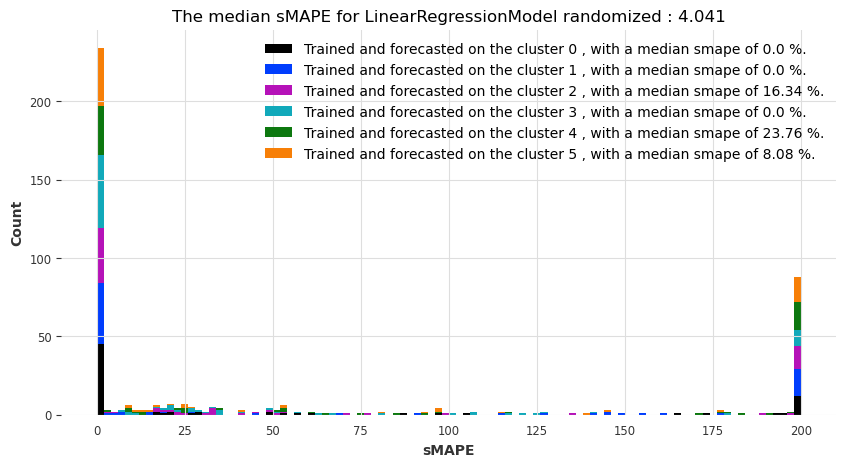

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

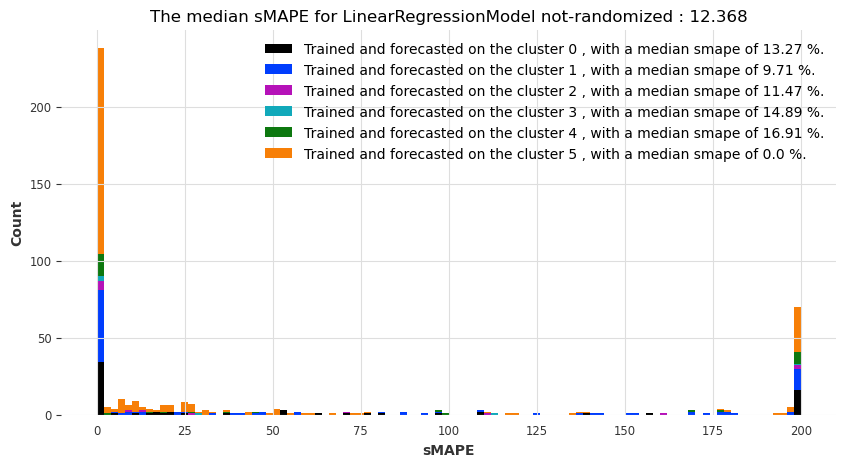

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

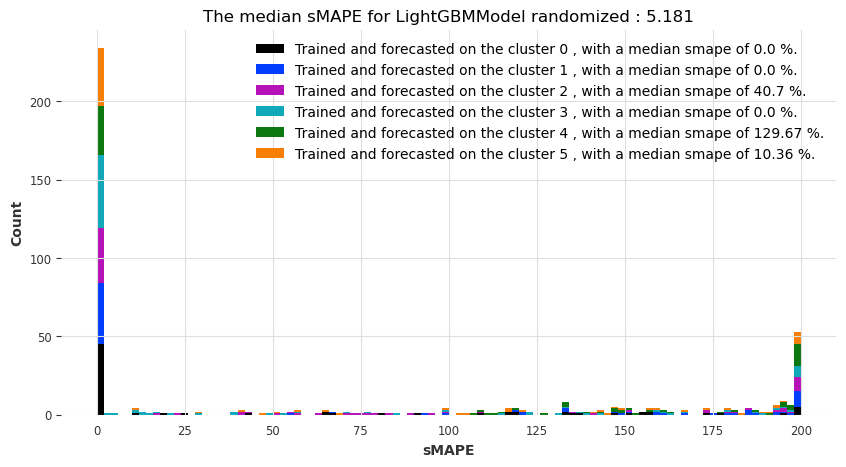

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

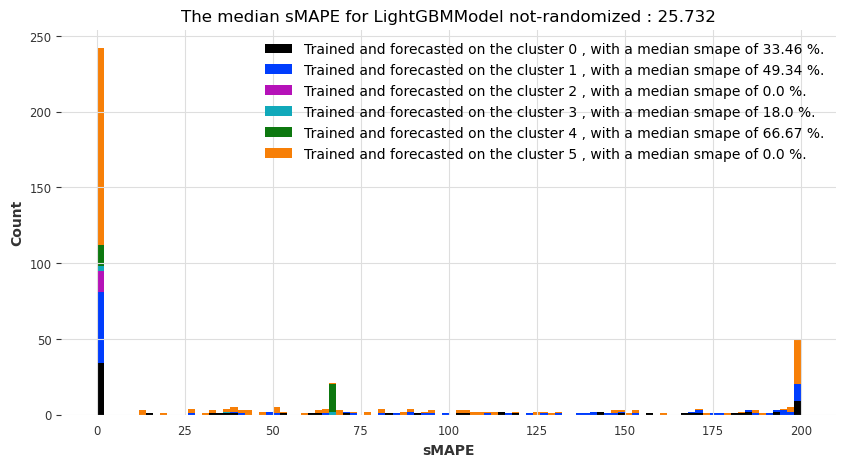

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

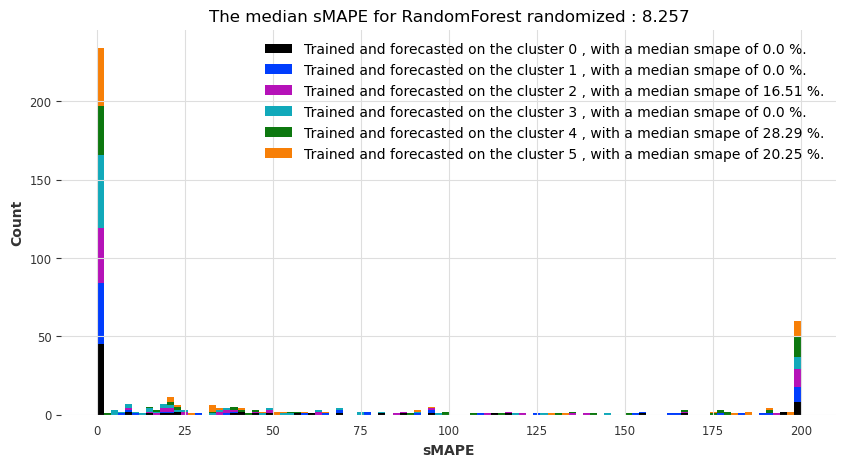

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

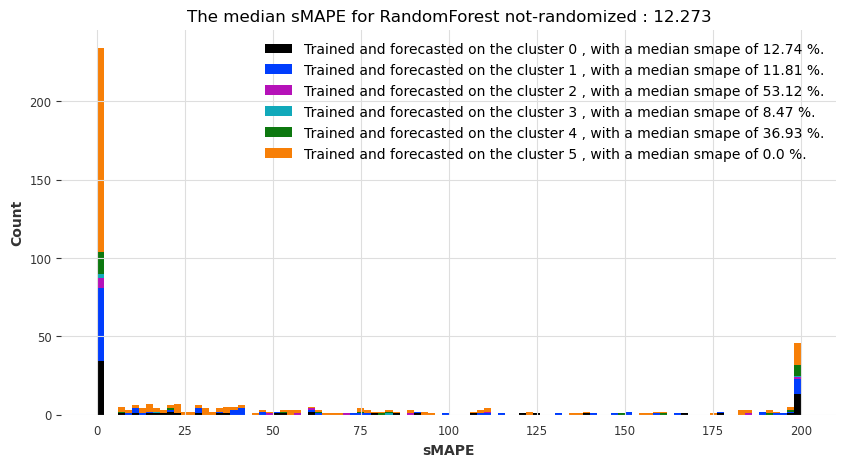

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

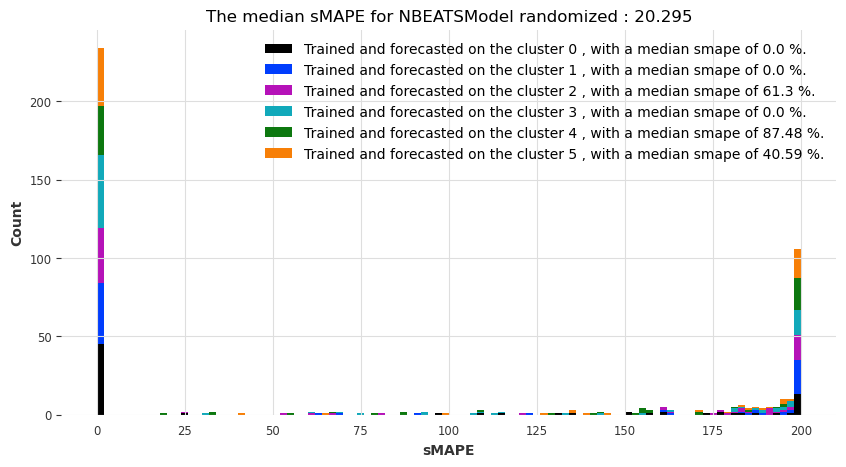

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

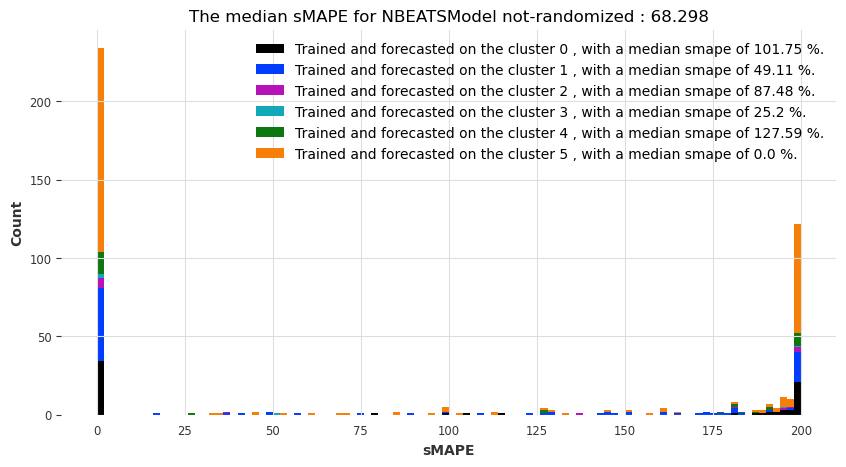

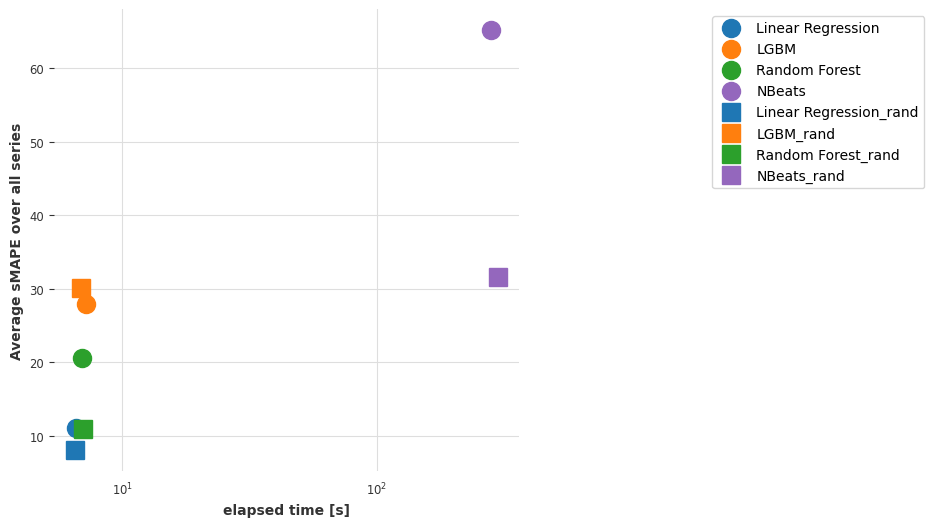

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_cit_t1_t2 with an horizon of 6 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

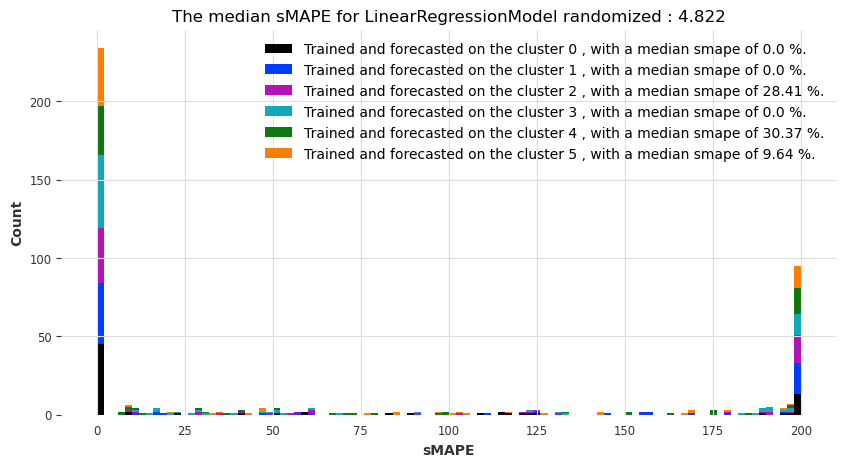

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

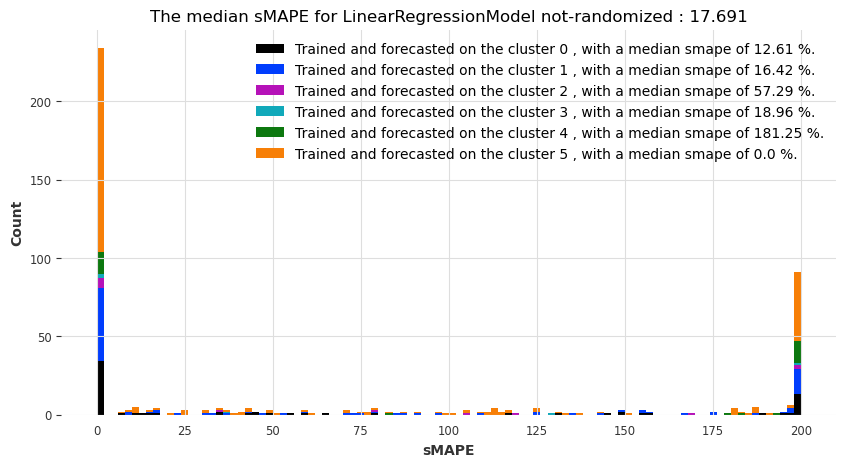

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

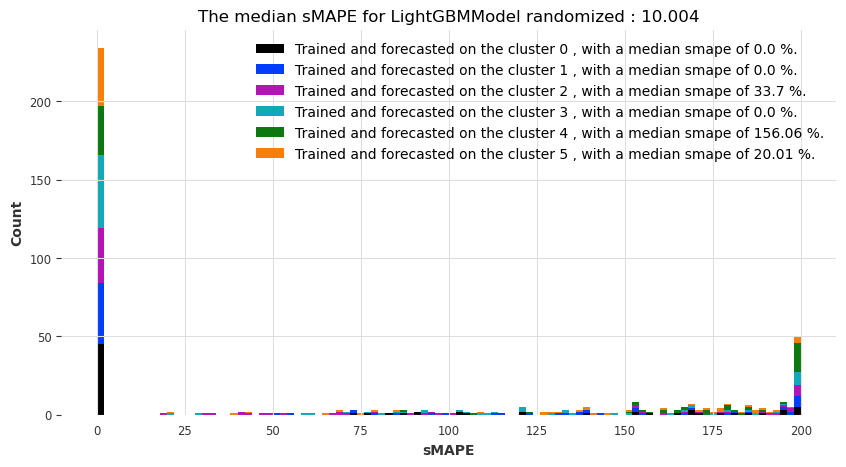

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

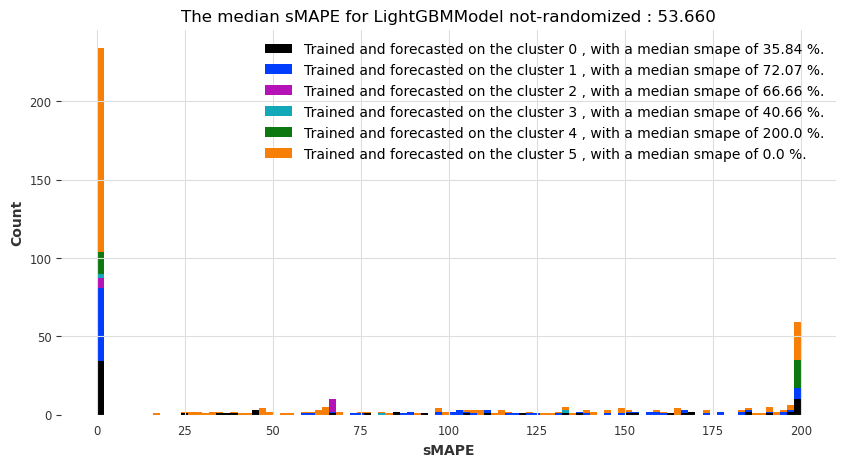

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

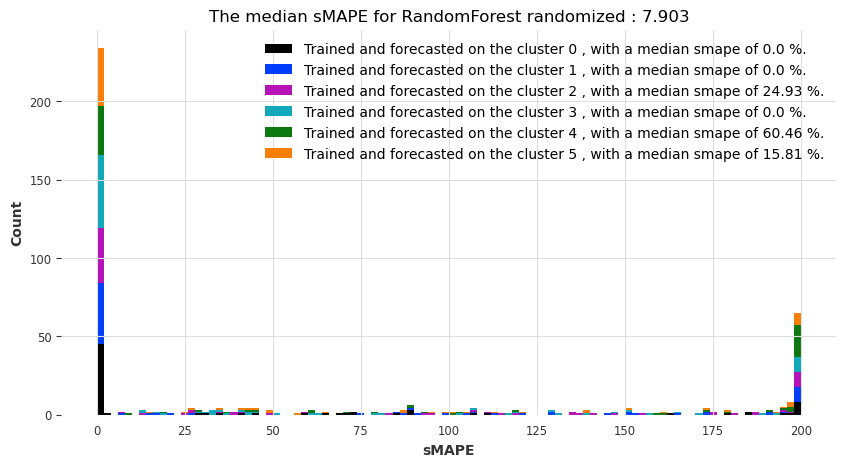

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

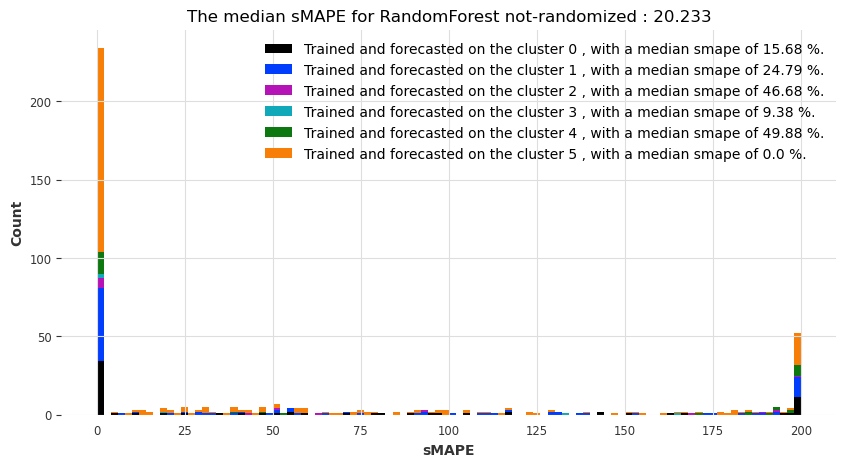

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

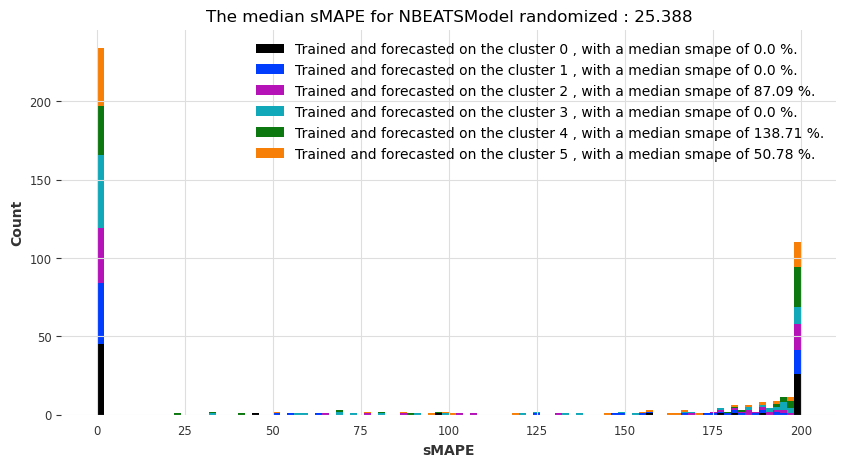

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

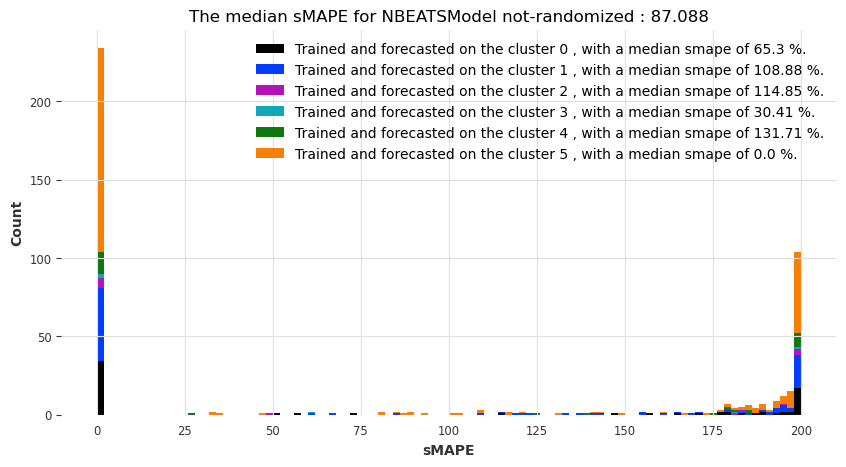

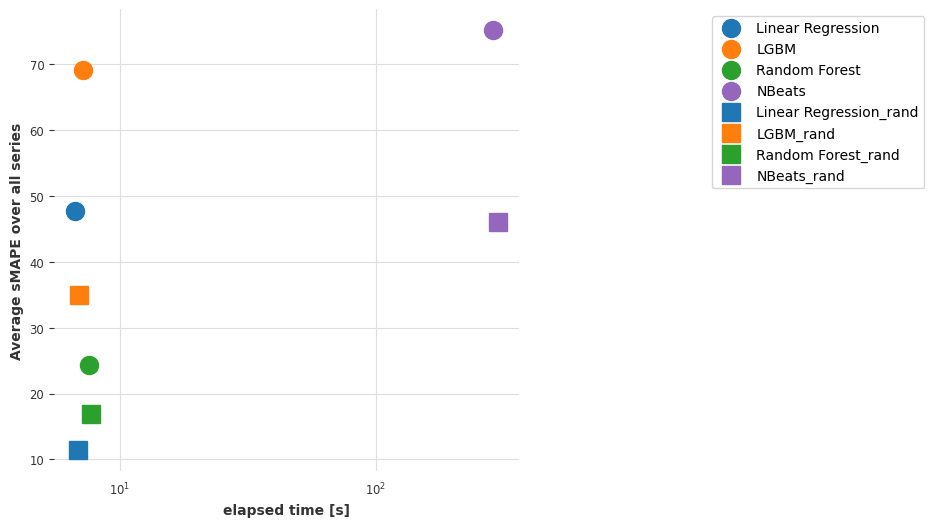

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_cit_t1_t2 with an horizon of 12 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

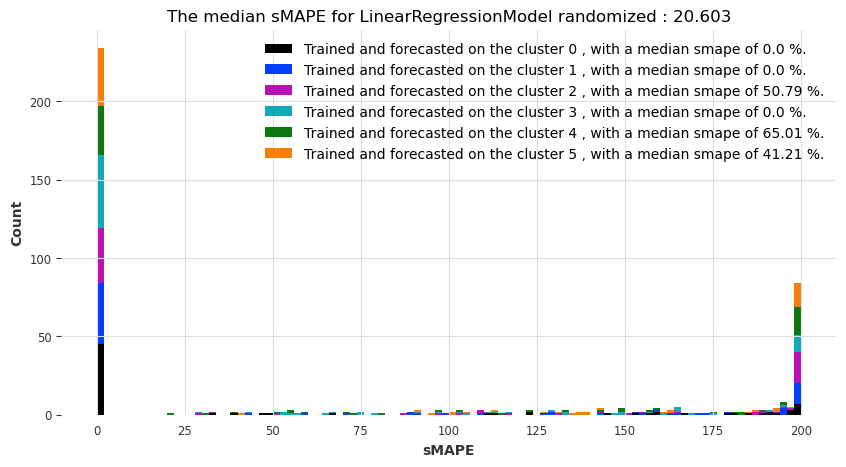

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

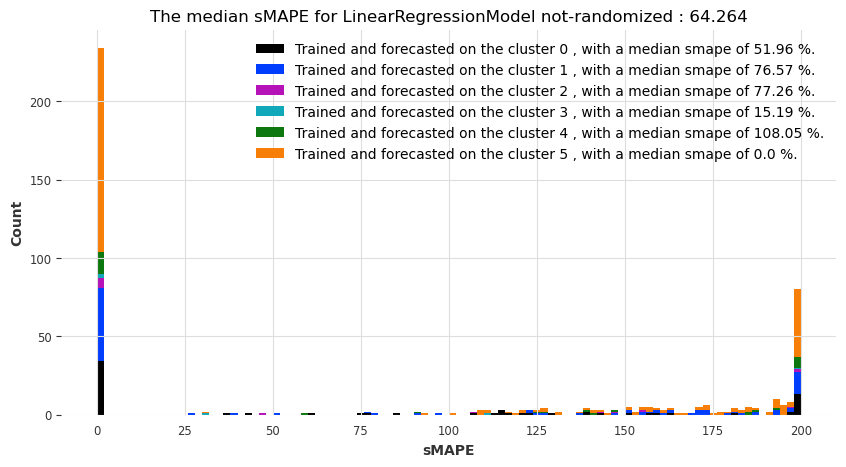

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

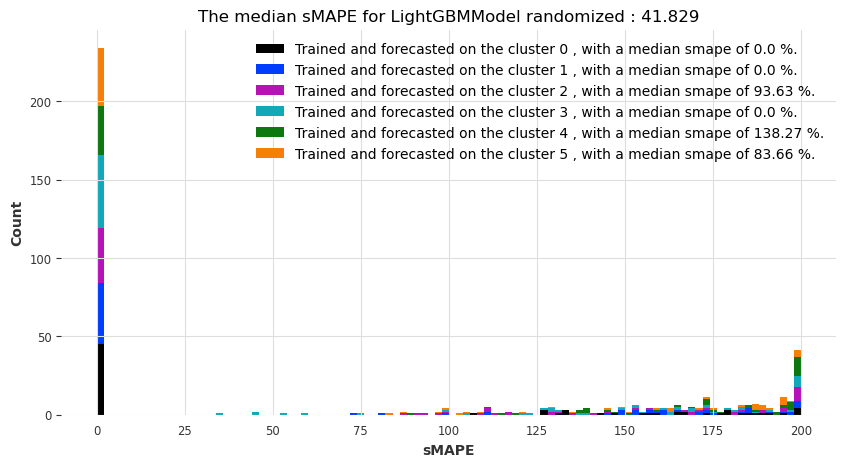

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

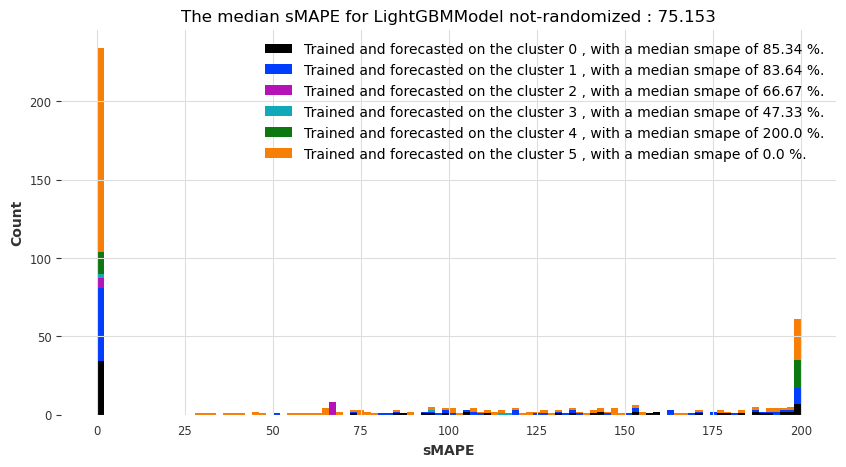

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

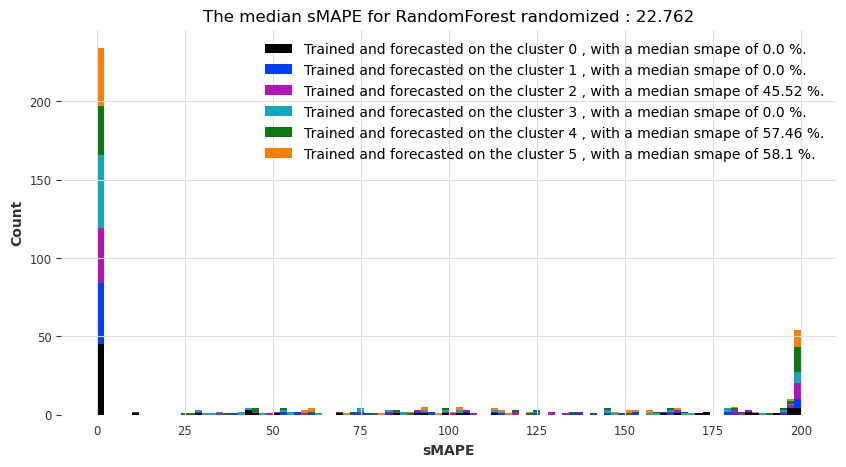

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

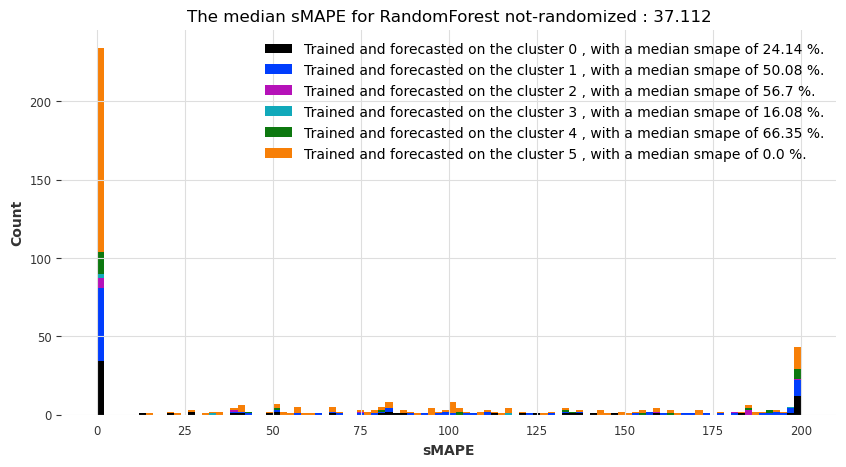

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

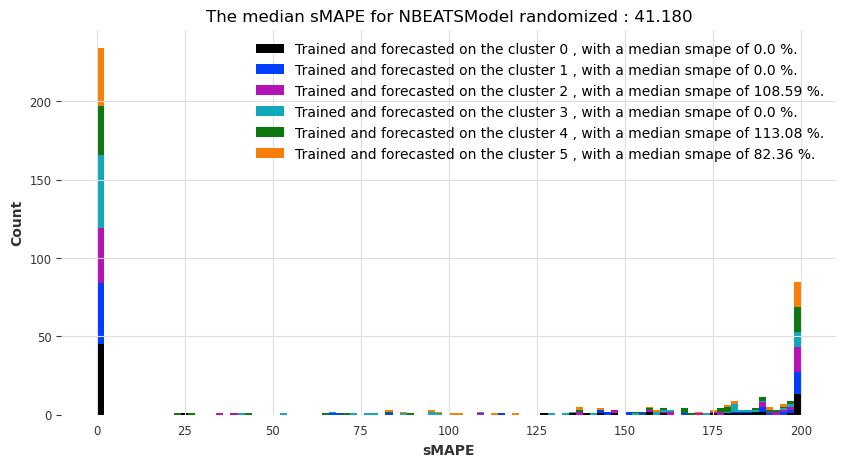

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

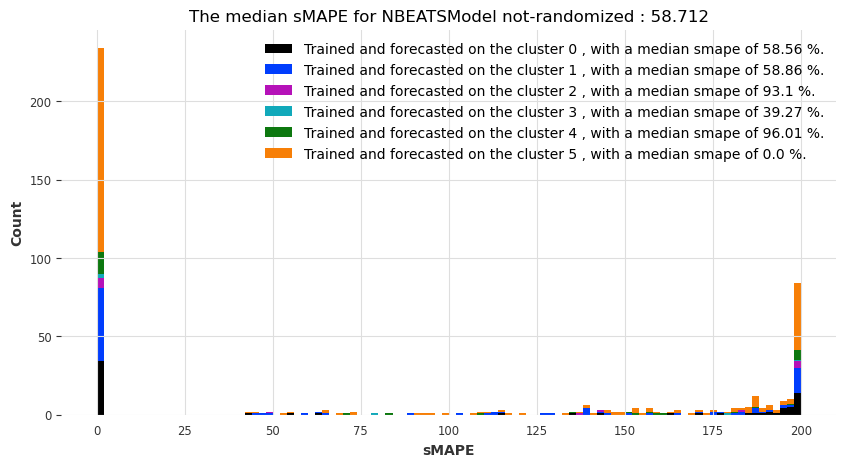

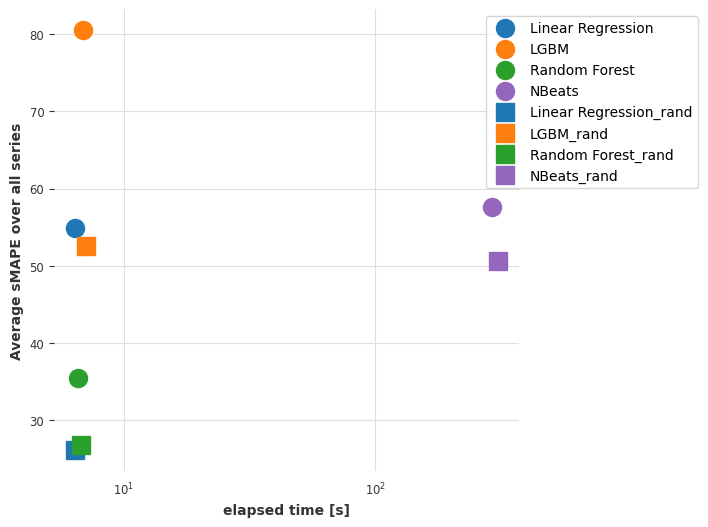

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_cit_t2_t1 are:
The results for index_cit_t2_t1 with an horizon of 3 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

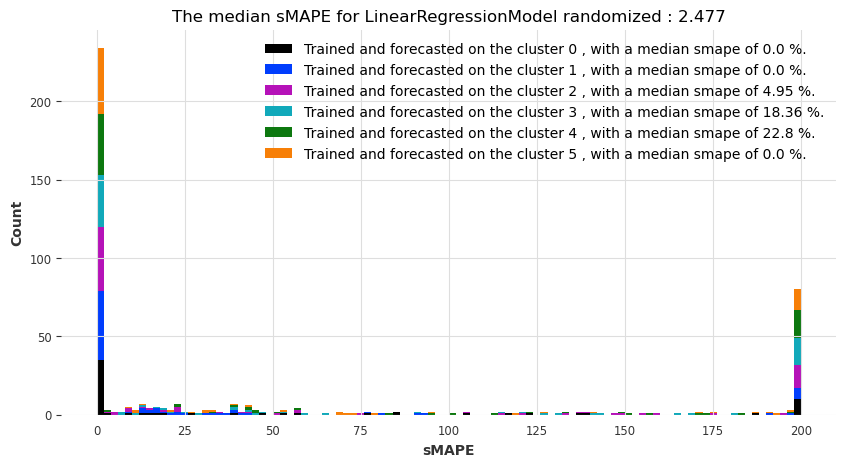

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

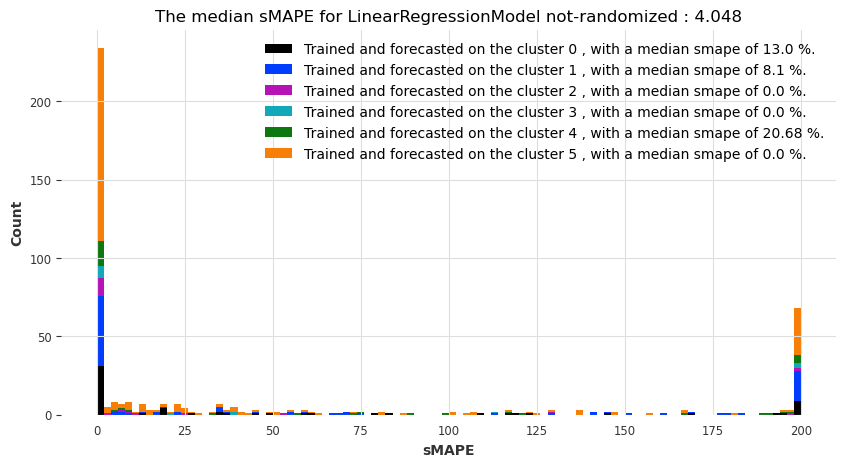

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

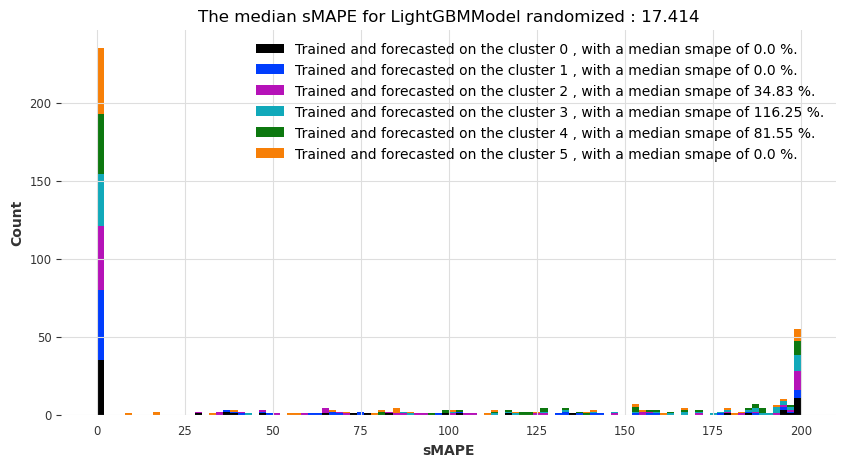

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

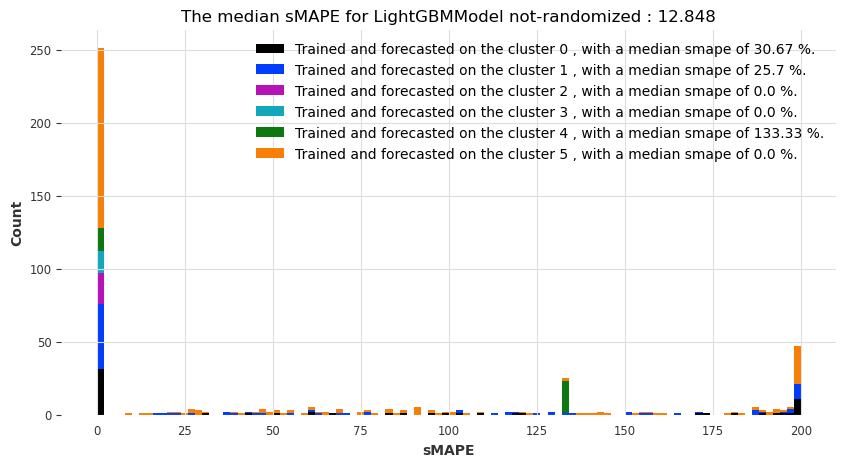

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

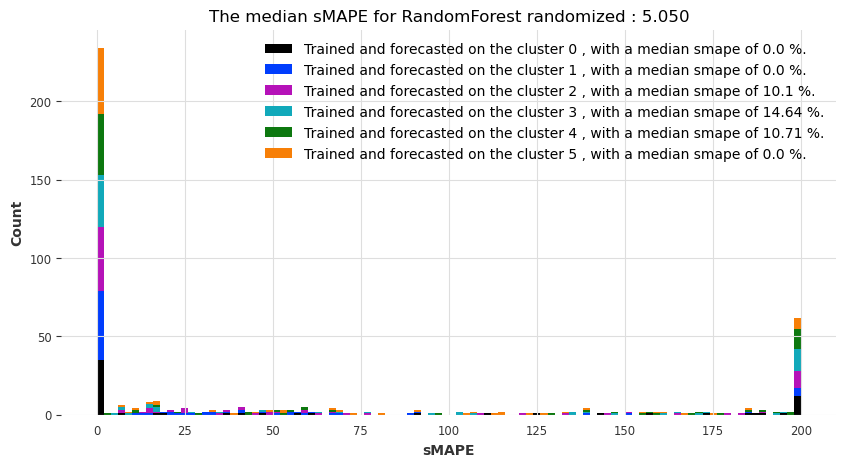

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

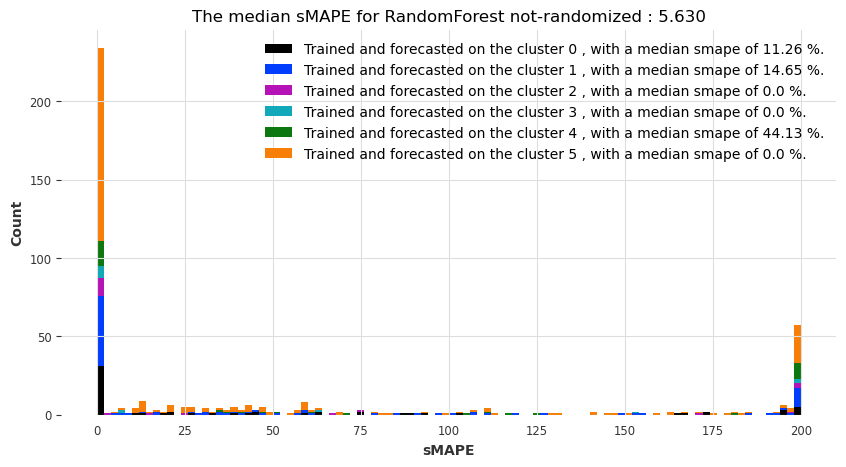

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

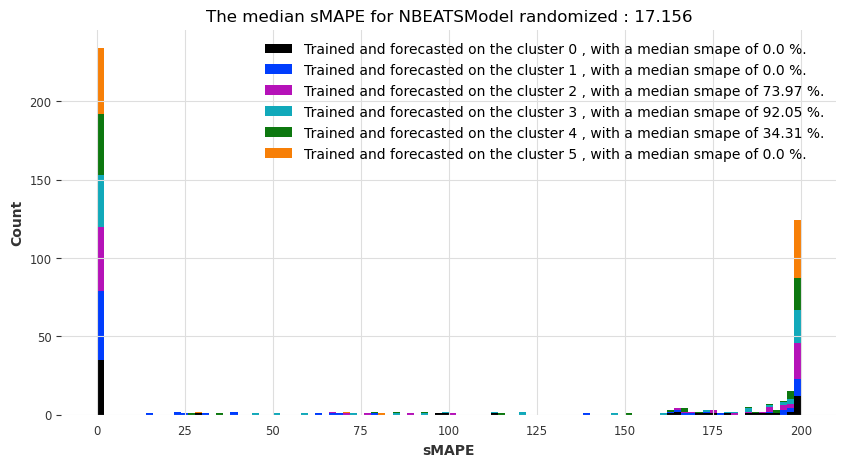

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

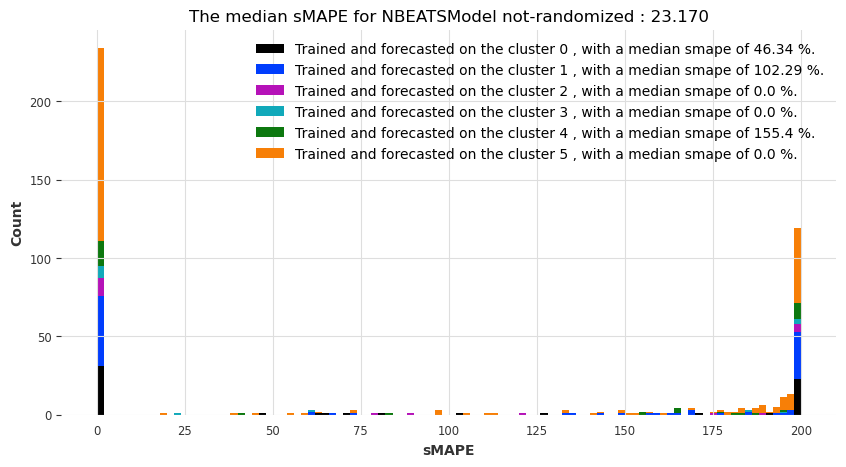

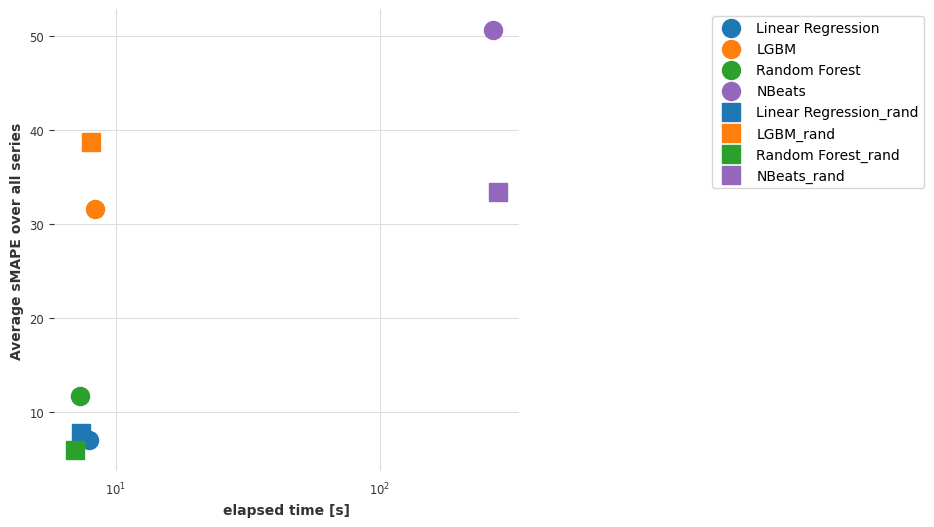

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_cit_t2_t1 with an horizon of 6 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

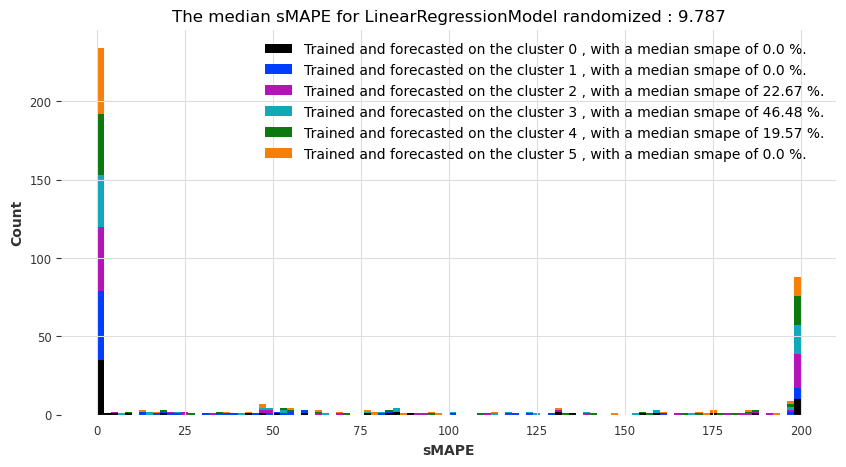

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

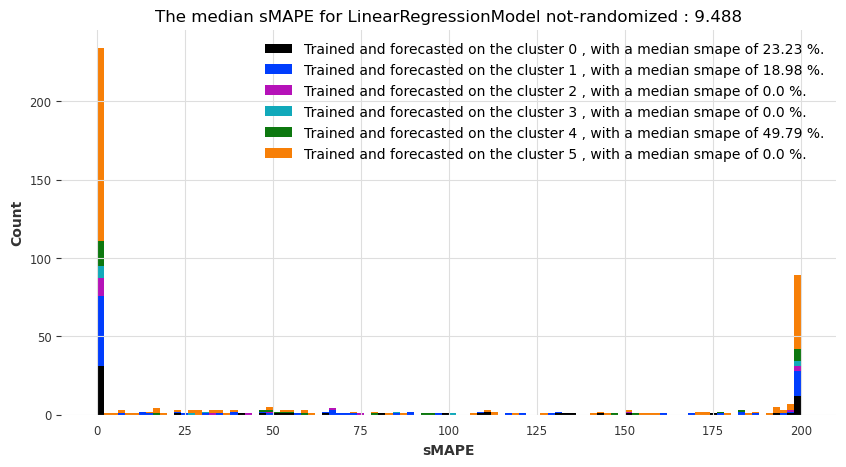

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

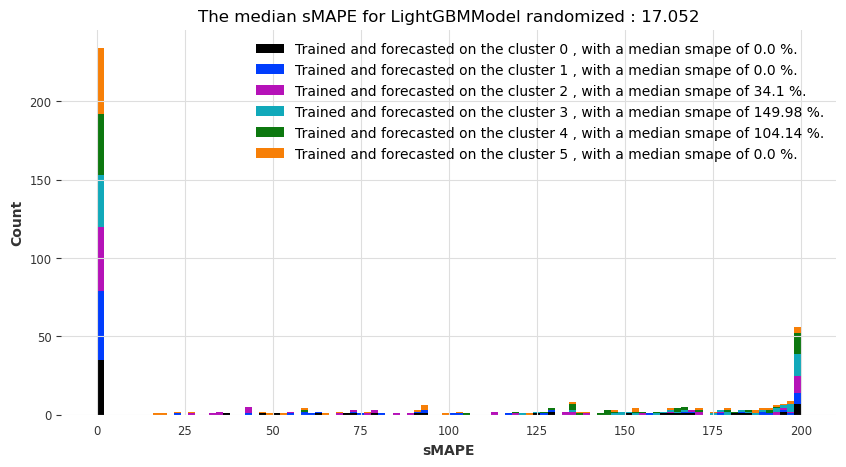

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

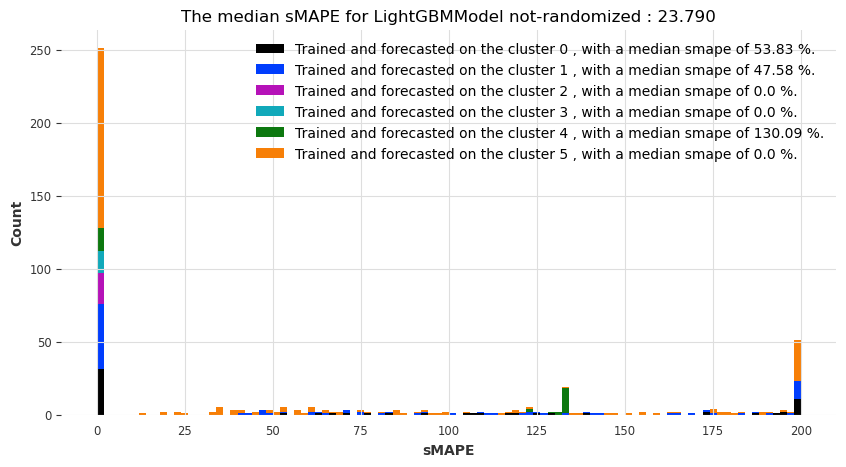

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

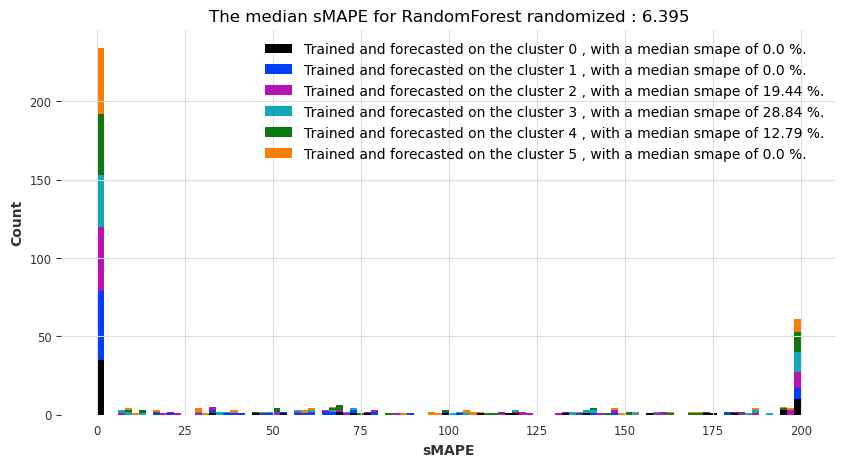

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

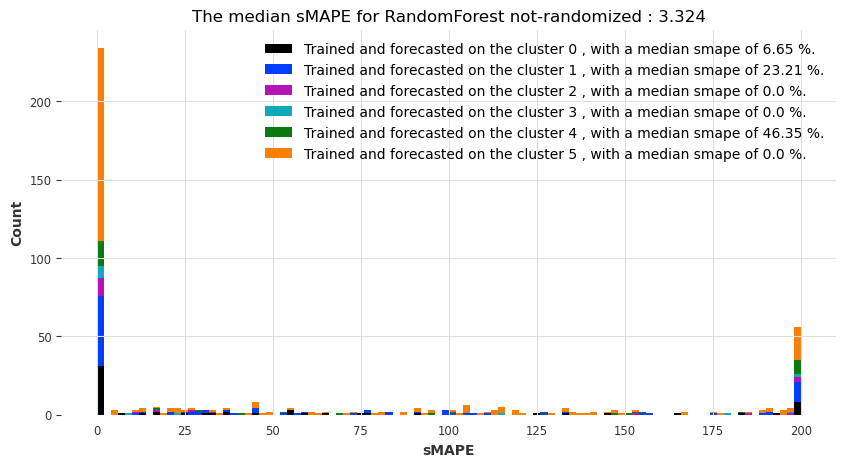

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

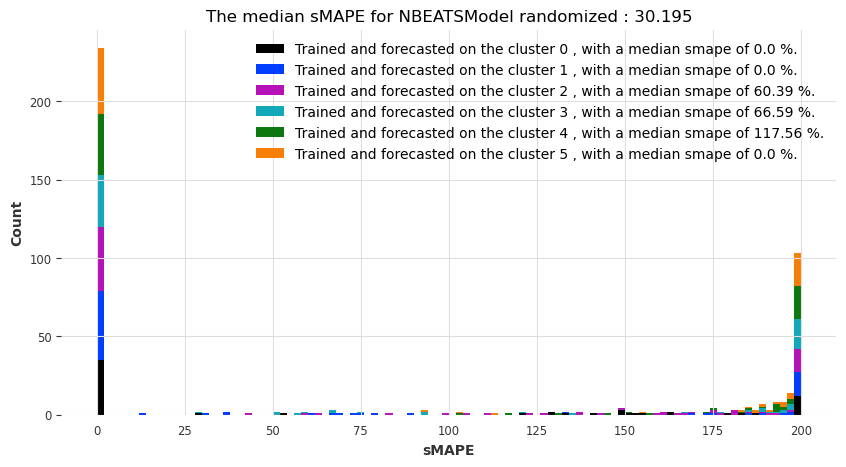

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

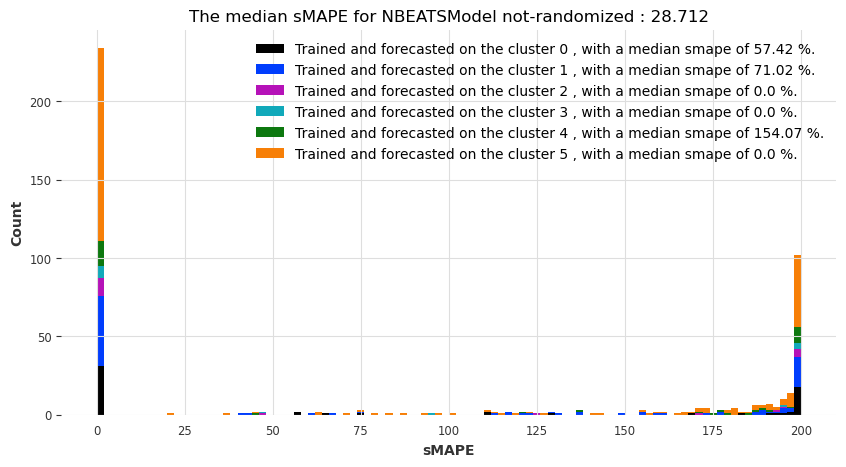

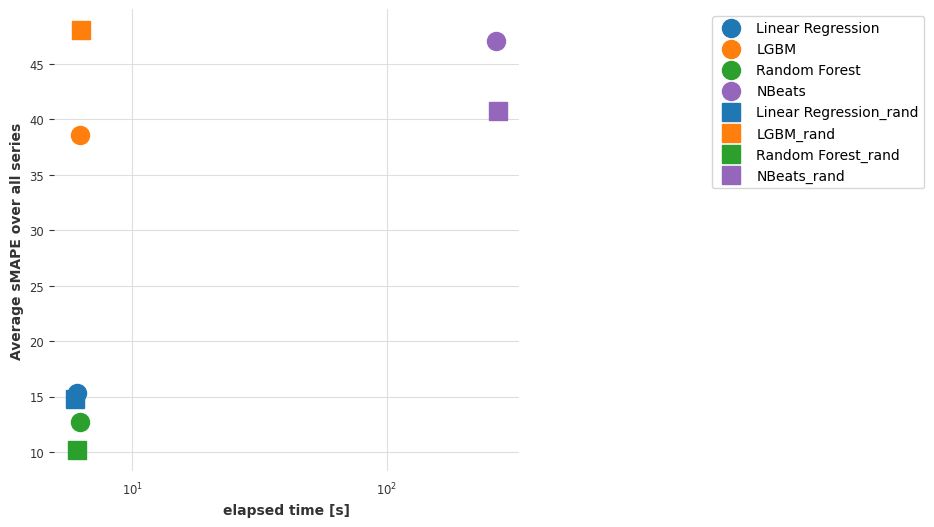

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_cit_t2_t1 with an horizon of 12 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

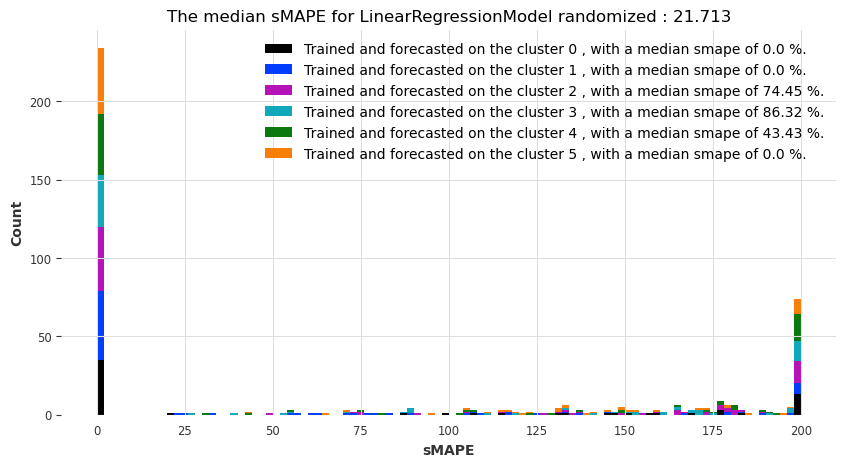

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

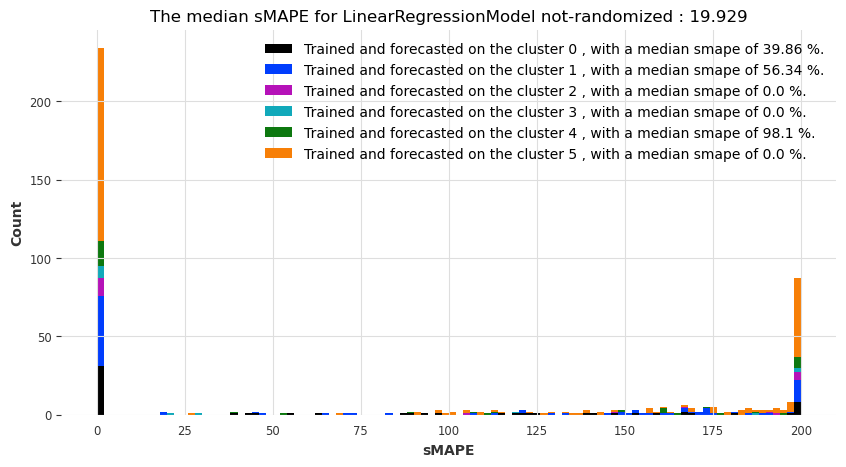

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

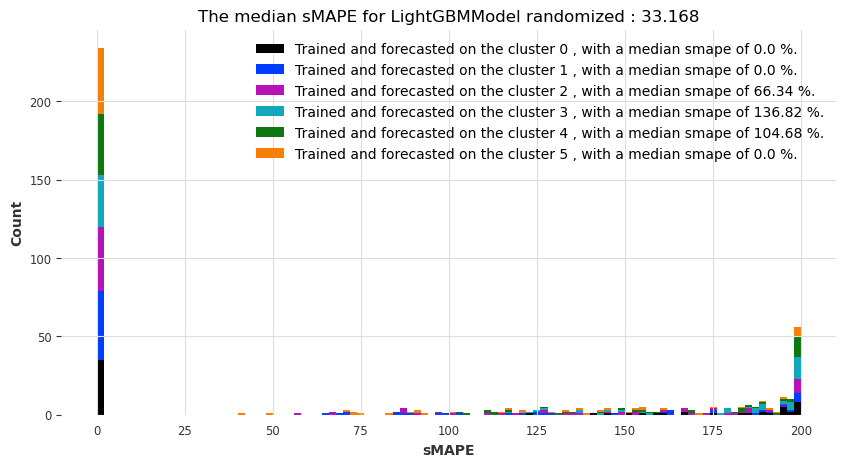

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

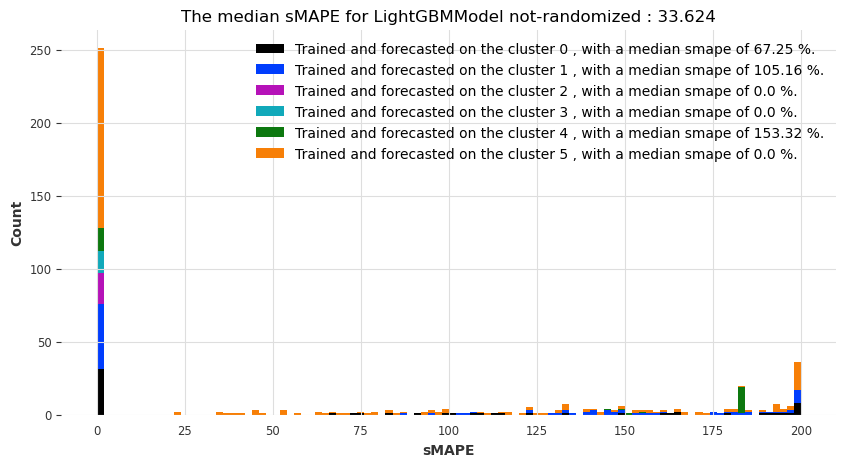

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

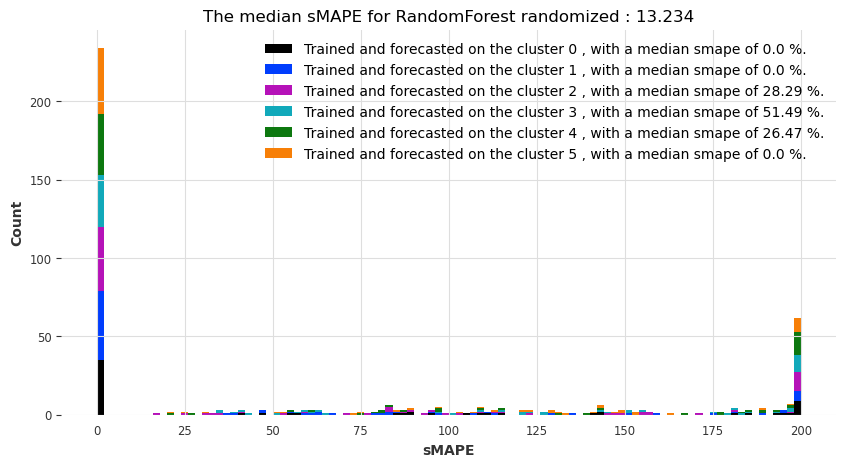

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

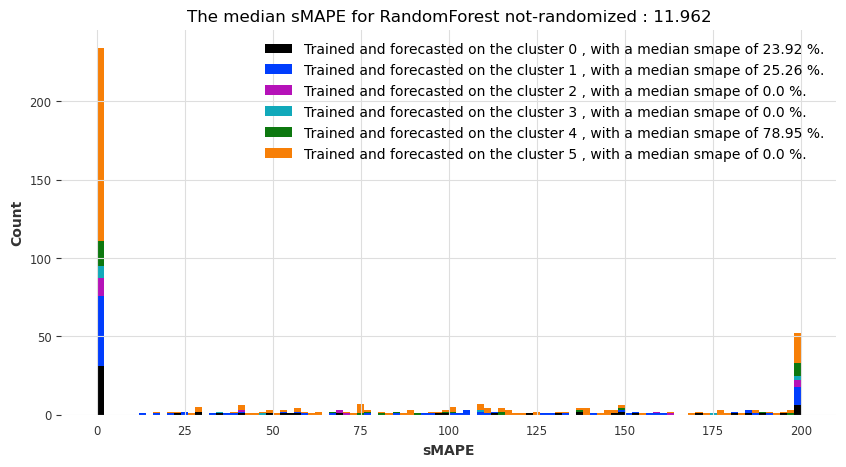

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

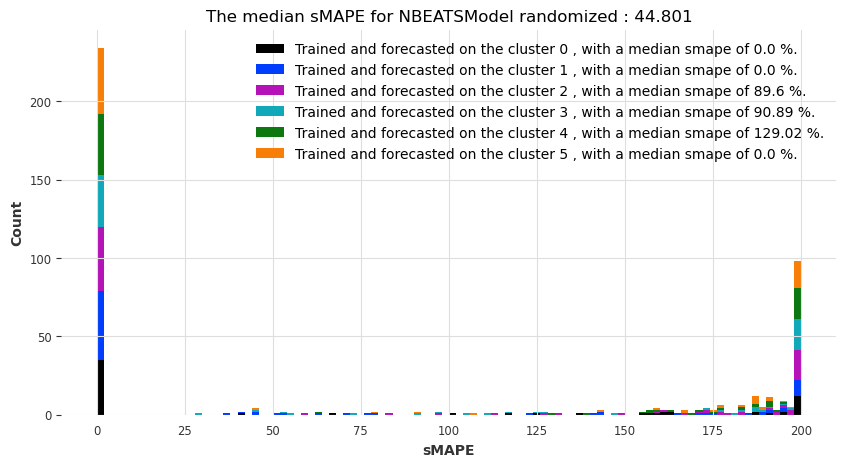

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

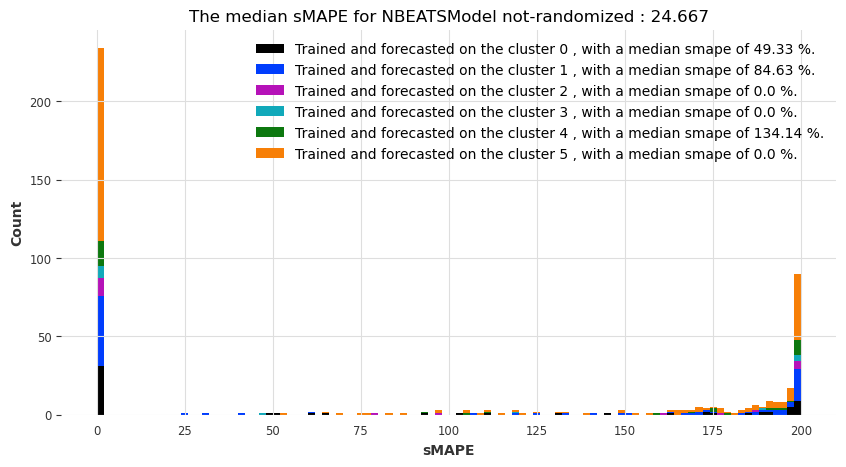

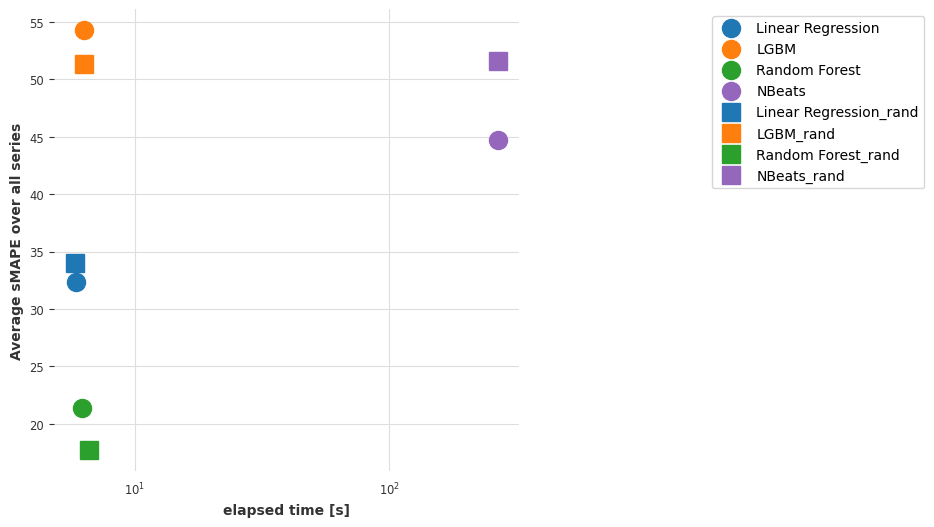

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_colab_increm are:
The results for index_colab_increm with an horizon of 3 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

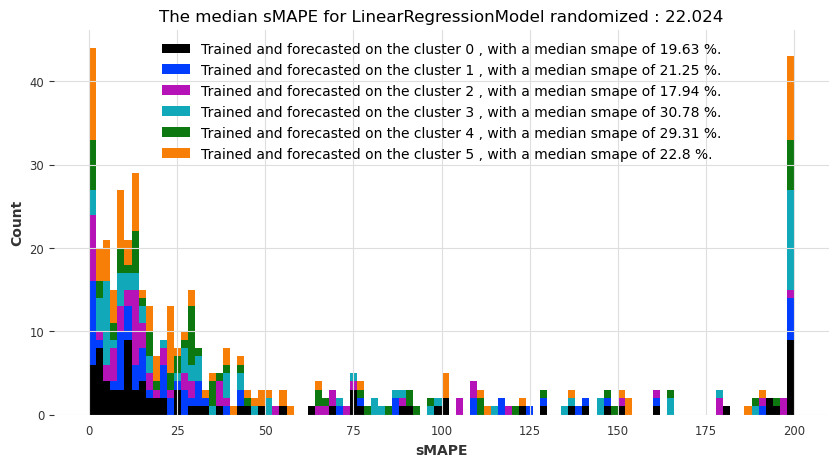

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

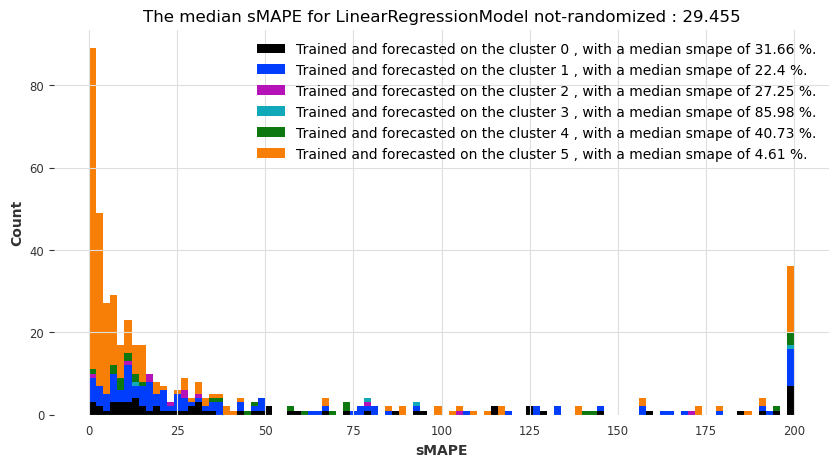

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

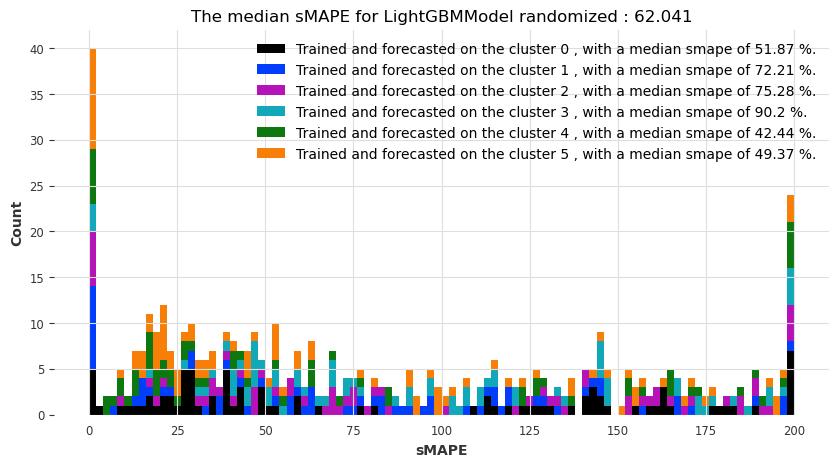

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

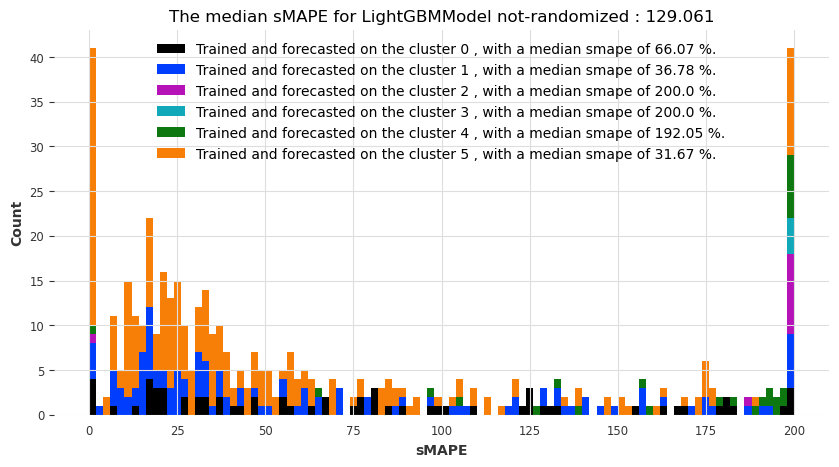

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

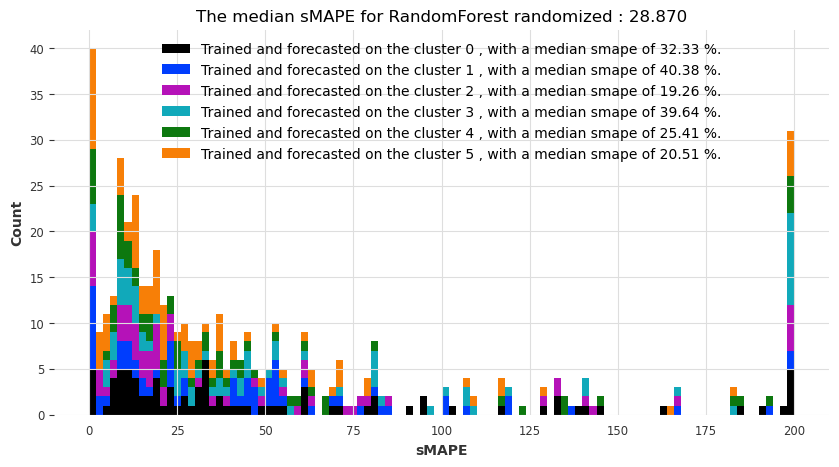

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

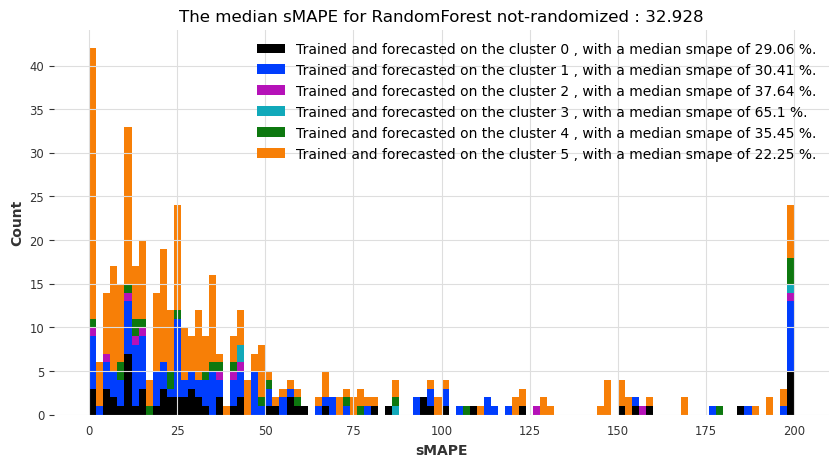

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

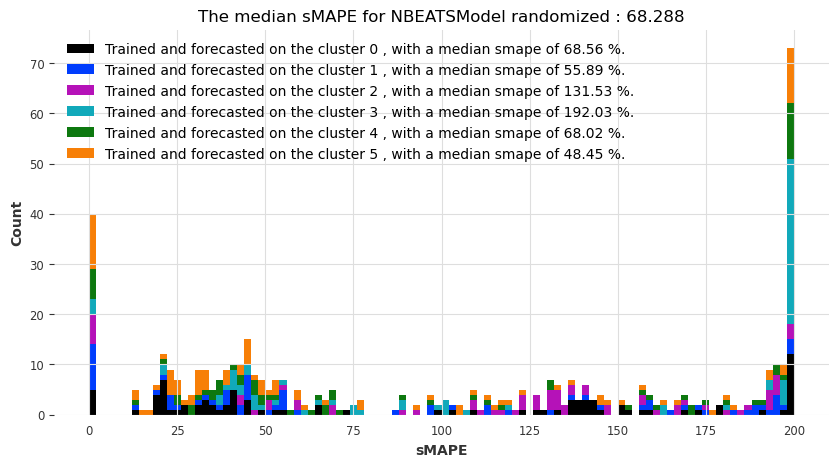

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

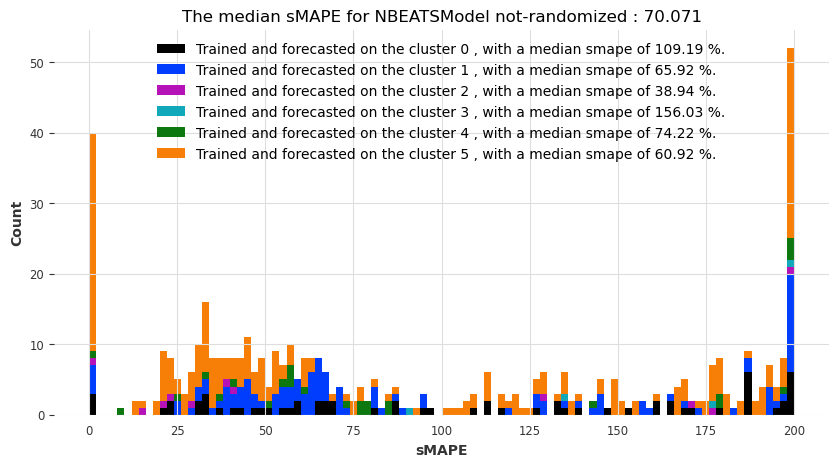

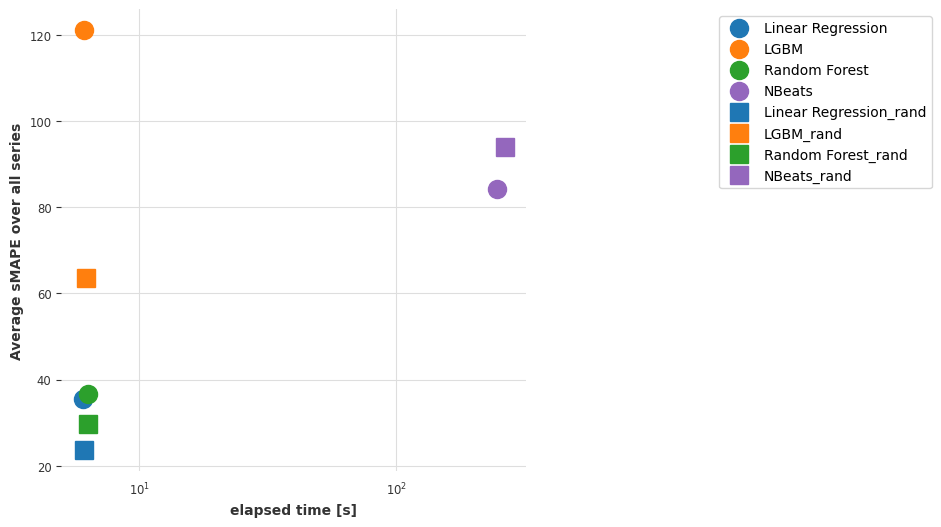

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_colab_increm with an horizon of 6 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

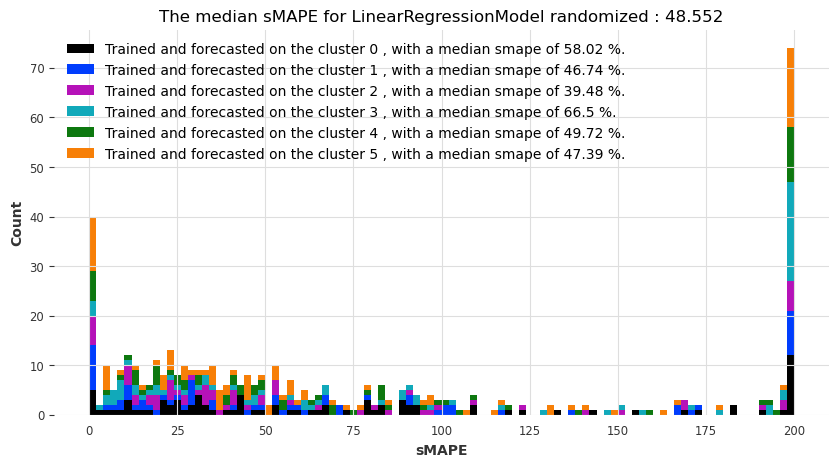

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

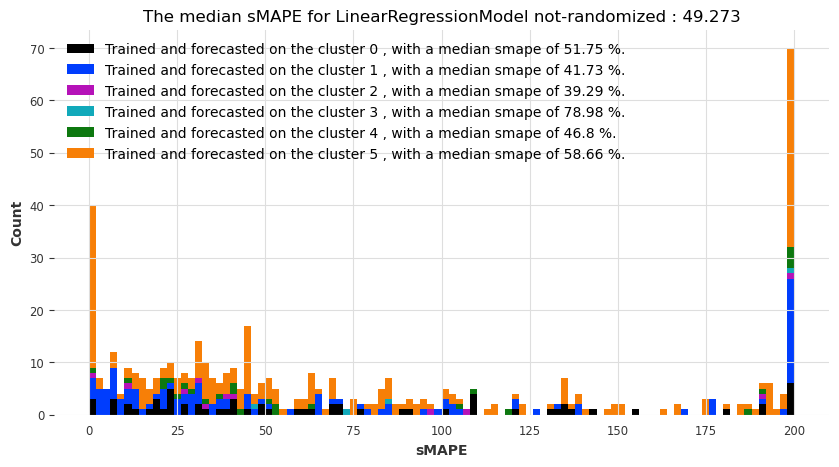

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

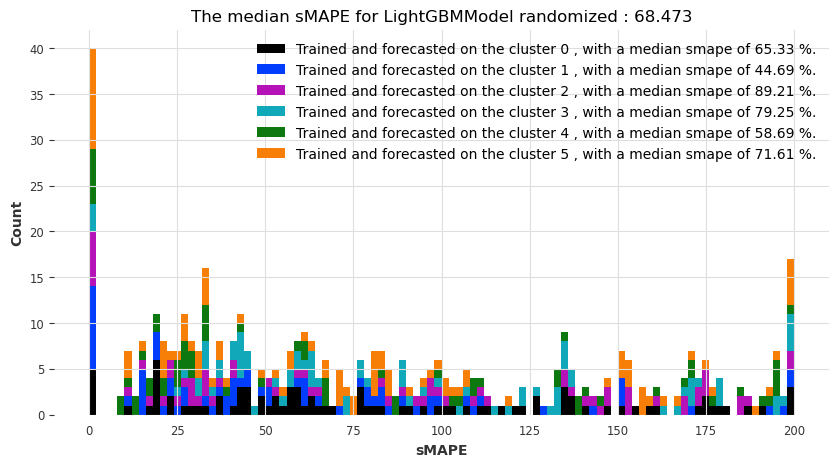

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

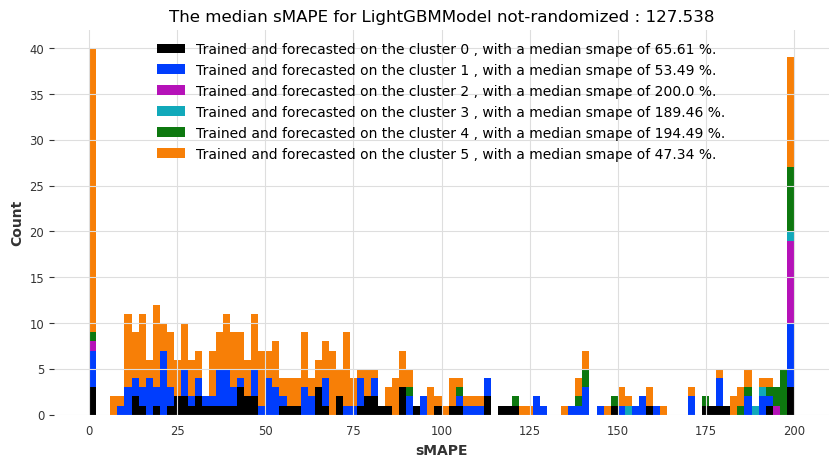

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

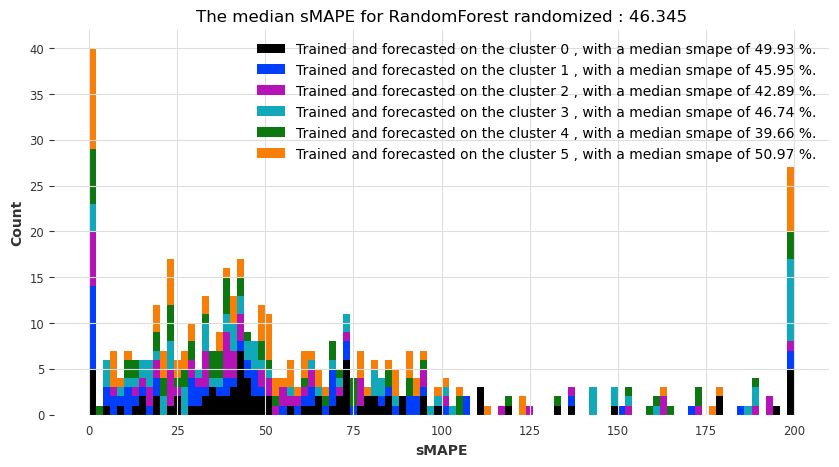

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

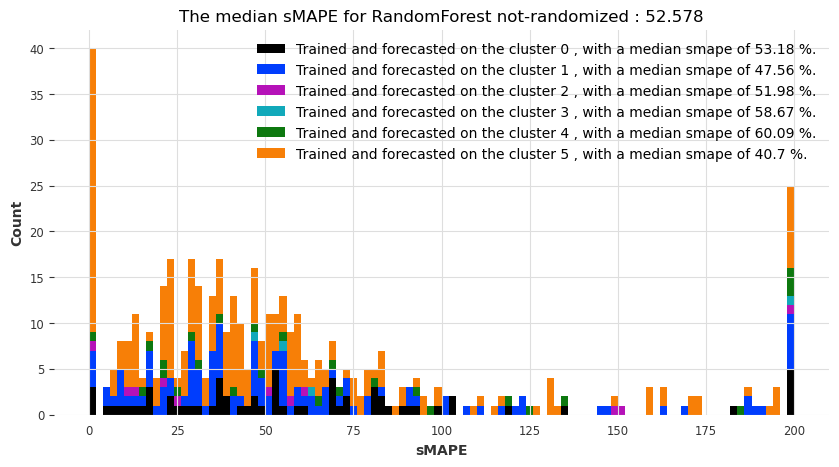

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

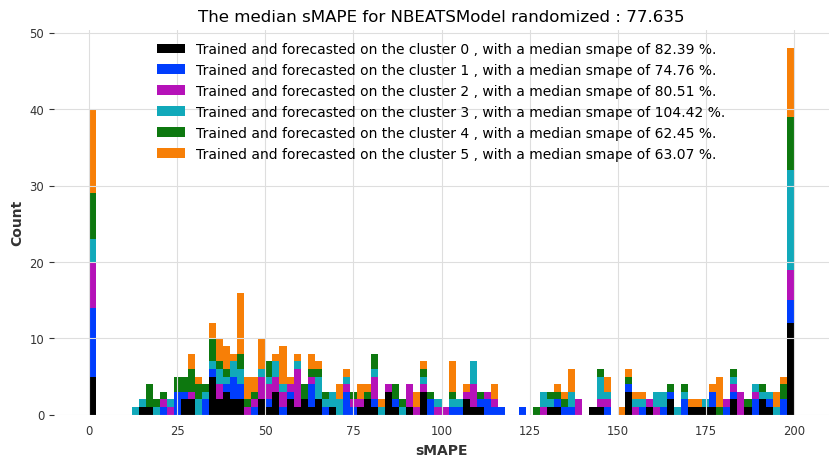

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

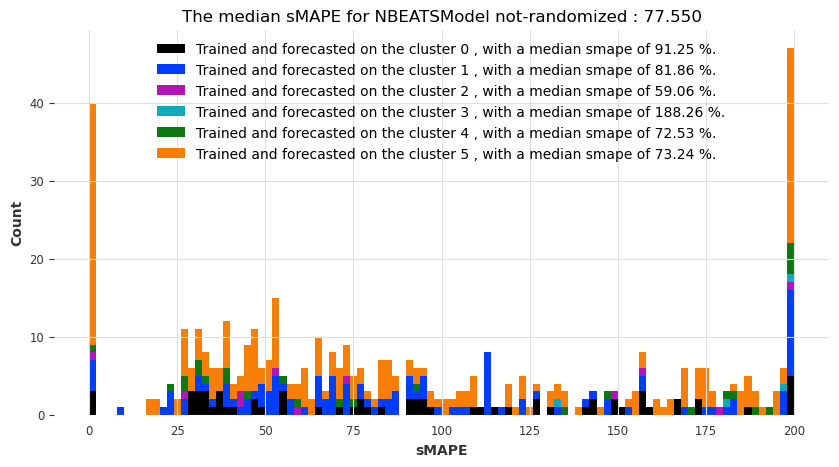

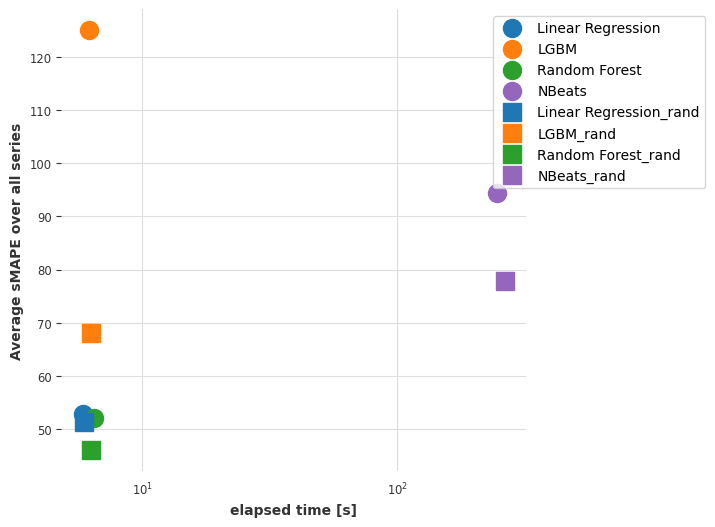

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_colab_increm with an horizon of 12 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

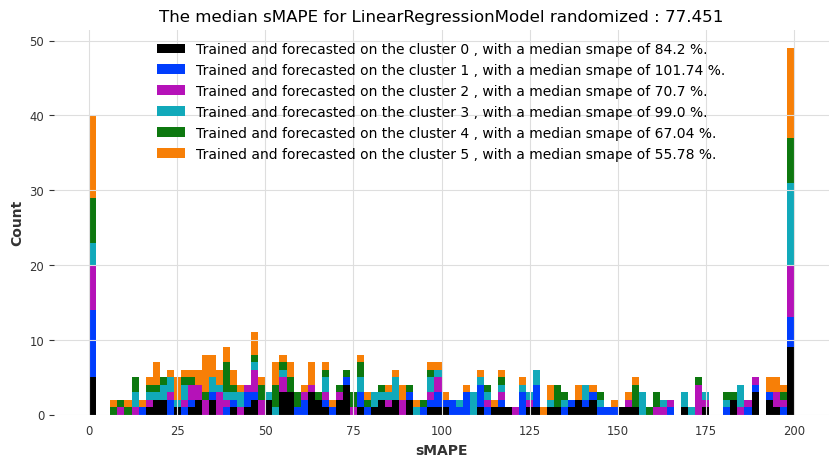

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

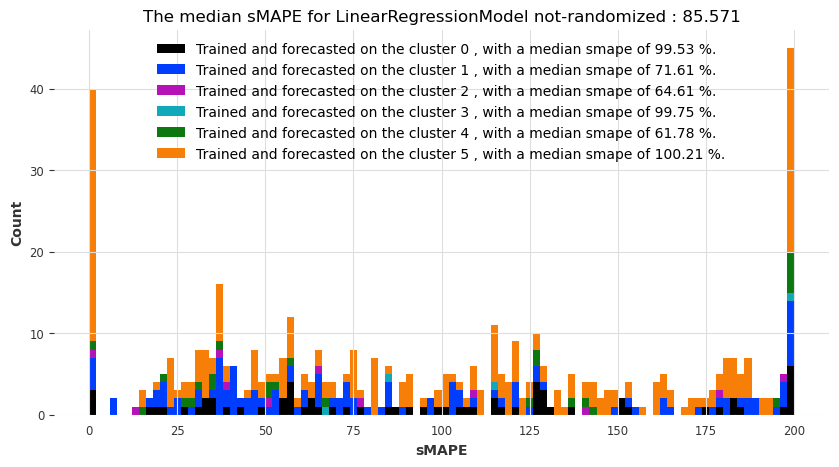

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

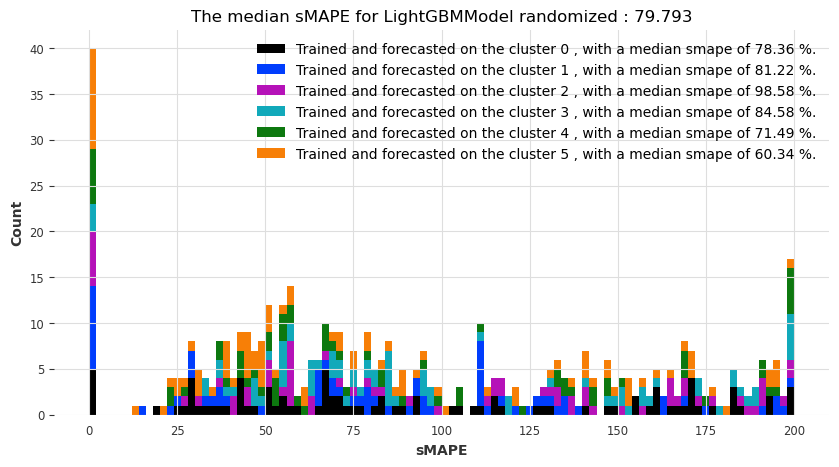

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

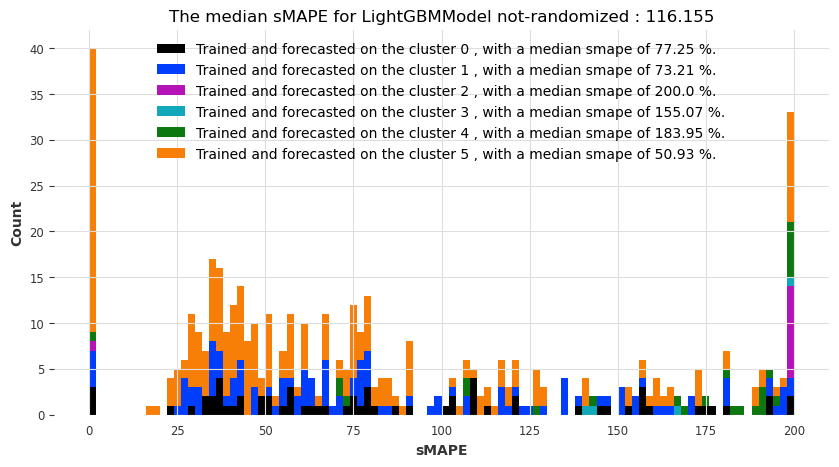

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

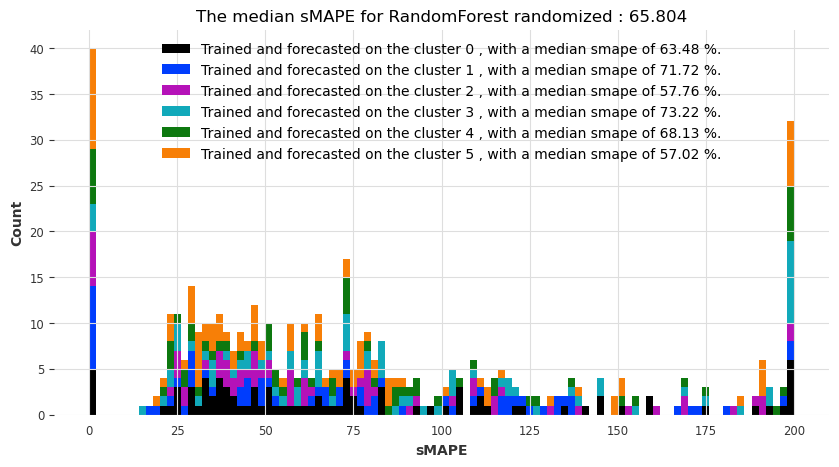

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

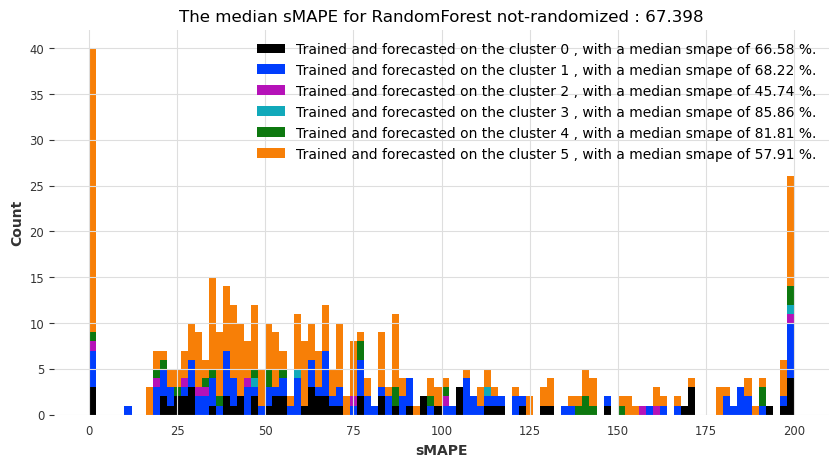

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

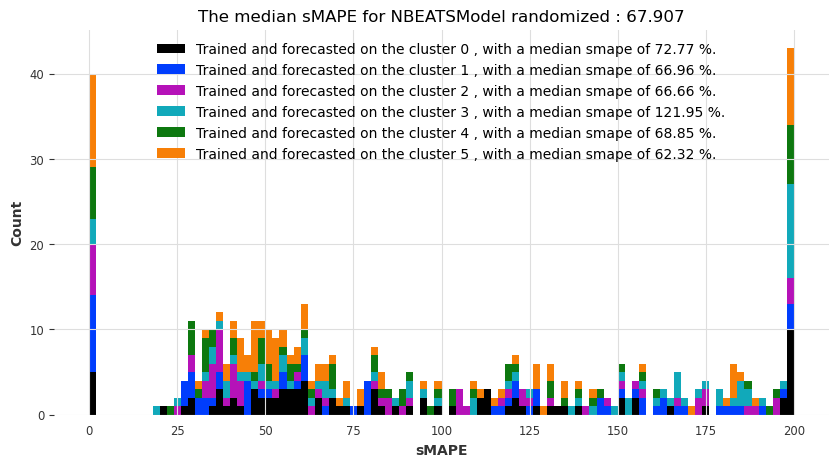

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

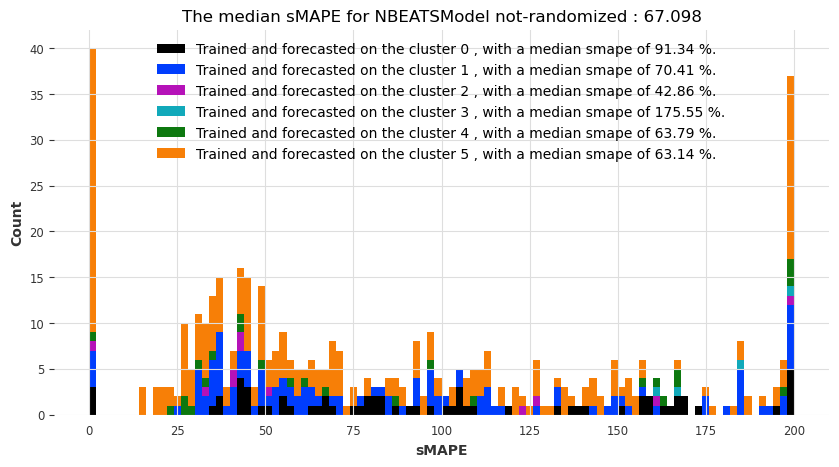

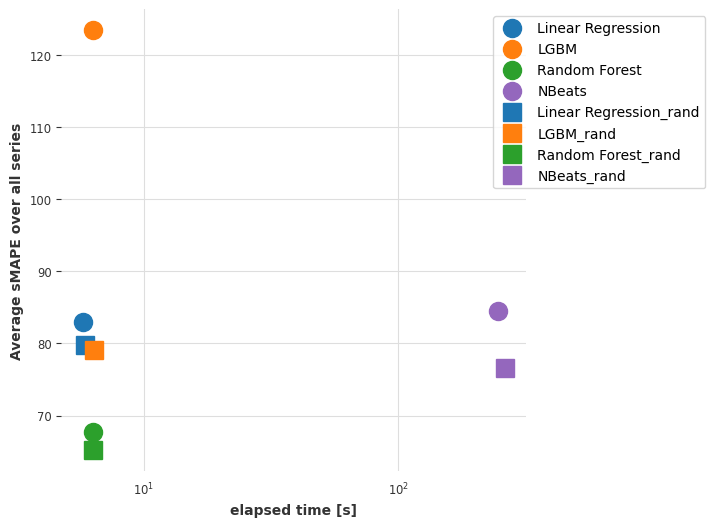

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_colab_notincrem are:
The results for index_colab_notincrem with an horizon of 3 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

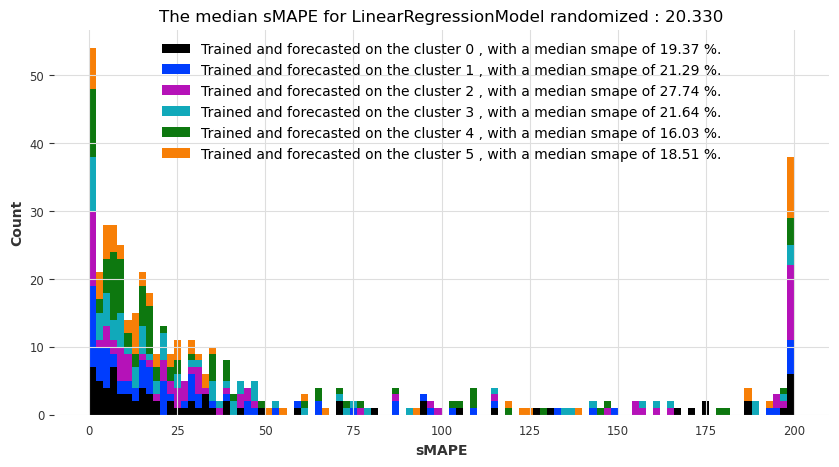

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

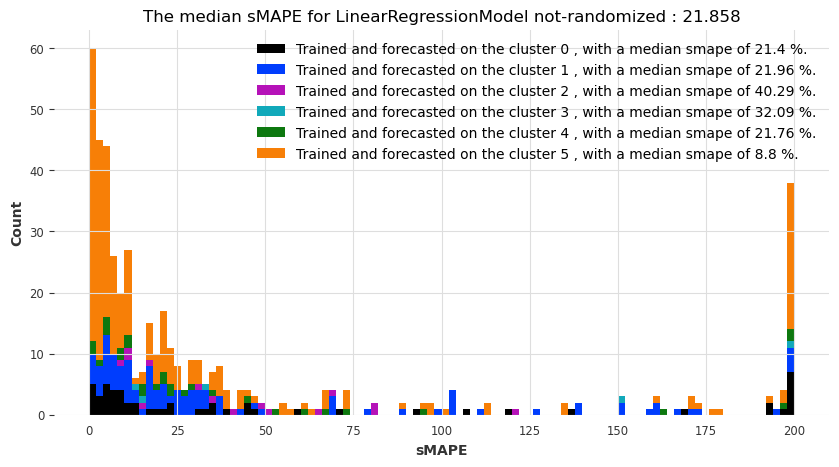

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

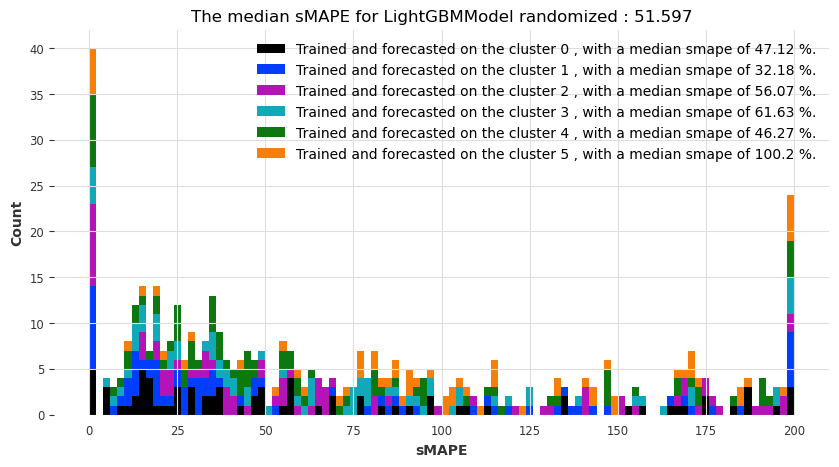

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

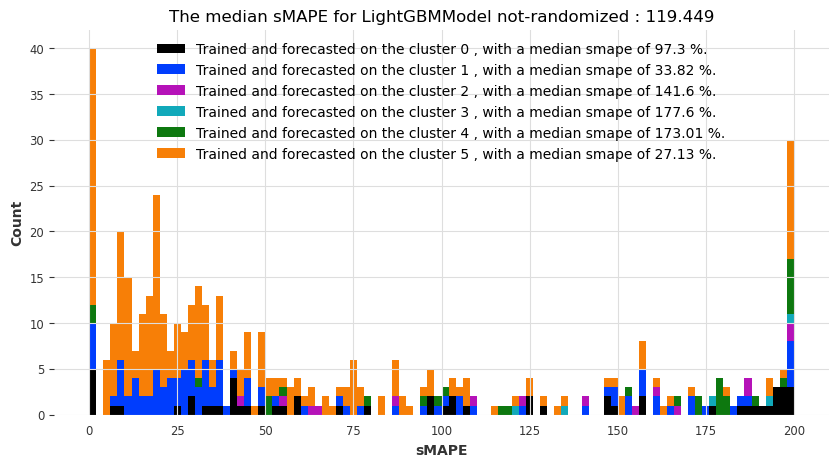

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

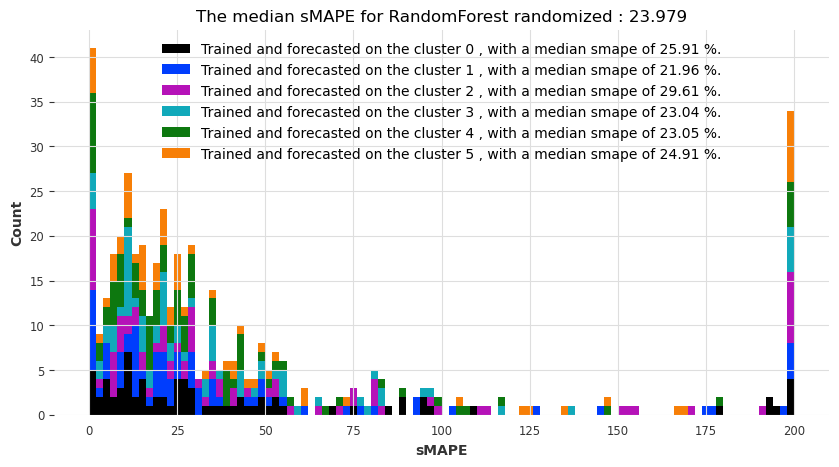

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

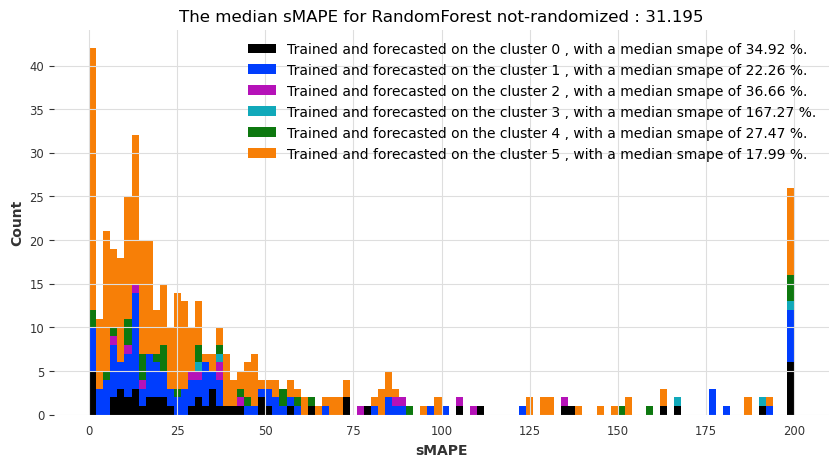

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

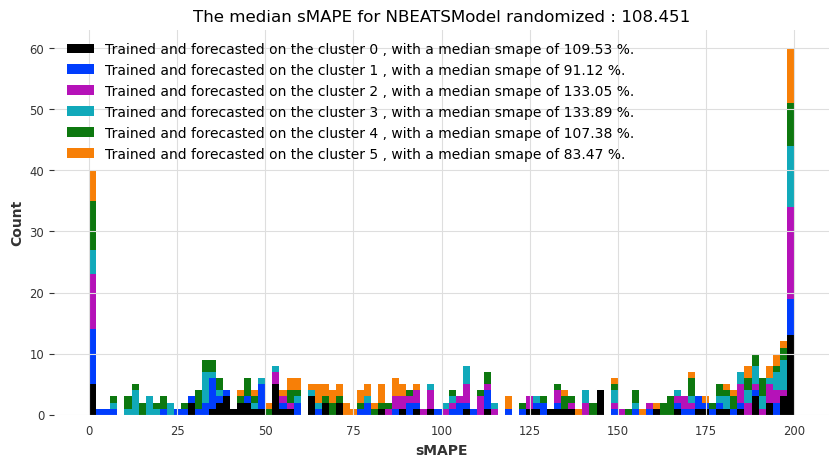

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

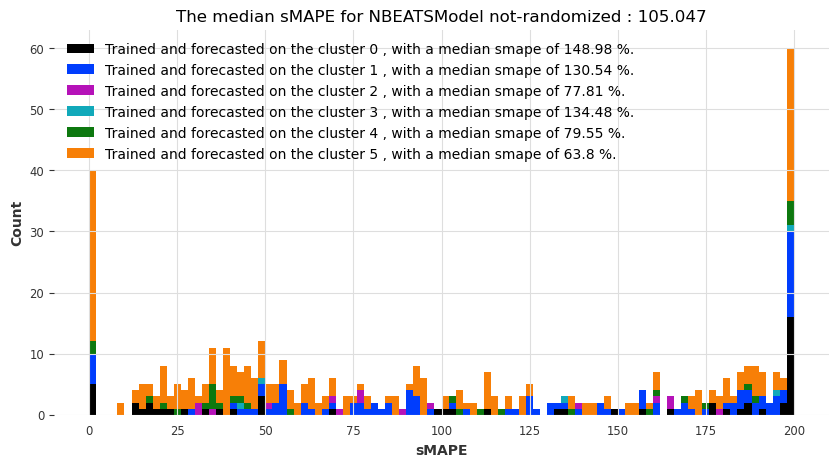

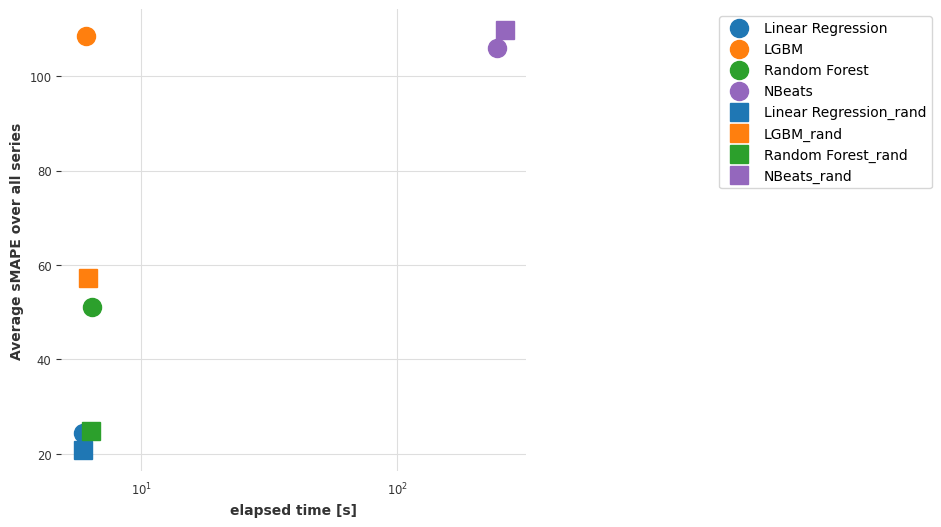

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_colab_notincrem with an horizon of 6 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

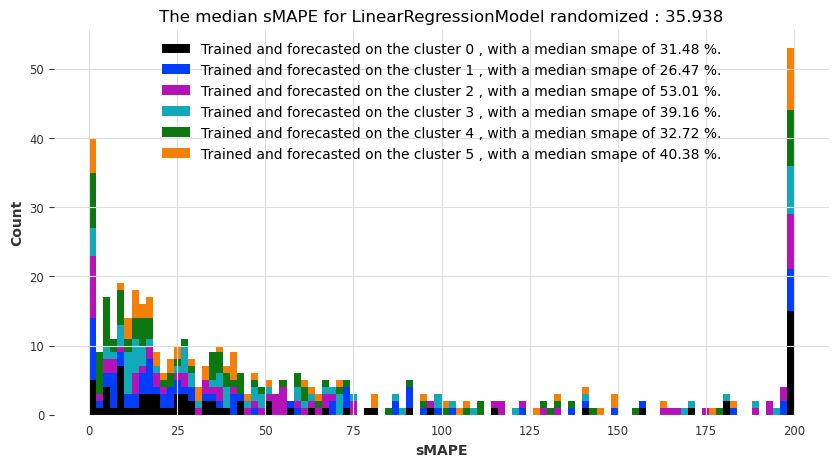

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

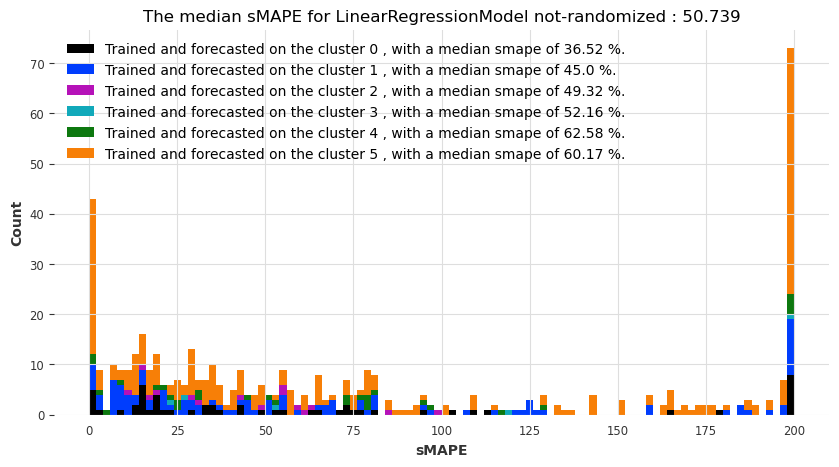

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

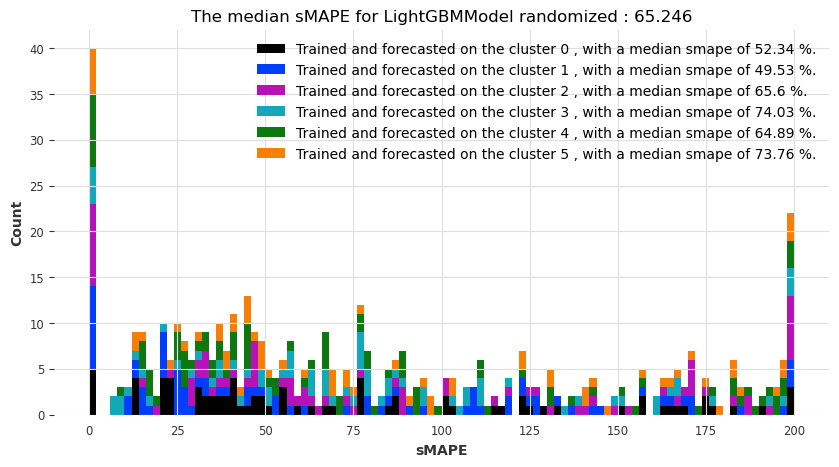

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

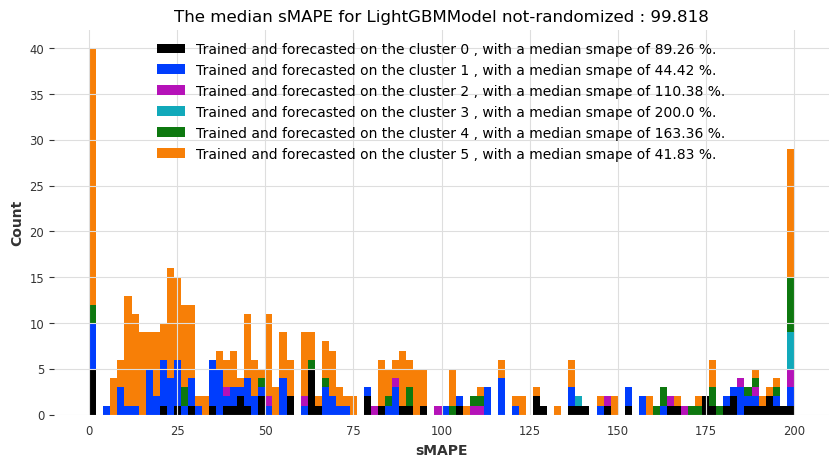

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

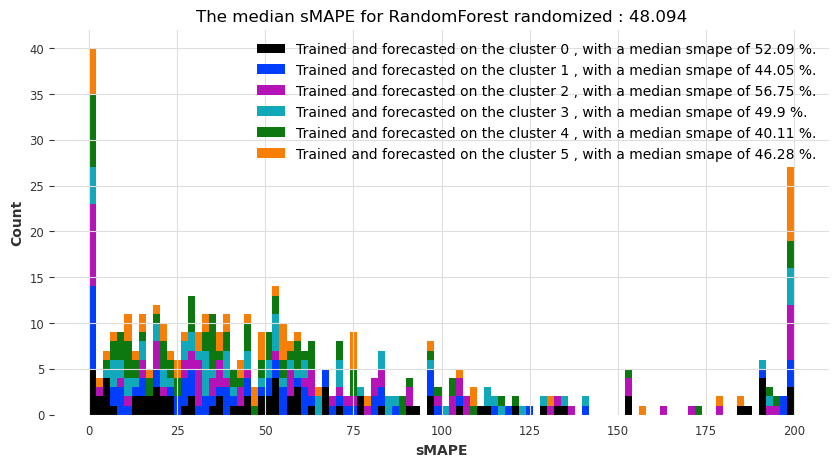

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

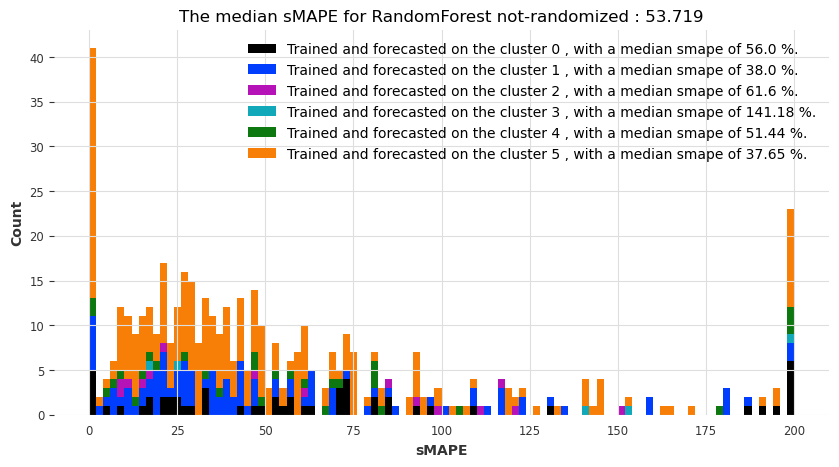

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

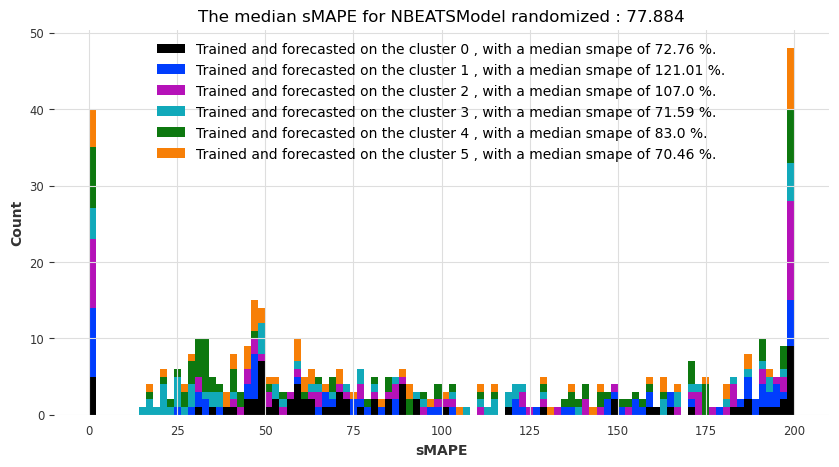

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

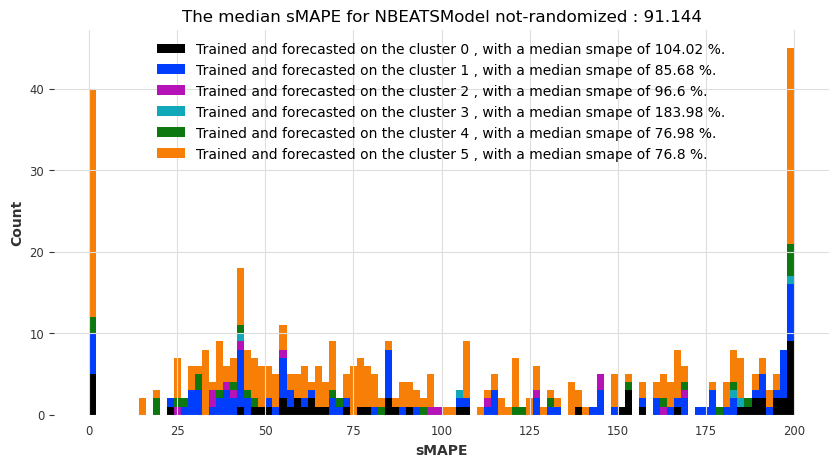

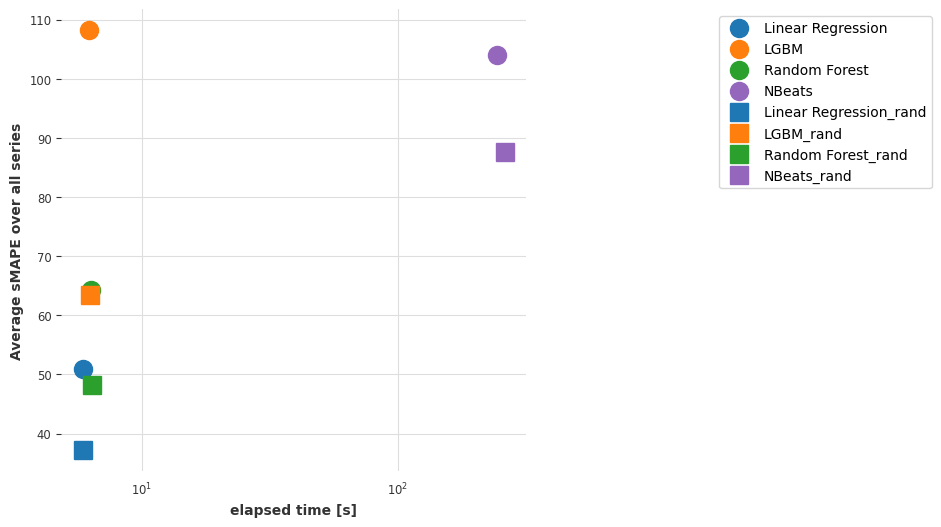

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_colab_notincrem with an horizon of 12 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

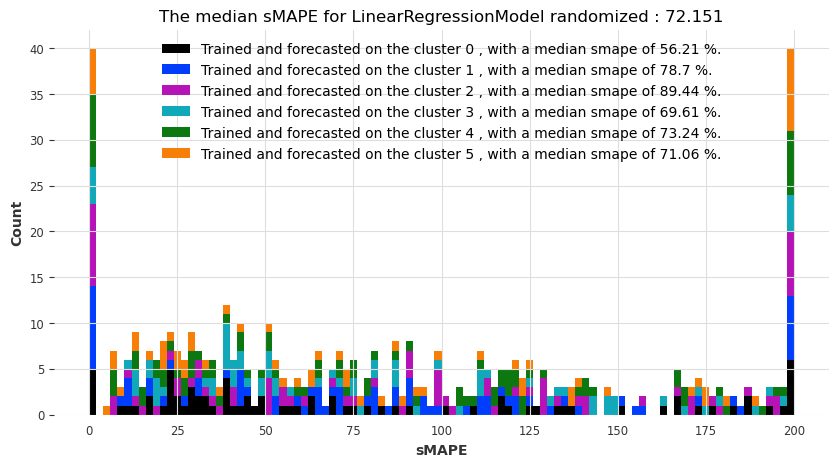

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

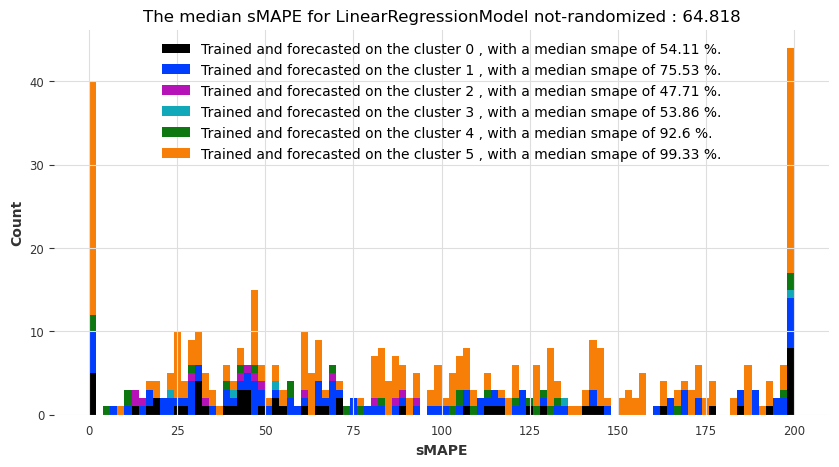

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

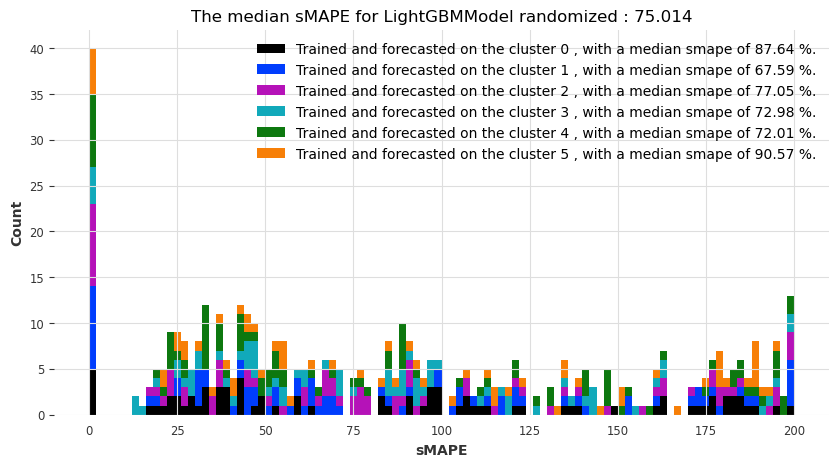

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

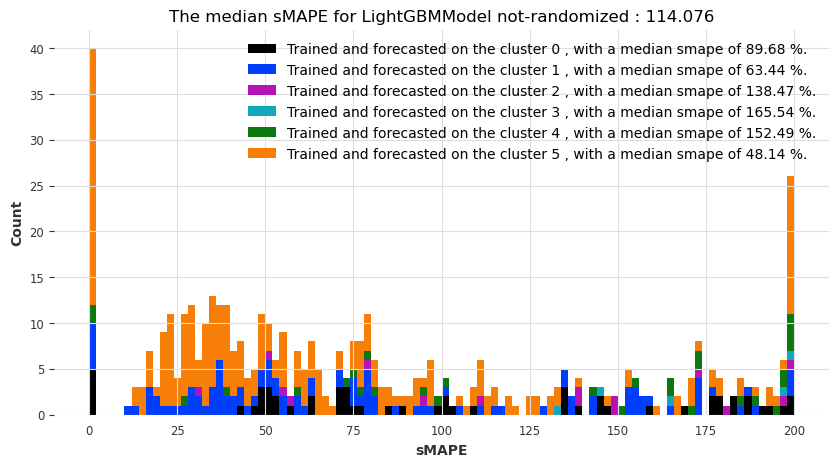

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

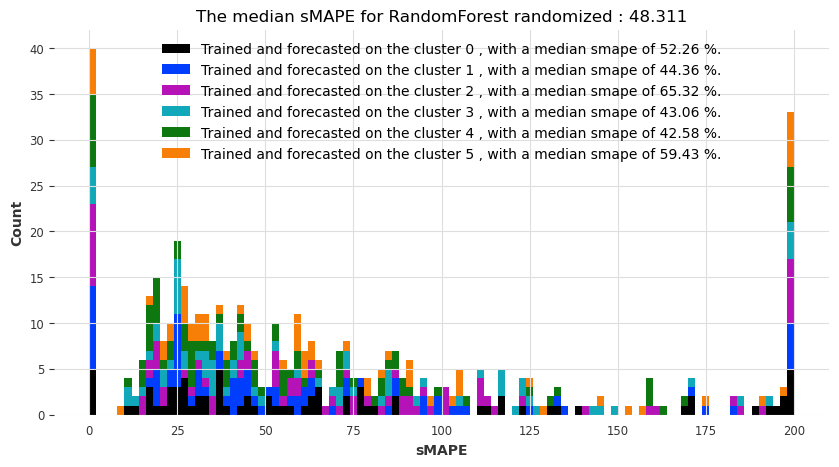

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

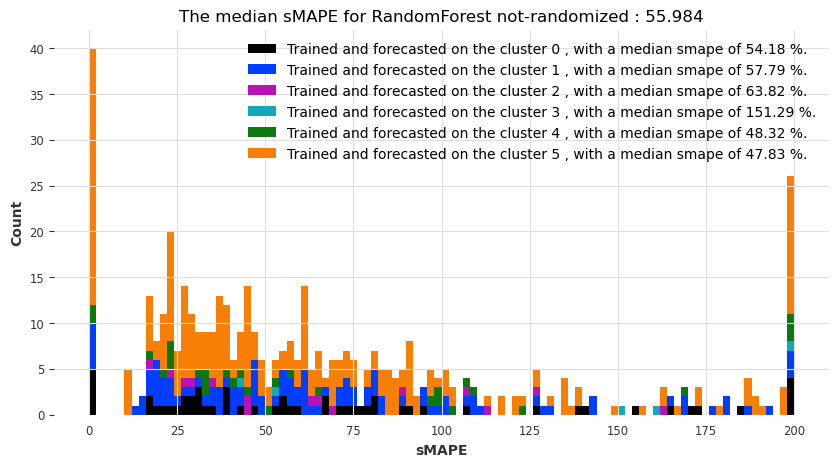

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

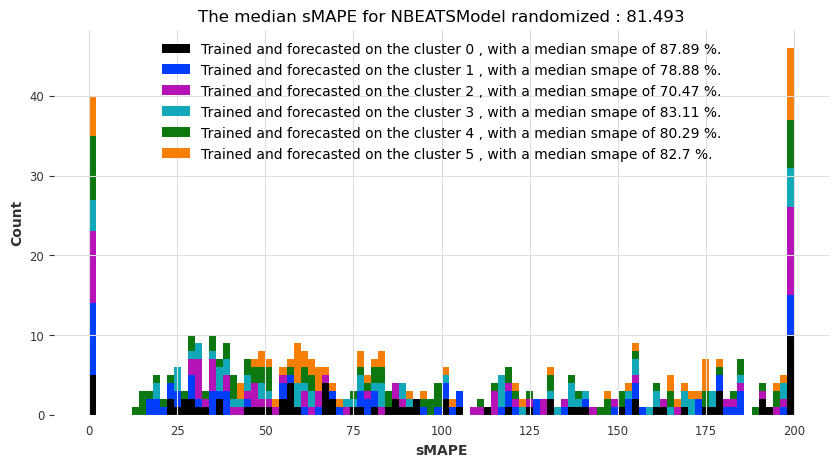

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

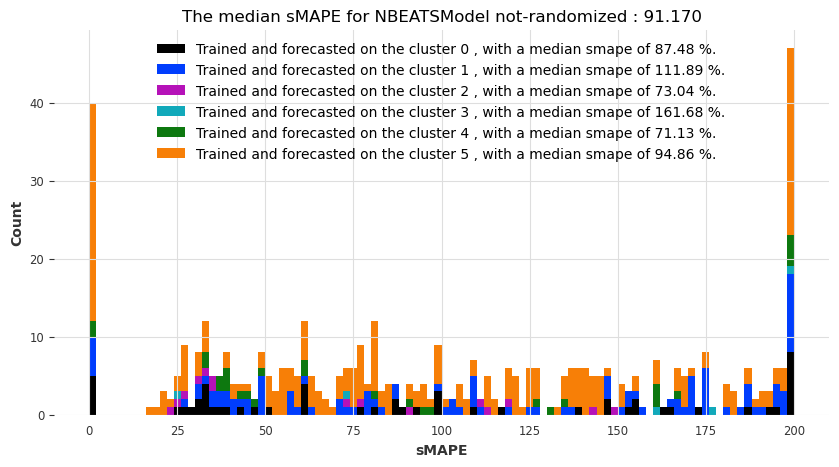

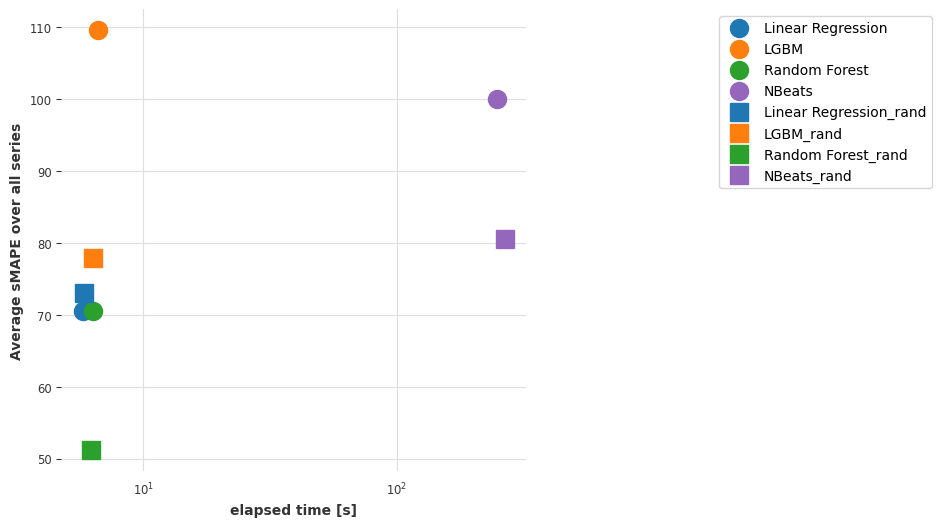

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_keyword are:
The results for index_keyword with an horizon of 3 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

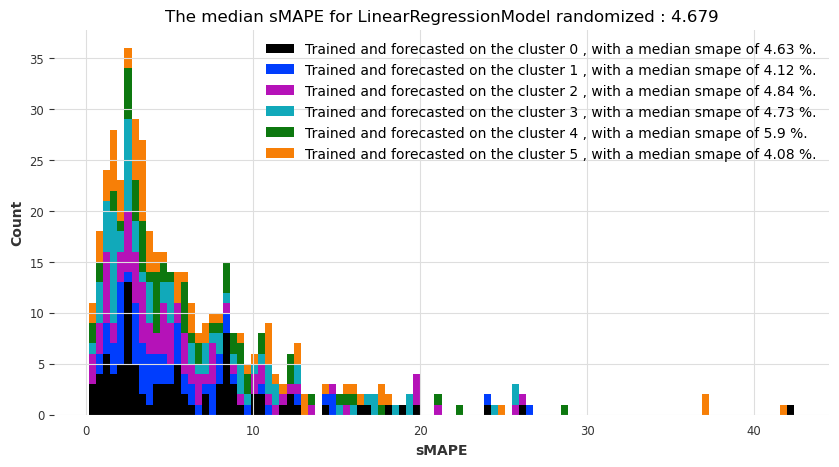

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

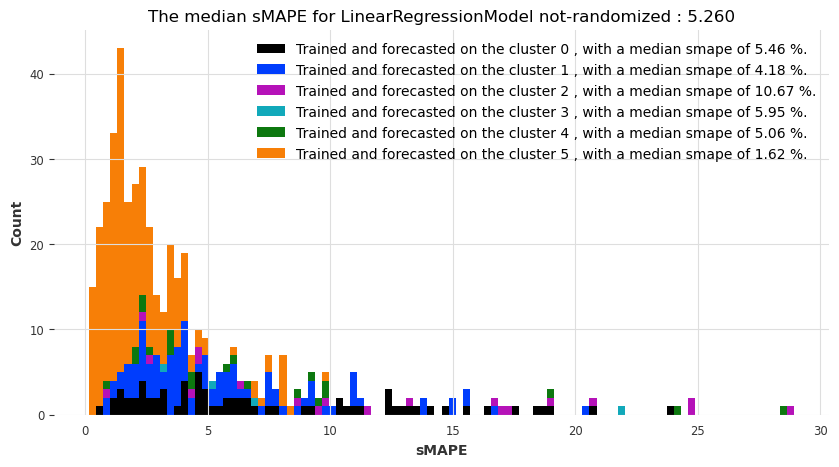

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

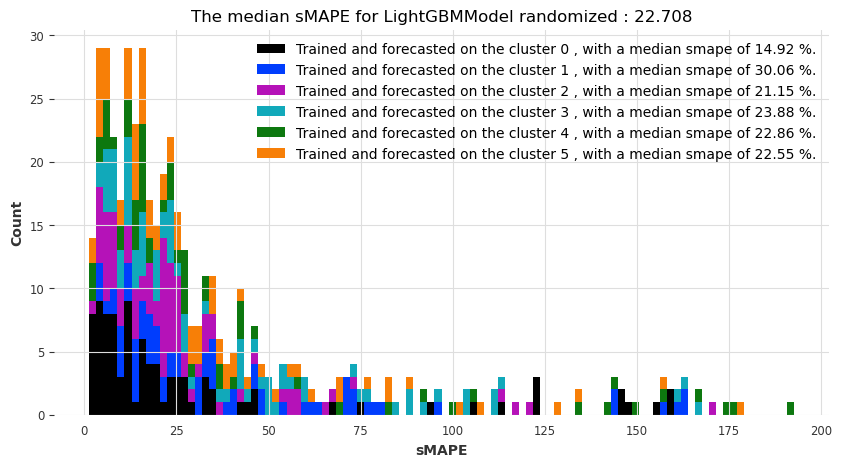

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

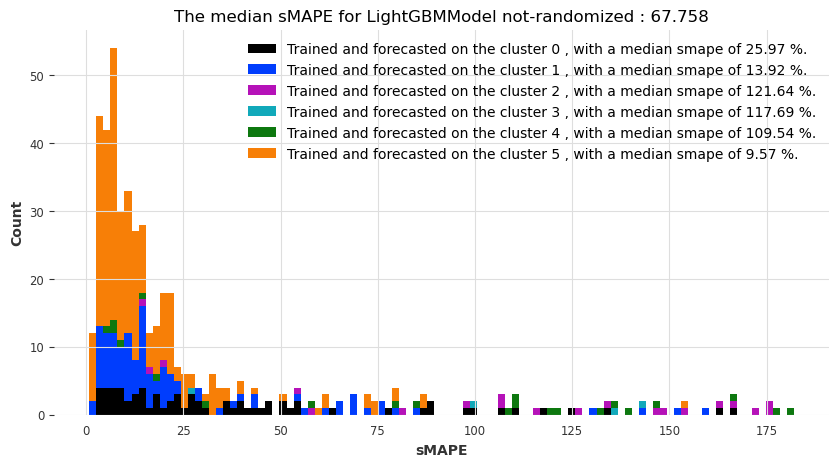

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

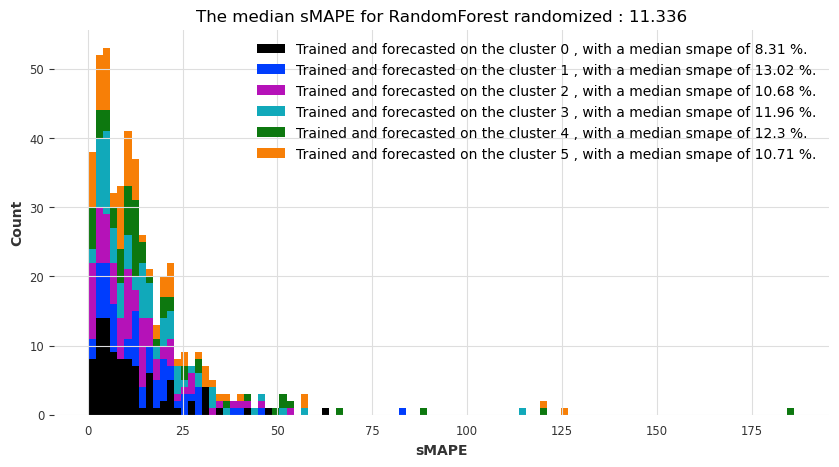

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

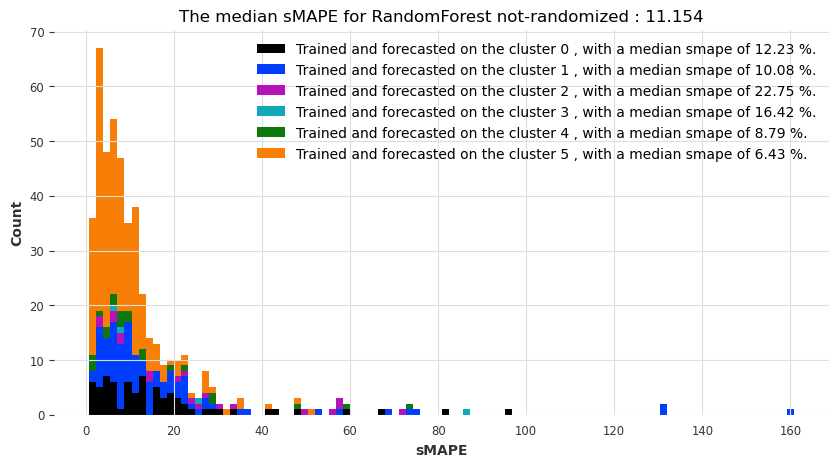

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

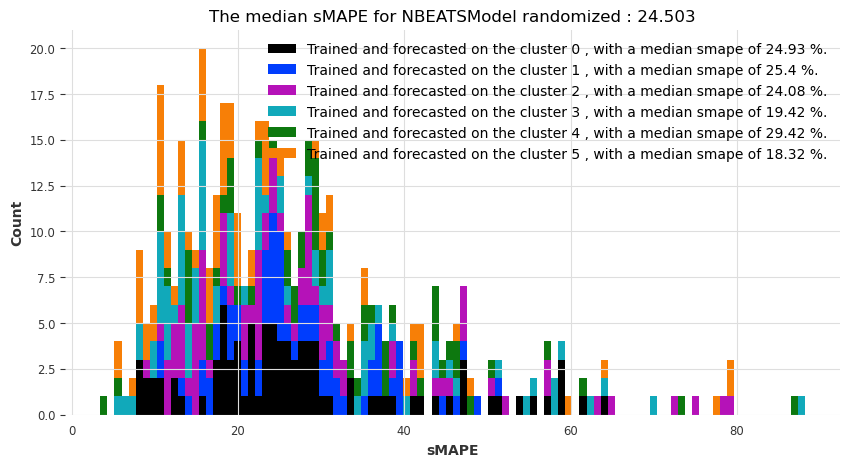

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.2 M 
---------------------------------------------------
1.2 M     Trainable params
4.5 K     Non-trainable params
1.2 M     Total params
9.316     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

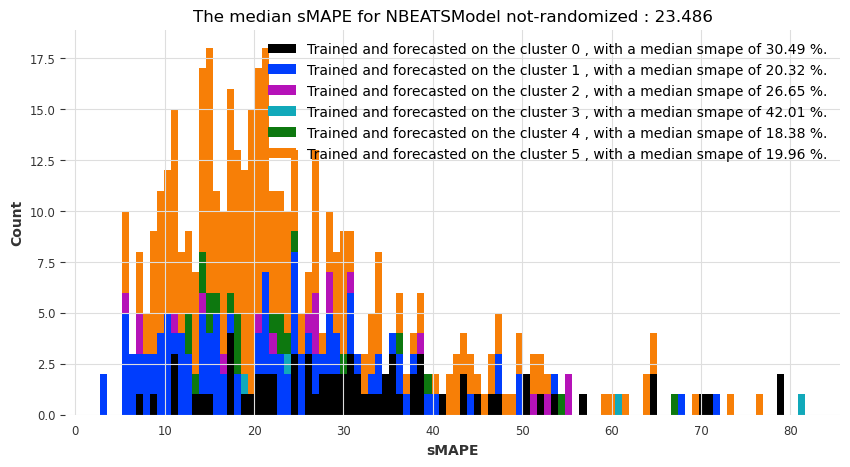

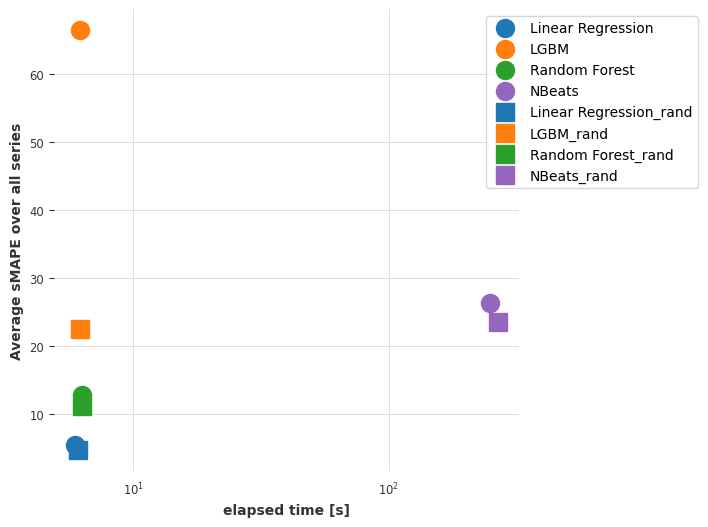

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_keyword with an horizon of 6 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

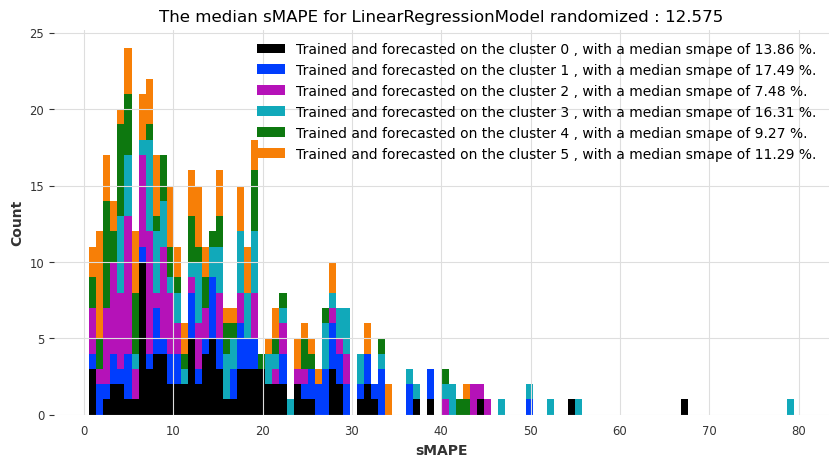

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

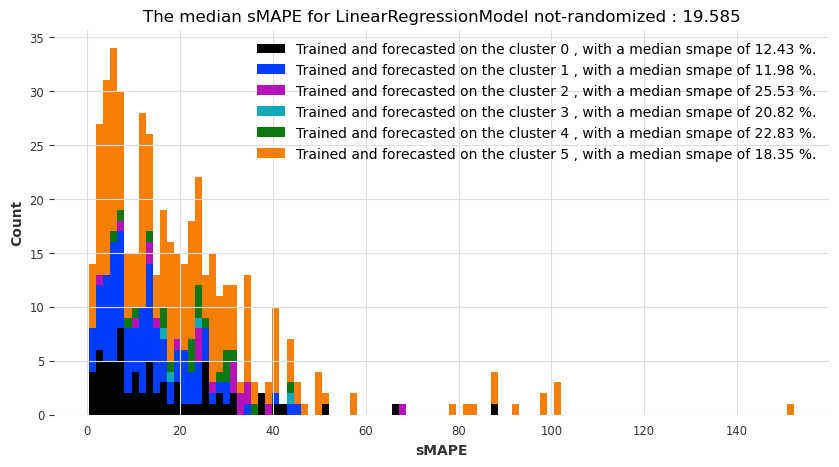

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

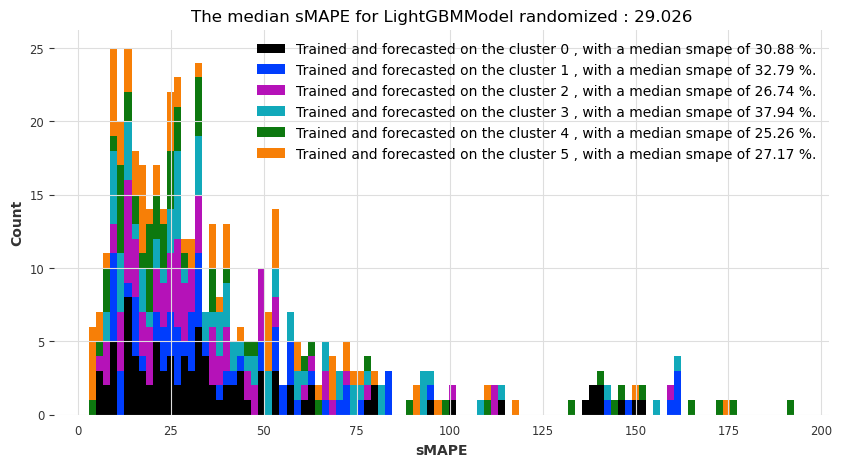

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

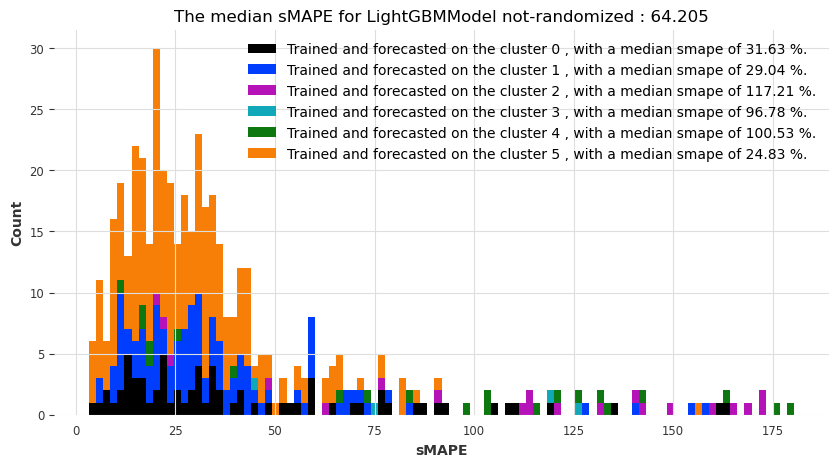

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

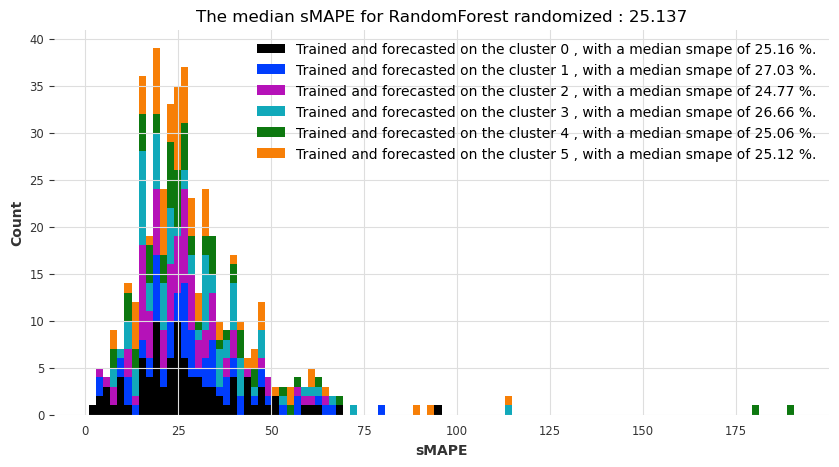

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

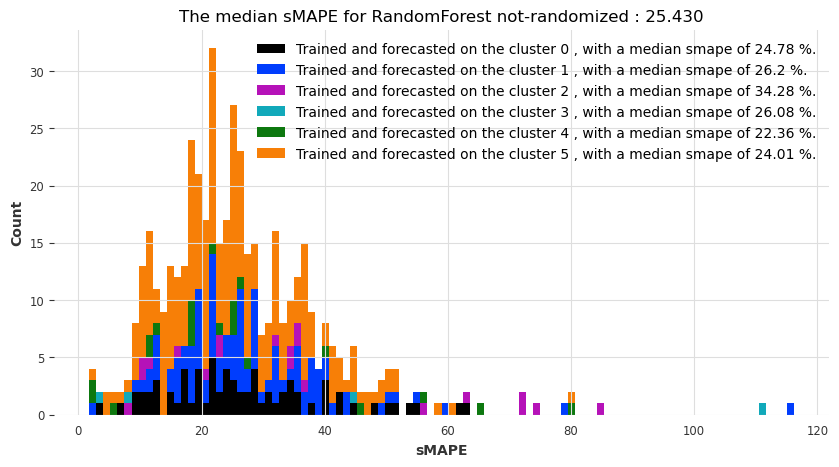

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

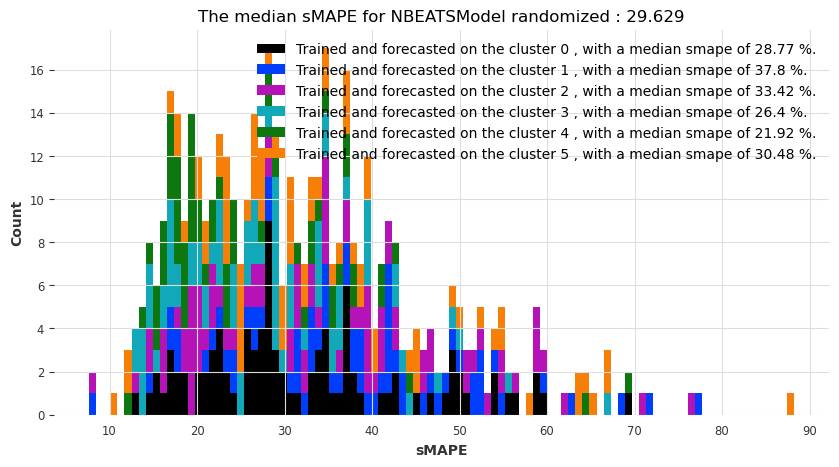

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.4 K     Non-trainable params
1.1 M     Total params
9.180     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

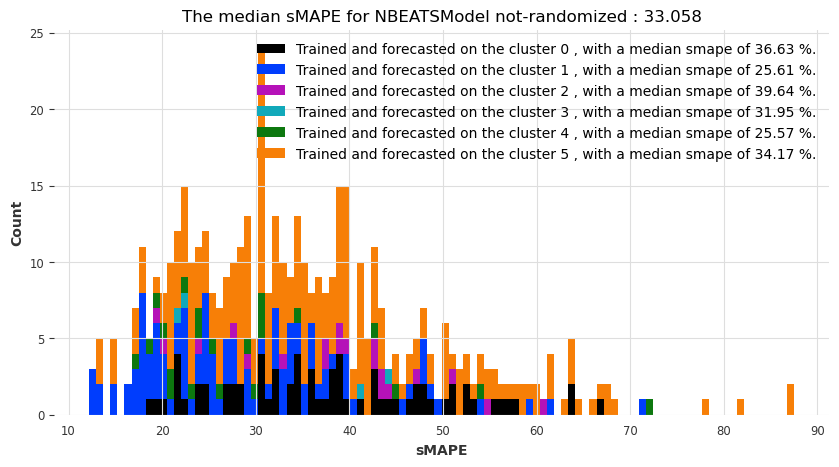

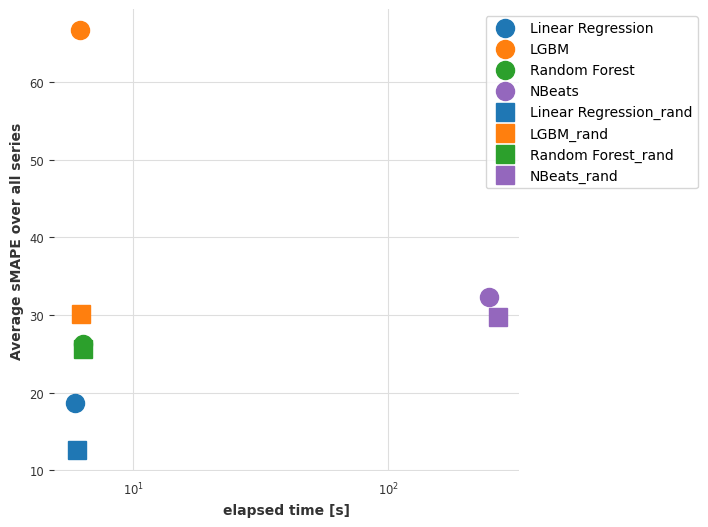

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

The results for index_keyword with an horizon of 12 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

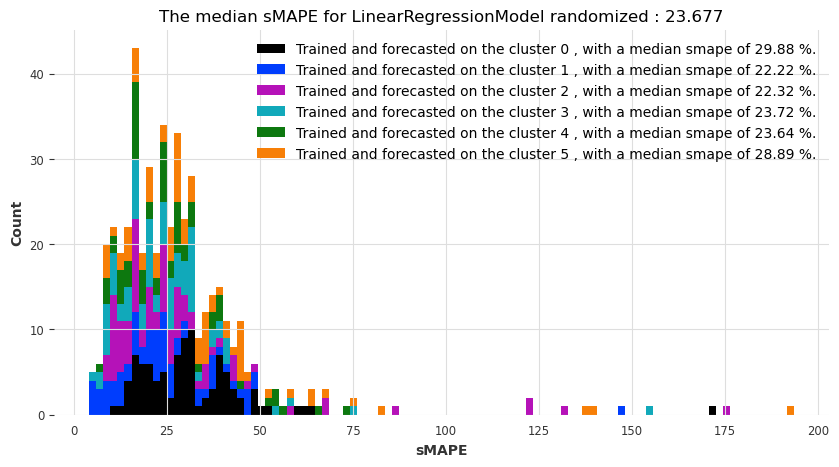

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

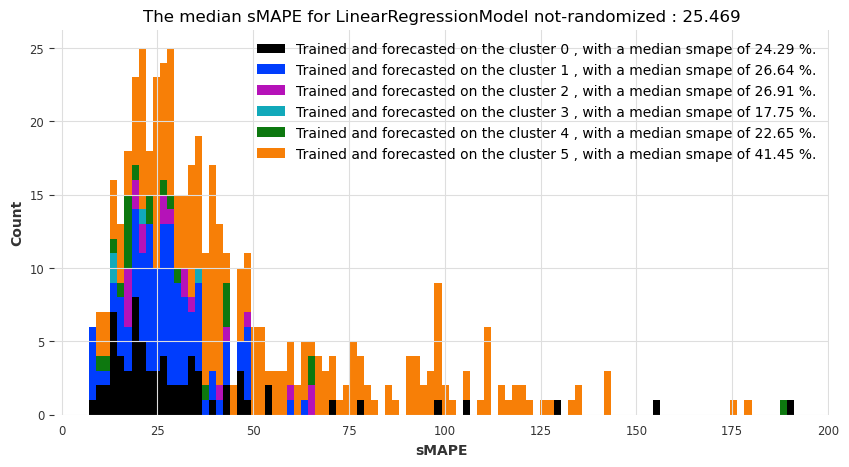

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

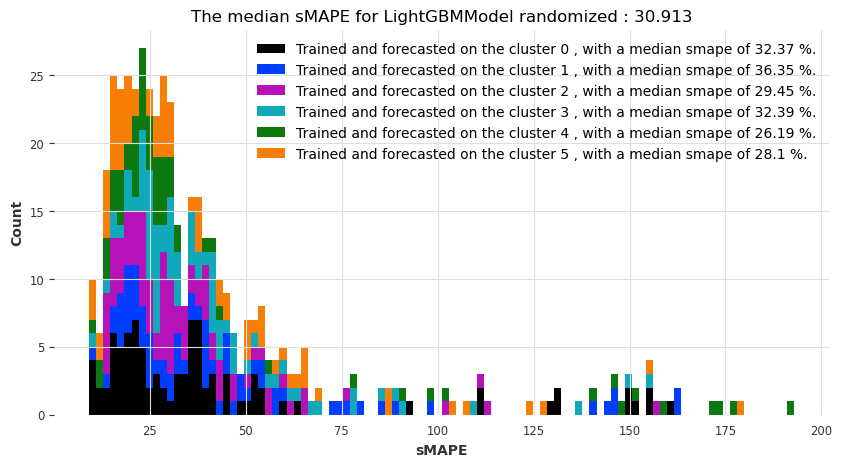

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

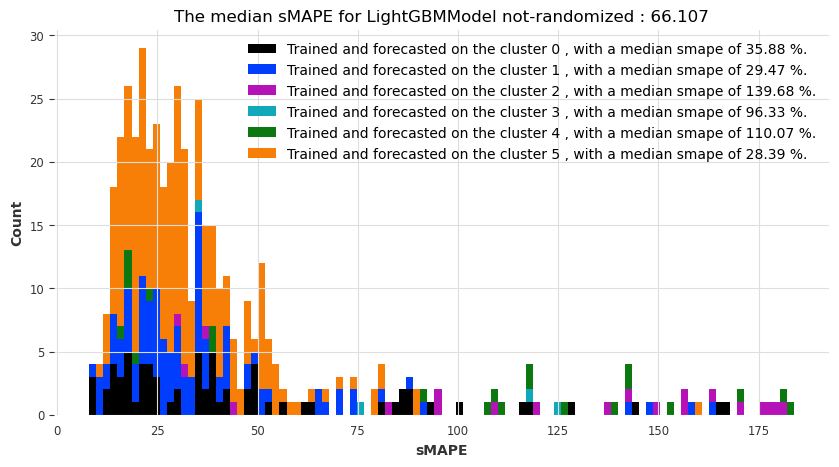

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

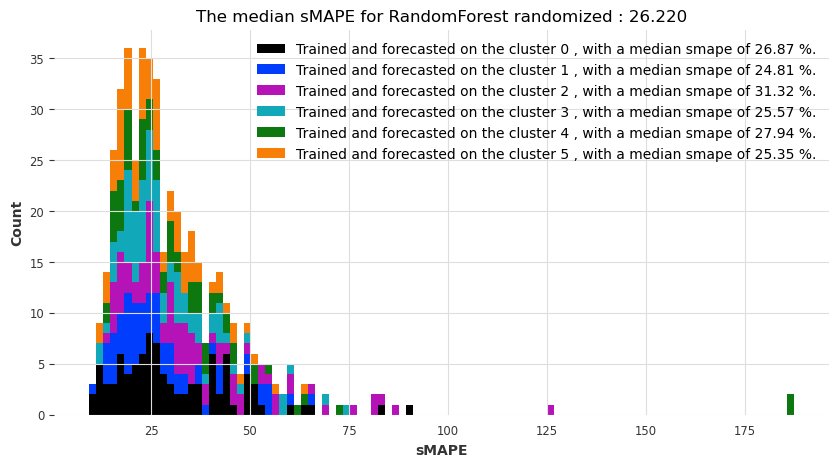

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

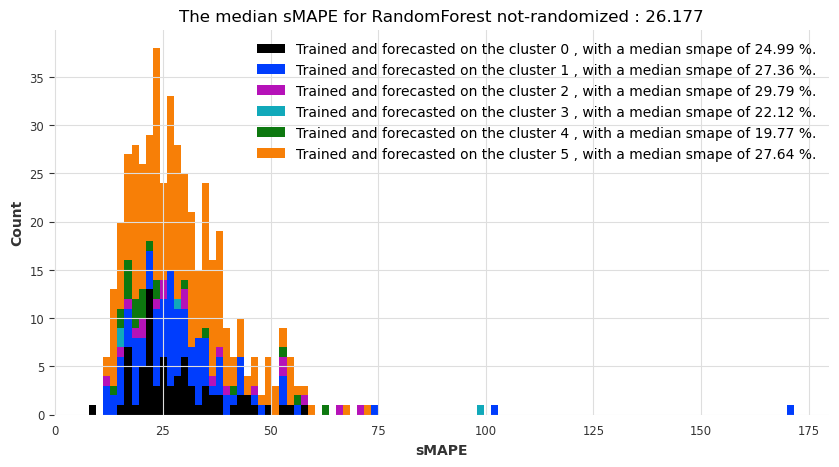

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

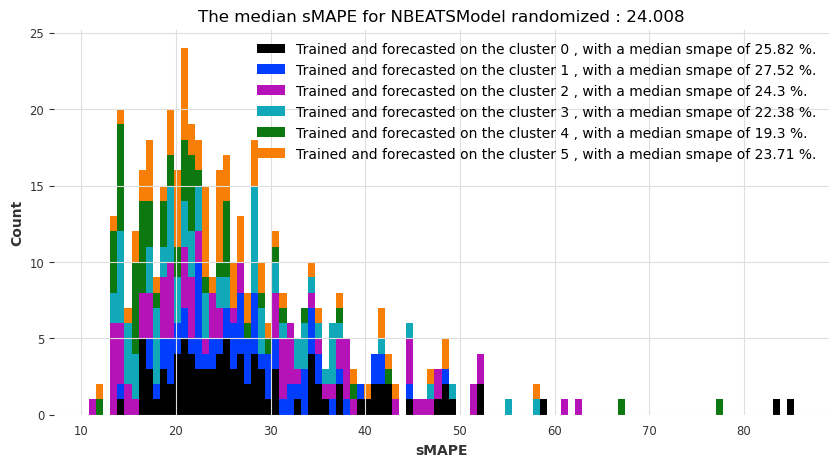

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 1.1 M 
---------------------------------------------------
1.1 M     Trainable params
4.2 K     Non-trainable params
1.1 M     Total params
8.907     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 1it [00:00, ?it/s]

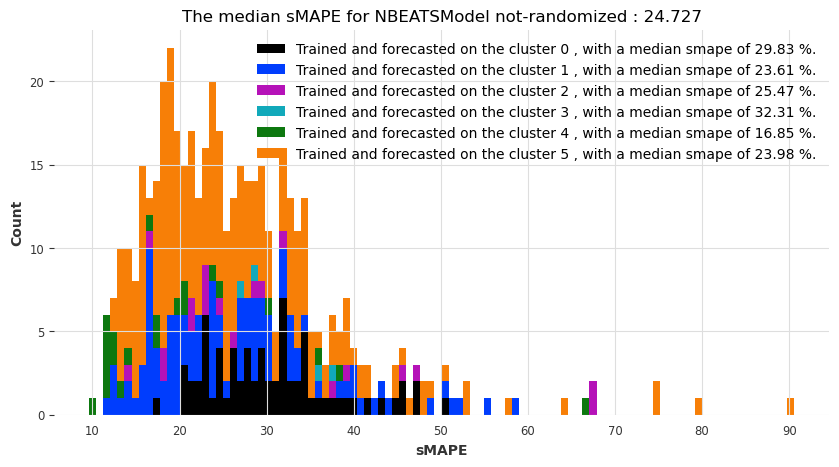

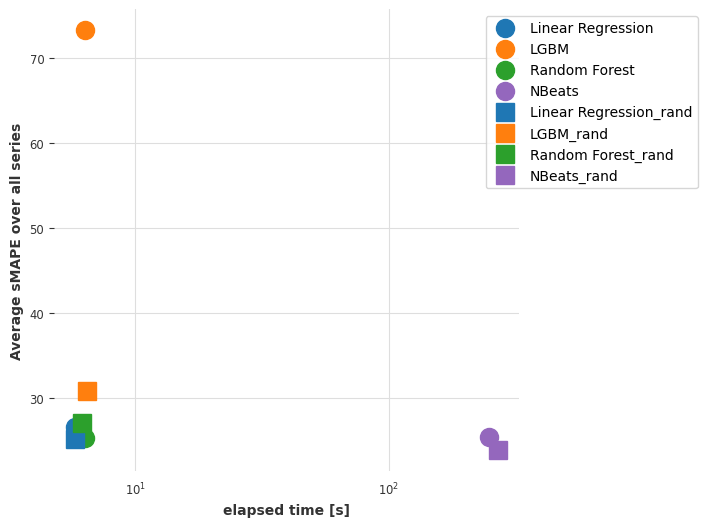

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

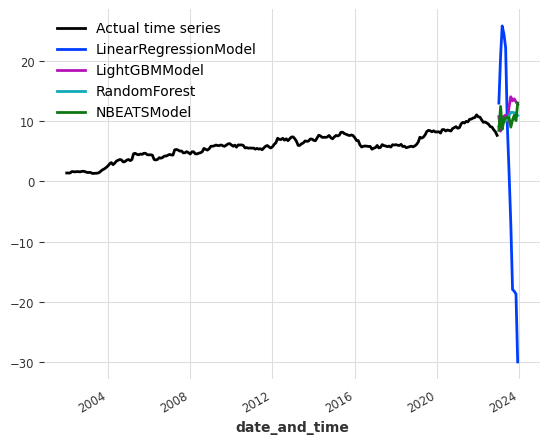

In [364]:
info_table = []

info_table_var = []

for index in list_indices:
    dfofindex = dftm.loc[dftm['indextype']==index]
    print('The results for '+str(index)+' are:')
    listindex_byalgo=[]
    dfofindex_rand = dftm_rand.loc[dftm_rand['indextype']==index]
    
    listvar_byalgo =[]
    
    for horizon in [3,6,12]:
        print('The results for '+str(index)+' with an horizon of '+str(horizon)+' are:')
        lr_smapes,lgbm_smapes,rf_smapes,nbeat_smapes,lr_smapes_rand,lgbm_smapes_rand,rf_smapes_rand,nbeat_smapes_rand,\
        list_var_error=clustering_forecasting(dfofindex,dfofindex_rand,horizon,numbercluster,list_concepts,1)
        
        listindex_byalgo=listindex_byalgo+\
        [lr_smapes,lgbm_smapes,rf_smapes,nbeat_smapes,lr_smapes_rand,lgbm_smapes_rand,\
        rf_smapes_rand,nbeat_smapes_rand]
        
        listvar_byalgo = listvar_byalgo+list_var_error
        
        plot_forecasting_models_global(modelnames,myforecasters,dfofindex,horizon,index) 
        
    list_toappend=[]    
    for i in range(8):
        for j in range(3):
            list_toappend.append(listindex_byalgo[i+j*8])
    info_table.append(list_toappend)
    
    list_toappend_var=[]    
    for i in range(4):
        for j in range(3):
            list_toappend_var.append(listvar_byalgo[i+j*4])
    info_table_var.append(list(chain.from_iterable(list_toappend_var)))

not randomized clustering

In [365]:
iterables = [["Linear Regression","LGBM", "Random Forest","NBeats"], ["3 months", "6 months","12 months"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon"])

df = pd.DataFrame({'Index citations t1-t2':info_table[0][:12], 'Index citations t2-t1': info_table[1][:12],
                   'Index colaboration incremental': info_table[2][:12],'colaboration not incremental':info_table[3][:12],
                   'Index keywords': info_table[4][:12]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                         11.042212   
                     6 months                         47.754380   
                     12 months                        54.838119   
LGBM                 3 months                         27.911436   
                     6 months                         69.205131   
                     12 months                        80.494577   
Random Forest        3 months                         20.510129   
                     6 months                         24.402242   
                     12 months                        35.559180   
NBeats               3 months                         65.189410   
                     6 months                         75.191045   
                     12 months                        57.634696   

                                          Index citations t2-t1  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                          6.963578   
                     6 months                         15.332631   
                     12 months                        32.382616   
LGBM                 3 months                         31.616149   
                     6 months                         38.583213   
                     12 months                        54.287592   
Random Forest        3 months                         11.674485   
                     6 months                         12.702777   
                     12 months                        21.356479   
NBeats               3 months                         50.670820   
                     6 months                         47.086364   
                     12 months                        44.684577   

                                          Index colaboration incremental  \
Forecaster algorithm Forecasting horizon                                   
Linear Regression    3 months                                  35.437709   
                     6 months                                  52.867068   
                     12 months                                 82.914852   
LGBM                 3 months                                 121.094630   
                     6 months                                 125.063525   
                     12 months                                123.400143   
Random Forest        3 months                                  36.652638   
                     6 months                                  52.029177   
                     12 months                                 67.684627   
NBeats               3 months                                  84.205112   
                     6 months                                  94.366382   
                     12 months                                 84.515852   

                                          colaboration not incremental  \
Forecaster algorithm Forecasting horizon                                 
Linear Regression    3 months                                24.383859   
                     6 months                                50.957245   
                     12 months                               70.520652   
LGBM                 3 months                               108.411263   
                     6 months                               108.207478   
                     12 months                              109.625083   
Random Forest        3 months                                51.094358   
                     6 months                                64.310266   
                     12 months                               70.537304   
NBeats               3 months                               105.861160   
                     6 months                               104.010119   
                     12 months                              100.013872   

                                          Index keywords  
For

randomized clustering

In [366]:
iterables = [["Linear Regression","LGBM", "Random Forest","NBeats"], ["3 months", "6 months","12 months"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon"])

df = pd.DataFrame({'Index citations t1-t2':info_table[0][12:], 'Index citations t2-t1': info_table[1][12:],
                   'Index colaboration incremental': info_table[2][12:],'colaboration not incremental':info_table[3][12:],
                   'Index keywords': info_table[4][12:]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                          8.030875   
                     6 months                         11.403270   
                     12 months                        26.167219   
LGBM                 3 months                         30.123045   
                     6 months                         34.961042   
                     12 months                        52.592468   
Random Forest        3 months                         10.842987   
                     6 months                         16.865286   
                     12 months                        26.848097   
NBeats               3 months                         31.561323   
                     6 months                         46.096457   
                     12 months                        50.671794   

                                          Index citations t2-t1  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                          7.685502   
                     6 months                         14.788191   
                     12 months                        34.033319   
LGBM                 3 months                         38.770552   
                     6 months                         48.036327   
                     12 months                        51.306950   
Random Forest        3 months                          5.907523   
                     6 months                         10.177439   
                     12 months                        17.707831   
NBeats               3 months                         33.387988   
                     6 months                         40.756697   
                     12 months                        51.586012   

                                          Index colaboration incremental  \
Forecaster algorithm Forecasting horizon                                   
Linear Regression    3 months                                  23.618474   
                     6 months                                  51.307504   
                     12 months                                 79.745059   
LGBM                 3 months                                  63.562275   
                     6 months                                  68.130268   
                     12 months                                 79.094392   
Random Forest        3 months                                  29.589997   
                     6 months                                  46.022483   
                     12 months                                 65.219261   
NBeats               3 months                                  94.080118   
                     6 months                                  77.932820   
                     12 months                                 76.584093   

                                          colaboration not incremental  \
Forecaster algorithm Forecasting horizon                                 
Linear Regression    3 months                                20.763949   
                     6 months                                37.201237   
                     12 months                               73.042482   
LGBM                 3 months                                57.244309   
                     6 months                                63.359184   
                     12 months                               77.973058   
Random Forest        3 months                                24.746127   
                     6 months                                48.199135   
                     12 months                               51.168518   
NBeats               3 months                               109.739074   
                     6 months                                87.636349   
                     12 months                               80.554566   

                                          Index keywords  
For

In [367]:
iterables = [["Linear Regression","LGBM", "Random Forest","NBeats"], ["3 months", "6 months","12 months"],["Randomized","Not-randomized"],["Mean of variances", "Variances over all errors"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon","Randomization","Type of variance"])

df = pd.DataFrame({'Index citations t1-t2':info_table_var[0], 'Index citations t2-t1': info_table_var[1],
                   'Index colaboration incremental': info_table_var[2],'colaboration not incremental':info_table_var[3],
                   'Index keywords': info_table_var[4]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm Forecasting horizon Randomization  Type of variance                                   
Linear Regression    3 months            Randomized     Mean of variances                      26.126445   
                                                        Variances over all errors               9.142729   
                                         Not-randomized Mean of variances                      26.984696   
                                                        Variances over all errors               5.779083   
                     6 months            Randomized     Mean of variances                      13.780189   
                                                        Variances over all errors               4.464705   
                                         Not-randomized Mean of variances                      26.903863   
                                                        Variances over all errors               6.914639   
                     12 months           Randomized     Mean of variances                      14.157267   
                                                        Variances over all errors               5.695213   
                                         Not-randomized Mean of variances                      90.302237   
                                                        Variances over all errors              18.400914   
LGBM                 3 months            Randomized     Mean of variances                       8.364379   
                                                        Variances over all errors               0.075987   
                                         Not-randomized Mean of variances                      31.498974   
                                                        Variances over all errors               0.055045   
                     6 months            Randomized     Mean of variances                      28.359129   
                                                        Variances over all errors               0.351799   
                                         Not-randomized Mean of variances                      39.689173   
                                                        Variances over all errors               0.605978   
                     12 months           Randomized     Mean of variances                      34.678496   
                                                        Variances over all errors               9.844208   
                                         Not-randomized Mean of variances                      64.815295   
                                                        Variances over all errors              24.739679   
Random Forest        3 months            Randomized     Mean of variances                      80.825152   
                                                        Variances over all errors               0.081721   
                                         Not-randomized Mean of variances                     182.280832   
                                                        Variances over all errors               0.045971   
                     6 months            Randomized     Mean of variances                      95.983422   
                                                        Variances over all errors               0.753968   
                                         Not-randomized Mean of variances                     216.420961   
                                                        Variances over all errors               1.616281   
                     12 months           Randomized     Mean of variances                     133.092006   
                                                        Variances over all errors               3.528050   
                                         Not-randomized Mean of variances                     300.518467   
                                                        Variances over all errors      

As a conclusion, we observe that randomized clustering are better than not randomized clustering. For this reason, probably, global forecasting will be better than clustering forecasting. In addition, clustering forecasting performs worse than local forecasting, this can be seen looking at the errors. Random forests and linear regression are the models which perform the best overall.

# **Part 3 -- Global forecasting based on my own data**

This takes 12 hours to run.

In [404]:
def global_forecasting_mydata(dftm,horizon,list_concepts,number_cv):

    mylag =252//number_cv-2*horizon

    # regression models
            
    lr_time, lr_smapes_mean,lr_smapes_med,lr_var_allerrors,lr_mean_allvar =\
    cross_validation_expanding_window_global(dftm,\
    horizon,list_concepts,number_cv,'LinearRegressionModel', LinearRegressionModel, lags=mylag, output_chunk_length=horizon)
    
    lgbm_time, lgbm_smapes_mean,lgbm_smapes_med,lgbm_var_allerrors,lgbm_mean_allvar =\
    cross_validation_expanding_window_global(dftm,\
    horizon,list_concepts,number_cv,'LightGBMModel', LightGBMModel,lags=mylag, output_chunk_length=horizon, objective="mape")
  
    rf_time, rf_smapes_mean,rf_smapes_med,rf_var_allerrors,rf_mean_allvar\
    =cross_validation_expanding_window_global(dftm,\
    horizon,list_concepts,number_cv,'RandomForest', RandomForest,lags=mylag, output_chunk_length=horizon)
    
    #deep learning models

    nbeat_time,nbeat_smapes_mean,nbeat_smapes_med,nbeat_var_allerrors,nbeat_mean_allvar\
    =cross_validation_expanding_window_global(dftm,\
    horizon,list_concepts,number_cv,'NBEATSModel', NBEATSModel,input_chunk_length=mylag,output_chunk_length=horizon,num_stacks=20,
    num_blocks=1,num_layers=2,layer_widths=136,expansion_coefficient_dim=11,loss_fn=SmapeLoss(),batch_size=1024,
    optimizer_kwargs={"lr":  1e-3})
    
    smapes_mean = {
        "Linear Regression": lr_smapes_mean,
        "LGBM": lgbm_smapes_mean,
        "Random Forest": rf_smapes_mean,
        "NBeats": nbeat_smapes_mean,
    }

    elapsed_times = {
        "Linear Regression": lr_time,
        "LGBM": lgbm_time,
        "Random Forest": rf_time,
        "NBeats": nbeat_time,
    }

    smapes_med = {
        "Linear Regression": lr_smapes_med,
        "LGBM": lgbm_smapes_med,
        "Random Forest": rf_smapes_med,
        "NBeats": nbeat_smapes_med,
    }


        
    print('Visualization of performances taking the mean of the smapes over cross-validation')
    plot_models(elapsed_times, smapes_mean)
    
        
    print('Visualization of performances taking the median of the smapes over cross-validation')
    plot_models(elapsed_times, smapes_med)
    
    return lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean,nbeat_smapes_mean,lr_var_allerrors,lr_mean_allvar,lgbm_var_allerrors,lgbm_mean_allvar,rf_var_allerrors,rf_mean_allvar,nbeat_var_allerrors,nbeat_mean_allvar

In [405]:
myforecasters = [LinearRegressionModel,LightGBMModel,RandomForest,NBEATSModel]
modelnames = ["LinearRegressionModel","LightGBMModel","RandomForest","NBEATSModel"]

The results for index_cit_t1_t2 are:
The results for index_cit_t1_t2 with an horizon of 3 are:


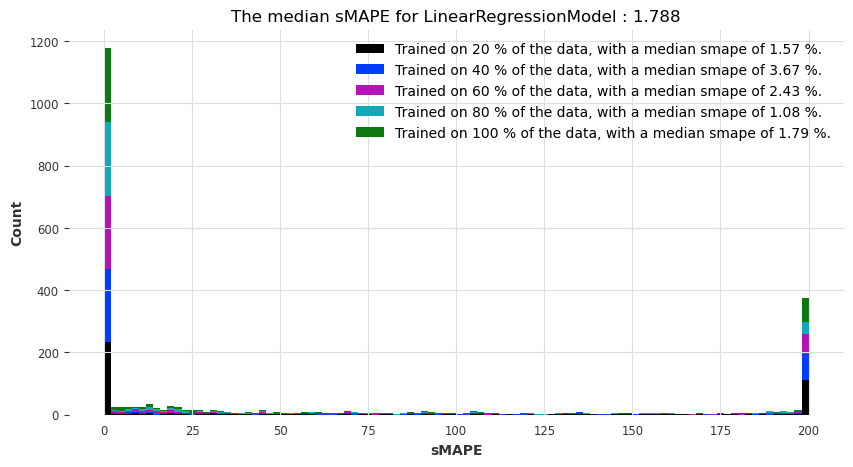

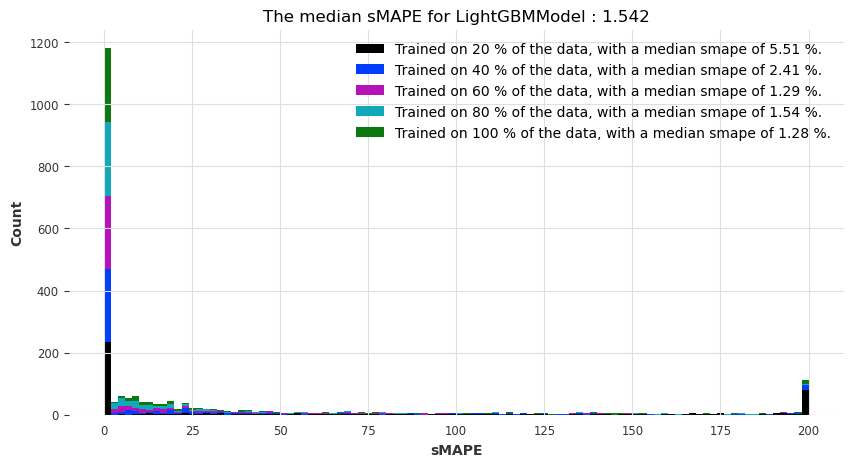

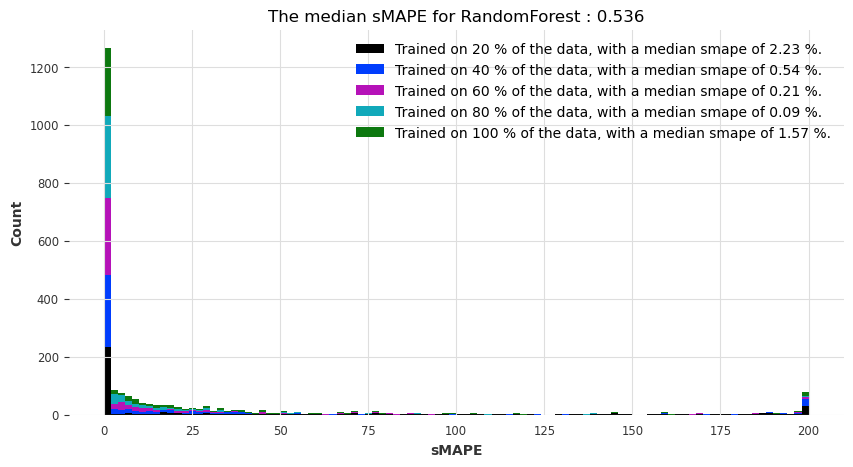

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 2it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 24it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 47it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 69it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

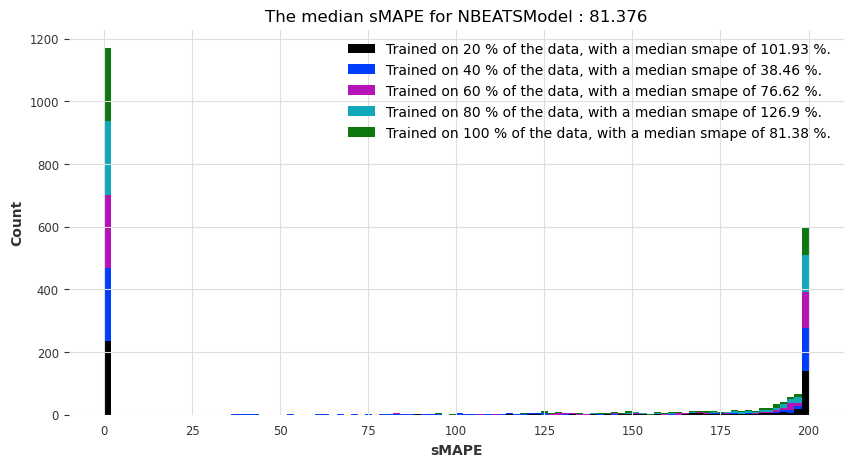

Visualization of performances taking the mean of the smapes over cross-validation


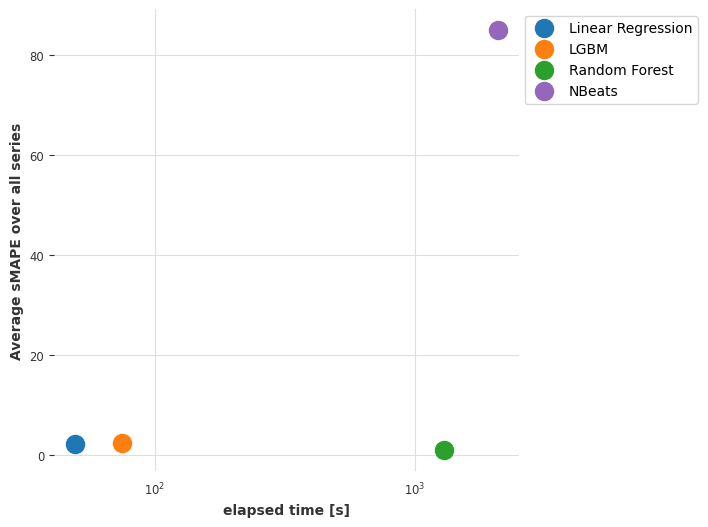

Visualization of performances taking the median of the smapes over cross-validation


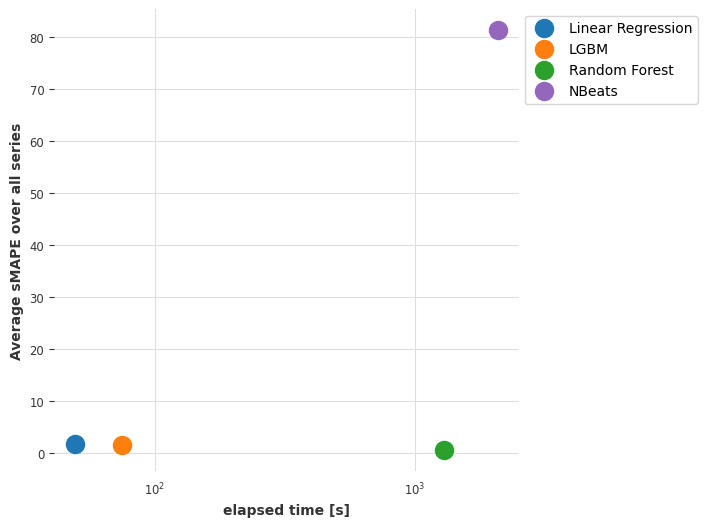

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

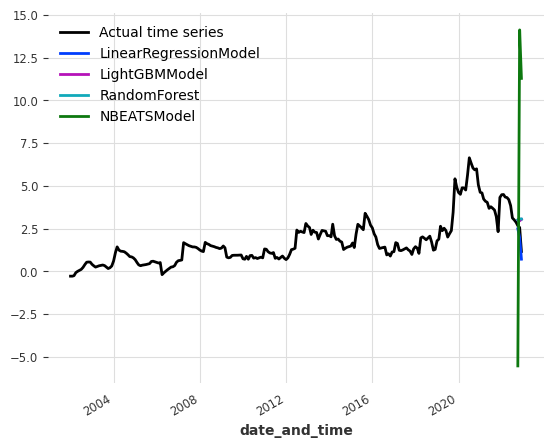

The results for index_cit_t1_t2 with an horizon of 6 are:


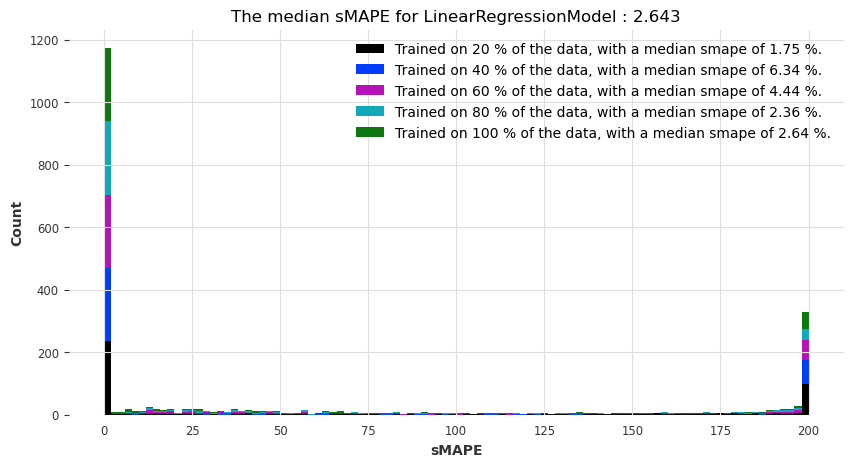

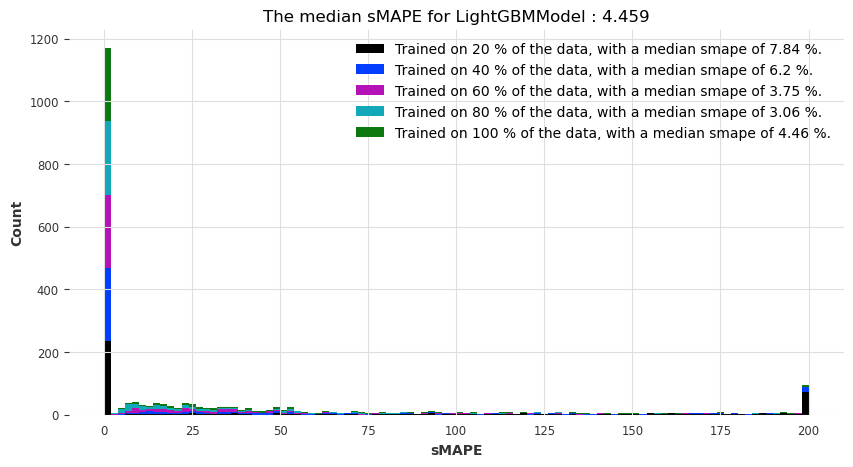

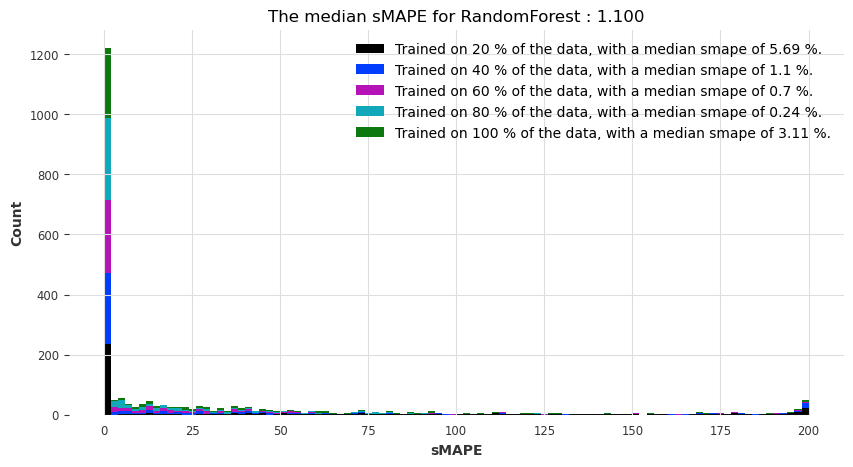

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 3it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 26it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 48it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 71it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

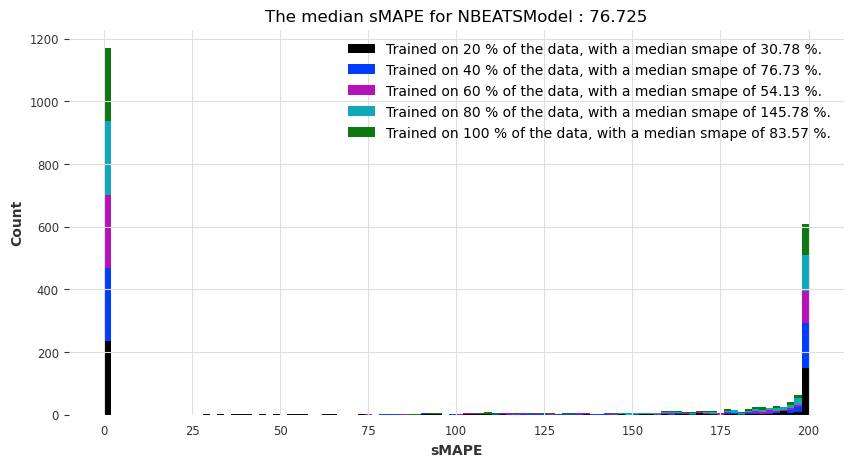

Visualization of performances taking the mean of the smapes over cross-validation


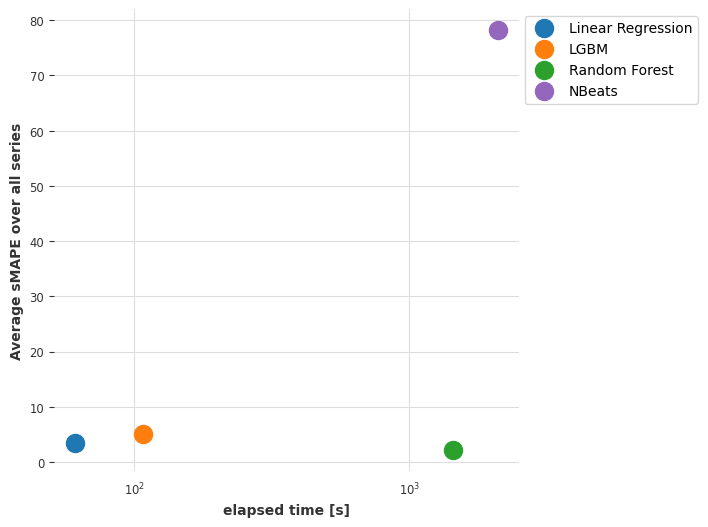

Visualization of performances taking the median of the smapes over cross-validation


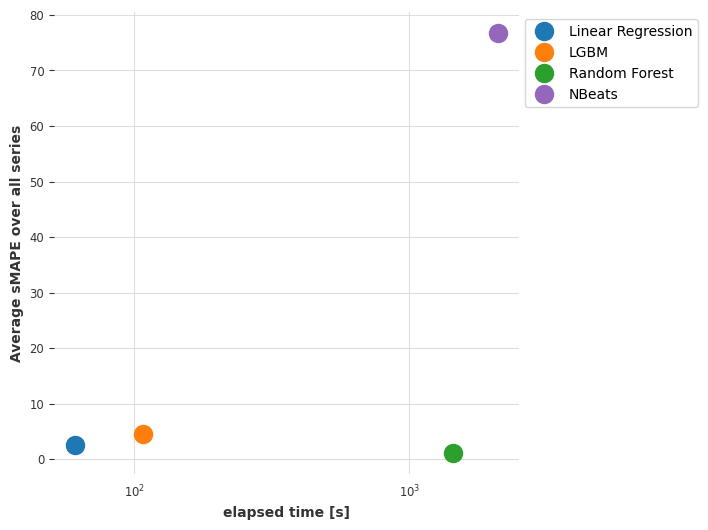

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

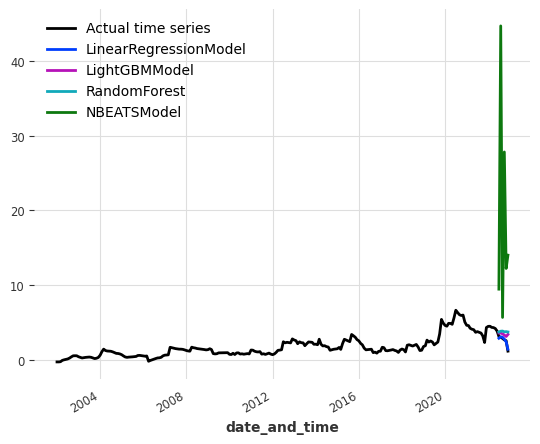

The results for index_cit_t1_t2 with an horizon of 12 are:


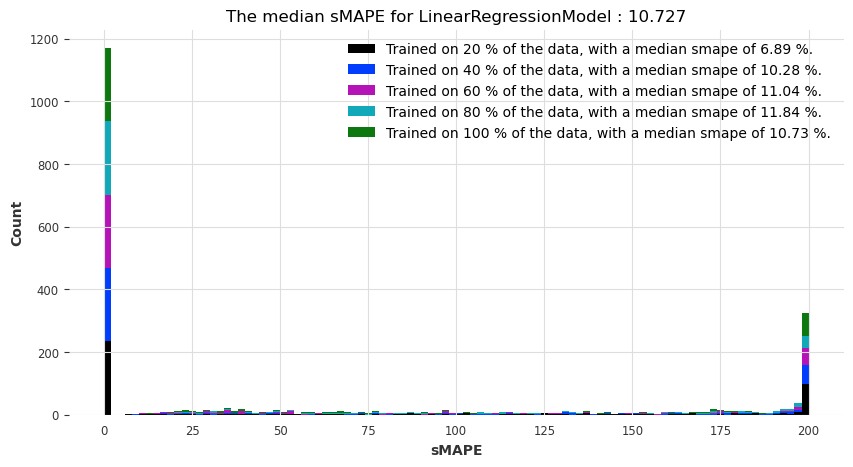

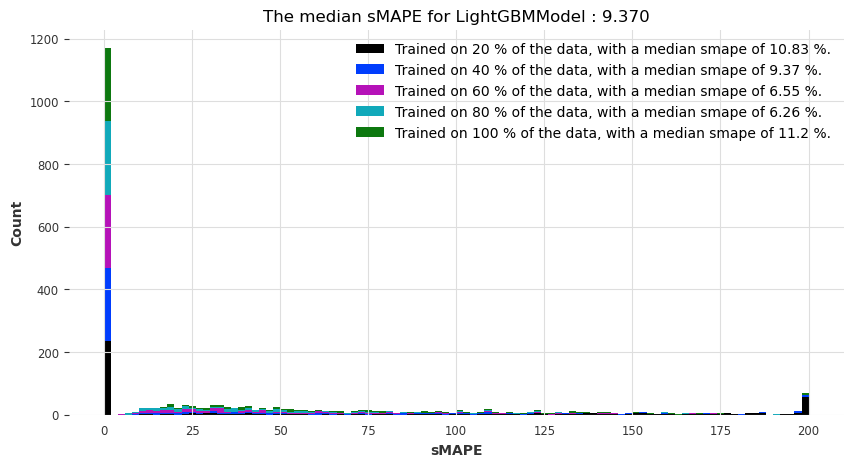

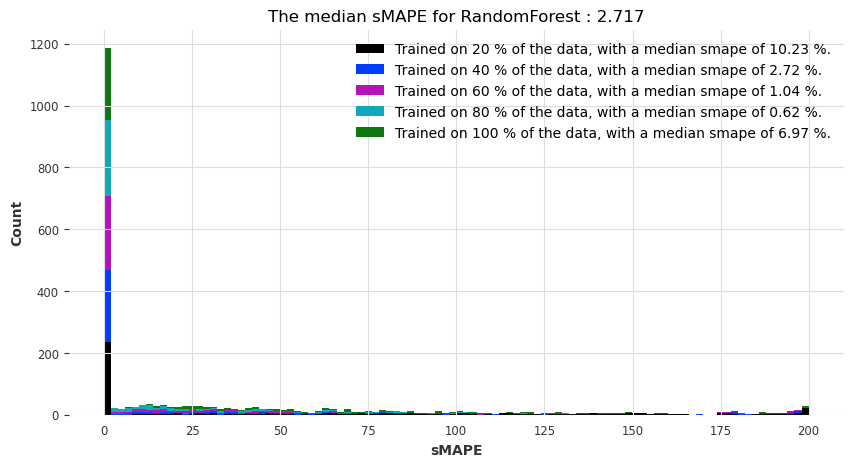

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 6it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 28it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 50it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 72it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

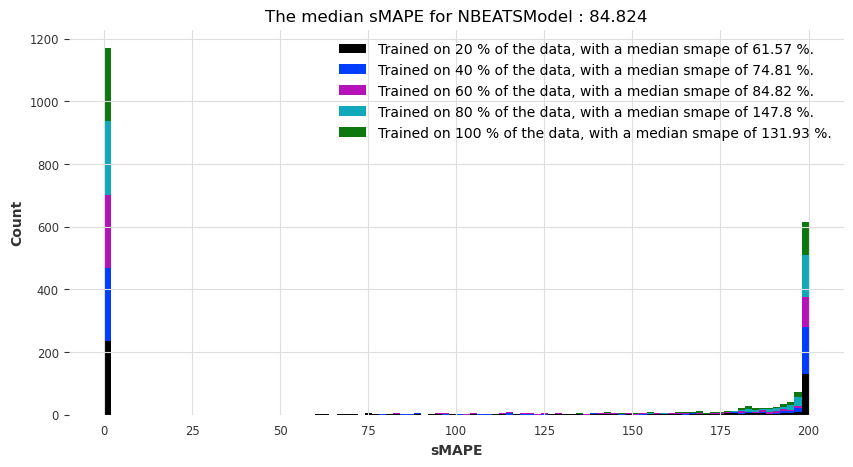

Visualization of performances taking the mean of the smapes over cross-validation


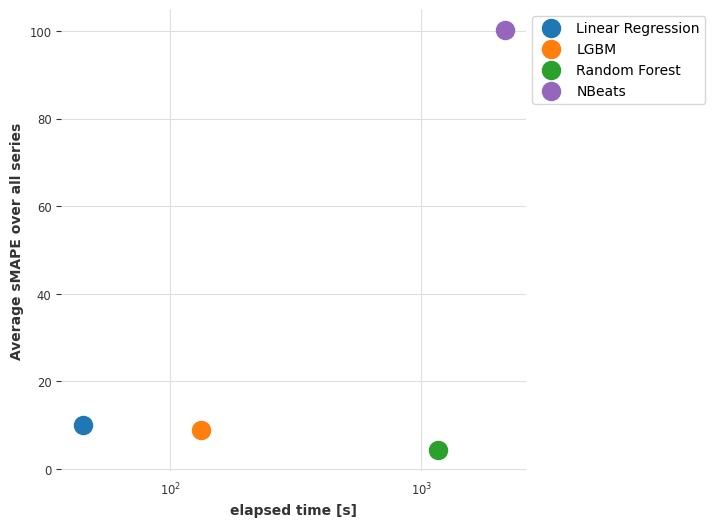

Visualization of performances taking the median of the smapes over cross-validation


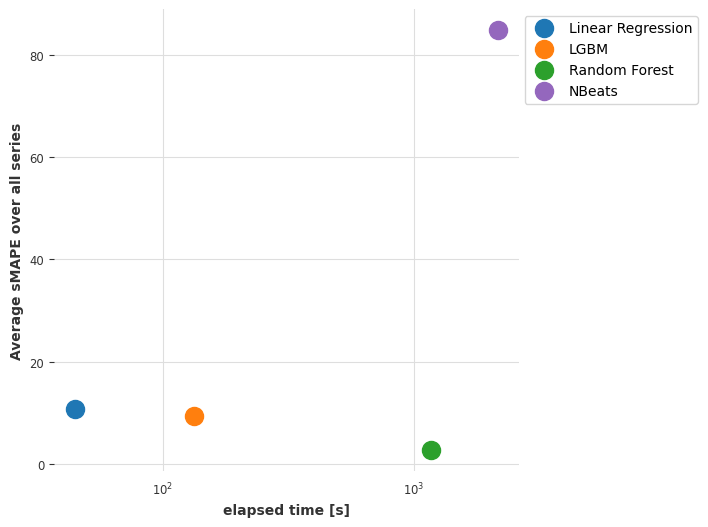

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

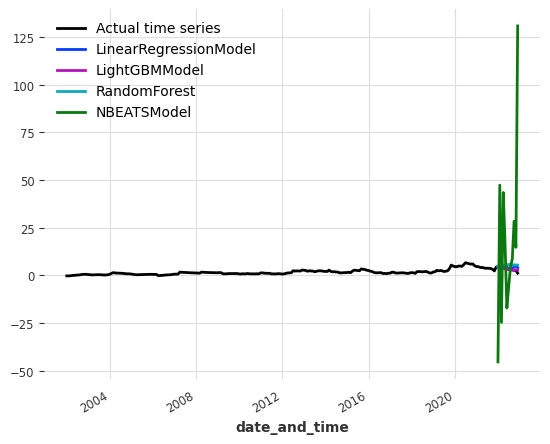

The results for index_cit_t2_t1 are:
The results for index_cit_t2_t1 with an horizon of 3 are:


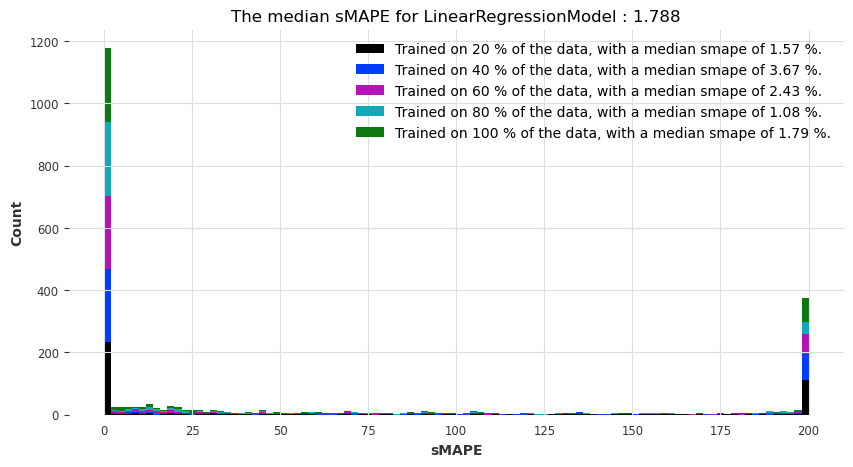

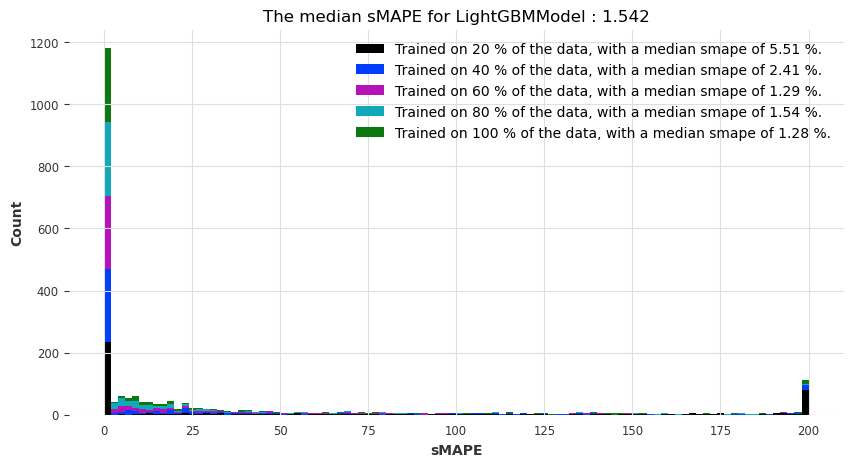

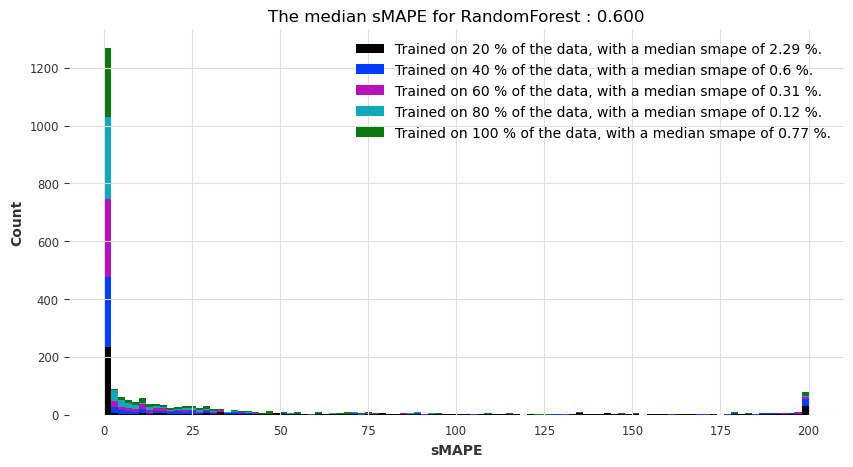

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 2it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 24it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 47it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 69it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

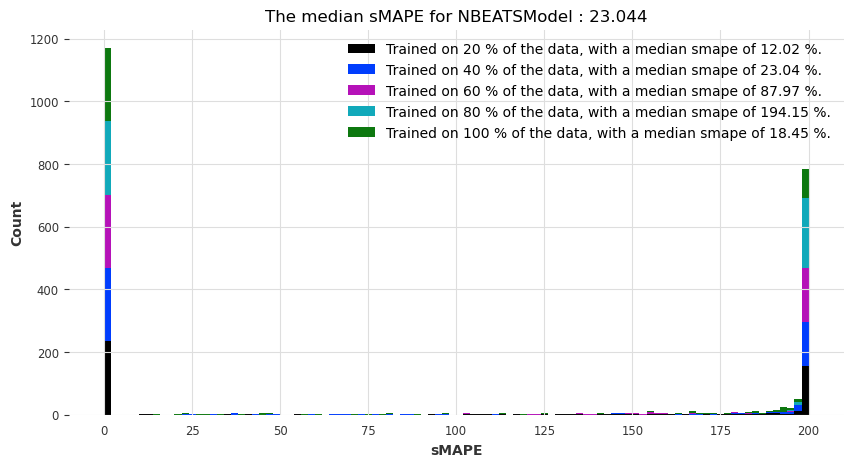

Visualization of performances taking the mean of the smapes over cross-validation


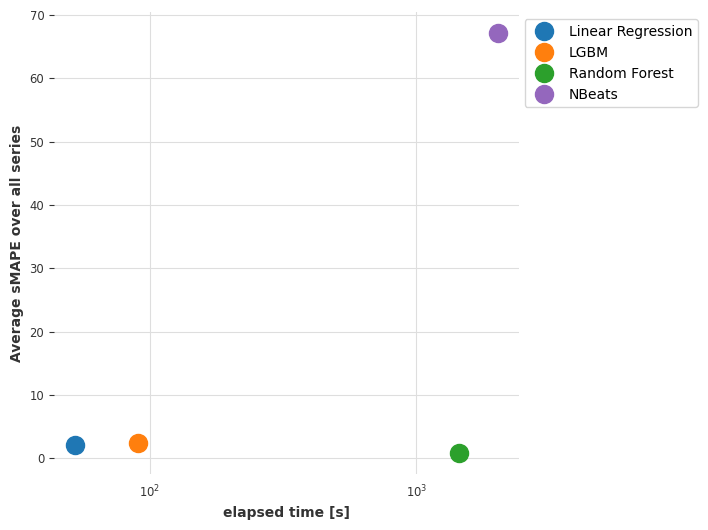

Visualization of performances taking the median of the smapes over cross-validation


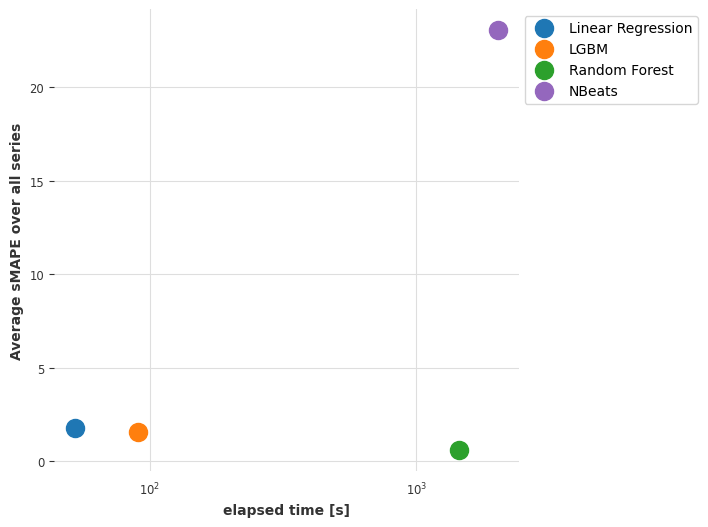

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

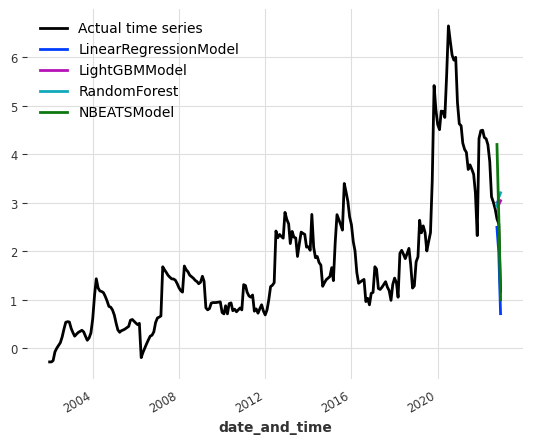

The results for index_cit_t2_t1 with an horizon of 6 are:


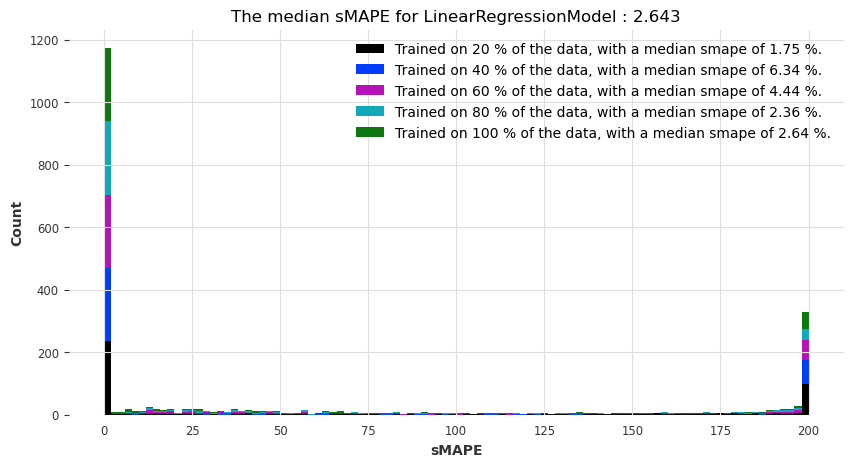

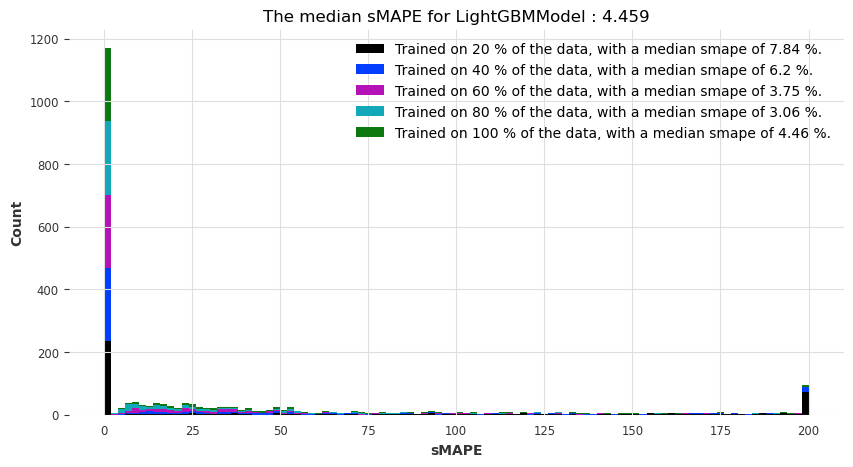

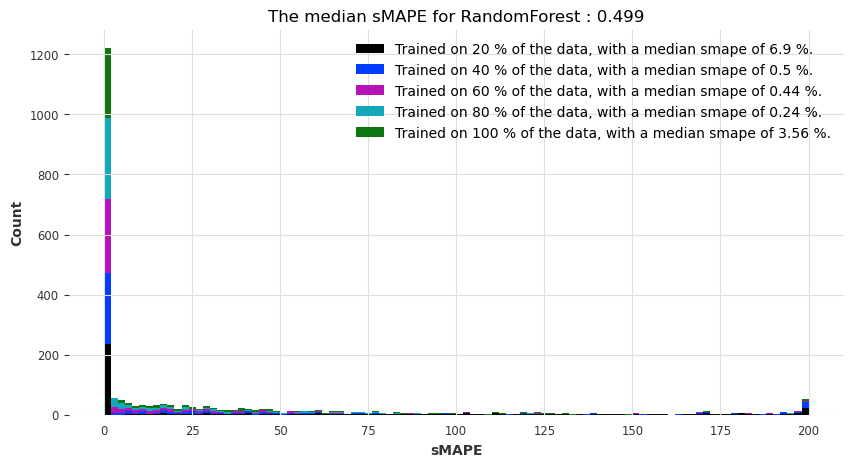

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 3it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 26it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 48it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 71it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

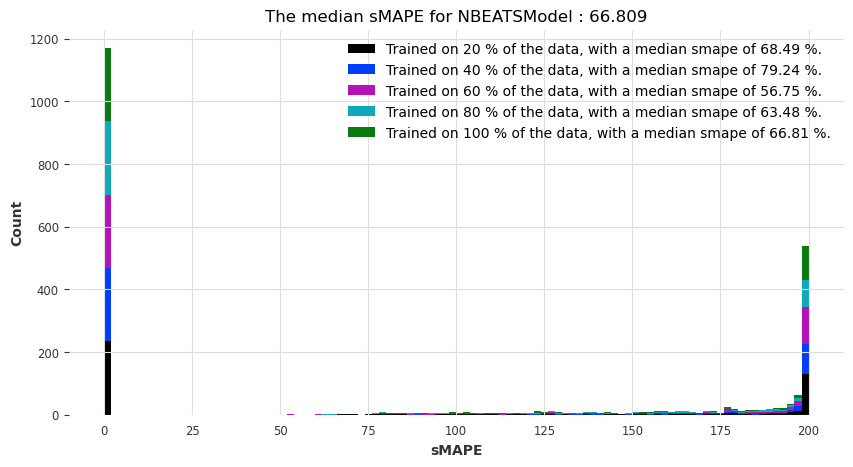

Visualization of performances taking the mean of the smapes over cross-validation


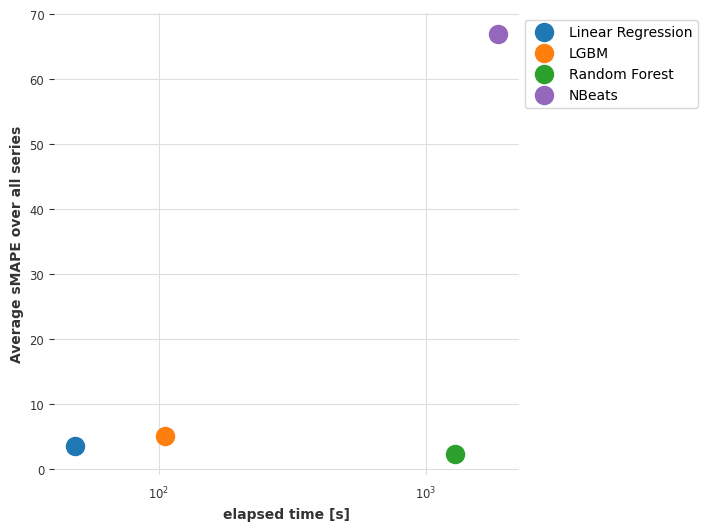

Visualization of performances taking the median of the smapes over cross-validation


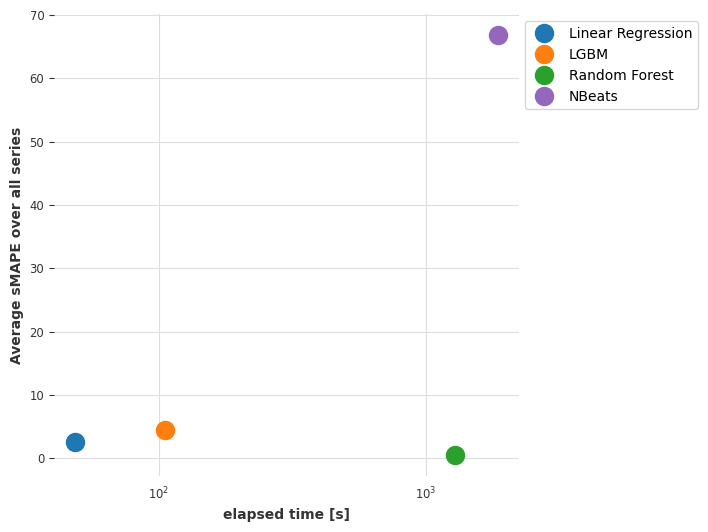

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

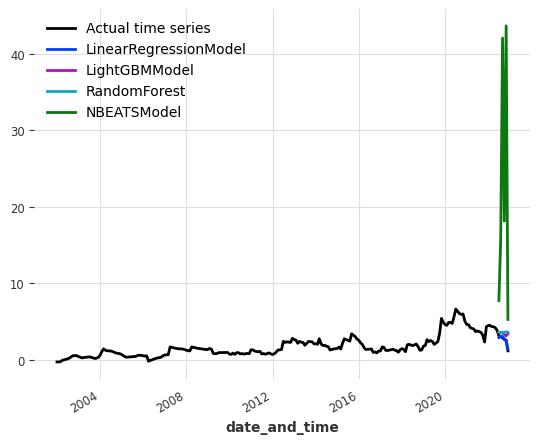

The results for index_cit_t2_t1 with an horizon of 12 are:


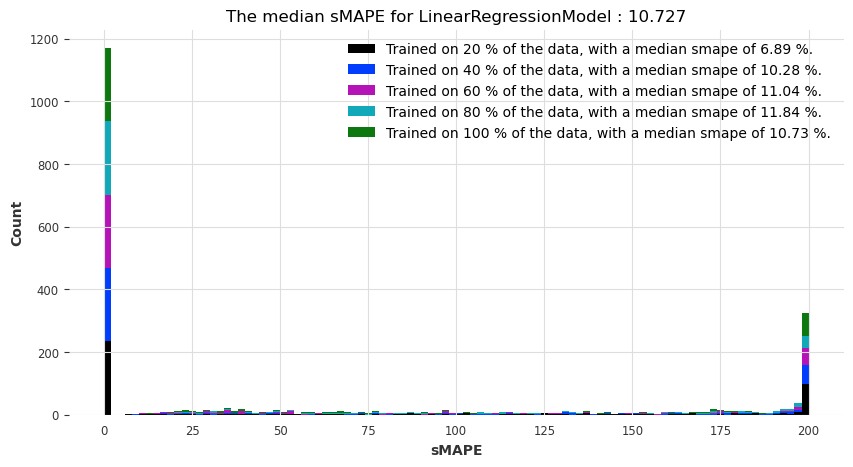

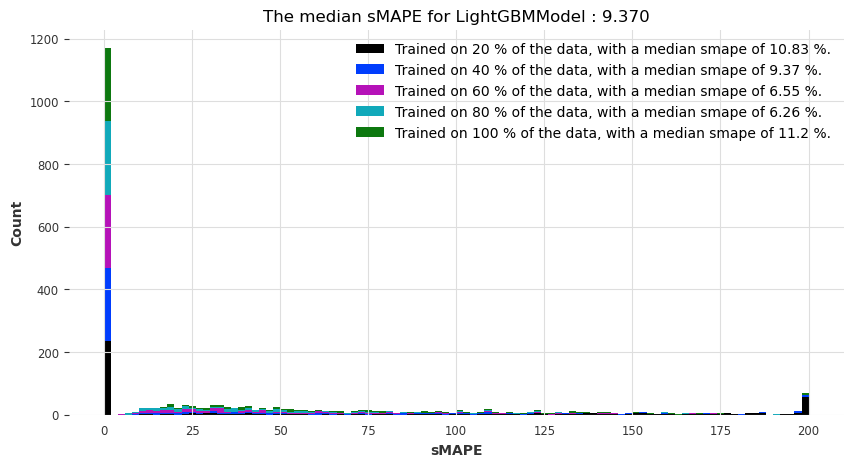

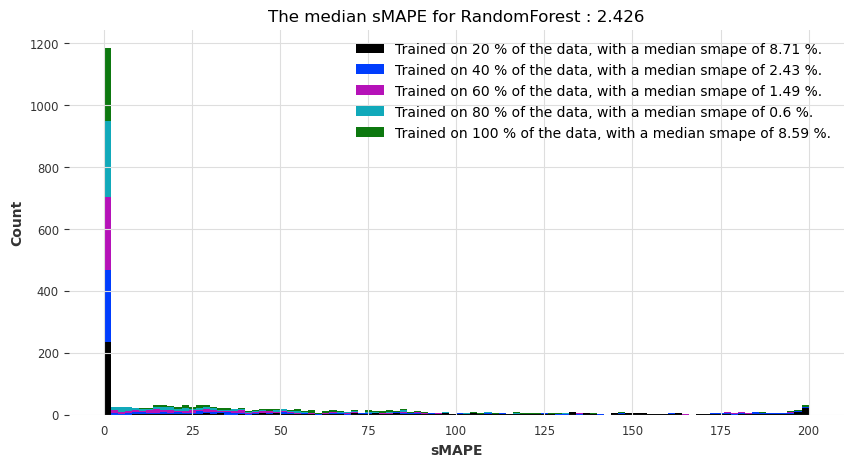

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 6it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 28it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 50it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 72it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

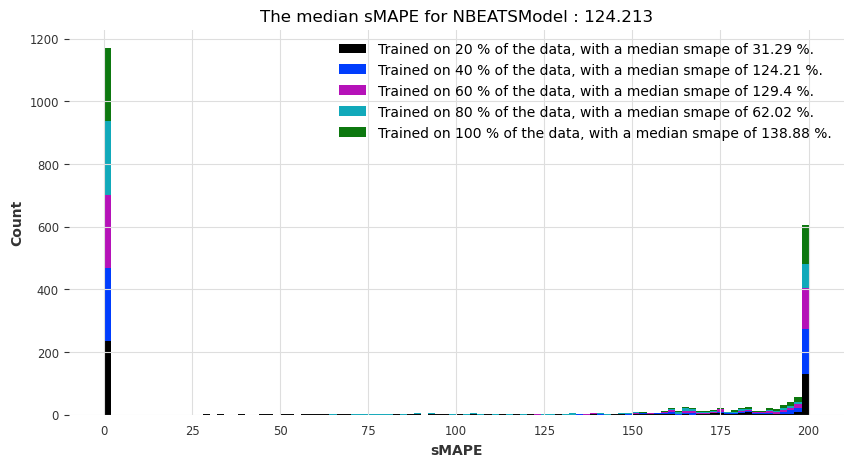

Visualization of performances taking the mean of the smapes over cross-validation


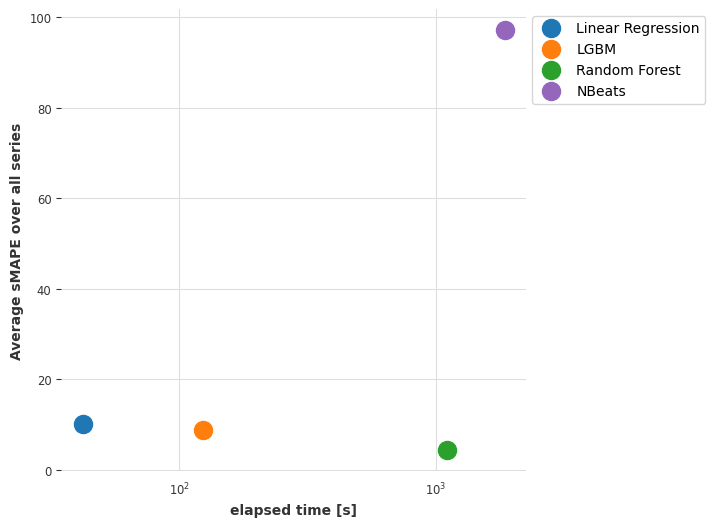

Visualization of performances taking the median of the smapes over cross-validation


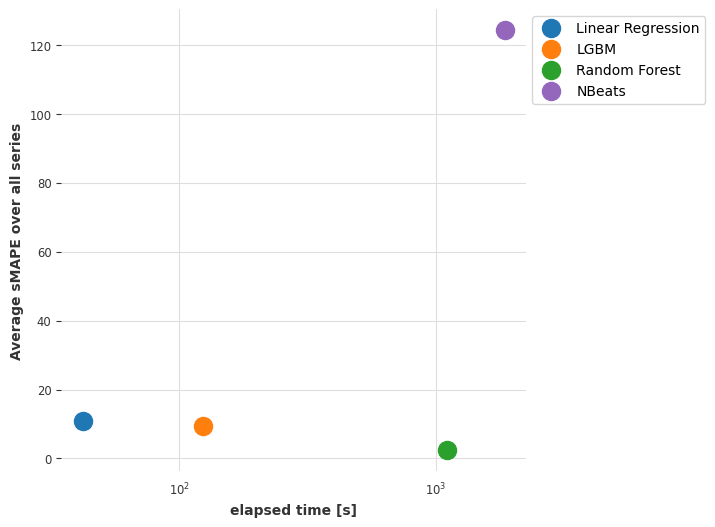

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

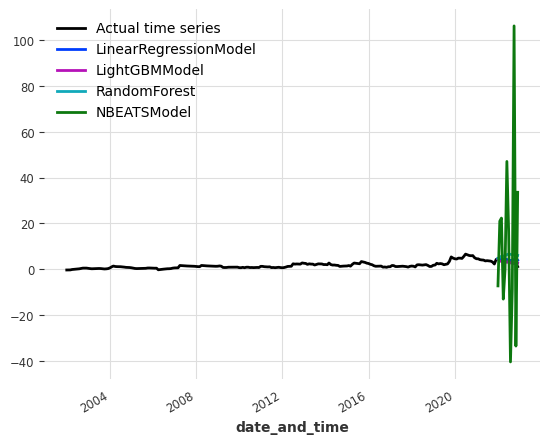

The results for index_colab_increm are:
The results for index_colab_increm with an horizon of 3 are:


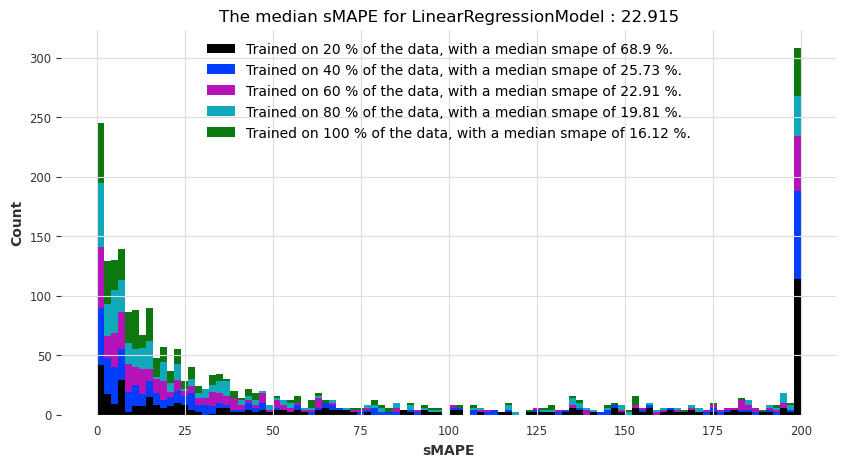

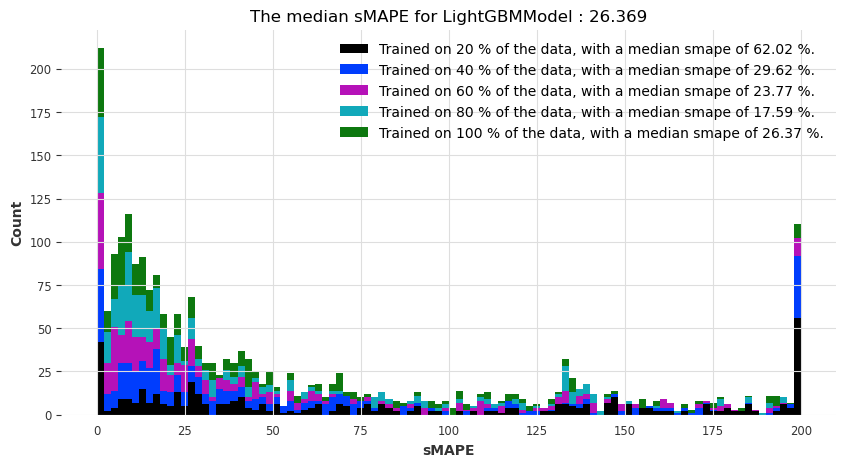

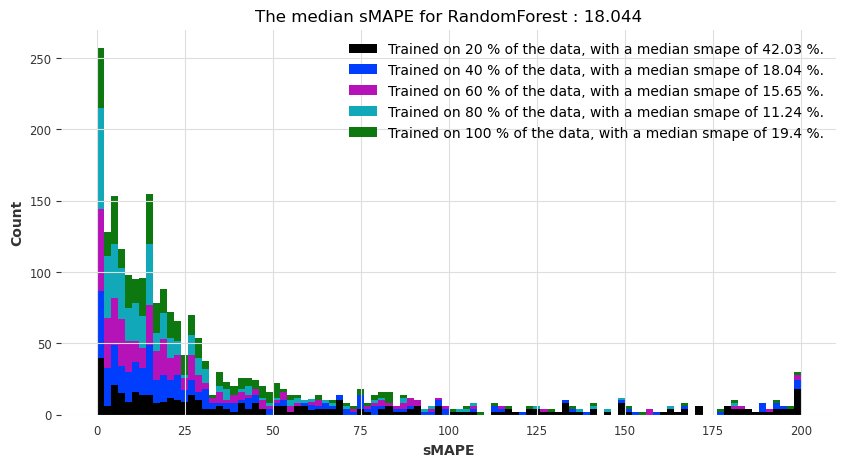

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 2it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 24it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 47it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 69it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

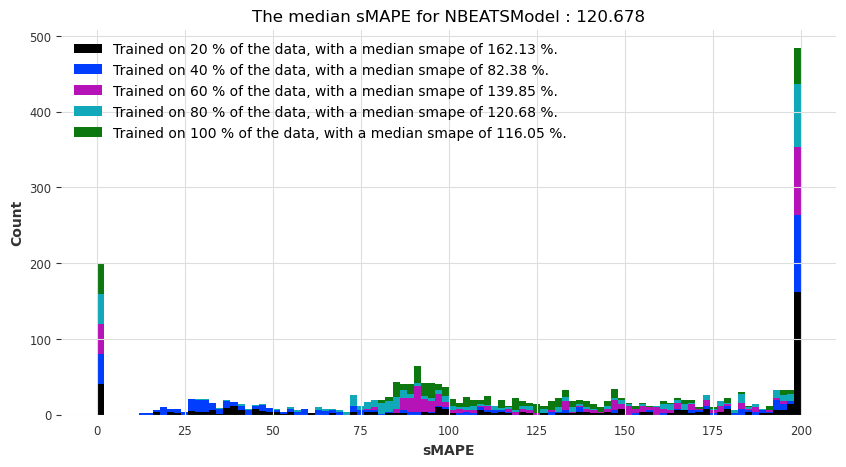

Visualization of performances taking the mean of the smapes over cross-validation


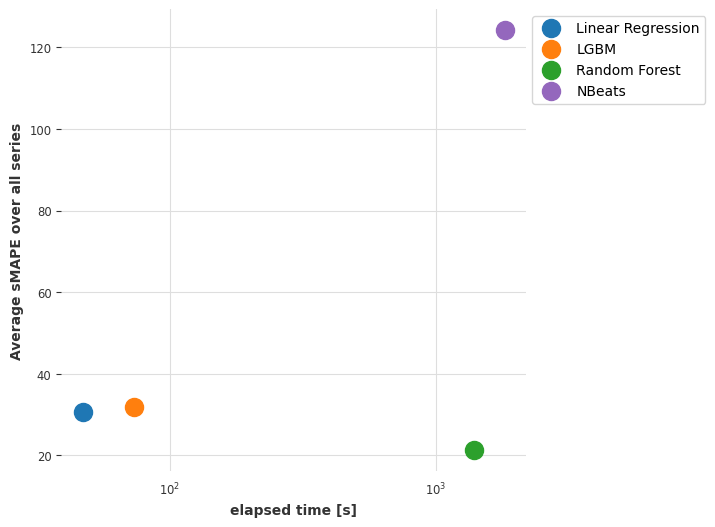

Visualization of performances taking the median of the smapes over cross-validation


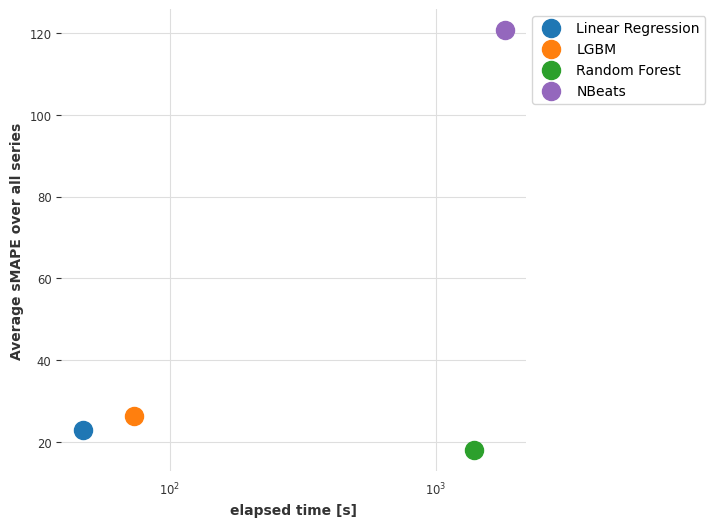

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

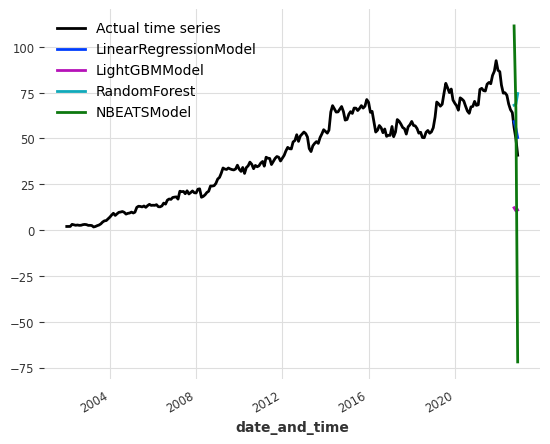

The results for index_colab_increm with an horizon of 6 are:


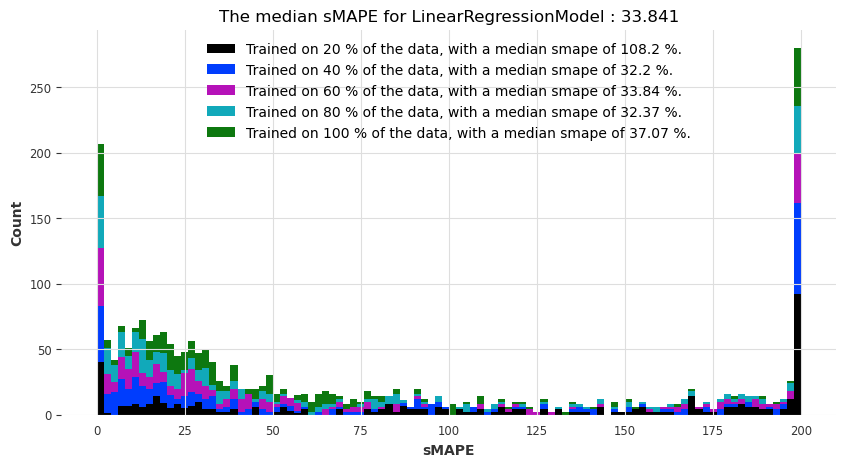

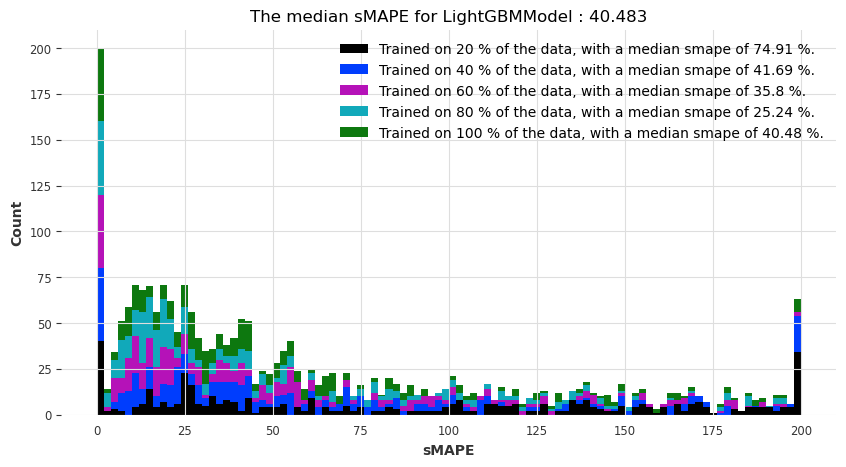

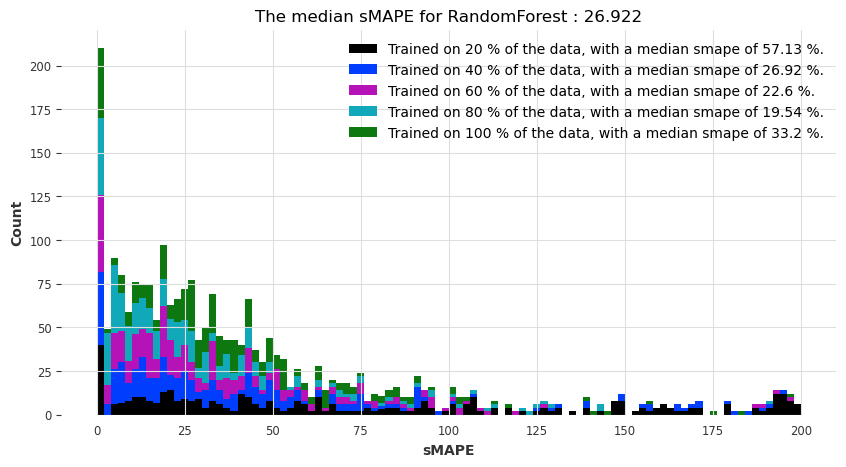

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 3it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 26it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 48it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 71it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

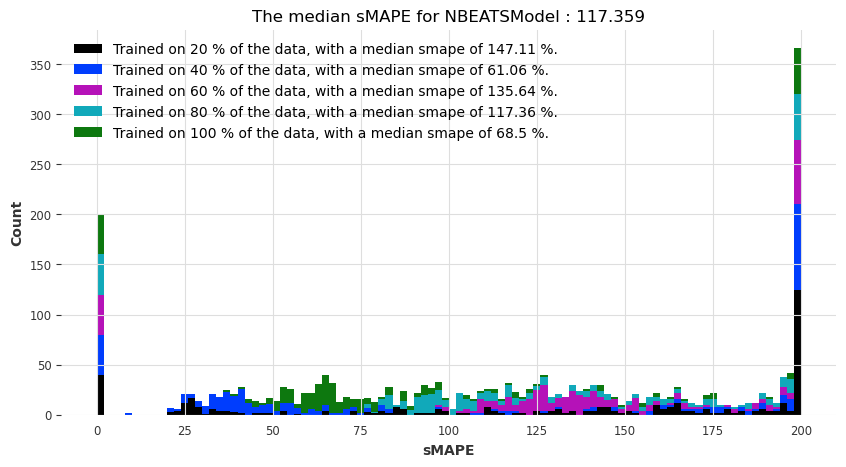

Visualization of performances taking the mean of the smapes over cross-validation


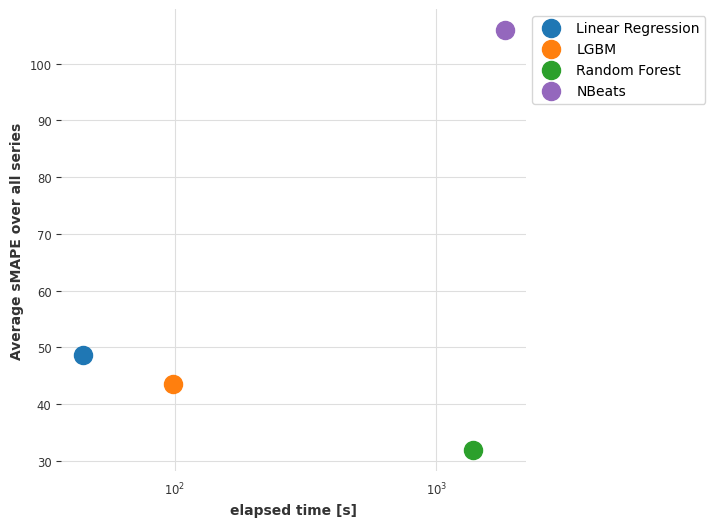

Visualization of performances taking the median of the smapes over cross-validation


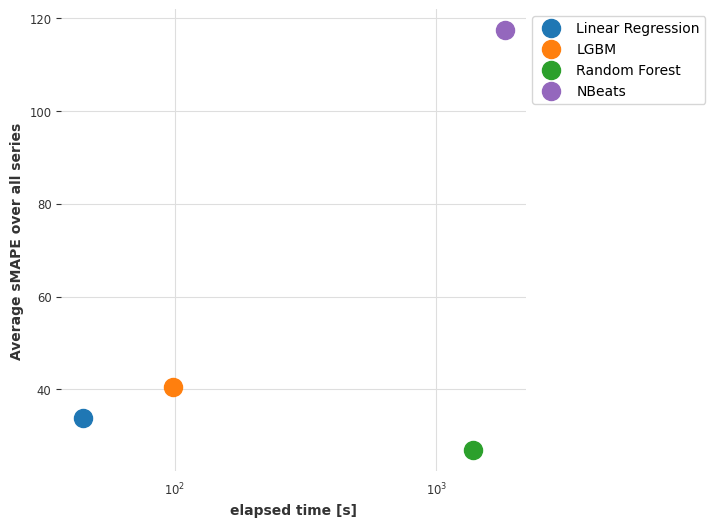

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

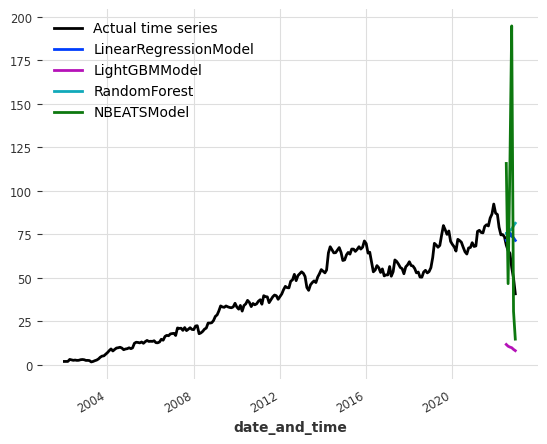

The results for index_colab_increm with an horizon of 12 are:


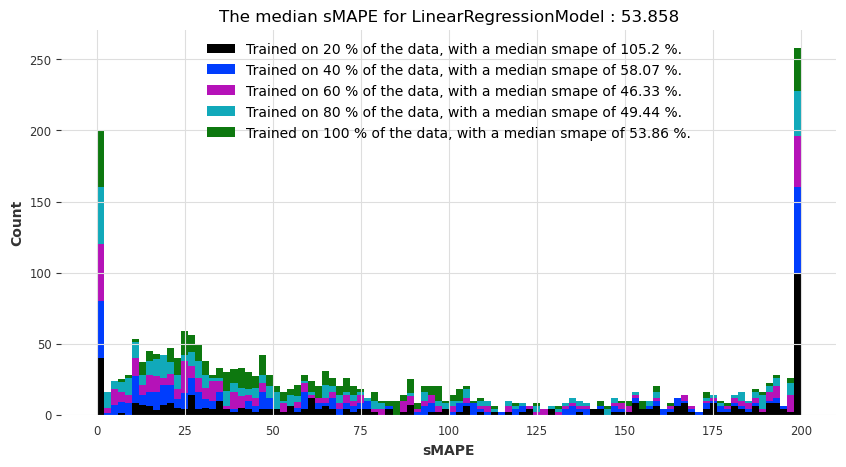

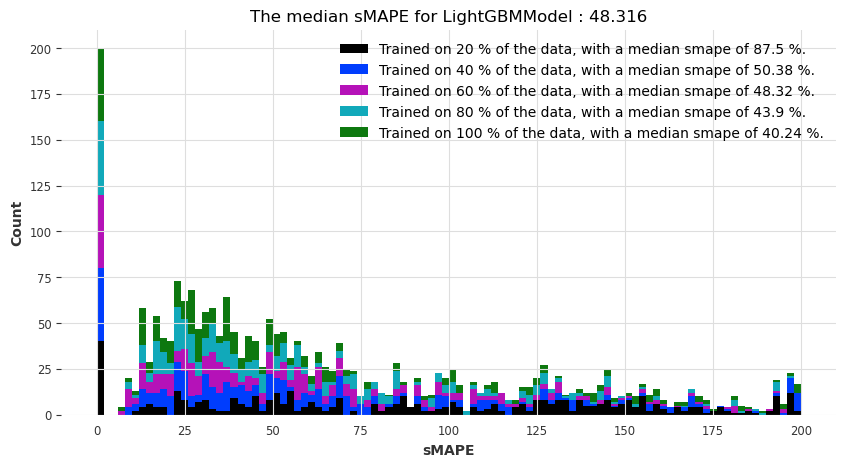

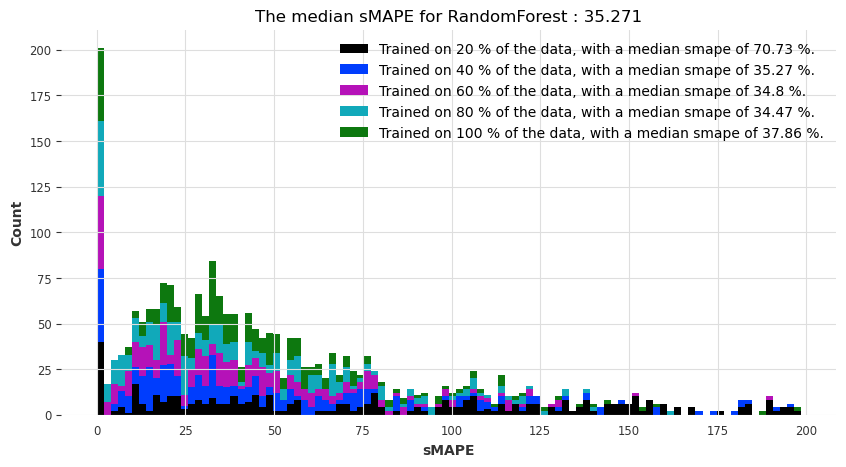

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 6it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 28it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 50it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 72it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

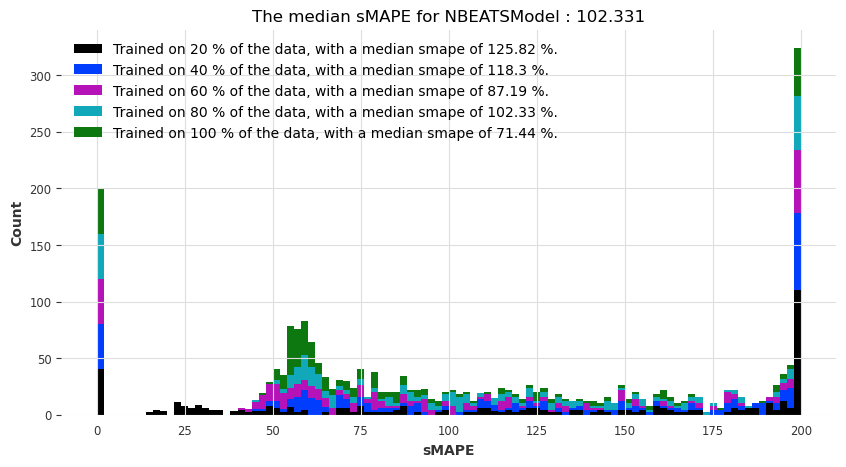

Visualization of performances taking the mean of the smapes over cross-validation


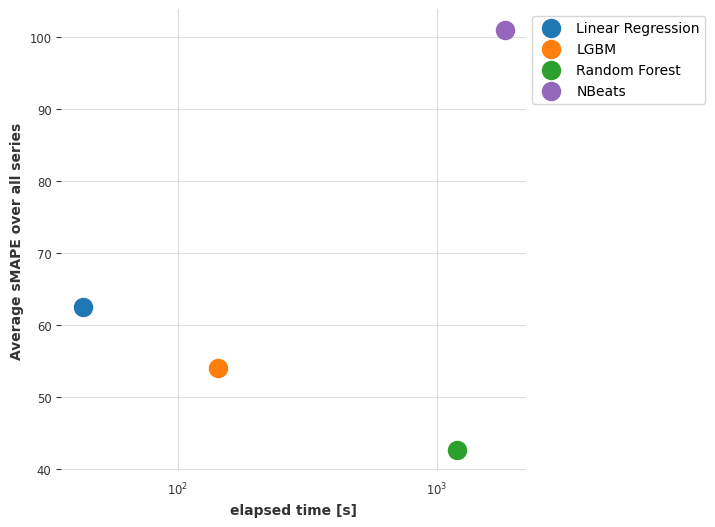

Visualization of performances taking the median of the smapes over cross-validation


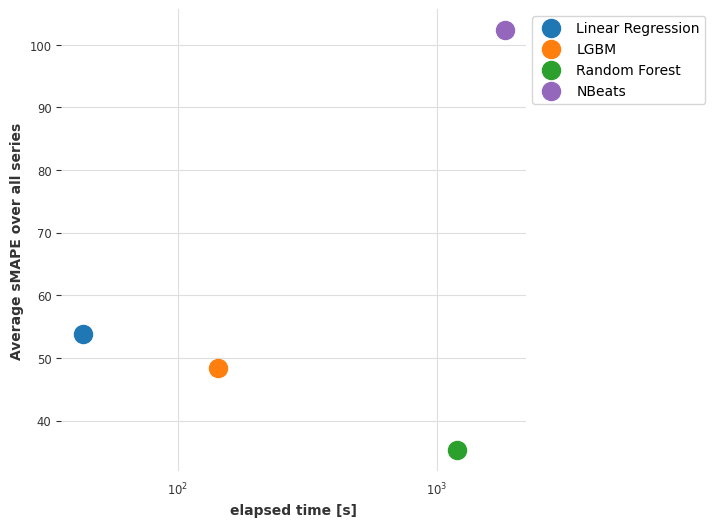

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

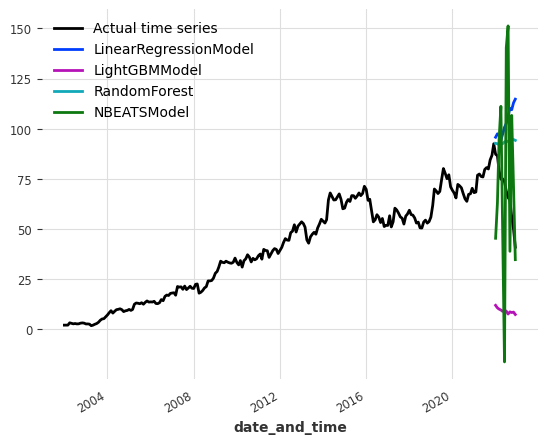

The results for index_colab_notincrem are:
The results for index_colab_notincrem with an horizon of 3 are:


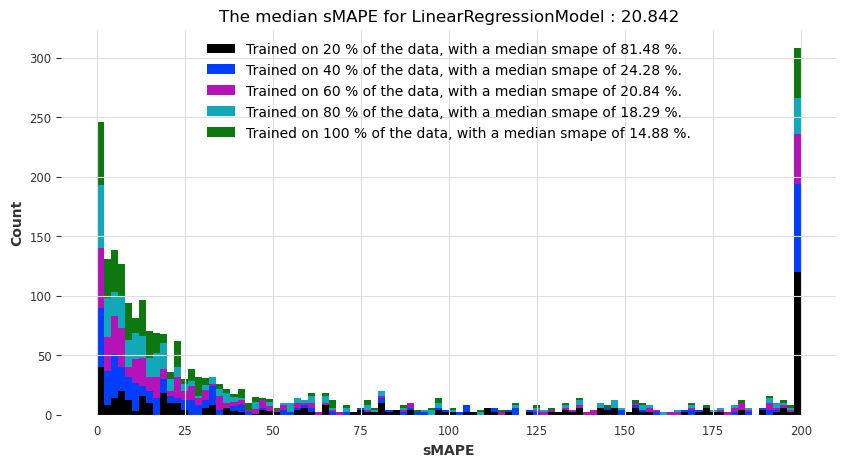

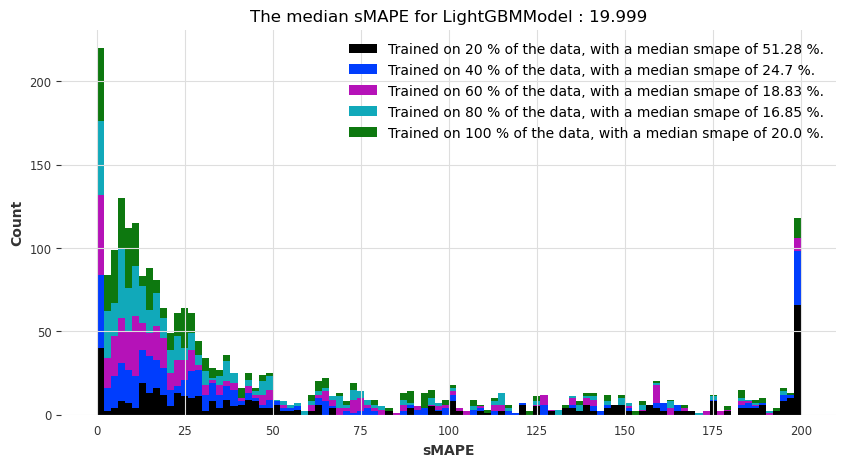

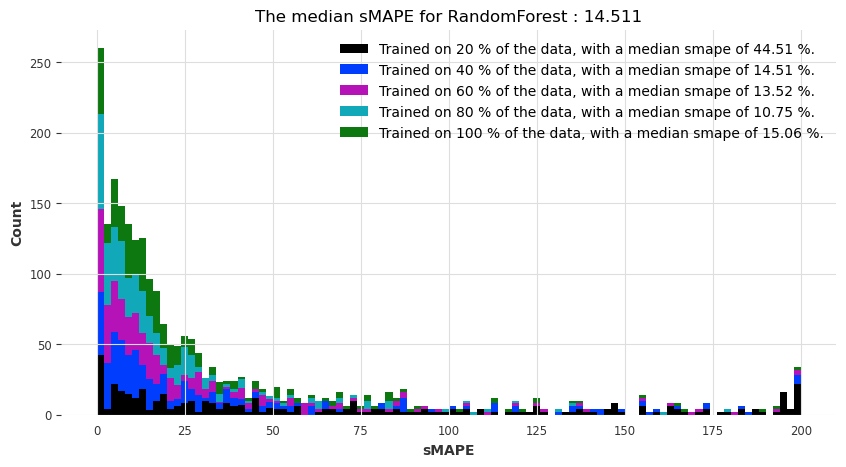

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 2it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 24it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 47it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 69it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

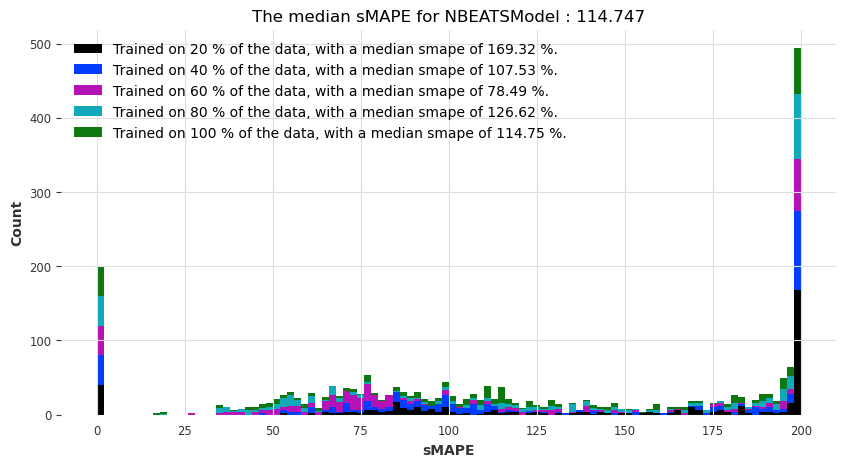

Visualization of performances taking the mean of the smapes over cross-validation


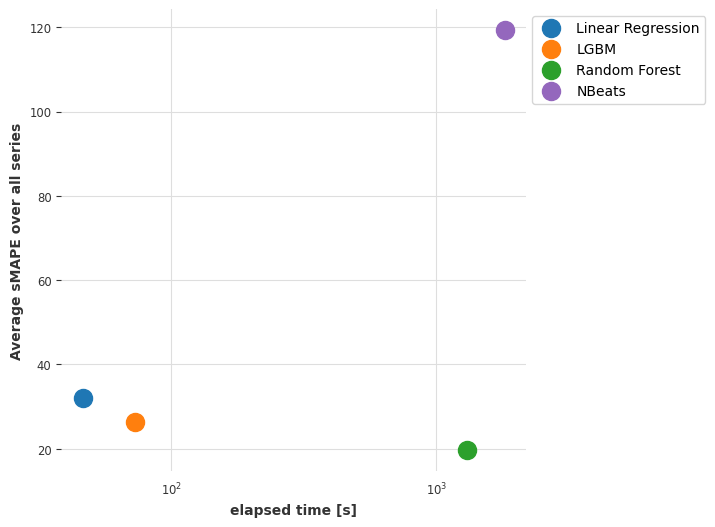

Visualization of performances taking the median of the smapes over cross-validation


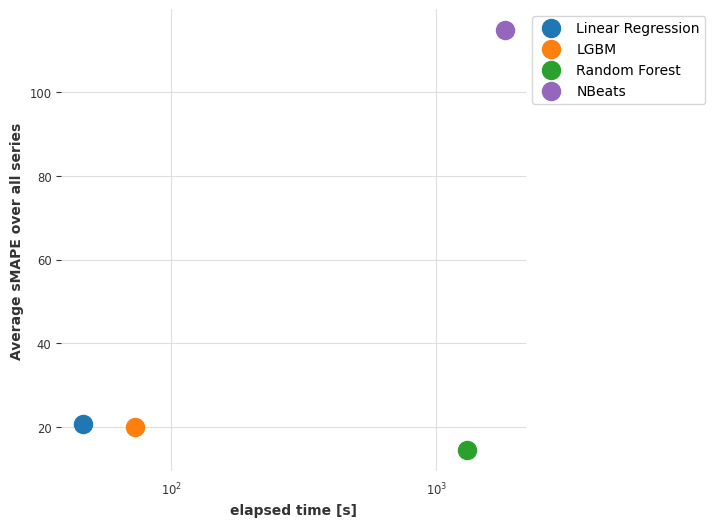

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

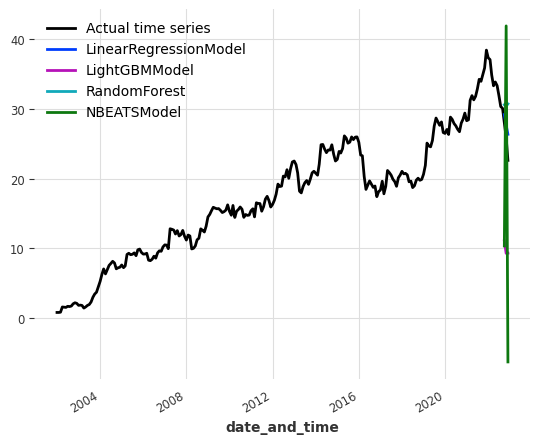

The results for index_colab_notincrem with an horizon of 6 are:


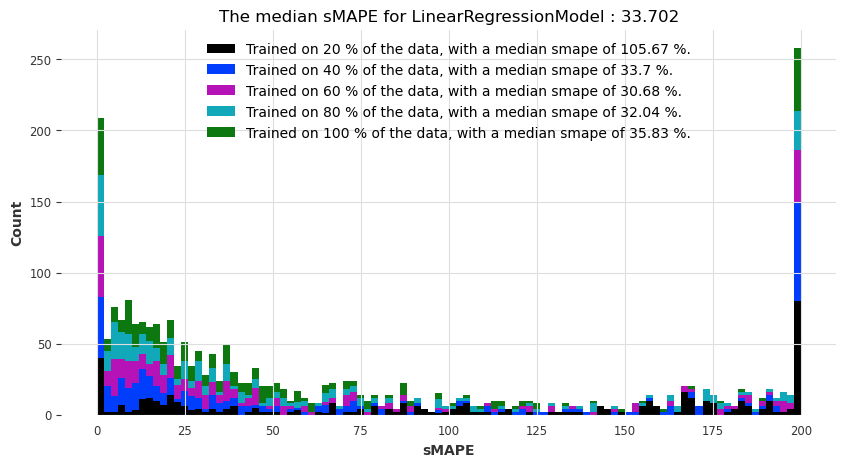

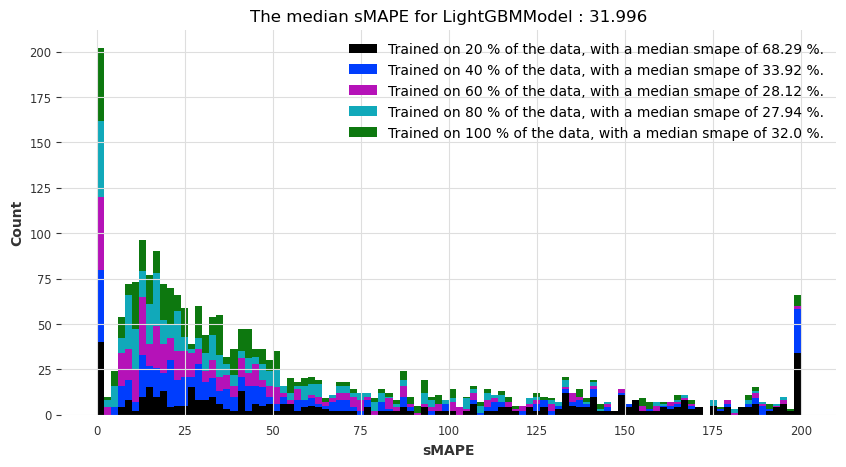

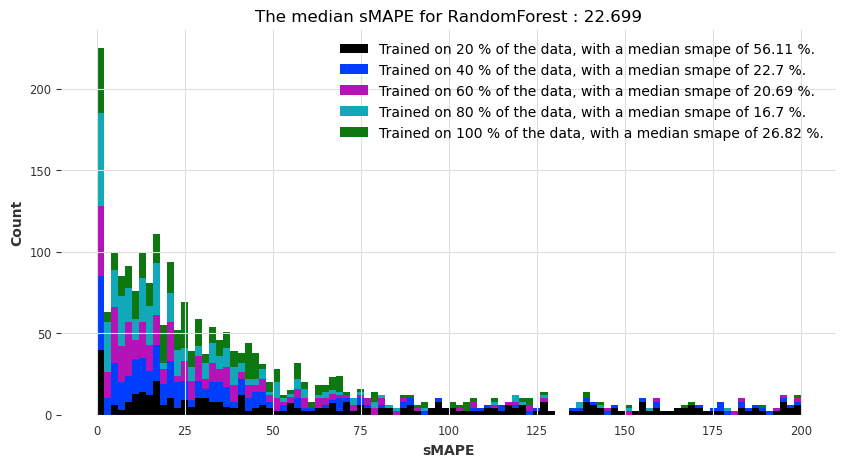

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 3it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 26it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 48it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 71it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

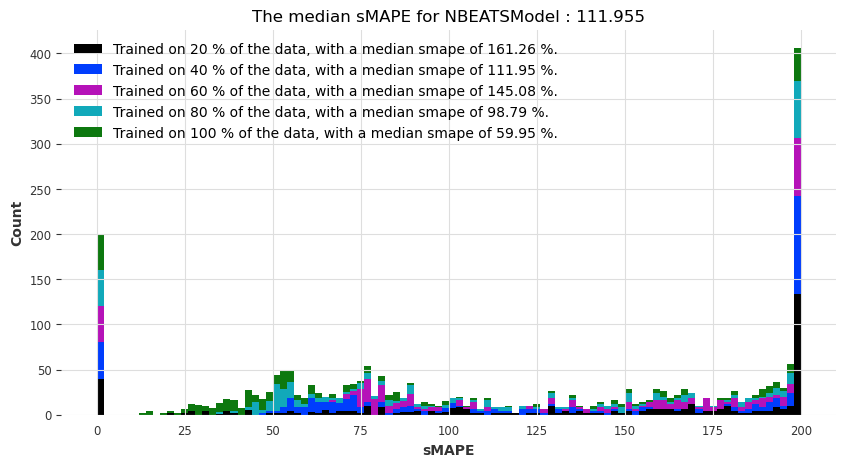

Visualization of performances taking the mean of the smapes over cross-validation


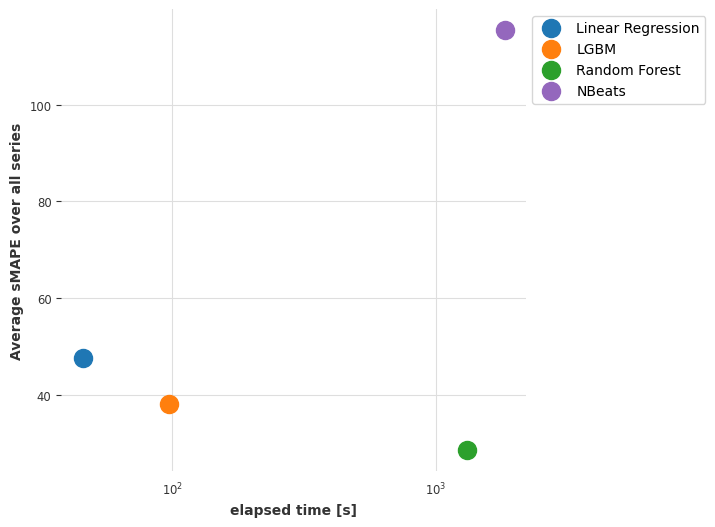

Visualization of performances taking the median of the smapes over cross-validation


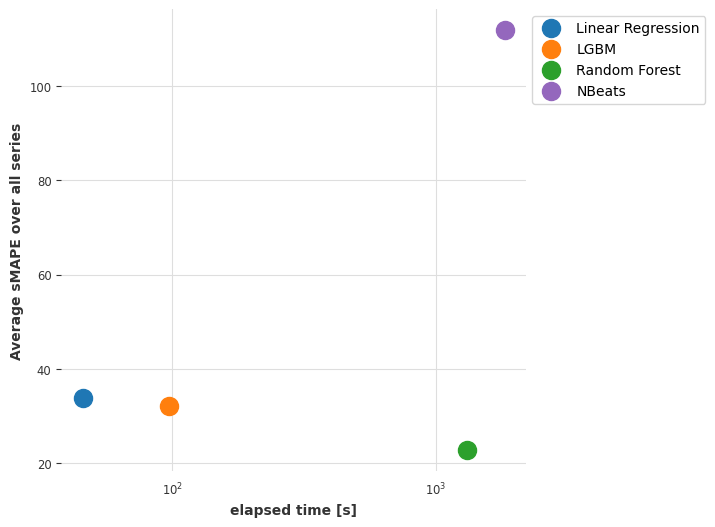

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

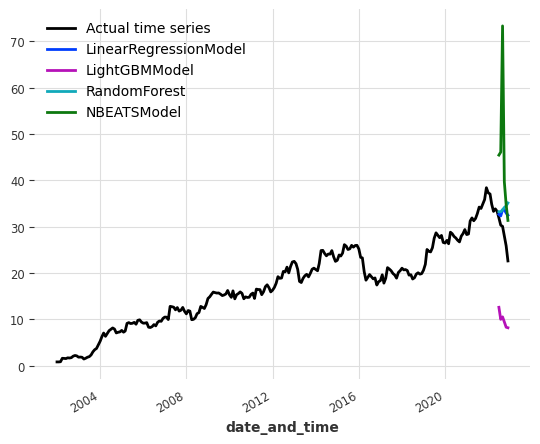

The results for index_colab_notincrem with an horizon of 12 are:


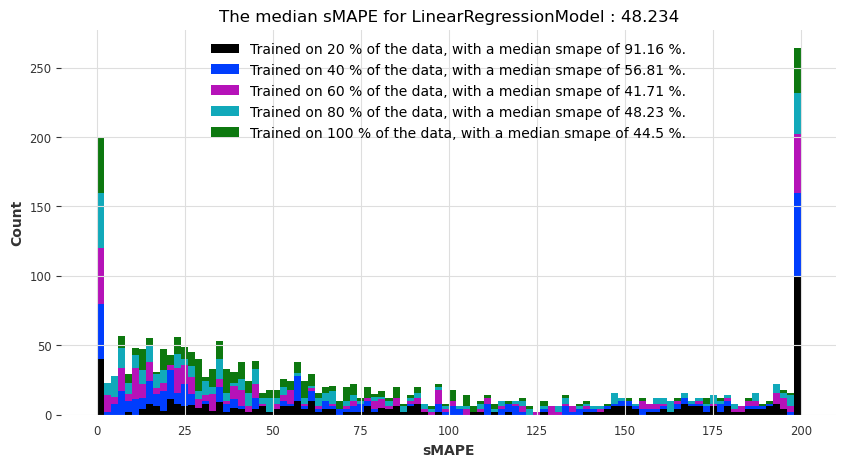

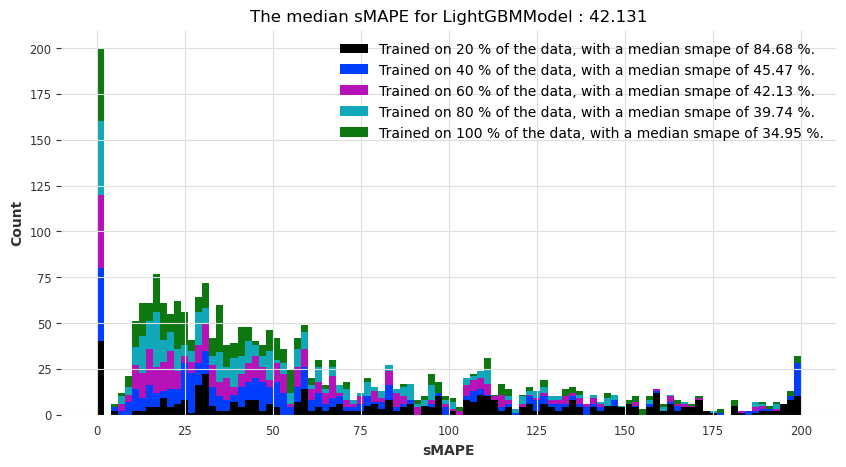

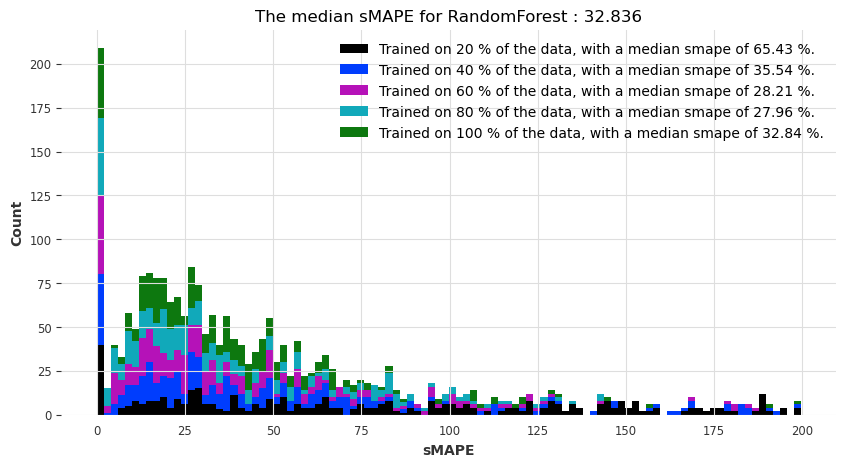

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 6it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 28it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 50it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 72it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

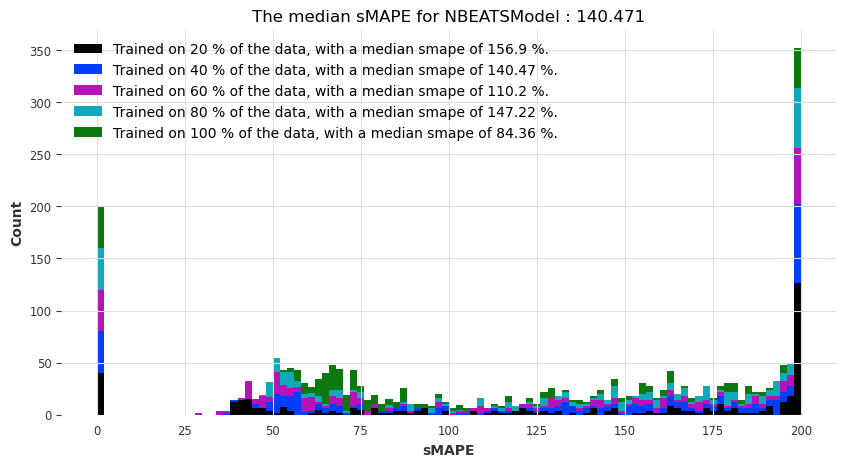

Visualization of performances taking the mean of the smapes over cross-validation


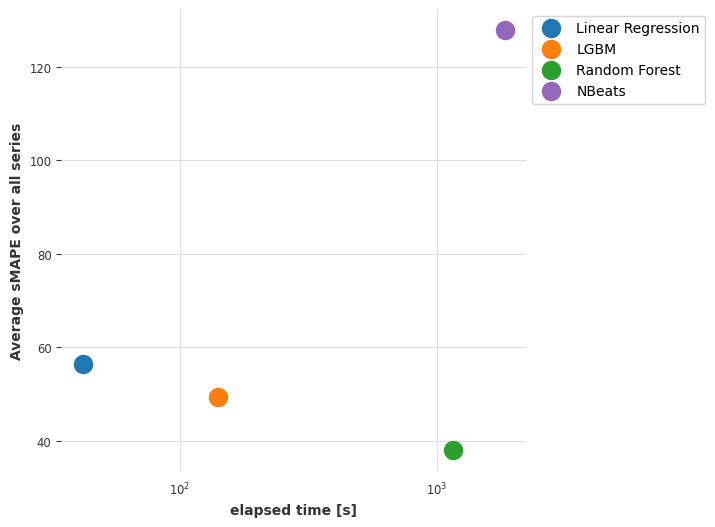

Visualization of performances taking the median of the smapes over cross-validation


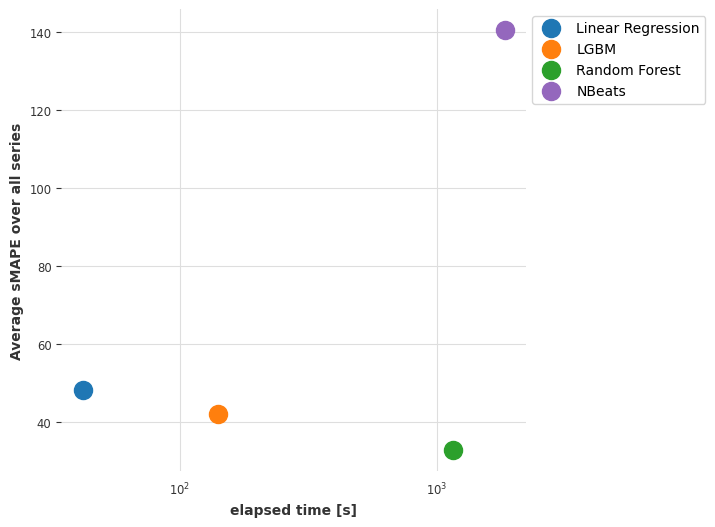

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

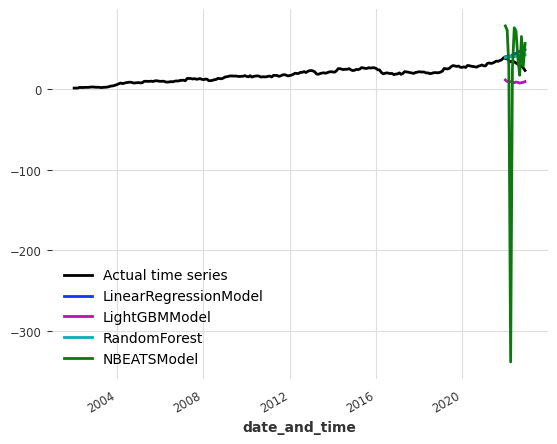

The results for index_keyword are:
The results for index_keyword with an horizon of 3 are:


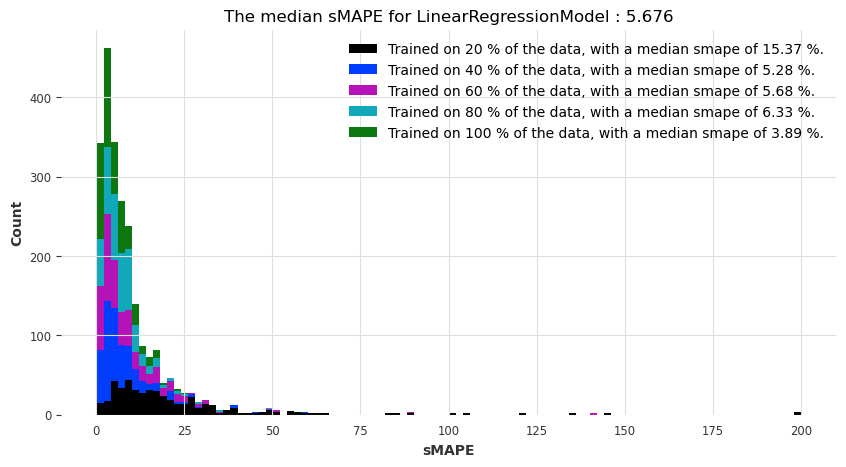

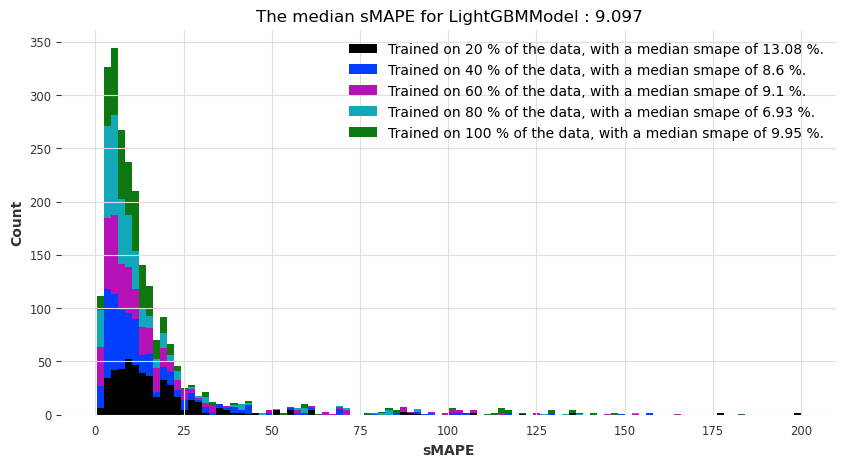

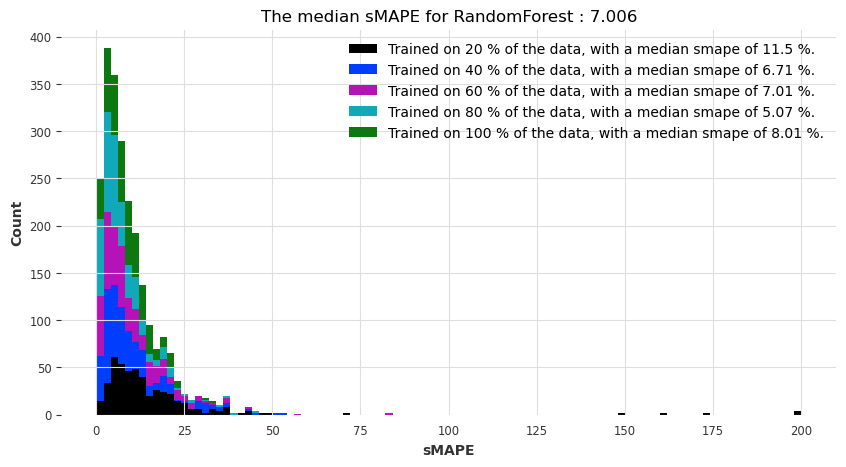

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 2it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 24it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 47it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 69it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 566 K 
---------------------------------------------------
564 K     Trainable params
2.0 K     Non-trainable params
566 K     Total params
4.533     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

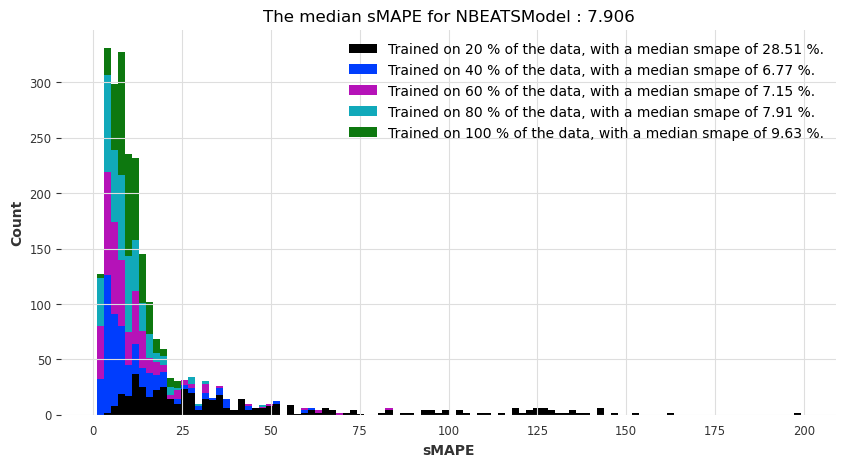

Visualization of performances taking the mean of the smapes over cross-validation


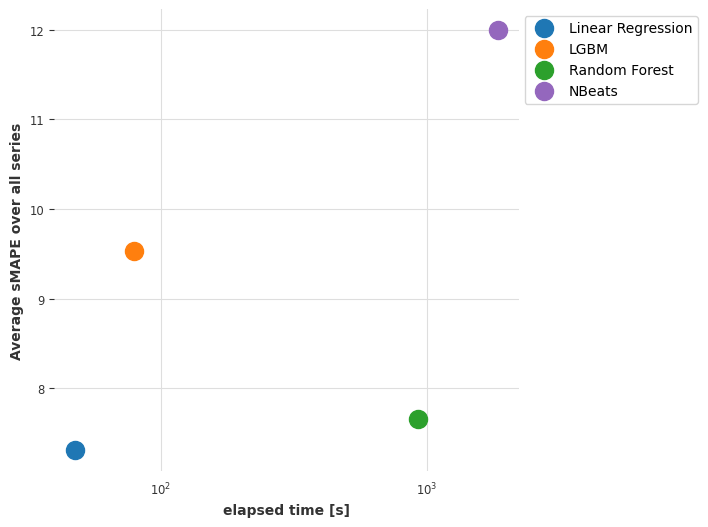

Visualization of performances taking the median of the smapes over cross-validation


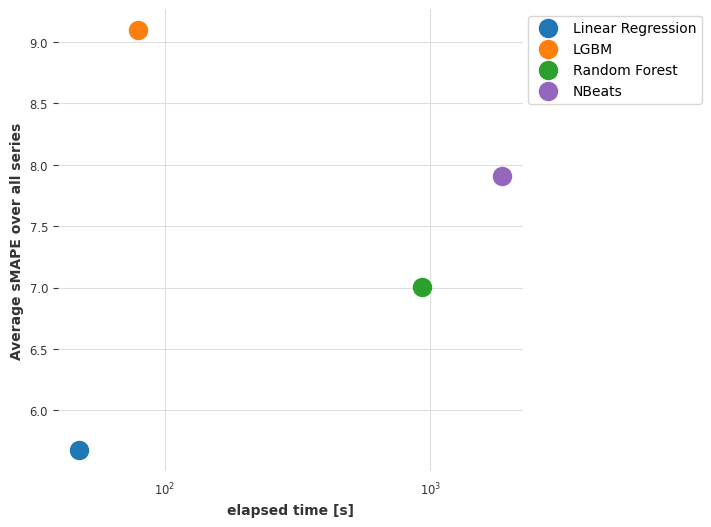

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

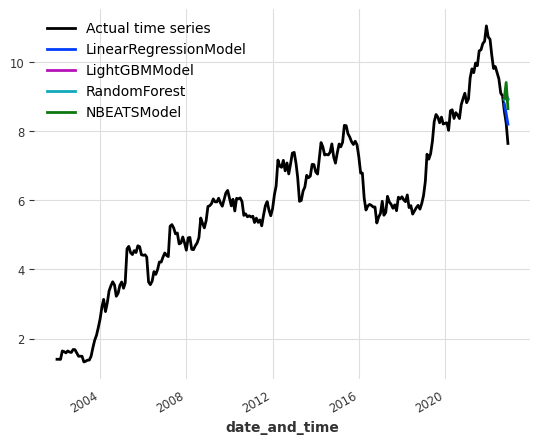

The results for index_keyword with an horizon of 6 are:


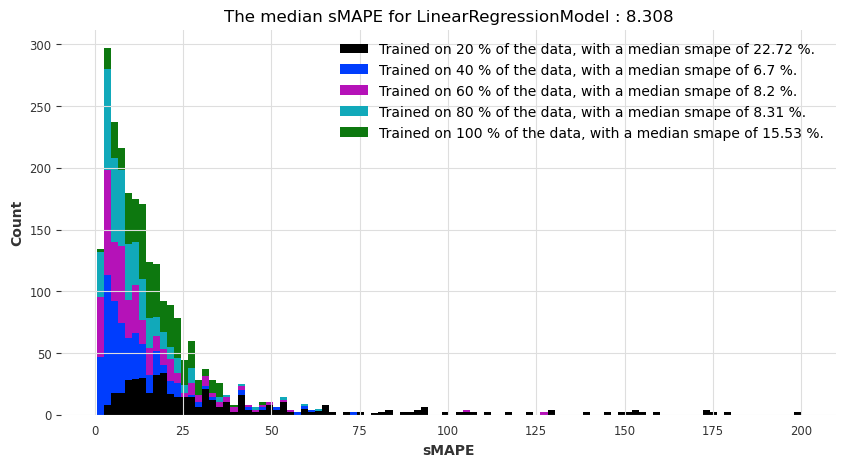

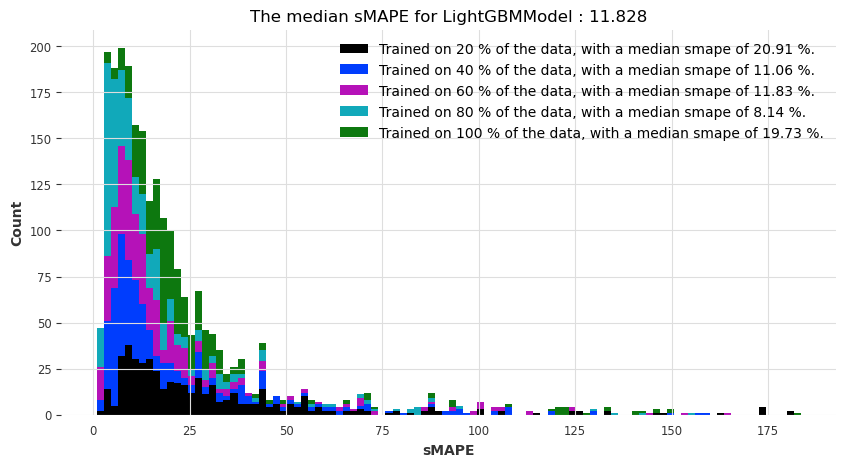

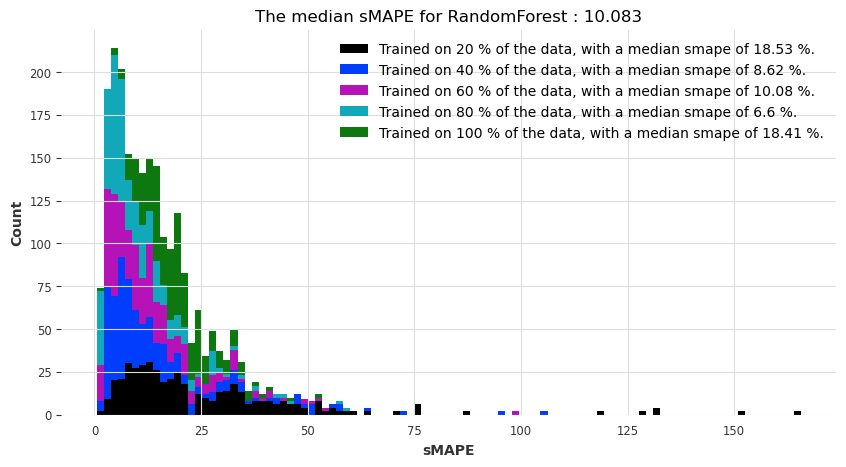

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 3it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 26it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 48it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 71it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 549 K 
---------------------------------------------------
547 K     Trainable params
2.0 K     Non-trainable params
549 K     Total params
4.396     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

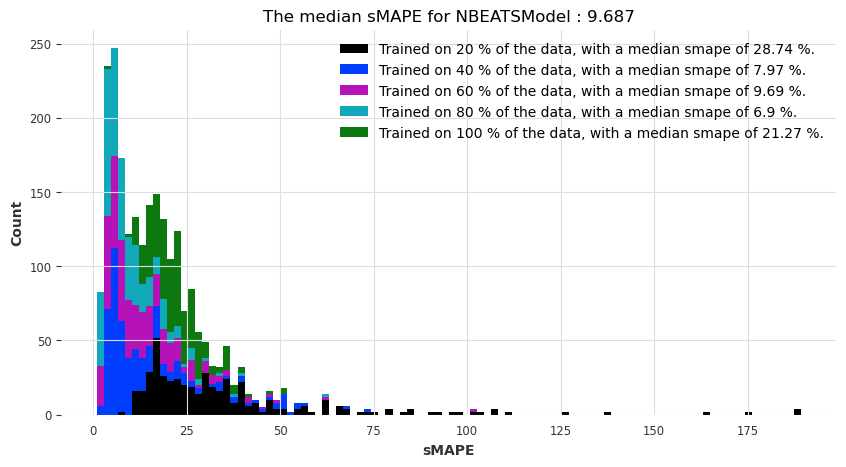

Visualization of performances taking the mean of the smapes over cross-validation


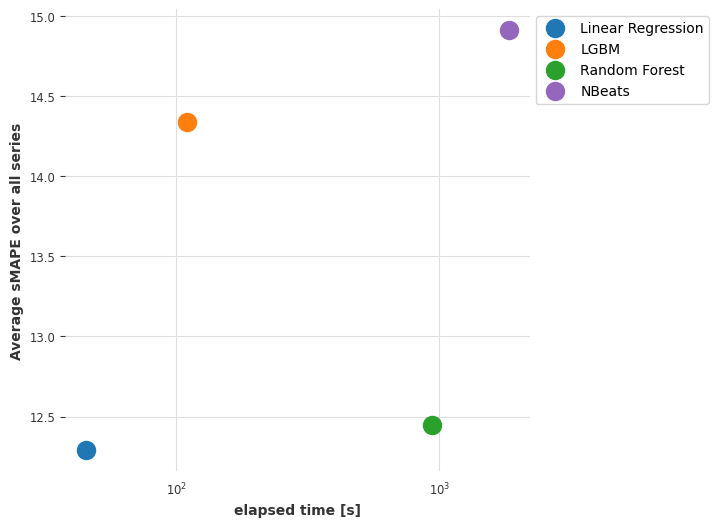

Visualization of performances taking the median of the smapes over cross-validation


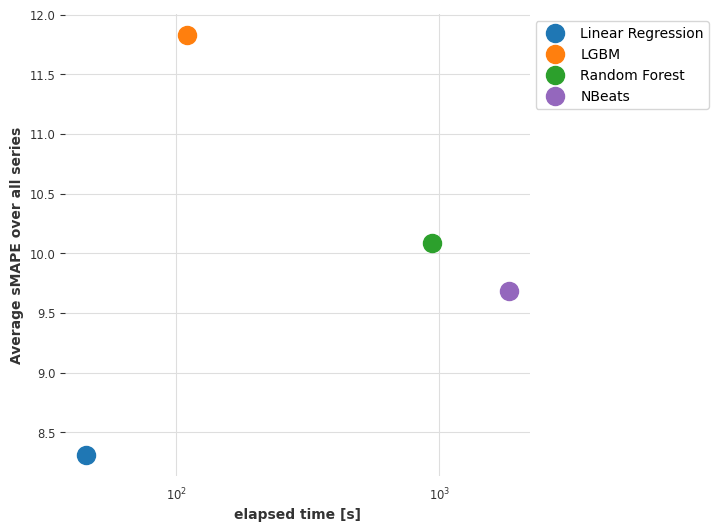

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

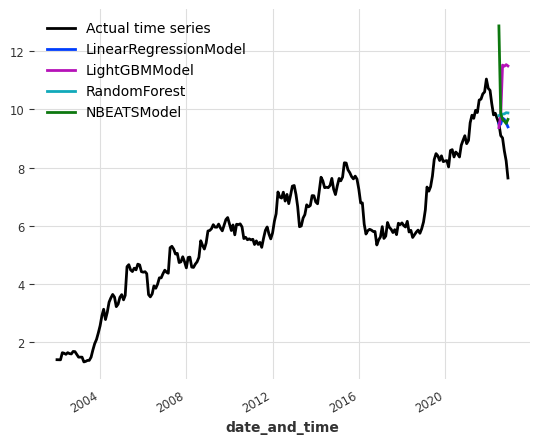

The results for index_keyword with an horizon of 12 are:


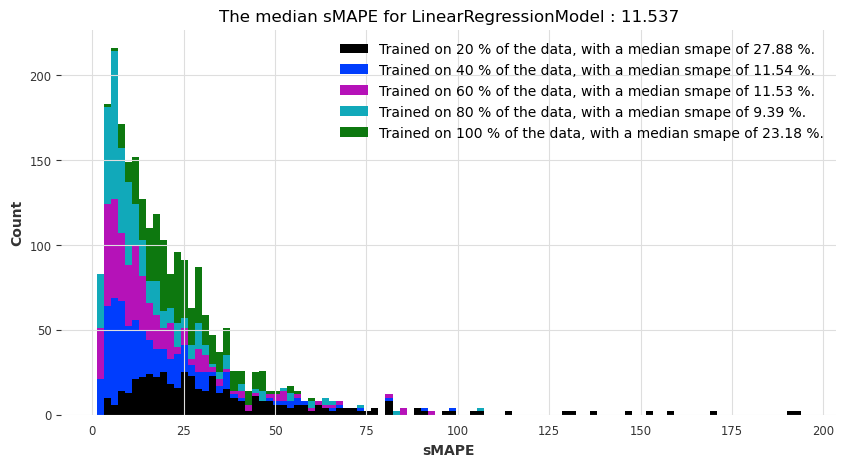

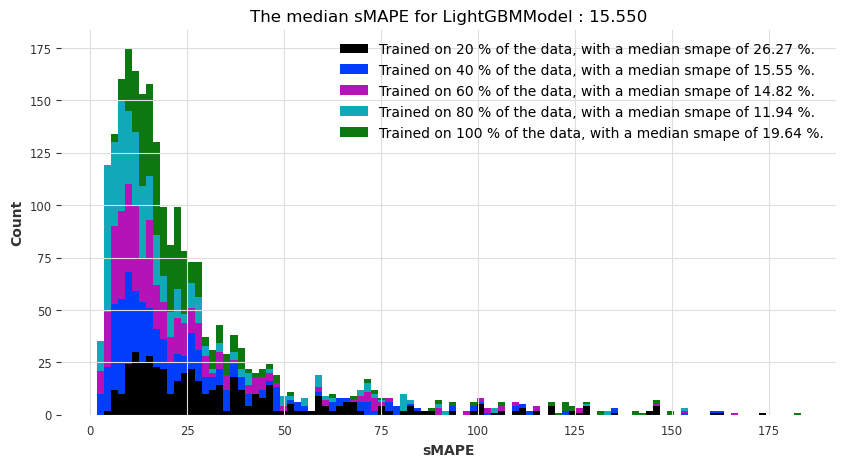

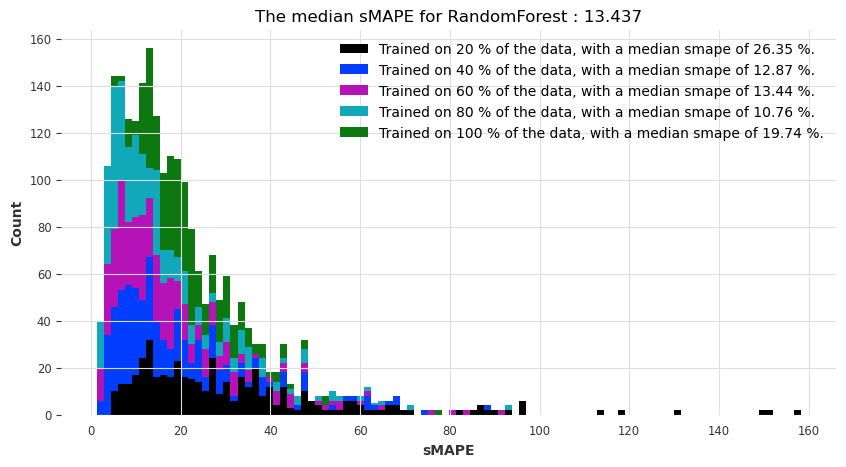

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 6it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 28it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 50it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 72it [00:00, ?it/s]

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | SmapeLoss        | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | stacks        | ModuleList       | 515 K 
---------------------------------------------------
513 K     Trainable params
1.8 K     Non-trainable params
515 K     Total params
4.124     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


Predicting: 94it [00:00, ?it/s]

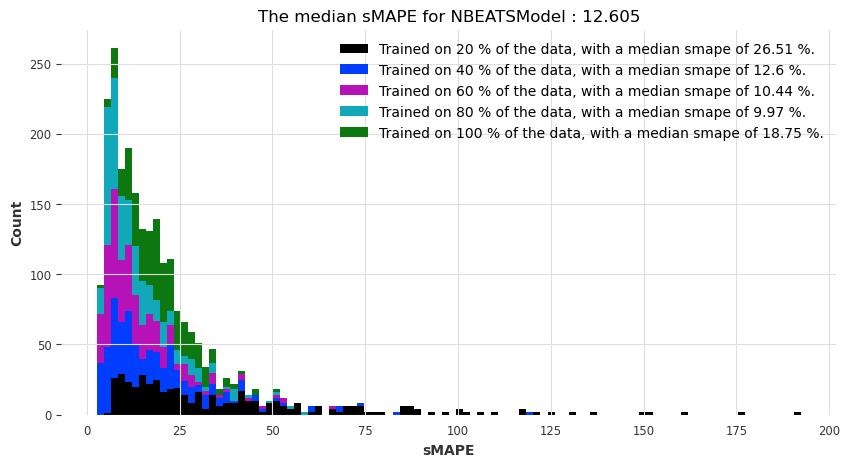

Visualization of performances taking the mean of the smapes over cross-validation


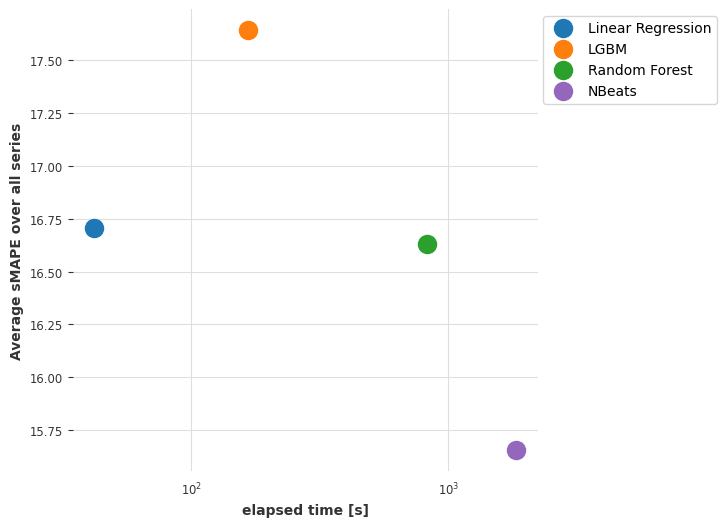

Visualization of performances taking the median of the smapes over cross-validation


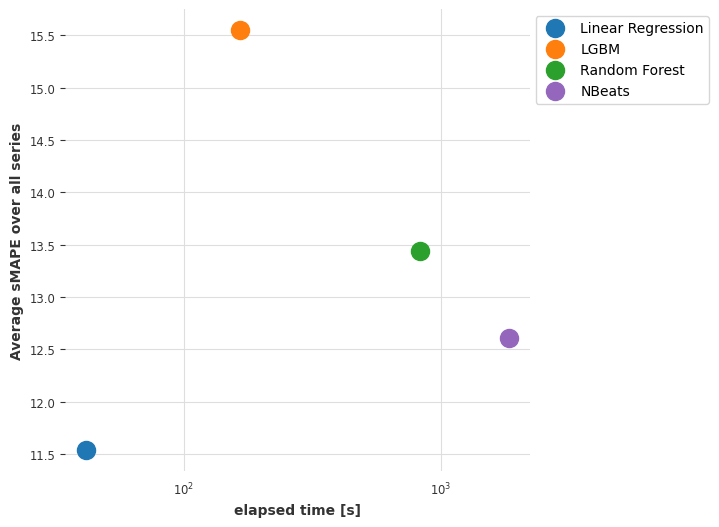

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

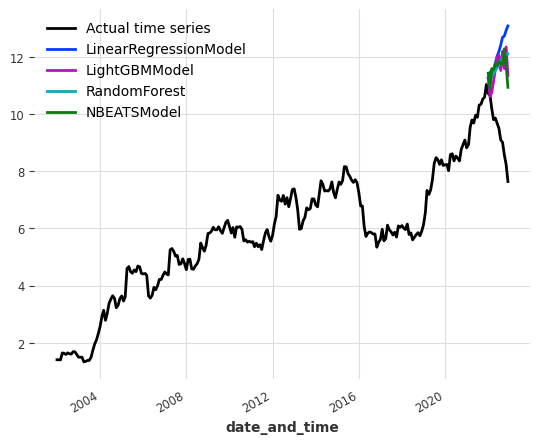

In [406]:
info_table = []
info_table_var=[]


for index in list_indices:
    dfofindex = dftm.loc[dftm['indextype']==index]
    print('The results for '+str(index)+' are:')
    listindex_byalgo=[]

    list_var_byalgo=[]
    
    for horizon in [3,6,12]:
        print('The results for '+str(index)+' with an horizon of '+str(horizon)+' are:')
        lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean,nbeats_smapes_mean,lr_var_allerrors,lr_mean_allvar,\
        lgbm_var_allerrors,lgbm_mean_allvar,rf_var_allerrors,rf_mean_allvar,nbeat_var_allerrors,nbeat_mean_allvar\
        =global_forecasting_mydata(dfofindex,horizon,list_concepts,5)
        
        listindex_byalgo=listindex_byalgo+\
        [lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean,nbeats_smapes_mean]
        
        list_var_byalgo=list_var_byalgo+[[lr_var_allerrors,lr_mean_allvar],[lgbm_var_allerrors,lgbm_mean_allvar],
        [rf_var_allerrors,rf_mean_allvar],[nbeat_var_allerrors,nbeat_mean_allvar]]
        
        plot_forecasting_models_global(modelnames,myforecasters,dfofindex,horizon,index) 
    
    list_toappend=[]    
    for i in range(4):
        for j in range(3):
            list_toappend.append(listindex_byalgo[i+j*4])
    info_table.append(list_toappend)
    
    list_toappend_var=[]    
    for i in range(4):
        for j in range(3):
            list_toappend_var.append(list_var_byalgo[i+j*4])
    info_table_var.append(list(chain.from_iterable(list_toappend_var)))

Global forecasting table of results.

In [407]:
iterables = [["Linear Regression","LGBM", "Random Forest","NBeats"], ["3 months", "6 months","12 months"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon"])

df = pd.DataFrame({'Index citations t1-t2':info_table[0], 'Index citations t2-t1': info_table[1],
                   'Index colaboration incremental': info_table[2],'colaboration not incremental':info_table[3],
                   'Index keywords': info_table[4]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                          2.105913   
                     6 months                          3.505690   
                     12 months                        10.155660   
LGBM                 3 months                          2.406481   
                     6 months                          5.062250   
                     12 months                         8.842265   
Random Forest        3 months                          0.924875   
                     6 months                          2.169526   
                     12 months                         4.317033   
NBeats               3 months                         85.056922   
                     6 months                         78.196377   
                     12 months                       100.187491   

                                          Index citations t2-t1  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                          2.105913   
                     6 months                          3.505690   
                     12 months                        10.155660   
LGBM                 3 months                          2.406481   
                     6 months                          5.062250   
                     12 months                         8.842265   
Random Forest        3 months                          0.816743   
                     6 months                          2.329000   
                     12 months                         4.363170   
NBeats               3 months                         67.126741   
                     6 months                         66.954699   
                     12 months                        97.162194   

                                          Index colaboration incremental  \
Forecaster algorithm Forecasting horizon                                   
Linear Regression    3 months                                  30.694886   
                     6 months                                  48.735885   
                     12 months                                 62.579597   
LGBM                 3 months                                  31.873299   
                     6 months                                  43.622503   
                     12 months                                 54.067988   
Random Forest        3 months                                  21.273800   
                     6 months                                  31.880657   
                     12 months                                 42.624386   
NBeats               3 months                                 124.215451   
                     6 months                                 105.933289   
                     12 months                                101.016772   

                                          colaboration not incremental  \
Forecaster algorithm Forecasting horizon                                 
Linear Regression    3 months                                31.952212   
                     6 months                                47.582907   
                     12 months                               56.484319   
LGBM                 3 months                                26.329677   
                     6 months                                38.053765   
                     12 months                               49.397665   
Random Forest        3 months                                19.670192   
                     6 months                                28.602559   
                     12 months                               37.995650   
NBeats               3 months                               119.340210   
                     6 months                               115.408914   
                     12 months                              127.831463   

                                          Index keywords  
For

We see that the random forest algorithm outperforms the other algorithm and becomes only slightly less accurate with the increase of the forecasting window. Nevertheless, the forecasting based on clustering using random forests (or nBeats) is significantly better than the insample forecasting as presented here.

In [408]:
iterables = [["Linear Regression","LGBM", "Random Forest","NBeats"], ["3 months", "6 months","12 months"],["Mean of variances", "Variances over all errors"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon","Type of variance"])

df = pd.DataFrame({'Index citations t1-t2':info_table_var[0], 'Index citations t2-t1': info_table_var[1],
                   'Index colaboration incremental': info_table_var[2],'colaboration not incremental':info_table_var[3],
                   'Index keywords': info_table_var[4]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm Forecasting horizon Type of variance                                   
Linear Regression    3 months            Mean of variances                       0.472522   
                                         Variances over all errors               0.031427   
                     6 months            Mean of variances                      10.283025   
                                         Variances over all errors               0.563248   
                     12 months           Mean of variances                      48.302042   
                                         Variances over all errors               3.361367   
LGBM                 3 months            Mean of variances                      74.730380   
                                         Variances over all errors               0.020513   
                     6 months            Mean of variances                      89.690204   
                                         Variances over all errors               0.170339   
                     12 months           Mean of variances                     126.032156   
                                         Variances over all errors               0.737576   
Random Forest        3 months            Mean of variances                       4.424897   
                                         Variances over all errors               0.017839   
                     6 months            Mean of variances                      13.750357   
                                         Variances over all errors               0.064432   
                     12 months           Mean of variances                      18.010984   
                                         Variances over all errors               0.690551   
NBeats               3 months            Mean of variances                     405.568798   
                                         Variances over all errors              19.466137   
                     6 months            Mean of variances                    1528.138929   
                                         Variances over all errors             137.276921   
                     12 months           Mean of variances                    6126.014203   
                                         Variances over all errors             678.095473   

                                                                    Index citations t2-t1  \
Forecaster algorithm Forecasting horizon Type of variance                                   
Linear Regression    3 months            Mean of variances                       0.472522   
                                         Variances over all errors               0.031427   
                     6 months            Mean of variances                      10.283025   
                                         Variances over all errors               0.563248   
                     12 months           Mean of variances                      48.302042   
                                         Variances over all errors               3.361367   
LGBM                 3 months            Mean of variances                      74.730380   
                                         Variances over all errors               0.020513   
                     6 months            Mean of variances                      89.690204   
                                         Variances over all errors               0.170339   
                     12 months           Mean of variances                     126.032156   
                                         Variances over all errors               0.737576   
Random Forest        3 months            Mean of variances                       4.651708   
                                         Variances over all errors               0.036851   
                     6 months            Mean of variances                      13.549793   
                                         Variances over all errors  

__Comment__

So far, we observe that the best forecasting model overall (that performed the best for all forecasting tasks in general overall) is random forests, trained on global data.

# **Part 4 -- Global forecasting based on transfer learning methods**

In [34]:
horizon =3

In [35]:
mylag=252-2*horizon

In [43]:
def eval_transfer_model(train_series,actual_series, test_series,horizon,modelname,model_cls, **kwargs):
    model = model_cls(**kwargs)

    if model_cls==NBEATSModel:
        model.fit(train_series, num_loader_workers=4, epochs=10)
    else:
        model.fit(train_series)
    preds = model.predict(n=horizon, series=actual_series)

    smapes,var_allerrors,var_mean_var = mysmape(preds, test_series)
    
    model.save("forecasting_models/"+str(modelname)+"_model.pkl")
    
    return smapes,var_allerrors,var_mean_var

In [44]:
def cross_validation_splitting_window_transfer(train_series,data,horizon,list_concepts,number_cv,modelname,forecaster,**kwargs):
    
    time1=time.time()
    
    maximal_train_len = 252-horizon
    score_forecaster = []
    allsmapes=[]
    
    mean_allvar= []
    var_alltheerrors = []
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =maximal_train_len//number_cv
            startingtime = i*windowslength
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_transfer_model(train_series,df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
            
        else:
            windowslength = maximal_train_len-(number_cv-1)*(maximal_train_len//number_cv) # to get the remaining window
            startingtime = i*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_transfer_model(train_series,df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
        
        allsmapes.append(smapes)
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window
        
        var_alltheerrors.append(var_allerrors)
        mean_allvar.append(var_mean_var)
        
    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    eval_kcross_forecasts(allsmapes,modelname)
    
    return elapsed_time,np.mean(myscores),np.median(myscores),np.mean(var_allerrors),np.mean(mean_allvar)

In [45]:
def cross_validation_expanding_window_transfer(train_series,data,horizon,list_concepts,number_cv,modelname,forecaster,**kwargs):
    
    time1=time.time()
    
    startingtime=0
    maximal_train_len = 252-horizon
    score_forecaster = []
    allsmapes=[]
    
    mean_allvar= []
    var_alltheerrors = []
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =(i+1)*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_transfer_model(train_series,df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
            
        else:
            windowslength = maximal_train_len
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes,var_allerrors,var_mean_var\
            =eval_transfer_model(train_series,df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
            
        
        allsmapes.append(smapes)
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window
        
        var_alltheerrors.append(var_allerrors)
        mean_allvar.append(var_mean_var)

    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    eval_kcross_forecasts(allsmapes,modelname)

    return elapsed_time,np.mean(myscores),np.median(myscores),np.mean(var_allerrors),np.mean(mean_allvar)

In [46]:
def load_m4(horizon,mytype='scaled') -> Tuple[List[TimeSeries], List[TimeSeries]]:
    
    # load TimeSeries - the splitting and scaling has already been done
    if mytype =='scaled':
        print("loading M4 TimeSeries...")
        with open("m4_monthly_scaled.pkl", "rb") as f:
            m4_series = pickle.load(f)
        
    else:
        print("loading M4 TimeSeries...")
        with open("m4_monthly.pkl", "rb") as f:
            m4_series = pickle.load(f)

    # filter and keep only series that contain at least 48 training points
    m4_series = list(filter(lambda t: len(t[0]) >= 252, m4_series))

    list_timeseries = []
    for tm in m4_series:
        mylist = []
        for x in tm[0].all_values():
            mylist.append(x[0][0])
    
        list_goodtype = np.array(mylist).astype(float)    
        mytm =TimeSeries.from_values(list_goodtype)
        list_timeseries.append(mytm)


    m4_train = [s[:-horizon] for s in list_timeseries]
    m4_test = [s[-horizon:] for s in list_timeseries]

    print(
        "done. There are {} series, with average training length {}".format(
            len(m4_train), np.mean([len(s) for s in list_timeseries])
        ))
    print(
        "The longest time series contain {} datapoints and the shortes time series {} datapoints.".format(
            np.max([len(s) for s in m4_train]), np.min([len(s) for s in list_timeseries])
        )
    )
    return m4_train, m4_test ,list_timeseries

In [47]:
def transfer_forecasting_mydata(train_series,dftm,horizon,list_concepts,number_cv):

    mylag =252//number_cv-2*horizon

    # regression models
            
    lr_time, lr_smapes_mean,lr_smapes_med,lr_var_allerrors,lr_mean_allvar =\
    cross_validation_expanding_window_transfer(train_series,dftm,\
    horizon,list_concepts,number_cv,'LinearRegressionModel', LinearRegressionModel, lags=mylag, output_chunk_length=horizon)
    
    lgbm_time, lgbm_smapes_mean,lgbm_smapes_med,lgbm_var_allerrors,lgbm_mean_allvar =\
    cross_validation_expanding_window_transfer(train_series,dftm,\
    horizon,list_concepts,number_cv,'LightGBMModel', LightGBMModel,lags=mylag, output_chunk_length=horizon, objective="mape")
  
    rf_time, rf_smapes_mean,rf_smapes_med,rf_var_allerrors,rf_mean_allvar\
    =cross_validation_expanding_window_transfer(train_series,dftm,\
    horizon,list_concepts,number_cv,'RandomForest', RandomForest,lags=mylag, output_chunk_length=horizon)
    
    #deep learning models

    nbeat_time,nbeat_smapes_mean,nbeat_smapes_med,nbeat_var_allerrors,nbeat_mean_allvar\
    =cross_validation_expanding_window_transfer(train_series,dftm,\
    horizon,list_concepts,number_cv,'NBEATSModel', NBEATSModel,input_chunk_length=mylag,output_chunk_length=horizon,num_stacks=20,
    num_blocks=1,num_layers=2,layer_widths=136,expansion_coefficient_dim=11,loss_fn=SmapeLoss(),batch_size=1024,
    optimizer_kwargs={"lr":  1e-3})
    
    smapes_mean = {
        "Linear Regression": lr_smapes_mean,
        "LGBM": lgbm_smapes_mean,
        "Random Forest": rf_smapes_mean,
        "NBeats": nbeat_smapes_mean,
    }

    elapsed_times = {
        "Linear Regression": lr_time,
        "LGBM": lgbm_time,
        "Random Forest": rf_time,
        "NBeats": nbeat_time,
    }

    smapes_med = {
        "Linear Regression": lr_smapes_med,
        "LGBM": lgbm_smapes_med,
        "Random Forest": rf_smapes_med,
        "NBeats": nbeat_smapes_med,
    }

        
    print('Visualization of performances taking the mean of the smapes over cross-validation')
    plot_models(elapsed_times, smapes_mean)
    
        
    print('Visualization of performances taking the median of the smapes over cross-validation')
    plot_models(elapsed_times, smapes_med)
    
    return lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean,nbeat_smapes_mean,lr_var_allerrors,lr_mean_allvar,lgbm_var_allerrors,lgbm_mean_allvar,rf_var_allerrors,rf_mean_allvar,nbeat_var_allerrors,nbeat_mean_allvar

In [ ]:
myforecasters = [LinearRegressionModel,LightGBMModel,RandomForest,NBEATSModel]
modelnames = ["LinearRegressionModel","LightGBMModel","RandomForest","NBEATSModel"]

In [48]:
m4_train_scaled, m4_test_scaled, m4_scaled_all= load_m4(5,'scaled')
m4_train_notscaled, m4_test_notscaled, m4_notscaled_all = load_m4(5,'notscaled')
external_data = m4_notscaled_all[:5000]

loading M4 TimeSeries...
done. There are 18398 series, with average training length 351.4092836177845
The longest time series contain 2789 datapoints and the shortes time series 252 datapoints.
loading M4 TimeSeries...
done. There are 18398 series, with average training length 351.4092836177845
The longest time series contain 2789 datapoints and the shortes time series 252 datapoints.


We first run the forecasting algorithm with a part of the training data, to see what are the performances.

The results for index_cit_t1_t2 are:
The results for index_cit_t1_t2 with an horizon of 3 are:


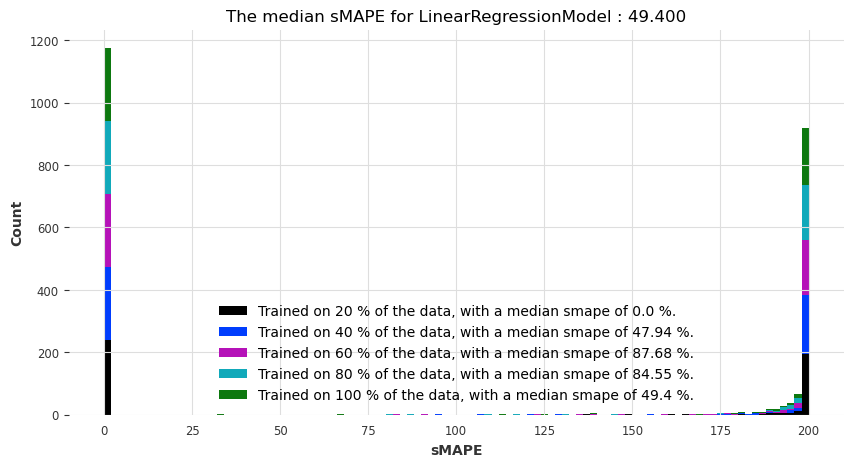

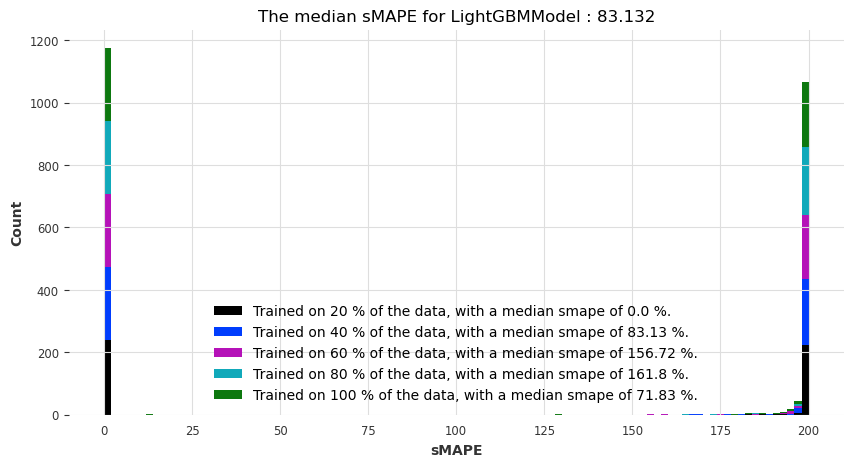

In [ ]:
info_table = []
info_table_var=[]


for index in list_indices:
    dfofindex = dftm.loc[dftm['indextype']==index]
    print('The results for '+str(index)+' are:')
    listindex_byalgo=[]

    list_var_byalgo=[]
    
    for horizon in [3,6,12]:
        print('The results for '+str(index)+' with an horizon of '+str(horizon)+' are:')
        lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean,nbeats_smapes_mean,lr_var_allerrors,lr_mean_allvar,\
        lgbm_var_allerrors,lgbm_mean_allvar,rf_var_allerrors,rf_mean_allvar,nbeat_var_allerrors,nbeat_mean_allvar\
        =transfer_forecasting_mydata(external_data,dfofindex,horizon,list_concepts,5)
        
        listindex_byalgo=listindex_byalgo+\
        [lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean,nbeats_smapes_mean]
        
        list_var_byalgo=list_var_byalgo+[[lr_var_allerrors,lr_mean_allvar],[lgbm_var_allerrors,lgbm_mean_allvar],
        [rf_var_allerrors,rf_mean_allvar],[nbeat_var_allerrors,nbeat_mean_allvar]]
        
        plot_forecasting_models_global(modelnames,myforecasters,dfofindex,horizon,index) 
    
    list_toappend=[]    
    for i in range(4):
        for j in range(3):
            list_toappend.append(listindex_byalgo[i+j*4])
    info_table.append(list_toappend)
    
    list_toappend_var=[]    
    for i in range(4):
        for j in range(3):
            list_toappend_var.append(list_var_byalgo[i+j*4])
    info_table_var.append(list(chain.from_iterable(list_toappend_var)))

In [ ]:
iterables = [["Linear Regression","LGBM", "Random Forest","NBeats"], ["3 months", "6 months","12 months"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon"])

df = pd.DataFrame({'Index citations t1-t2':info_table[0], 'Index citations t2-t1': info_table[1],
                   'Index colaboration incremental': info_table[2],'colaboration not incremental':info_table[3],
                   'Index keywords': info_table[4]}, index=index)
df

In [ ]:
iterables = [["Linear Regression","LGBM", "Random Forest","NBeats"], ["3 months", "6 months","12 months"],["Mean of variances", "Variances over all errors"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon","Type of variance"])

df = pd.DataFrame({'Index citations t1-t2':info_table_var[0], 'Index citations t2-t1': info_table_var[1],
                   'Index colaboration incremental': info_table_var[2],'colaboration not incremental':info_table_var[3],
                   'Index keywords': info_table_var[4]}, index=index)
df

One can see that Nbeats perform significantly better with respect to efficiency and error than all the other algorithms (linear Regression, LGBM, Random Forest) regardless of the horizon we choose. Nevertheless, it does not perform as well as the Random forest on clustered forecasting.

# **Part 5 -- Transfer learning: fitting the best models: rf and nbeats**

In [ ]:
def nbeats_transferlearning(external_data,train_data,test_data,horizon,mylag):

    # Slicing hyper-params:
    IN_LEN = mylag
    OUT_LEN = horizon

    # Architecture hyper-params:
    NUM_STACKS = 20
    NUM_BLOCKS = 1
    NUM_LAYERS = 2
    LAYER_WIDTH = 136
    COEFFS_DIM = 11

    # Training settings:
    LR = 1e-3
    BATCH_SIZE = 1024
    MAX_SAMPLES_PER_TS = (
    10  # <-- new parameter, limiting the number of training samples per series
    )
    NUM_EPOCHS = 5

    # reproducibility
    np.random.seed(42)
    torch.manual_seed(42)

    nbeats_model_m4 = NBEATSModel(
    input_chunk_length=IN_LEN,
    output_chunk_length=OUT_LEN,
    batch_size=BATCH_SIZE,
    num_stacks=NUM_STACKS,
    num_blocks=NUM_BLOCKS,
    num_layers=NUM_LAYERS,
    layer_widths=LAYER_WIDTH,
    expansion_coefficient_dim=COEFFS_DIM,
    loss_fn=SmapeLoss(),
    optimizer_kwargs={"lr": LR},
    #pl_trainer_kwargs={
     #   "enable_progress_bar": True,
     #   "accelerator": "gpu",
     #   "gpus": -1,
     #   "auto_select_gpus": True,
    #},
    )

    # Train
    nbeats_model_m4.fit(
    external_data,
    num_loader_workers=4,
    epochs=NUM_EPOCHS,
    max_samples_per_ts=MAX_SAMPLES_PER_TS,
    )

    start_time = time.time()
    preds = nbeats_model_m4.predict(series=train_data, n=horizon)  # get forecasts
    nbeats_m4_elapsed_time = time.time() - start_time
    
    nbeats_m4_smapes,nbeats_m4_var_allerrors,nbeats_m4_var_mean_var = mysmape(preds, test_data)
    eval_kcross_forecasts(nbeats_m4_smapes,modelname)
    
    return nbeats_m4_smapes,nbeats_m4_elapsed_time,nbeats_m4_var_allerrors,nbeats_m4_var_mean_var

Since Nbeats is the algorithm that perform the best, we check how well it works training all the data on it.

In [ ]:
for index in list_indices:
    dfofindex = dftm.loc[dftm['indextype']==index]
    print('The results for '+str(index)+' are:')
    for horizon in tqdm([3,6,12]):
        print('The results for '+str(index)+' with an horizon of '+str(horizon)+' are:')
        dftm_horizon = creating_train_test_tm(dfofindex,0,252-horizon,horizon,list_concepts)
        nbeats_transferlearning(m4_notscaled_all,dftm_horizon['Train tm'].tolist(), dftm_horizon['Test tm'].tolist(),\
        horizon,150)

Comment about performance:

In [ ]:
for index in list_indices:
    dfofindex = dftm.loc[dftm['indextype']==index]
    print('The results for '+str(index)+' are:')
    for horizon in tqdm([3,6,12]):
        print('The results for '+str(index)+' with an horizon of '+str(horizon)+' are:')
        dftm_horizon = creating_train_test_tm(dfofindex,0,252-horizon,horizon,list_concepts)
        mylag =70
    
        time1=time.time()
    
        random.seed(42)

        randomforest = RandomForest(lags=mylag, output_chunk_length=horizon)
        randomforest.fit(m4_notscaled_all)

        tic = time.time()
        preds = randomforest.predict(n=horizon, series=dftm_horizon['Train tm'].tolist())
        rf_time_transfer = time.time() - tic
        
        rf_smapes_transfer,rf_var_allerrors,rf_var_mean_var=mysmape(preds,dftm_horizon['Test tm'].tolist())
        eval_kcross_forecasts(rf_smapes_transfer,'randomforest')
    
        time2=time.time()
    
        print('It took '+str(time2-time1)+' seconds to fit and forecast with randomforest')

# **Part 6 -- Fitting best model: hyperparameters optimization, visualization**

In [ ]:
m4_train_notscaled, m4_test_notscaled, m4_notscaled_all = load_m4(2,'notscaled')

In [ ]:
def objective(trial):
    in_len = trial.suggest_int("in_len", 12, 40)
    out_len = trial.suggest_int("out_len", 1, 6)
    
    torch.manual_seed(42)
    
    model = LinearRegressionModel(lags=in_len, output_chunk_length=out_len)
    
    model.fit(m4_notscaled_all[:100])
    
    dftm_horizon = creating_train_test_tm(dftm,out_len,list_concepts)
    
    preds = model.predict(series=dftm_horizon['Train tm'], n=out_len)
    smapes_transfer,var_allerrors,var_mean_var = mysmape(val, preds)
    smape_val = np.mean(smapes)

    return smape_val if smape_val != np.nan else float("inf")

In [ ]:
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=5)

In [ ]:
dftm_horizon = creating_train_test_tm(dftm,40,list_concepts)

In [ ]:
# define objective function
def objective(trial):
    
    
    # select input and output chunk lengths
    in_len = trial.suggest_int("in_len", 12, 40)
    out_len = trial.suggest_int("out_len", 1, in_len-1)

    # throughout training we'll monitor the validation loss for both pruning and early stopping
    pruner = PyTorchLightningPruningCallback(trial, monitor="val_loss")
    early_stopper = EarlyStopping("val_loss", min_delta=0.001, patience=3, verbose=True)
    callbacks = [pruner, early_stopper]


    # reproducibility
    torch.manual_seed(42)

    # build the TCN model
    
    model = LinearRegressionModel(lags=in_len, output_chunk_length=out_len)
    

    # when validating during training, we can use a slightly longer validation
    # set which also contains the first input_chunk_length time steps
    #model_val_set = m4_notscaled_all[-(VAL_LEN + in_len) :]

    # train the model
    model.fit(
        series=m4_notscaled_all[:100]
    )


    # Evaluate how good it is on the validation set, using sMAPE
    preds = model.predict(series=dftm_horizon['Train tm'], n=VAL_LEN)
    smapes_transfer,var_allerrors,var_mean_va = mysmape(val, preds)
    smape_val = np.mean(smapes)

    return smape_val if smape_val != np.nan else float("inf")


# for convenience, print some optimization trials information
def print_callback(study, trial):
    print(f"Current value: {trial.value}, Current params: {trial.params}")
    print(f"Best value: {study.best_value}, Best params: {study.best_trial.params}")

In [ ]:
# optimize hyperparameters by minimizing the sMAPE on the validation set
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=100, callbacks=[print_callback])

Try a probabilistic forecast with the model I created to see, if I could get a better forecast.

In [ ]:
#model_es = ExponentialSmoothing()
#model_es.fit(train)
#probabilistic_forecast = model_es.predict(len(val), num_samples=1000)

#series.plot(label="actual")
#probabilistic_forecast.plot(label="probabilistic forecast")
#plt.legend()
#plt.show()

Checking if the forecasting works well visually

In [ ]:
# model = AutoARIMA()
# model.fit(train)
# forecast = model.predict(8)

# series.plot()
# forecast.plot(label="AutoARIMA")

Checking if the model is not overfitted (with historical_forecasts)

In [ ]:
#model_es = ExponentialSmoothing()
#historical_fcast_es = model_es.historical_forecasts(
#    series, start=0.6, forecast_horizon=3, verbose=True,num_samples=500
#)

#series.plot(label="data")
#historical_fcast_es.plot(label="backtest 3-months ahead forecast (Exp. Smoothing)")
#print("SMAPE = {:.2f}%".format(smape(historical_fcast_es, series)))

To check could be interesting

In [ ]:
#from darts.models import TCNModel
#from darts.utils.likelihood_models import LaplaceLikelihood

#model = TCNModel(
#    input_chunk_length=24,
#    output_chunk_length=12,
#    random_state=42,
#    likelihood=LaplaceLikelihood(),
#)

#model.fit(trainnew, epochs=400, verbose=True);